# Importation

In [190]:
from tqdm import tqdm
import time
import warnings
warnings.filterwarnings("ignore")
import sys
import re
import pandas as pd
import requests
from bs4 import BeautifulSoup
import ast
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# Defining Dataframe

In [13]:
# List of column names
column_names = ['metric(s)', 'URL', 'Title','Trainer','rate','evaluation nbr','level','duration','aquired competences']

# Create an empty DataFrame with column names
Main = pd.DataFrame(columns=column_names)

In [14]:
skills_list = ["Leadership", "Creativity", "Teamwork", "Communication", "Trust", "Respect", "Performance"]

In [15]:
import itertools
# Generate combinations of couples for each skill
skill_combinations = []
for i in range(len(skills_list)):
    for j in range(i+1, len(skills_list)):
        skill_combinations.append(f"{skills_list[i]}+{skills_list[j]}")

skills_list.extend(skill_combinations)

In [16]:
skills_list

['Leadership',
 'Creativity',
 'Teamwork',
 'Communication',
 'Trust',
 'Respect',
 'Performance',
 'Leadership+Creativity',
 'Leadership+Teamwork',
 'Leadership+Communication',
 'Leadership+Trust',
 'Leadership+Respect',
 'Leadership+Performance',
 'Creativity+Teamwork',
 'Creativity+Communication',
 'Creativity+Trust',
 'Creativity+Respect',
 'Creativity+Performance',
 'Teamwork+Communication',
 'Teamwork+Trust',
 'Teamwork+Respect',
 'Teamwork+Performance',
 'Communication+Trust',
 'Communication+Respect',
 'Communication+Performance',
 'Trust+Respect',
 'Trust+Performance',
 'Respect+Performance']

# 

# 

# Coursera:

# 

In [31]:
# Your existing code here...

#this to collect more data 
for b in range(20):
    # Modify the loop to extract data and append it to the DataFrame
    for j in tqdm(skills_list):
        print("_________________"+j+"_____________")
        CourseURL=[]
        for k in range(1, 11):
            course_url = "https://www.coursera.org/search?query=" + j + "&page=" + str(k) + "&=null"
            response = requests.get(course_url)
            soup = BeautifulSoup(response.content, "html.parser")
            ul_element = soup.find("ul", class_="cds-9 css-18msmec cds-10")
            div_elements = ul_element.find_all("div", class_="css-1ek61wr")
            ally = ul_element.find_all("div", class_="product-reviews css-pn23ng")

            # Use zip() to iterate over both div_elements and ally lists together
            for element, review_element in zip(div_elements, ally):
                href = element.a.get("href")
                school = element.find("span", class_="cds-119 css-1mru19s cds-121").get_text()
                title = element.find("h2", class_="cds-119 css-h1jogs cds-121").get_text()
                reviews = review_element.find('p', class_='cds-119 css-dmxkm1 cds-121').get_text()
                rating = review_element.find('p', class_='cds-119 css-11uuo4b cds-121').get_text()
                level =  ' '.join(element.a.get("aria-label").split()[-6:-3])
                duration = ' '.join(element.a.get("aria-label").split()[-4:])
                competence= element.find("p", class_="cds-119 css-12ksubz cds-121").get_text().replace("Skills you'll gain: ", "").split(', ') if element.find("p", class_="cds-119 css-12ksubz cds-121") else ""
                # Assuming you have other metrics, level, duration, etc., you can extract them similarly
                # Append the data to the DataFrame
                Main = Main.append({
                    'metric(s)': j,
                    'URL': "https://www.coursera.org" + href,
                    'Title': title,
                    'Trainer': school,
                    'rate': rating,
                    'evaluation nbr': reviews,
                    # Add other data for level, duration, etc.
                    'level': level,
                    'duration': duration,
                    'aquired competences': competence
                }, ignore_index=True)

  0%|                                                                                           | 0/28 [00:00<?, ?it/s]

_________________Leadership_____________


  4%|██▉                                                                                | 1/28 [00:13<06:04, 13.50s/it]

_________________Creativity_____________


  7%|█████▉                                                                             | 2/28 [00:26<05:44, 13.27s/it]

_________________Teamwork_____________


 11%|████████▉                                                                          | 3/28 [00:40<05:34, 13.37s/it]

_________________Communication_____________


 14%|███████████▊                                                                       | 4/28 [00:58<06:04, 15.17s/it]

_________________Trust_____________


 18%|██████████████▊                                                                    | 5/28 [01:14<06:00, 15.65s/it]

_________________Respect_____________


 21%|█████████████████▊                                                                 | 6/28 [01:26<05:17, 14.41s/it]

_________________Performance_____________


 25%|████████████████████▊                                                              | 7/28 [01:39<04:54, 14.05s/it]

_________________Leadership+Creativity_____________


 29%|███████████████████████▋                                                           | 8/28 [01:51<04:25, 13.27s/it]

_________________Leadership+Teamwork_____________


 32%|██████████████████████████▋                                                        | 9/28 [02:02<03:58, 12.57s/it]

_________________Leadership+Communication_____________


 36%|█████████████████████████████▎                                                    | 10/28 [02:14<03:42, 12.39s/it]

_________________Leadership+Trust_____________


 39%|████████████████████████████████▏                                                 | 11/28 [02:26<03:30, 12.38s/it]

_________________Leadership+Respect_____________


 43%|███████████████████████████████████▏                                              | 12/28 [02:38<03:12, 12.03s/it]

_________________Leadership+Performance_____________


 46%|██████████████████████████████████████                                            | 13/28 [02:52<03:13, 12.89s/it]

_________________Creativity+Teamwork_____________


 50%|█████████████████████████████████████████                                         | 14/28 [03:03<02:50, 12.15s/it]

_________________Creativity+Communication_____________


 54%|███████████████████████████████████████████▉                                      | 15/28 [03:15<02:36, 12.05s/it]

_________________Creativity+Trust_____________


 57%|██████████████████████████████████████████████▊                                   | 16/28 [03:25<02:19, 11.64s/it]

_________________Creativity+Respect_____________


 61%|█████████████████████████████████████████████████▊                                | 17/28 [03:35<02:02, 11.16s/it]

_________________Creativity+Performance_____________


 64%|████████████████████████████████████████████████████▋                             | 18/28 [03:48<01:55, 11.55s/it]

_________________Teamwork+Communication_____________


 68%|███████████████████████████████████████████████████████▋                          | 19/28 [04:00<01:46, 11.84s/it]

_________________Teamwork+Trust_____________


 71%|██████████████████████████████████████████████████████████▌                       | 20/28 [04:11<01:30, 11.37s/it]

_________________Teamwork+Respect_____________


 75%|█████████████████████████████████████████████████████████████▌                    | 21/28 [04:25<01:26, 12.33s/it]

_________________Teamwork+Performance_____________


 79%|████████████████████████████████████████████████████████████████▍                 | 22/28 [04:36<01:10, 11.83s/it]

_________________Communication+Trust_____________


 82%|███████████████████████████████████████████████████████████████████▎              | 23/28 [04:48<00:59, 11.97s/it]

_________________Communication+Respect_____________


 86%|██████████████████████████████████████████████████████████████████████▎           | 24/28 [04:59<00:46, 11.71s/it]

_________________Communication+Performance_____________


 89%|█████████████████████████████████████████████████████████████████████████▏        | 25/28 [05:12<00:36, 12.05s/it]

_________________Trust+Respect_____________


 93%|████████████████████████████████████████████████████████████████████████████▏     | 26/28 [05:23<00:23, 11.57s/it]

_________________Trust+Performance_____________


 96%|███████████████████████████████████████████████████████████████████████████████   | 27/28 [05:32<00:10, 10.87s/it]

_________________Respect+Performance_____________


  0%|                                                                                           | 0/28 [00:00<?, ?it/s]

_________________Leadership_____________


  4%|██▉                                                                                | 1/28 [00:15<06:52, 15.28s/it]

_________________Creativity_____________


  7%|█████▉                                                                             | 2/28 [00:27<05:49, 13.46s/it]

_________________Teamwork_____________


 11%|████████▉                                                                          | 3/28 [00:39<05:22, 12.92s/it]

_________________Communication_____________


 14%|███████████▊                                                                       | 4/28 [00:52<05:11, 12.99s/it]

_________________Trust_____________


 18%|██████████████▊                                                                    | 5/28 [01:05<04:57, 12.92s/it]

_________________Respect_____________


 21%|█████████████████▊                                                                 | 6/28 [01:20<05:00, 13.67s/it]

_________________Performance_____________


 25%|████████████████████▊                                                              | 7/28 [01:35<04:54, 14.02s/it]

_________________Leadership+Creativity_____________


 29%|███████████████████████▋                                                           | 8/28 [01:48<04:33, 13.68s/it]

_________________Leadership+Teamwork_____________


 32%|██████████████████████████▋                                                        | 9/28 [01:59<04:04, 12.84s/it]

_________________Leadership+Communication_____________


 36%|█████████████████████████████▎                                                    | 10/28 [02:12<03:52, 12.93s/it]

_________________Leadership+Trust_____________


 39%|████████████████████████████████▏                                                 | 11/28 [02:23<03:26, 12.16s/it]

_________________Leadership+Respect_____________


 43%|███████████████████████████████████▏                                              | 12/28 [02:38<03:29, 13.12s/it]

_________________Leadership+Performance_____________


 46%|██████████████████████████████████████                                            | 13/28 [02:51<03:18, 13.22s/it]

_________________Creativity+Teamwork_____________


 50%|█████████████████████████████████████████                                         | 14/28 [03:01<02:50, 12.21s/it]

_________________Creativity+Communication_____________


 54%|███████████████████████████████████████████▉                                      | 15/28 [03:13<02:38, 12.23s/it]

_________________Creativity+Trust_____________


 57%|██████████████████████████████████████████████▊                                   | 16/28 [03:24<02:19, 11.63s/it]

_________________Creativity+Respect_____________


 61%|█████████████████████████████████████████████████▊                                | 17/28 [03:35<02:06, 11.50s/it]

_________________Creativity+Performance_____________


 64%|████████████████████████████████████████████████████▋                             | 18/28 [03:48<02:01, 12.12s/it]

_________________Teamwork+Communication_____________


 68%|███████████████████████████████████████████████████████▋                          | 19/28 [04:02<01:53, 12.64s/it]

_________________Teamwork+Trust_____________


 71%|██████████████████████████████████████████████████████████▌                       | 20/28 [04:11<01:32, 11.59s/it]

_________________Teamwork+Respect_____________


 75%|█████████████████████████████████████████████████████████████▌                    | 21/28 [04:26<01:27, 12.54s/it]

_________________Teamwork+Performance_____________


 79%|████████████████████████████████████████████████████████████████▍                 | 22/28 [04:36<01:09, 11.65s/it]

_________________Communication+Trust_____________


 82%|███████████████████████████████████████████████████████████████████▎              | 23/28 [04:46<00:56, 11.31s/it]

_________________Communication+Respect_____________


 86%|██████████████████████████████████████████████████████████████████████▎           | 24/28 [04:56<00:43, 10.88s/it]

_________________Communication+Performance_____________


 89%|█████████████████████████████████████████████████████████████████████████▏        | 25/28 [05:13<00:37, 12.59s/it]

_________________Trust+Respect_____________


 93%|████████████████████████████████████████████████████████████████████████████▏     | 26/28 [05:25<00:24, 12.38s/it]

_________________Trust+Performance_____________


 96%|███████████████████████████████████████████████████████████████████████████████   | 27/28 [05:34<00:11, 11.60s/it]

_________________Respect+Performance_____________


  0%|                                                                                           | 0/28 [00:00<?, ?it/s]

_________________Leadership_____________


  4%|██▉                                                                                | 1/28 [00:12<05:48, 12.91s/it]

_________________Creativity_____________


  7%|█████▉                                                                             | 2/28 [00:24<05:11, 11.96s/it]

_________________Teamwork_____________


 11%|████████▉                                                                          | 3/28 [00:34<04:43, 11.32s/it]

_________________Communication_____________


 14%|███████████▊                                                                       | 4/28 [00:46<04:36, 11.52s/it]

_________________Trust_____________


 18%|██████████████▊                                                                    | 5/28 [00:58<04:26, 11.57s/it]

_________________Respect_____________


 21%|█████████████████▊                                                                 | 6/28 [01:09<04:13, 11.51s/it]

_________________Performance_____________


 25%|████████████████████▊                                                              | 7/28 [01:25<04:29, 12.85s/it]

_________________Leadership+Creativity_____________


 29%|███████████████████████▋                                                           | 8/28 [01:38<04:20, 13.01s/it]

_________________Leadership+Teamwork_____________


 32%|██████████████████████████▋                                                        | 9/28 [01:50<04:00, 12.67s/it]

_________________Leadership+Communication_____________


 36%|█████████████████████████████▎                                                    | 10/28 [02:03<03:48, 12.70s/it]

_________________Leadership+Trust_____________


 39%|████████████████████████████████▏                                                 | 11/28 [02:17<03:41, 13.03s/it]

_________________Leadership+Respect_____________


 43%|███████████████████████████████████▏                                              | 12/28 [02:30<03:31, 13.23s/it]

_________________Leadership+Performance_____________


 46%|██████████████████████████████████████                                            | 13/28 [02:43<03:16, 13.11s/it]

_________________Creativity+Teamwork_____________


 50%|█████████████████████████████████████████                                         | 14/28 [02:54<02:54, 12.44s/it]

_________________Creativity+Communication_____________


 54%|███████████████████████████████████████████▉                                      | 15/28 [03:08<02:46, 12.84s/it]

_________________Creativity+Trust_____________


 57%|██████████████████████████████████████████████▊                                   | 16/28 [03:21<02:35, 12.97s/it]

_________________Creativity+Respect_____________


 61%|█████████████████████████████████████████████████▊                                | 17/28 [03:31<02:13, 12.17s/it]

_________________Creativity+Performance_____________


 64%|████████████████████████████████████████████████████▋                             | 18/28 [03:48<02:15, 13.58s/it]

_________________Teamwork+Communication_____________


 68%|███████████████████████████████████████████████████████▋                          | 19/28 [04:00<01:56, 12.98s/it]

_________________Teamwork+Trust_____________


 71%|██████████████████████████████████████████████████████████▌                       | 20/28 [04:10<01:36, 12.09s/it]

_________________Teamwork+Respect_____________


 75%|█████████████████████████████████████████████████████████████▌                    | 21/28 [04:24<01:28, 12.66s/it]

_________________Teamwork+Performance_____________


 79%|████████████████████████████████████████████████████████████████▍                 | 22/28 [04:34<01:12, 12.04s/it]

_________________Communication+Trust_____________


 82%|███████████████████████████████████████████████████████████████████▎              | 23/28 [04:45<00:57, 11.49s/it]

_________________Communication+Respect_____________


 86%|██████████████████████████████████████████████████████████████████████▎           | 24/28 [04:58<00:48, 12.00s/it]

_________________Communication+Performance_____________


 89%|█████████████████████████████████████████████████████████████████████████▏        | 25/28 [05:11<00:36, 12.26s/it]

_________________Trust+Respect_____________


 93%|████████████████████████████████████████████████████████████████████████████▏     | 26/28 [05:20<00:22, 11.34s/it]

_________________Trust+Performance_____________


 96%|███████████████████████████████████████████████████████████████████████████████   | 27/28 [05:28<00:10, 10.45s/it]

_________________Respect+Performance_____________


  0%|                                                                                           | 0/28 [00:00<?, ?it/s]

_________________Leadership_____________


  4%|██▉                                                                                | 1/28 [00:13<06:02, 13.44s/it]

_________________Creativity_____________


  7%|█████▉                                                                             | 2/28 [00:25<05:24, 12.48s/it]

_________________Teamwork_____________


 11%|████████▉                                                                          | 3/28 [00:36<04:58, 11.96s/it]

_________________Communication_____________


 14%|███████████▊                                                                       | 4/28 [00:49<04:56, 12.35s/it]

_________________Trust_____________


 18%|██████████████▊                                                                    | 5/28 [01:02<04:48, 12.53s/it]

_________________Respect_____________


 21%|█████████████████▊                                                                 | 6/28 [01:14<04:34, 12.50s/it]

_________________Performance_____________


 25%|████████████████████▊                                                              | 7/28 [01:29<04:38, 13.27s/it]

_________________Leadership+Creativity_____________


 29%|███████████████████████▋                                                           | 8/28 [01:42<04:23, 13.19s/it]

_________________Leadership+Teamwork_____________


 32%|██████████████████████████▋                                                        | 9/28 [01:54<04:01, 12.73s/it]

_________________Leadership+Communication_____________


 36%|█████████████████████████████▎                                                    | 10/28 [02:07<03:49, 12.75s/it]

_________________Leadership+Trust_____________


 39%|████████████████████████████████▏                                                 | 11/28 [02:18<03:29, 12.35s/it]

_________________Leadership+Respect_____________


 43%|███████████████████████████████████▏                                              | 12/28 [02:30<03:17, 12.33s/it]

_________________Leadership+Performance_____________


 46%|██████████████████████████████████████                                            | 13/28 [02:44<03:09, 12.64s/it]

_________________Creativity+Teamwork_____________


 50%|█████████████████████████████████████████                                         | 14/28 [02:53<02:42, 11.63s/it]

_________________Creativity+Communication_____________


 54%|███████████████████████████████████████████▉                                      | 15/28 [03:06<02:34, 11.88s/it]

_________________Creativity+Trust_____________


 57%|██████████████████████████████████████████████▊                                   | 16/28 [03:15<02:14, 11.22s/it]

_________________Creativity+Respect_____________


 61%|█████████████████████████████████████████████████▊                                | 17/28 [03:25<01:59, 10.89s/it]

_________________Creativity+Performance_____________


 64%|████████████████████████████████████████████████████▋                             | 18/28 [03:37<01:51, 11.10s/it]

_________________Teamwork+Communication_____________


 68%|███████████████████████████████████████████████████████▋                          | 19/28 [03:50<01:46, 11.81s/it]

_________________Teamwork+Trust_____________


 71%|██████████████████████████████████████████████████████████▌                       | 20/28 [04:04<01:38, 12.30s/it]

_________________Teamwork+Respect_____________


 75%|█████████████████████████████████████████████████████████████▌                    | 21/28 [04:20<01:33, 13.40s/it]

_________________Teamwork+Performance_____________


 75%|█████████████████████████████████████████████████████████████▌                    | 21/28 [04:28<01:29, 12.81s/it]


KeyboardInterrupt: 

In [32]:
Main

,metric(s),URL,Title,Trainer,rate,evaluation nbr,level,duration,aquired competences
0,Performance,https://www.coursera.org/projects/create-perfo...,Create a Performance Summary using SnapEval,Coursera Project Network,4.4,(42 reviews),Intermediate level Less,Less Than 2 Hours,
1,Performance,https://www.coursera.org/learn/quantitative-fo...,Quantitative Formal Modeling and Worst-Case Pe...,EIT Digital,4.7,(23.7k reviews),Mixed level 1,1 - 3 Months,
2,Performance,https://www.coursera.org/projects/baking-light...,Baking Lights for Better Performance in Unity,Coursera Project Network,4.5,(15.4k reviews),Beginner level Less,Less Than 2 Hours,[Application Development]
3,Performance,https://www.coursera.org/projects/googlecloud-...,Optimizing Performance of LookML Queries,Google Cloud,4.8,(16.3k reviews),Intermediate level Less,Less Than 2 Hours,"[Data Analysis, Google Cloud Platform]"
4,Performance,https://www.coursera.org/learn/app-deployment-...,"App Deployment, Debugging, and Performance en ...",Google Cloud,4.5,(10.4k reviews),Intermediate level 1,1 - 4 Weeks,
...,...,...,...,...,...,...,...,...,...
3582,Teamwork+Performance,https://www.coursera.org/learn/feedback,Giving Helpful Feedback,University of Colorado Boulder,4.8,(1.3k reviews),Mixed level 1,1 - 3 Months,"[Business Psychology, Entrepreneurship, Human ..."
3583,Teamwork+Performance,https://www.coursera.org/learn/high-performing...,Building High-Performing Teams,University of Pennsylvania,4.8,(302 reviews),Beginner level 1,1 - 3 Months,"[Collaboration, Communication, Emotional Intel..."
3584,Teamwork+Performance,https://www.coursera.org/learn/leading-teams-b...,Leading Teams: Building Effective Team Cultures,University of Illinois at Urbana-Champaign,4.8,(2.2k reviews),Intermediate level 1,1 - 3 Months,"[Adaptability, Business Psychology, Communicat..."
3585,Teamwork+Performance,https://www.coursera.org/learn/cloud-computing...,Cloud Computing Foundations,Duke University,4.6,(201 reviews),Beginner level 1,1 - 3 Months,"[Cloud Computing, DevOps, Continuous Delivery,..."


# manual number page:

In [ ]:
# Your existing code here...

#this to collect more data 
# Modify the loop to extract data and append it to the DataFrame
for j in tqdm(skills_list):
    print("_________________"+j+"_____________")
    CourseURL=[]
    course_url = "https://www.coursera.org/search?query=" + j + "&page=1&=null"
    print(course_url)
    response = requests.get(course_url)
    soup = BeautifulSoup(response.content, "html.parser")
    ul_element = soup.find("ul", class_="cds-9 css-18msmec cds-10")
    div_elements = ul_element.find_all("div", class_="css-1cj5od")
    ally = ul_element.find_all("div", class_="product-reviews css-pn23ng")

    # Use zip() to iterate over both div_elements and ally lists together
    for element, review_element in zip(div_elements, ally):
        href = element.a.get("href")
        school = element.find("span", class_="cds-119 css-1mru19s cds-121").get_text()
        title = element.find("h2", class_="cds-119 css-h1jogs cds-121").get_text()
        reviews = review_element.find('p', class_='cds-119 css-dmxkm1 cds-121').get_text()
        rating = review_element.find('p', class_='cds-119 css-11uuo4b cds-121').get_text()
        level =  ' '.join(element.a.get("aria-label").split()[-6:-3])
        duration = ' '.join(element.a.get("aria-label").split()[-4:])
        print(duration)
        competence= element.find("p", class_="cds-119 css-12ksubz cds-121").get_text().replace("Skills you'll gain: ", "").split(', ') if element.find("p", class_="cds-119 css-12ksubz cds-121") else ""
        # Assuming you have other metrics, level, duration, etc., you can extract them similarly
        # Append the data to the DataFrame
        Main = Main.append({
            'metric(s)': j,
            'URL': "https://www.coursera.org" + href,
            'Title': title,
            'Trainer': school,
            'rate': rating,
            'evaluation nbr': reviews,
            # Add other data for level, duration, etc.
            'level': level,
            'duration': duration,
            'aquired competences': competence
        }, ignore_index=True)


In [ ]:
skills_list

# Manual skills

In [28]:
j="Performance"
print("_________________"+j+"_____________")
CourseURL=[]
for k in range(1, 11):
    course_url = "https://www.coursera.org/search?query=" + j + "&page=" + str(k) + "&=null"
    print(course_url)
    response = requests.get(course_url)
    soup = BeautifulSoup(response.content, "html.parser")
    ul_element = soup.find("ul", class_="cds-9 css-18msmec cds-10")

    div_elements = ul_element.find_all("div", class_="css-1ek61wr")
    ally = ul_element.find_all("div", class_="product-reviews css-pn23ng")
    # Use zip() to iterate over both div_elements and ally lists together
    for element, review_element in zip(div_elements, ally):
        href = element.a.get("href")
        school = element.find("span", class_="cds-119 css-1mru19s cds-121").get_text()
        title = element.find("h2", class_="cds-119 css-h1jogs cds-121").get_text()
        reviews = review_element.find('p', class_='cds-119 css-dmxkm1 cds-121').get_text()
        rating = review_element.find('p', class_='cds-119 css-11uuo4b cds-121').get_text()
        level =  ' '.join(element.a.get("aria-label").split()[-6:-3])
        duration = ' '.join(element.a.get("aria-label").split()[-4:])
        print(duration)
        competence= element.find("p", class_="cds-119 css-12ksubz cds-121").get_text().replace("Skills you'll gain: ", "").split(', ') if element.find("p", class_="cds-119 css-12ksubz cds-121") else ""
        # Assuming you have other metrics, level, duration, etc., you can extract them similarly
        # Append the data to the DataFrame
        Main = Main.append({
            'metric(s)': j,
            'URL': "https://www.coursera.org" + href,
            'Title': title,
            'Trainer': school,
            'rate': rating,
            'evaluation nbr': reviews,
            # Add other data for level, duration, etc.
            'level': level,
            'duration': duration,
            'aquired competences': competence
        }, ignore_index=True)

_________________Performance_____________
https://www.coursera.org/search?query=Performance&page=1&=null
Less Than 2 Hours
3 - 6 Months
3 - 6 Months
1 - 4 Weeks
1 - 4 Weeks
1 - 4 Weeks
Less Than 2 Hours
1 - 3 Months
1 - 3 Months
1 - 3 Months
1 - 3 Months
https://www.coursera.org/search?query=Performance&page=2&=null
https://www.coursera.org/search?query=Performance&page=3&=null
https://www.coursera.org/search?query=Performance&page=4&=null
https://www.coursera.org/search?query=Performance&page=5&=null
3 - 6 Months
3 - 6 Months
3 - 6 Months
1 - 4 Weeks
3 - 6 Months
3 - 6 Months
3 - 6 Months
3 - 6 Months
1 - 3 Months
3 - 6 Months
1 - 3 Months
3 - 6 Months
https://www.coursera.org/search?query=Performance&page=6&=null
https://www.coursera.org/search?query=Performance&page=7&=null
1 - 3 Months
1 - 3 Months
1 - 4 Weeks
3 - 6 Months
3 - 6 Months
3 - 6 Months
3 - 6 Months
1 - 3 Months
1 - 4 Weeks
3 - 6 Months
1 - 4 Weeks
3 - 6 Months
https://www.coursera.org/search?query=Performance&page=8&=n

# 

In [13]:
Main

,metric(s),URL,Title,Trainer,rate,evaluation nbr,level,duration,aquired competences
0,Leadership,https://www.coursera.org/projects/creating-a-p...,Creating a Product-Market Fit with Value Propo...,Coursera Project Network,4.1,(10 reviews),Intermediate level Less,Less Than 2 Hours,"[Design and Product, Entrepreneurship, Finance..."
1,Leadership,https://www.coursera.org/specializations/leade...,Leadership: An Introduction,Johns Hopkins University,4.5,(12 reviews),Beginner level 3,3 - 6 Months,"[Leadership and Management, Creativity, Resear..."
2,Leadership,https://www.coursera.org/learn/negotiation,Introduction to Negotiation: A Strategic Playb...,Yale University,4.9,(4.6k reviews),Mixed level 1,1 - 3 Months,"[Communication, Marketing, Negotiation, Sales,..."
3,Leadership,https://www.coursera.org/learn/people-management,The Manager's Toolkit: A Practical Guide to Ma...,University of London,4.7,(3.5k reviews),Mixed level 1,1 - 3 Months,"[Human Resources, Leadership and Management, P..."
4,Leadership,https://www.coursera.org/learn/leadership-and-...,Leadership and Disruption,Fundação Instituto de Administração,4.8,(136 reviews),Beginner level 1,1 - 4 Weeks,"[Communication, Human Resources, Leadership De..."
...,...,...,...,...,...,...,...,...,...
1548,Creativity+Trust,https://www.coursera.org/learn/writing-editing...,Writing and Editing: Word Choice and Word Order,University of Michigan,4.8,(1.3k reviews),Beginner level 1,1 - 4 Weeks,"[Communication, Leadership and Management, Pro..."
1549,Creativity+Trust,https://www.coursera.org/learn/collaborative-f...,Collaborative Foresight: How to Game the Future,Institute for the Future,5.0,(11 reviews),Beginner level 1,1 - 3 Months,"[Forecasting, Probability & Statistics, Collab..."
1550,Creativity+Trust,https://www.coursera.org/learn/modpo,Modern & Contemporary American Poetry (“ModPo”),University of Pennsylvania,4.7,(978 reviews),Beginner level 3,3 - 6 Months,"[Business Analysis, Communication, Creativity,..."
1551,Creativity+Trust,https://www.coursera.org/learn/feedback,Giving Helpful Feedback,University of Colorado Boulder,4.7,(787 reviews),Mixed level 1,1 - 3 Months,"[Business Psychology, Entrepreneurship, Human ..."


In [33]:
Main['metric(s)'].value_counts()

Performance                  287
Creativity                   279
Leadership+Creativity        270
Leadership+Performance       238
Leadership                   211
Leadership+Trust             210
Leadership+Communication     209
Respect                      207
Trust                        184
Communication                172
Leadership+Respect           165
Communication+Performance    161
Communication+Trust          161
Creativity+Communication     142
Leadership+Teamwork          118
Teamwork                     115
Communication+Respect        109
Creativity+Performance        78
Teamwork+Communication        70
Trust+Performance             42
Teamwork+Performance          32
Creativity+Teamwork           31
Creativity+Respect            30
Trust+Respect                 28
Teamwork+Trust                19
Creativity+Trust              12
Respect+Performance            7
Name: metric(s), dtype: int64

In [34]:
Main.drop_duplicates(subset=['URL', "metric(s)"] , inplace=True)

In [35]:
Main['metric(s)'].value_counts()

Creativity                   113
Leadership+Creativity        113
Leadership+Performance       110
Leadership+Trust             109
Performance                  107
Communication+Performance    102
Leadership+Communication     102
Respect                       99
Creativity+Communication      96
Leadership                    90
Trust                         86
Leadership+Respect            83
Communication                 82
Communication+Trust           73
Communication+Respect         56
Leadership+Teamwork           45
Teamwork+Communication        45
Teamwork                      44
Creativity+Performance        36
Trust+Performance             31
Trust+Respect                 16
Teamwork+Performance          16
Creativity+Teamwork           14
Creativity+Trust              12
Creativity+Respect            10
Teamwork+Trust                 9
Respect+Performance            7
Name: metric(s), dtype: int64

In [36]:
Main.sort_values(by='metric(s)', inplace=True)

In [37]:
Main.loc[2]["aquired competences"]

['Application Development']

In [38]:
LevelC=Main['level'].value_counts()

In [39]:
LevelC

Beginner level 1                627
Mixed level 1                   351
Beginner level 3                311
Intermediate level 1            153
Intermediate level 3             85
Beginner level Less              47
Intermediate level Less          44
Advanced level 1                 35
Advanced level 3                 18
Mixed level 3                    11
& Statistics, Algorithms          4
Finance etc... 6                  4
Business Psychology, Culture      3
HEC Paris, 6                      2
University of London,             2
Design etc... 6                   2
Operations etc... 6               2
Marketing etc... 6                2
Advanced level Less               1
Regression etc... 6               1
Royal Holloway, 24                1
Name: level, dtype: int64

In [40]:
Main = Main[Main['level'].map(LevelC) >= 6]

In [41]:
Main['level'].value_counts()

Beginner level 1           627
Mixed level 1              351
Beginner level 3           311
Intermediate level 1       153
Intermediate level 3        85
Beginner level Less         47
Intermediate level Less     44
Advanced level 1            35
Advanced level 3            18
Mixed level 3               11
Name: level, dtype: int64

In [42]:
Main['metric(s)'].value_counts()

Creativity                   113
Leadership+Creativity        111
Leadership+Performance       108
Leadership+Trust             108
Performance                  107
Communication+Performance    102
Respect                       99
Leadership+Communication      99
Creativity+Communication      95
Leadership                    87
Trust                         84
Leadership+Respect            83
Communication                 82
Communication+Trust           73
Communication+Respect         56
Teamwork+Communication        45
Leadership+Teamwork           41
Teamwork                      41
Creativity+Performance        36
Trust+Performance             31
Trust+Respect                 16
Creativity+Teamwork           14
Teamwork+Performance          14
Creativity+Trust              12
Creativity+Respect             9
Teamwork+Trust                 9
Respect+Performance            7
Name: metric(s), dtype: int64

In [43]:
Main['rate'].value_counts()

4.8    529
4.7    451
4.6    282
4.5    129
4.9    103
4.4     76
4.3     45
4.2     17
5.0     15
4.1      9
3.9      6
3.3      5
3.8      5
4.0      4
3.7      3
3.0      1
3.1      1
3.6      1
Name: rate, dtype: int64

In [44]:
Main.to_excel("main.xlsx", index=False)

In [46]:
Mainemp = Main.applymap(lambda x: x.strip() if isinstance(x, str) else x)

# Replace empty strings with NaN
Mainemp.replace("", float("nan"), inplace=True)

# Check for any NaN values in the DataFrame
has_empty_values = Mainemp.isnull().any().any()

if has_empty_values:
    # Drop rows containing any form of empty values (empty strings or NaNs)
    Mainemp.dropna(subset=Mainemp.columns[Mainemp.dtypes == object], how='all', inplace=True)
    print("Rows with empty strings or any form of empty values have been dropped.")
else:
    print("No empty strings or any form of empty values found in the 'Main' DataFrame.")


Rows with empty strings or any form of empty values have been dropped.


In [53]:
Main = Mainemp.applymap(lambda x: x.strip() if isinstance(x, str) else x)

# Drop rows containing any NaN values in the DataFrame
Main.dropna(subset=Main.columns[Main.dtypes == object], how='any', inplace=True)


In [57]:
Main= Main.reset_index(drop=True)

In [58]:
Main

,metric(s),URL,Title,Trainer,rate,evaluation nbr,level,duration,aquired competences
0,Communication,https://www.coursera.org/learn/cross-cultural-...,Business English for Cross-cultural Communication,The Hong Kong University of Science and Techno...,4.7,(374 reviews),Mixed level 1,1 - 3 Months,"[Business Communication, Business Psychology, ..."
1,Communication,https://www.coursera.org/learn/finding-your-pr...,Finding Your Professional Voice: Confidence & ...,University of London,4.8,(101 reviews),Beginner level 1,1 - 4 Weeks,"[Communication, Entrepreneurship, Leadership a..."
2,Communication,https://www.coursera.org/learn/wharton-communi...,Improving Communication Skills,University of Pennsylvania,4.7,(1.9k reviews),Beginner level 1,1 - 4 Weeks,"[Communication, Employee Relations, Human Reso..."
3,Communication,https://www.coursera.org/specializations/bayes...,Bayesian Statistics,"University of California, Santa Cruz",4.6,(3.4k reviews),Intermediate level 3,3 - 6 Months,"[Probability & Statistics, Bayesian Statistics..."
4,Communication,https://www.coursera.org/professional-certific...,IBM Data Engineering,IBM,4.6,(43.9k reviews),Beginner level 3,3 - 6 Months,"[Data Management, Databases, Data Structures, ..."
...,...,...,...,...,...,...,...,...,...
1583,Trust+Respect,https://www.coursera.org/learn/how-to-network,How to Network: Leading Yourself to Lead Others,University of Michigan,4.5,(8 reviews),Mixed level 1,1 - 4 Weeks,"[Leadership and Management, Entrepreneurship, ..."
1584,Trust+Respect,https://www.coursera.org/learn/foundations-of-...,Foundations of Career Navigating and Coaching,Goodwill Industries International,4.7,(53 reviews),Beginner level 1,1 - 4 Weeks,"[Leadership and Management, Business Psycholog..."
1585,Trust+Respect,https://www.coursera.org/learn/new-technologie...,New Technologies for Business Leaders,Rutgers the State University of New Jersey,4.4,(367 reviews),Intermediate level 1,1 - 3 Months,"[Change Management, Leadership and Management,..."
1586,Trust+Respect,https://www.coursera.org/learn/teaching-learning,Foundations of Teaching for Learning: Learners...,Commonwealth Education Trust,4.6,(169 reviews),Mixed level 1,1 - 3 Months,"[Business Psychology, Communication, Entrepren..."


In [59]:
has_empty_strings = (Main == "").any().any()

In [60]:
has_empty_strings

False

# 

# 

In [61]:
Main_tuples = Main.applymap(lambda x: tuple(x) if isinstance(x, list) else x)

# Get unique values for each column in the DataFrame
unique_values = {column: Main_tuples[column].unique() for column in Main_tuples.columns}

# Print the unique values for each column
for column, values in unique_values.items():
    print(f"Unique values in '{column}':")
    print( f"'{values}'")

Unique values in 'metric(s)':
'['Communication' 'Communication+Performance' 'Communication+Respect'
 'Communication+Trust' 'Creativity' 'Creativity+Communication'
 'Creativity+Performance' 'Creativity+Respect' 'Creativity+Teamwork'
 'Creativity+Trust' 'Leadership' 'Leadership+Communication'
 'Leadership+Creativity' 'Leadership+Performance' 'Leadership+Respect'
 'Leadership+Teamwork' 'Leadership+Trust' 'Performance' 'Respect'
 'Respect+Performance' 'Teamwork' 'Teamwork+Communication'
 'Teamwork+Performance' 'Teamwork+Trust' 'Trust' 'Trust+Performance'
 'Trust+Respect']'
Unique values in 'URL':
'['https://www.coursera.org/learn/cross-cultural-communication-business'
 'https://www.coursera.org/learn/finding-your-professional-voice'
 'https://www.coursera.org/learn/wharton-communication-skills'
 'https://www.coursera.org/specializations/bayesian-statistics'
 'https://www.coursera.org/professional-certificates/ibm-data-engineer'
 'https://www.coursera.org/professional-certificates/meta-fron

In [11]:
Main["courses names"]=""
Main['courses rates']=""
Main["courses evals"]=""

# 

# DATA is fully cleaned

# 

In [62]:
Main.to_excel("main.xlsx", index=False)

# 

# 

# PART II (Beta version):

# 

# 

In [33]:
Main = pd.read_excel("main.xlsx")

In [34]:
Main["courses names"]=""
Main['courses rates']=""
Main["courses evals"]=""

In [35]:
Main

,metric(s),URL,Title,Trainer,rate,evaluation nbr,level,duration,aquired competences,courses names,courses rates,courses evals
0,Communication,https://www.coursera.org/learn/cross-cultural-...,Business English for Cross-cultural Communication,The Hong Kong University of Science and Techno...,4.7,(374 reviews),Mixed level 1,1 - 3 Months,"['Business Communication', 'Business Psycholog...",,,
1,Communication,https://www.coursera.org/learn/finding-your-pr...,Finding Your Professional Voice: Confidence & ...,University of London,4.8,(101 reviews),Beginner level 1,1 - 4 Weeks,"['Communication', 'Entrepreneurship', 'Leaders...",,,
2,Communication,https://www.coursera.org/learn/wharton-communi...,Improving Communication Skills,University of Pennsylvania,4.7,(1.9k reviews),Beginner level 1,1 - 4 Weeks,"['Communication', 'Employee Relations', 'Human...",,,
3,Communication,https://www.coursera.org/specializations/bayes...,Bayesian Statistics,"University of California, Santa Cruz",4.6,(3.4k reviews),Intermediate level 3,3 - 6 Months,"['Probability & Statistics', 'Bayesian Statist...",,,
4,Communication,https://www.coursera.org/professional-certific...,IBM Data Engineering,IBM,4.6,(43.9k reviews),Beginner level 3,3 - 6 Months,"['Data Management', 'Databases', 'Data Structu...",,,
...,...,...,...,...,...,...,...,...,...,...,...,...
1583,Trust+Respect,https://www.coursera.org/learn/how-to-network,How to Network: Leading Yourself to Lead Others,University of Michigan,4.5,(8 reviews),Mixed level 1,1 - 4 Weeks,"['Leadership and Management', 'Entrepreneurshi...",,,
1584,Trust+Respect,https://www.coursera.org/learn/foundations-of-...,Foundations of Career Navigating and Coaching,Goodwill Industries International,4.7,(53 reviews),Beginner level 1,1 - 4 Weeks,"['Leadership and Management', 'Business Psycho...",,,
1585,Trust+Respect,https://www.coursera.org/learn/new-technologie...,New Technologies for Business Leaders,Rutgers the State University of New Jersey,4.4,(367 reviews),Intermediate level 1,1 - 3 Months,"['Change Management', 'Leadership and Manageme...",,,
1586,Trust+Respect,https://www.coursera.org/learn/teaching-learning,Foundations of Teaching for Learning: Learners...,Commonwealth Education Trust,4.6,(169 reviews),Mixed level 1,1 - 3 Months,"['Business Psychology', 'Communication', 'Entr...",,,


In [39]:
import re

for index, row in tqdm(Main.iterrows()):
    url = row["URL"]

    # Send an HTTP GET request to the URL
    response = requests.get(url)

    # Check if the request was successful (status code 200)
    if response.status_code == 200:
        # Parse the HTML content using BeautifulSoup
        soup = BeautifulSoup(response.content, "html.parser")

        # Find the course title if the element exists
        listofcourses = soup.find_all("h3", class_="cds-119 css-h1jogs cds-121")
        rates = soup.find_all("span", class_="css-1tdi49m")
        evals = soup.find_all("span", class_="cds-119 css-dmxkm1 cds-121")
        
        listofcourses = listofcourses[:-3]
        listofcourses = [elem.get_text() for sublist in listofcourses for elem in sublist]
        
        rates = [re.search(r'\d+(\.\d+)?', elem.get_text()).group() for elem in rates]
        evals = [re.search(r'\d+', elem.get_text()).group() for elem in evals]
        
        course_names = [course for course in listofcourses]
        evals_names = evals
        rates_names = rates
        
        # Store the lists of course names, ratings, and evaluations in the DataFrame
        Main.at[index, 'courses names'] = course_names
        Main.at[index, 'courses rates'] = rates_names
        Main.at[index, 'courses evals'] = evals_names
        
        # Print the course title and ratings
        print("Course Title:")
        for i in listofcourses:
            print(i)
        
        print("Ratings:", rates)
        print("Evaluations:", evals)
    else:
        print(f"Failed to fetch data. Status code: {response.status_code}")


1it [00:01,  1.53s/it]

Course Title:
Welcome module
What is culture?
Culture and communication strategies
Culture and management communication
Culture, application and ethics
Concluding module
Ratings: ['4.5']
Evaluations: ['84', '84']


2it [00:03,  1.72s/it]

Course Title:
Be Aware: Understanding yourself and understanding how the voice works. 
Be Physical: the role of the body in speaking
Be Connected: understanding your audience and how to connect  to them
Be Impactful: Using emphasis for impact
Ratings: ['4.8']
Evaluations: ['37']


3it [00:05,  1.78s/it]

Course Title:
Cooperation, Competition, and Comparisons
Trust
Deception
Effective Communication
Ratings: ['4.8']
Evaluations: ['343']


4it [00:07,  2.08s/it]

Course Title:
Bayesian Statistics: From Concept to Data Analysis
Bayesian Statistics: Techniques and Models
Bayesian Statistics: Mixture Models
Bayesian Statistics: Time Series Analysis
Bayesian Statistics: Capstone Project
Ratings: ['4.6', '4.8', '4.5']
Evaluations: ['3', '460', '41']


5it [00:10,  2.49s/it]

Course Title:
Introduction to Data Engineering
Python for Data Science, AI & Development
Python Project for Data Engineering
Introduction to Relational Databases (RDBMS)
Databases and SQL for Data Science with Python
Hands-on Introduction to Linux Commands and Shell Scripting
Relational Database Administration (DBA)
ETL and Data Pipelines with Shell, Airflow and Kafka
Getting Started with Data Warehousing and BI Analytics
Introduction to NoSQL Databases
Introduction to Big Data with Spark and Hadoop
Data Engineering and Machine Learning using Spark
Data Engineering Capstone Project
Ratings: ['4.7', '4.6', '4.6', '4.7', '4.6', '4.6', '4.5', '4.5', '4.3', '4.6', '4.3', '3.8', '4.6']
Evaluations: ['1', '32', '416', '391', '17', '793', '106', '216', '104', '184', '233', '106', '56']


6it [00:12,  2.32s/it]

Course Title:
Introduction to Front-End Development
Programming with JavaScript
Version Control
HTML and CSS in depth
React Basics
Advanced React
Principles of UX/UI Design
Front-End Developer Capstone 
Coding Interview Preparation
Ratings: ['4.8', '4.7', '4.7', '4.7', '4.7', '4.6', '4.7', '4.5', '4.7']
Evaluations: ['7', '2', '2', '899', '1', '545', '363', '155', '206']


7it [00:15,  2.26s/it]

Course Title:
Marketing Analytics Foundation
Introduction to Data Analytics
Statistics for Marketing
Data Analytics Methods for Marketing
Marketing Analytics with Meta
Meta Marketing Science Certification Exam
Ratings: ['4.8', '3.7', '4.8', '4.7', '4.8', '4.8']
Evaluations: ['1', '245', '126', '163', '129', '66']


8it [00:16,  2.11s/it]

Course Title:
Fundamentos: dados, dados, em todos os lugares
Fazer perguntas para tomar decisões com base em dados
Preparar os Dados para Exploração
Processar os dados para limpá-los
Analisar os dados para responder às perguntas
Compartilhar os dados com a arte da visualização
Análise de dados com programação em R
Projeto final de Data Analytics do Google: conclua um estudo de caso
Ratings: ['4.9', '4.8', '4.8', '4.8', '4.8', '4.8', '4.8', '4.9']
Evaluations: ['1', '439', '225', '151', '101', '68', '79', '143']


9it [00:18,  2.03s/it]

Course Title:
Essentials of Management and Strategic Planning
Fundamentals of Finance
Introduction to Digital Marketing
Ratings: ['4.7', '4.8', '4.7']
Evaluations: ['76', '66', '61']


10it [00:20,  1.90s/it]

Course Title:
Foundations of Cybersecurity
Play It Safe: Manage Security Risks
Connect and Protect: Networks and Network Security
Tools of the Trade: Linux and SQL
Assets, Threats, and Vulnerabilities
Sound the Alarm: Detection and Response
Automate Cybersecurity Tasks with Python
Put It to Work: Prepare for Cybersecurity Jobs
Ratings: ['4.9', '4.8', '4.8', '4.8', '4.8', '4.8', '4.8', '4.9']
Evaluations: ['5', '1', '744', '570', '336', '271', '278', '304']


11it [00:21,  1.76s/it]

Course Title:
Fundamentos do design da experiência do usuário (UX)
Iniciar o processo de design de UX: criar empatia, definir e idealizar
Criar wireframes e protótipos de baixa fidelidade
Conduzir pesquisas de UX e testar os primeiros conceitos
Criar designs e protótipos de alta fidelidade no Figma
Web design responsivo em Adobe XD
Design de uma experiência do usuário para o bem social e preparação para o mercado
Ratings: ['4.9', '4.9', '4.9', '4.9', '5.0', '4.7', '4.9']
Evaluations: ['1', '246', '131', '65', '49', '45', '58']


12it [00:23,  1.67s/it]

Course Title:
What is Climate Change?
How Do We Manage Climate Change?
Planning with Climate Change in Mind
Ratings: ['4.9', '4.8', '4.9']
Evaluations: ['81', '45', '40']


13it [00:26,  2.21s/it]

Course Title:
Gmail
Google Calendar
Google Drive
Google Docs
Google Sheets
Google Slides
Google Meet
Google Chat
Google Sheets - Advanced Topics
Ratings: ['4.8', '4.8', '4.8', '4.8', '4.8', '4.8', '4.9', '4.7']
Evaluations: ['733', '199', '148', '154', '218', '113', '96', '184']


14it [00:28,  2.10s/it]

Course Title:
Introduction to Blockchain Technologies
Transacting on the Blockchain
Blockchain and Business
Blockchain Opportunity Analysis
Ratings: ['4.7', '4.8', '4.7', '4.6']
Evaluations: ['2', '885', '394', '190']


15it [00:30,  1.92s/it]

Course Title:
Foundations of Business Intelligence
The Path to Insights: Data Models and Pipelines
Decisions, Decisions: Dashboards and Reports
Ratings: ['4.7', '4.7', '4.8']
Evaluations: ['375', '136', '190']


16it [00:31,  1.91s/it]

Course Title:
Module 1 - Relationships in Our Lives
Module 2 - Getting Started
Module 3 - Communication
Module 4 - Building Relationships that Work for You
Module 5 - Challenges, Endings, and Transformation
Module 6 - Relationships & Self
Ratings: ['4.6']
Evaluations: ['481']


17it [00:33,  1.84s/it]

Course Title:
Digital Strategy and Business Opportunity
Digital Channel Planning and E-Commerce Strategy
Digital Leadership and Digital Strategy Execution
Ratings: ['4.6', '4.7', '4.6']
Evaluations: ['220', '78', '49']


18it [00:35,  1.77s/it]

Course Title:
Pilares de Marketing Digital
Estrategias de  Redes Sociales
Publicidad Digital con Google AdWords
Compra programática de medios: Publicidad online en tiempo real
Proyecto Final - Programa Especializado en Marketing Digital
Ratings: ['4.8', '4.6', '4.6', '4.7', '4.9']
Evaluations: ['1', '850', '272', '177', '67']


19it [00:36,  1.67s/it]

Course Title:
The Importance of Effective Communication in Today's Business Environment
Interpersonal Communication Skills: Listening, Counseling, and Others
Communicating To Build Trust In an Organization
Providing and Receiving Feedback
Ratings: []
Evaluations: []


20it [00:38,  1.76s/it]

Course Title:
Emergency Management
Planning
Vulnerability
Crisis Risk Communication
Ratings: ['4.6']
Evaluations: ['46']


21it [00:40,  1.81s/it]

Course Title:
Communication Across Cultures
Email Excellence 
Presentation - Time to Shine
Maximize Your English Communication Skills
Ratings: ['4.8']
Evaluations: ['200']


22it [00:42,  1.75s/it]

Course Title:
Self-Awareness
Self-Management
Social Awareness
Social Acceleration
Ratings: ['4.7']
Evaluations: ['74', '74', '74']


23it [00:45,  2.09s/it]

Course Title:
The necessary art of persuasion: Understanding what matters to your audience
Telling your story: Developing a dramatic narrative
Connecting with people: Developing authenticity and building rapport
Talk the talk: Creating impressions and guiding influential conversations
Painful truth: Dealing with objections and overcoming resistance
Winning over hearts and minds: How to pitch a brilliant idea
Ratings: ['4.8']
Evaluations: ['645', '645']


24it [00:46,  1.86s/it]

Course Title:
Write Professional Emails in English
Speak English Professionally: In Person, Online & On the Phone
Build Your Professional ePortfolio in English
Take Your English Communication Skills to the Next Level
Ratings: ['4.8', '4.7', '4.7', '4.8']
Evaluations: ['16', '9', '1', '785']


25it [00:48,  1.79s/it]

Course Title:
Business Writing
Graphic Design
Successful Presentation
Effective Communication Capstone Project
Ratings: ['4.8', '4.8', '4.8', '4.7']
Evaluations: ['4', '2', '4', '135']


26it [00:49,  1.60s/it]

Course Title:
Communicating Your Best Self 
Communicating In Groups and Teams 
Public Speaking and Presentations 
Leading Through Effective Communication 
Ratings: []
Evaluations: []


27it [00:50,  1.61s/it]

Course Title:
Establishing a Professional ‘Self’ through Effective Intercultural Communication
Strengthening Your Widening Network 
Engaging in Persuasive and Credible Communication
Becoming Part of the Globalised Workplace
Effective Communication in the Globalised Workplace - The Capstone
Ratings: ['4.6', '4.6', '4.5', '4.5', '4.7']
Evaluations: ['308', '97', '279', '58', '24']


28it [00:52,  1.56s/it]

Course Title:
Leading transformations: Manage change
Negotiation skills: Negotiate and resolve conflict
Storytelling and influencing: Communicate with impact
Risk governance: Manage the risks
Ratings: ['4.7', '4.7', '4.8', '4.8']
Evaluations: ['1', '631', '1', '328']


29it [00:53,  1.57s/it]

Course Title:
Introduction to Management Consulting
Getting a Consulting Job
Consulting Approach to Problem Solving
Consulting Tools and Tips
Consulting Presentations and Storytelling
Ratings: ['4.8', '4.8', '4.8', '4.9', '4.9']
Evaluations: ['254', '86', '50', '52', '54']


30it [00:55,  1.60s/it]

Course Title:
Grundlagen des Projektmanagements
Projektinitiierung: Ein Erfolgreiches Projekt Starten
Projektplanung: Das Gesamtbild
Projektabwicklung: Das Projekt durchführen
Agiles Projektmanagement
Abschlussprojekt: Projektmanagement in der realen Welt anwenden
Ratings: ['4.4']
Evaluations: ['33']


31it [00:57,  1.56s/it]

Course Title:
Fundamentals of Visualization with Tableau
Essential Design Principles for Tableau
Visual Analytics with Tableau
Creating Dashboards and Storytelling with Tableau
Data Visualization with Tableau Project
Instructors
Ratings: ['4.5', '4.4', '4.6', '4.6', '4.6']
Evaluations: ['6', '1', '1', '959', '508']


32it [00:58,  1.63s/it]

Course Title:
Fundraising and Development Foundations
Annual Campaigns: Building a Case for Support
Major and Principal Gifts
Planned Giving
Ratings: ['4.7', '4.3', '4.5', '4.6']
Evaluations: ['251', '40', '20', '27']


33it [01:01,  1.85s/it]

Course Title:
Speaking and Presenting: Poise
Speaking and Presenting: Pitches and Persuasion
Speaking and Presenting: Conversation Starters
Speaking and Presenting: Tact
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['110', '46', '23', '21']


34it [01:02,  1.77s/it]

Course Title:
The Beginnings of Communication Science
Technical Approaches to Communication Science
Cultural and Social Approaches to Communication Science
Final Exam
Ratings: ['4.8']
Evaluations: ['327']


35it [01:04,  1.89s/it]

Course Title:
Creating a Healthy Project Foundation
Effective Communications Building Blocks
Communications Planning
Leadership Fundamentals
 Managing and Leading Stakeholders
Final Project and Quiz
Ratings: []
Evaluations: []


36it [01:06,  1.84s/it]

Course Title:
Connecting the Science of Learning to Science Communication
Speaking of Science: Oral Presentation 
Writing Science: Written Communication
Decoding Science: Technology Based Communication
Creating Science: Artistic Forms of Communication
Ratings: ['4.8']
Evaluations: ['16']


37it [01:11,  2.67s/it]

Course Title:
Introduction to Virtual Teams and Virtual Communication
Virtual Meetings: Boring to Awesome
Influence, Power and Questioning Strategies in Virtual Collaboration
Speaking and Presenting in a virtual context
Ratings: ['4.8']
Evaluations: ['1']


38it [01:13,  2.68s/it]

Course Title:
Welcome to the Course
The Doctor-Patient Interview
The Physical Examination
Explaining a Treatment or Procedure
Solving Communication Difficulties
Ratings: ['4.9']
Evaluations: ['87']


39it [01:16,  2.57s/it]

Course Title:
Technical Support Fundamentals
The Bits and Bytes of Computer Networking
Operating Systems and You: Becoming a Power User
 System Administration and IT Infrastructure Services
 IT Security: Defense against the digital dark arts 
Ratings: ['4.8', '4.7', '4.7', '4.7', '4.8']
Evaluations: ['141', '44', '25', '22', '20']


40it [01:17,  2.16s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


41it [01:18,  1.88s/it]

Course Title:
Learn step-by-step
Ratings: ['4.7']
Evaluations: ['8']


42it [01:20,  1.82s/it]

Course Title:
Welcome to the IoT Communications and Networks MOOC
Week 1: Medium Access Control (MAC) Layer
 Week 2: 6TiSCH Adaptation Layer
Week 3: 6LoWPAN Adaptation Layer
Week 4: RPL Routing Protocol
Your opinion about this MOOC
Ratings: []
Evaluations: []


43it [01:22,  1.87s/it]

Course Title:
Capstone: An overview
Capstone: E-guide
Capstone: Data Collection 1
Capstone: Data Collection 2
Capstone: Putting it altogether
Final Submission and Peer Critique
Ratings: []
Evaluations: []


44it [01:23,  1.80s/it]

Course Title:
Topic 1. Structure of a Negotiation
Topic 2. Effective Communication in Negotiation
Topic 3. Interests and Positions
Topic 4. Conflict Resolution
Ratings: ['4.8']
Evaluations: ['11']


45it [01:26,  1.87s/it]

Course Title:
Week 1: Course Overview and Introduction to Radio Frequency Protocols
Week 2 -  Protocols: Media Access Protocol
Week 3 -  Protocols: Mesh Routing
Week 4 - Protocols: Service Discovery
Ratings: ['4.9']
Evaluations: ['11']


46it [01:27,  1.89s/it]

Course Title:
Specialization Introduction - Communication for Engineers
Course Introduction - Interpersonal Communication for Engineering Leaders
Week 1: What Influences the Way People Communicate? 
Week 2: Communicating With Leadership Presence in the Workplace
Week 3: How to Handle Difficult Conversations 
Week 4: What to Say, and What Not to Say, in a Crisis Situation
Ratings: ['4.7']
Evaluations: ['31', '31']


47it [01:29,  1.92s/it]

Course Title:
Foundations of Digital Marketing and E-commerce
Attract and Engage Customers with Digital Marketing
From Likes to Leads: Interact with Customers Online
Think Outside the Inbox: Email Marketing
Assess for Success: Marketing Analytics and Measurement
Make the Sale: Build, Launch, and Manage E-commerce Stores
Satisfaction Guaranteed: Develop Customer Loyalty Online
Ratings: ['4.8', '4.8', '4.8', '4.8', '4.6', '4.8', '4.8']
Evaluations: ['12', '3', '1', '1', '838', '702', '1']


48it [01:31,  1.93s/it]

Course Title:
Introduction / What is the Pie?
Negotiation Caselets
Zincit Case
Outpsider Case
Advanced Topics
Linda Babcock: Ask for It
Herb Cohen: You Can Negotiate Anything
John McCall MacBain: The Consummate Dealmaker
Acknowledgments and Further Readings
Ratings: ['5.0']
Evaluations: ['1']


49it [01:33,  1.90s/it]

Course Title:
Getting Started and How Human Beings Communicate
Cultural Differences in Communication
Managing Challenges in Communication in Cross-Cultural Teams
Co-Creating a New Language With Your Team
Ratings: ['4.6']
Evaluations: ['6', '6', '6']


50it [01:35,  1.86s/it]

Course Title:
Principles of Public Relations
Working with the Media
The Nuts and Bolts of Public Relations
Ratings: ['4.7', '4.4', '4.4']
Evaluations: ['280', '28', '17']


51it [01:37,  1.84s/it]

Course Title:
Introduction to think outside the inbox: email marketing
Types of email marketing
Useful tools for email marketing
Collect and analyze email campaign data
Run your own email marketing campaign
Ratings: ['4.8']
Evaluations: ['384']


52it [01:39,  2.09s/it]

Course Title:
Foundations of Project Management
Project Initiation: Starting a Successful Project
Project Planning: Putting It All Together
Project Execution: Running the Project
Agile Project Management
Capstone: Applying Project Management in the Real World
Ratings: ['4.9', '4.8', '4.8', '4.8', '4.8', '4.8']
Evaluations: ['68', '16', '9', '6', '9', '6']


53it [01:41,  2.04s/it]

Course Title:
Business English: Networking
Business English: Meetings
Business English: Planning & Negotiating
Business English: Making Presentations
Business English: Capstone Project
Ratings: ['4.8', '4.8', '4.8', '4.8', '4.8']
Evaluations: ['3', '930', '532', '694', '148']


54it [01:46,  2.71s/it]

Course Title:
Human Resources
Management
Marketing
Work-Life Balance
Ratings: ['4.4']
Evaluations: ['9', '9', '9']


55it [01:47,  2.26s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


56it [01:48,  1.94s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


57it [01:50,  1.95s/it]

Course Title:
Financial Accounting: Foundations
Financial Accounting: Advanced Topics
Introduction to Business Analytics: Communicating with Data 
Introduction to Business Analytics with R
Infonomics I: Business Information Economics and Data Monetization
Infonomics II: Business Information Management and Measurement
Ratings: ['4.7', '4.7', '4.6', '4.6', '4.6', '4.5']
Evaluations: ['4', '1', '554', '183', '91', '26']


58it [01:52,  1.81s/it]

Course Title:
Capstone Introduction 
Writing the Memo
Designing the Slides
Creating the Presentation
The Final Push
Ratings: ['4.8']
Evaluations: ['32', '32']


59it [01:53,  1.81s/it]

Course Title:
 Introduction to Communication in Academic Culture 
 Participating in University Discussion Contexts 
Interpreting, Researching & Planning Written Assignments
Writing Effective & Concise Written Assignments
Giving Persuasive & Engaging Presentations 
Summative Assignment
Ratings: ['4.7']
Evaluations: ['223', '223']


60it [01:56,  2.01s/it]

Course Title:
Persuasive and Credible Communication: An Overview
Principles of Persuasive Writing
Persuasive Writing in a Globalised World
Ratings: ['4.7']
Evaluations: ['77']


61it [01:58,  1.94s/it]

Course Title:
Specialization Introduction - Communication for Engineers
Course Introduction - Oral Communication for Engineering Leaders
Week 1: Introduction and Communication Strategy: It Is All About Audience and Purpose
Week 2: Presentations: What to Say so that Your Audience Listens
Week 3: Creating Visual Support: A Picture Is Worth a Lot of Words
Week 4: How to Speak so that Your Audience Listens
Week 5: Elevator Pitch, Impromptu, Online Presentations, and  Managing Public Speaking Anxiety
Ratings: ['4.5']
Evaluations: ['45', '45']


62it [02:03,  2.83s/it]

Course Title:
About this Specialization and Course
Asking The "Right Questions"
Data Visualization with Tableau
Dynamic Data Manipulation and Presentation in Tableau
Your Communication Toolbox: Visualizations, Logic, and Stories
Final Project
Ratings: ['4.7']
Evaluations: ['308', '308']


63it [02:04,  2.48s/it]

Course Title:
Introduction to Social Media Marketing
Social Media Management 
Fundamentals of Social Media Advertising
Advertising with Meta
Measure and Optimize Social Media Marketing Campaigns
Meta Social Media Marketing Capstone
Instructors
Ratings: ['4.8', '4.9', '4.8', '4.8', '4.9', '4.8']
Evaluations: ['11', '4', '1', '2', '1', '482']


64it [02:05,  2.12s/it]

Course Title:
Emotional and Social Intelligence
Critical Thinking Skills for the Professional
The Growth Mindset
Adaptability and Resiliency
Ratings: ['4.7', '4.8', '4.8', '4.7']
Evaluations: ['940', '639', '502', '282']


65it [02:07,  2.08s/it]

Course Title:
Introduction to Time Value of Money (TVM)
Advanced Concepts in Time Value of Money (TVM)
Stocks and Bonds
Advanced Understanding of Stocks and Bonds
Ratings: ['4.8', '4.7', '4.6', '4.7']
Evaluations: ['856', '66', '365', '31']


66it [02:11,  2.52s/it]

Course Title:
Foundations of Data Science
Get Started with Python
Go Beyond the Numbers: Translate Data into Insights
The Power of Statistics
Regression Analysis: Simplify Complex Data Relationships
The Nuts and Bolts of Machine Learning
Google Advanced Data Analytics Capstone
Ratings: ['4.7', '4.8', '4.8', '4.8', '4.7', '4.8', '4.8']
Evaluations: ['779', '332', '153', '144', '95', '76', '134']


67it [02:14,  2.66s/it]

Course Title:
Preparing to Manage Human Resources
Recruiting, Hiring, and Onboarding Employees
Managing Employee Performance
Managing Employee Compensation
Human Resources Management Capstone: HR for People Managers
Ratings: ['4.8', '4.7', '4.7', '4.7', '4.8']
Evaluations: ['9', '4', '2', '1', '644']


68it [02:15,  2.29s/it]

Course Title:
Professional Skills for International Business
Management Skills for International Business
Quantitative Foundations for International Business
Statistics for International Business
International Business Environment
International Business Capstone
Ratings: ['4.7', '4.7', '4.1', '3.8', '4.7', '4.7']
Evaluations: ['896', '649', '401', '283', '355', '100']


69it [02:18,  2.32s/it]

Course Title:
Defining Diversity, Equity and Inclusion in Organizations
Key Concepts in Organizational DE&I
Best Practices in Planning DE&I Interventions
Assessing Cultural Climate
Ratings: ['4.8', '4.8', '4.9', '4.8']
Evaluations: ['102', '30', '30', '30']


70it [02:19,  2.01s/it]

Course Title:
Work Smarter with Microsoft Word
Work Smarter with Microsoft Excel
Work Smarter with Microsoft PowerPoint
Ratings: ['4.7', '4.7', '4.7']
Evaluations: ['757', '1', '392']


71it [02:21,  2.07s/it]

Course Title:
Introduction to Databases
Version Control
Database Structures and Management with MySQL
Advanced MySQL Topics
Programming in Python
Database Clients
Advanced Data Modeling
Database Engineer Capstone
Coding Interview Preparation
Ratings: ['4.7', '4.7', '4.8', '4.6', '4.6', '4.1', '4.1', '3.7', '4.7']
Evaluations: ['630', '2', '208', '100', '858', '39', '34', '30', '206']


72it [02:23,  2.03s/it]

Course Title:
The Digital Marketing Revolution
Marketing in a Digital World
Digital Marketing Analytics in Theory
Digital Marketing Analytics in Practice
Digital Media and Marketing Principles
Digital Media and Marketing Strategies
Digital Marketing Capstone
Ratings: ['4.7', '4.7', '4.5', '4.5', '4.4', '4.6', '4.5']
Evaluations: ['1', '16', '4', '3', '2', '2', '575']


73it [02:26,  2.28s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


74it [02:28,  2.23s/it]

Course Title:
Customer Analytics
Operations Analytics
People Analytics
Accounting Analytics
Business Analytics Capstone
Ratings: ['4.6', '4.7', '4.6', '4.5', '4.5']
Evaluations: ['11', '4', '5', '2', '712']


75it [02:31,  2.27s/it]

Course Title:
The Social Media Landscape
Social Media Platforms Overview
Goals and Planning for Success
Understand Your Audience
Choose Your Social Media Channels
Ratings: ['4.9']
Evaluations: ['5']


76it [02:33,  2.37s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


77it [02:34,  2.04s/it]

Course Title:
Trading Basics
Trading Algorithms
Advanced Trading Algorithms
Creating a Portfolio 
Design your own trading strategy – Culminating Project
Ratings: ['4.0', '4.5', '4.6', '4.4', '4.5']
Evaluations: ['1', '1', '511', '303', '100']


78it [02:36,  1.93s/it]

Course Title:
Six Sigma Principles 
Six Sigma Tools for Define and Measure
Six Sigma Tools for Analyze
Six Sigma Tools for Improve and Control
Ratings: ['4.7', '4.6', '4.7', '4.7']
Evaluations: ['7', '2', '1', '1']


79it [02:38,  1.82s/it]

Course Title:
Google Cloud Fundamentals: Core Infrastructure
Developing a Google SRE Culture
Reliable Google Cloud Infrastructure: Design and Process
Logging, Monitoring and Observability in Google Cloud
Getting Started with Google Kubernetes Engine
Ratings: ['4.7', '4.7', '4.7', '4.7', '4.5']
Evaluations: ['46', '795', '7', '181', '3']


80it [02:39,  1.80s/it]

Course Title:
Inspiring and Motivating Individuals
Managing Talent
Influencing People
Leading Teams
Leading People and Teams Capstone
Ratings: ['4.8', '4.6', '4.8', '4.8', '4.8']
Evaluations: ['5', '2', '3', '2', '434']


81it [02:41,  1.68s/it]

Course Title:
Modern Art & Ideas
Seeing Through Photographs
What Is Contemporary Art?
Fashion as Design
Ratings: ['4.8', '4.8', '4.7', '4.8']
Evaluations: ['6', '4', '1', '2']


82it [02:42,  1.67s/it]

Course Title:
Planning UX research studies 
 Conducting research with usability studies
Analyzing and synthesizing research results
Sharing research insights for better designs
Ratings: ['4.8']
Evaluations: ['1']


83it [02:44,  1.63s/it]

Course Title:
Course Orientation
MODULE 1: Introduction to ISD
MODULE 2: Foundations and Tools of ISD
MODULE 3: Analysis Part 1
Module 4: Analysis Part 2
Ratings: ['3.8']
Evaluations: ['271']


84it [02:46,  1.68s/it]

Course Title:
Introduction to OKRs
Using OKRs within an Organization
CFRs and the Work of an OKR Cycle
Improving Your "Goal Setting Muscle"
Ratings: ['4.9']
Evaluations: ['109', '109', '109']


85it [02:48,  1.69s/it]

Course Title:
Organization Planning and Development for the 6 σ Black Belt
Team Management for the 6 σ Black Belt
The Define Phase for the 6 σ Black Belt
The Measure Phase for the 6 σ Black Belt
The Analyze Phase for the 6 σ Black Belt
The Improve Phase for the 6 σ Black Belt
The Control Phase for the 6 σ Black Belt
DFSS for the 6 σ Black Belt
Ratings: ['4.5', '4.7', '4.3', '4.3', '4.1', '4.3', '4.0']
Evaluations: ['279', '117', '47', '23', '16', '13', '11']


86it [02:49,  1.68s/it]

Course Title:
Teaching Popular Music in the Classroom
Jazz Improvisation
Arranging for Songwriters
The Art of Music Production
Ratings: ['4.7', '4.8', '4.5', '4.8']
Evaluations: ['84', '778', '68', '1']


87it [02:53,  2.23s/it]

Course Title:
Project Management: Foundations and Initiation
Project Planning and Execution
Agile Project Management
Ratings: ['4.8', '4.7', '4.7']
Evaluations: ['220', '48', '87']


88it [02:54,  2.02s/it]

Course Title:
Strategic Management
Strategy Formulation
Strategy Implementation
Strategic Management - Capstone Project
Ratings: ['4.7', '4.5', '4.6', '4.6']
Evaluations: ['4', '1', '880', '329']


89it [02:59,  2.70s/it]

Course Title:
Data models and pipelines
Dynamic database design
Optimize ETL processes
Course 2 end-of-course project
Ratings: ['4.8']
Evaluations: ['45']


90it [03:00,  2.46s/it]

Course Title:
Introduction to Customer Analytics
Descriptive Analytics
Predictive Analytics
Prescriptive Analytics
Application/Case Studies
Ratings: ['4.7']
Evaluations: ['1', '1', '1']


91it [03:02,  2.19s/it]

Course Title:
Supply Chain Concepts
Planning & Procurement
Manufacturing & Service Operations
Warehousing Operations
Transportation Operations
Ratings: ['4.5']
Evaluations: ['650']


92it [03:04,  2.02s/it]

Course Title:
Create Serverless Applications					
Connect Your Services with Microsoft Azure Service Bus
Data Storage in Microsoft Azure for Associate Developers
Deploy a website with Azure Virtual Machines
Manage Resources in Azure
Deploy a website to Azure with Azure App Service
Secure your Cloud Data
Prepare for AZ-204: Developing Solutions for Microsoft Azure
Ratings: ['4.5', '4.8', '4.4', '4.8', '4.8', '4.6']
Evaluations: ['50', '12', '14', '12', '11', '13']


93it [03:06,  2.07s/it]

Course Title:
Communication Skills
Personality
Problem Solving
Process Control
Ratings: ['4.8']
Evaluations: ['482']


94it [03:07,  1.87s/it]

Course Title:
Guided Tour of Machine Learning in Finance
Fundamentals of Machine Learning in Finance
Reinforcement Learning in Finance
Overview of Advanced Methods of Reinforcement Learning in Finance
Ratings: ['3.8', '3.8', '3.6', '3.8']
Evaluations: ['653', '323', '123', '78']


95it [03:09,  1.78s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


96it [03:11,  1.82s/it]

Course Title:
Value-Based Care: Introduction to Value-Based Care and the U.S. Healthcare System
Value-Based Care: Population Health
Value-Based Care: Managing Processes to Improve Outcomes
Value-Based Care: Reimbursement Models
Value-Based Care: Organizational Competencies
Value-Based Care: Quality Improvement in Organizations
Value-Based Care: Capstone Project
Instructors
Ratings: ['4.7', '4.7', '4.7', '4.4', '4.7', '4.8']
Evaluations: ['133', '42', '37', '39', '18', '17']


97it [03:12,  1.72s/it]

Course Title:
Analyze Datasets and Train ML Models using AutoML
 Build, Train, and Deploy ML Pipelines using BERT
Optimize ML Models and Deploy Human-in-the-Loop Pipelines
Ratings: ['4.6', '4.5', '4.7']
Evaluations: ['384', '136', '97']


98it [03:13,  1.56s/it]

Course Title:
Communication as a Technical Leader
Technical Managerial Written Skills
Speaking to a Technical Group
Ratings: []
Evaluations: []


99it [03:15,  1.63s/it]

Course Title:
The Importance of Effective Communication in Today's Business Environment
Interpersonal Communication Skills: Listening, Counseling, and Others
Communicating To Build Trust In an Organization
Providing and Receiving Feedback
Ratings: []
Evaluations: []


100it [03:17,  1.62s/it]

Course Title:
ESG Risks and Opportunities
ESG Impact: Investor Perspective
ESG and Climate Change
ESG and Social Activism
Ratings: ['4.6', '4.6', '4.8', '4.8']
Evaluations: ['468', '134', '214', '80']


101it [03:19,  1.72s/it]

Course Title:
Introduction to AI for Good
AI for Good Project Framework
Air Quality in Bogotá Colombia
Ratings: ['4.8']
Evaluations: ['38']


102it [03:20,  1.71s/it]

Course Title:
Customer Analytics
Operations Analytics
People Analytics
Accounting Analytics
Business Analytics Capstone
Ratings: ['4.6', '4.7', '4.6', '4.5', '4.5']
Evaluations: ['11', '4', '5', '2', '712']


103it [03:22,  1.83s/it]

Course Title:
Introduction to Machine Learning in Production
Machine Learning Data Lifecycle in Production 
Machine Learning Modeling Pipelines in Production
Deploying Machine Learning Models in Production
Ratings: ['4.8', '4.3', '4.3', '4.5']
Evaluations: ['2', '698', '347', '269']


104it [03:25,  2.13s/it]

Course Title:
Week 1
Week 2
Week 3
Ratings: ['4.9']
Evaluations: ['172', '172', '172']


105it [03:28,  2.28s/it]

Course Title:
Course Overview & Designing Performance Expectations
Key Performance Indicators and Accountability
Diagnosing and Addressing Performance Gaps
Specialization Milestone 1: Define Your Coaching Philosophy
Ratings: ['4.9']
Evaluations: ['103']


106it [03:31,  2.43s/it]

Course Title:
Machine Learning Strategy
Responsible Machine Learning
Machine Learning in Production & Planning
Care and Feeding of your Machine Learning System
Ratings: ['4.9']
Evaluations: ['10']


107it [03:32,  2.14s/it]

Course Title:
Introduction to Marketing
Introduction to Financial Accounting
Managing Social and Human Capital
Introduction to Corporate Finance
Introduction to Operations Management
Wharton Business Foundations Capstone
Instructors
Ratings: ['4.8', '4.7', '4.6', '4.6', '4.4', '4.6']
Evaluations: ['12', '7', '2', '5', '2', '334']


108it [03:34,  2.03s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


109it [03:38,  2.60s/it]

Course Title:
Introduction to Social Media Marketing
Social Media Management 
Fundamentals of Social Media Advertising
Advertising with Meta
Measure and Optimize Social Media Marketing Campaigns
Meta Social Media Marketing Capstone
Instructors
Ratings: ['4.8', '4.9', '4.8', '4.8', '4.9', '4.8']
Evaluations: ['11', '4', '1', '2', '1', '482']


110it [03:40,  2.36s/it]

Course Title:
Leading the Self: Mindfulness, Inner Stability, and Positive Strengths
Leading Downward: Leader Behaviors and Leadership Styles
Building Sustainable Relationships: Supportive Communication and Decision-making Biases 
Power, Politics, and Leading Upwards 
Ethics, Culture, and Change Management
Leadership and Ancient Indian Wisdom: Lessons from the Mahabharata 
Peer Review Assignment
Ratings: ['4.9']
Evaluations: ['242']


111it [03:41,  2.14s/it]

Course Title:
The Digital Marketing Revolution
Marketing in a Digital World
Digital Marketing Analytics in Theory
Digital Marketing Analytics in Practice
Digital Media and Marketing Principles
Digital Media and Marketing Strategies
Digital Marketing Capstone
Ratings: ['4.7', '4.7', '4.5', '4.5', '4.4', '4.6', '4.5']
Evaluations: ['1', '16', '4', '3', '2', '2', '575']


112it [03:43,  2.10s/it]

Course Title:
Welcome to Successful Negotiation!
Prepare: Plan Your Negotiation Strategy
Negotiate: Use Key Tactics for Success
Close: Create a Contract
Perform and Evaluate: The End Game
Practice Your Negotiation Skills with an Interactive Experience and Live Negotiations
Final Examination
Ratings: ['4.8']
Evaluations: ['3']


113it [03:45,  2.10s/it]

Course Title:
Introduction / What is the Pie?
Negotiation Caselets
Zincit Case
Outpsider Case
Advanced Topics
Linda Babcock: Ask for It
Herb Cohen: You Can Negotiate Anything
John McCall MacBain: The Consummate Dealmaker
Acknowledgments and Further Readings
Ratings: ['5.0']
Evaluations: ['1']


114it [03:47,  1.99s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


115it [03:49,  1.92s/it]

Course Title:
Course Overview
Construction Industry Overview
Project Delivery
Lean Project Delivery
Sustainability in the Construction Industry
Environment, Health and Safety of Construction Processes
Building Information Modeling and Technology Trends in Construction
International View of Construction Projects
Role of a Construction Manager
Introduction to Project Planning
Ratings: ['4.7']
Evaluations: ['1']


116it [03:51,  1.86s/it]

Course Title:
Introduction and Data Mining
Process Models and Process Discovery
Different Types of Process Models
Process Discovery Techniques and Conformance Checking
Enrichment of Process Models
Operational Support and Conclusion
Ratings: ['4.8']
Evaluations: ['219']


117it [03:53,  1.86s/it]

Course Title:
 Introduction to Communication in Academic Culture 
 Participating in University Discussion Contexts 
Interpreting, Researching & Planning Written Assignments
Writing Effective & Concise Written Assignments
Giving Persuasive & Engaging Presentations 
Summative Assignment
Ratings: ['4.7']
Evaluations: ['223', '223']


118it [03:54,  1.81s/it]

Course Title:
Capstone Introduction 
Writing the Memo
Designing the Slides
Creating the Presentation
The Final Push
Ratings: ['4.8']
Evaluations: ['32', '32']


119it [03:56,  1.90s/it]

Course Title:
Introducing the Course
What Is Performance? What Is Performance Studies?
Performance Processes
From Not-Performing to Performing
Ritual
Play
Performing in the Paleolithic
Ramlila of Ramnagar, India
Performativity
Constructing Social Roles
Social Media 
Intercultural, Transcultural, Global 
Looking Back, Looking Forward
Ratings: ['4.9']
Evaluations: ['19']


120it [03:58,  1.76s/it]

Course Title:
Foundations of Business Intelligence
The Path to Insights: Data Models and Pipelines
Decisions, Decisions: Dashboards and Reports
Ratings: ['4.7', '4.7', '4.8']
Evaluations: ['375', '136', '190']


121it [03:59,  1.74s/it]

Course Title:
Ratings: []
Evaluations: []


122it [04:01,  1.63s/it]

Course Title:
Supply Chain Planning
Inventory Management
Supply Chain Optimization
Ratings: ['4.6', '4.5']
Evaluations: ['61', '54']


123it [04:03,  1.69s/it]

Course Title:
Introduction to the Course
Module 1: Forming Enforceable Agreements 
Module 2: Special Rules for Sales Contracts 
Module 3: Enforcing Agreements 
Module 4: Agency and Employment Law 
Ratings: ['4.8']
Evaluations: ['381']


124it [04:05,  1.78s/it]

Course Title:
Alternative Approaches to Managing Human Resources
What Makes Employees Work? Money, Of Course!
What Makes Employees Work Revisited...Non-Monetary Motivations
 The People Manager as Part of a Complex System
Ratings: ['4.8']
Evaluations: ['2']


125it [04:07,  2.07s/it]

Course Title:
Course Preview and Intro
Taking on a New Leadership Role
Getting Oriented and Assessing Your Team
Communication in an Age of Super Transparency
Leading Collaboration
Motivating and Inspiring
Effective Governance
Leading Change 
Managing Talent
 Leading in Crisis
  Leading Innovation
 Leading Execution
 Public Life, Private Life
 Vision and the Role of Culture
  Modern Theories of Leadership
  A Study in Leadership Failure: The Financial Crisis (Part 1)
A Study in Leadership Failure: The Financial Crisis (Part 2)
 Real Leadership Case Study: Lord John Browne, British Petroleum 
 Synthesis - Leadership in 21st Century Organizations
Ratings: ['4.8']
Evaluations: ['276', '276']


126it [04:09,  2.08s/it]

Course Title:
Week 1: Sustainability and the circular economy
Week 2: Recycling and reverse logistics
Week 3: Corporate social responsibility (CSR)
Ratings: ['4.6']
Evaluations: ['59']


127it [04:11,  1.87s/it]

Course Title:
Managerial Accounting: Cost Behaviors, Systems, and Analysis
Managerial Accounting: Tools for Facilitating and Guiding Business Decisions
Operations Management: Organization and Analysis
Operations Management: Quality and Supply Chain
Developing a Winning Marketing Strategy
Developing a Marketing Mix for Growth
Ratings: ['4.7', '4.7', '4.6', '4.6', '4.8', '4.8']
Evaluations: ['1', '589', '1', '1', '1', '690']


128it [04:13,  1.98s/it]

Course Title:
Introduction to People Analytics, and Performance Evaluation
Staffing
Collaboration
Talent Management and Future Directions
Ratings: ['4.6']
Evaluations: ['691', '691', '691']


129it [04:15,  1.86s/it]

Course Title:
Remote Work Best Practices
Managing Remote Teams
Remote Adaptation Processes for Organizations
Culture and Values for Distributed Teams 
Final Assignment: Outline your Remote Transition Plan
Ratings: ['4.8']
Evaluations: ['383', '383']


130it [04:17,  1.96s/it]

Course Title:
Building Great Business Writing
The Formula for Writing Success
Crafting Powerful Writing
Activate Your Voice!
Ratings: ['4.8']
Evaluations: ['1']


131it [04:18,  1.77s/it]

Course Title:
A Technical Leader's Qualities and Effectiveness
Challenges of Leading Individuals in the Tech Industry
Challenges of Leading Technical Teams
Ratings: []
Evaluations: []


132it [04:20,  1.76s/it]

Course Title:
Behavioral Insights as a Foundation
Crafting Your Communication Strategy
Designing for Context - Messaging & Creative That Resonates
Tactics for Digital Media and Campaign Implementation
Metrics that Matter: Understanding Impact
Ratings: ['4.8']
Evaluations: ['7']


133it [04:22,  1.74s/it]

Course Title:
Project Management and the Role of the Project Manager
Starting the Project: Project Scope
Managing Stakeholders & Communications
Forming & Leading the Project Team 
Ratings: ['4.8']
Evaluations: ['88']


134it [04:25,  2.23s/it]

Course Title:
Patient Safety and Quality Improvement: Developing a Systems View (Patient Safety I)
Setting the Stage for Success: An Eye on Safety Culture and Teamwork (Patient Safety II)
Planning a Patient Safety or Quality Improvement Project (Patient Safety III)
Designing for Sustainment: Keeping Improvement Work on Track (Patient Safety IV)
Implementing a Patient Safety or Quality Improvement Project (Patient Safety V)
Measuring the Success of a Patient Safety or Quality Improvement Project (Patient Safety VI)
Taking Safety and Quality Improvement Work to the Next Level (Patient Safety VII)
Ratings: ['4.8', '4.8', '4.7', '4.6', '4.8', '4.7', '4.6']
Evaluations: ['1', '404', '151', '78', '75', '76', '70']


135it [04:26,  2.01s/it]

Course Title:
Essentials of Management and Strategic Planning
Fundamentals of Finance
Introduction to Digital Marketing
Ratings: ['4.7', '4.8', '4.7']
Evaluations: ['76', '66', '61']


136it [04:28,  1.92s/it]

Course Title:
Communicate in Person: The Power of Face to Face Connections
Meet and Talk Online
Powerful Phone Talk
Keys to a Strong Interview
Put It All Together: Presentations
Ratings: ['4.8']
Evaluations: ['2']


137it [04:30,  1.98s/it]

Course Title:
Be Aware: Understanding yourself and understanding how the voice works. 
Be Physical: the role of the body in speaking
Be Connected: understanding your audience and how to connect  to them
Be Impactful: Using emphasis for impact
Ratings: ['4.8']
Evaluations: ['37']


138it [04:32,  1.88s/it]

Course Title:
Digitalisation in the Aerospace Industry
Digitalisation in Space Research
Digitalisation in Aeronautics
Instructors
Ratings: ['4.7', '4.7', '4.7']
Evaluations: ['210', '79', '147']


139it [04:34,  1.83s/it]

Course Title:
Write to Share and Achieve Your Goals  
Write a Proposal and Get Results
Write Clear and Complete Reports
Write and Design Powerful Slides for Powerful Presentations
Ratings: ['4.8']
Evaluations: ['183']


140it [04:36,  1.90s/it]

Course Title:
Basic Principles of Listening
Module 2: Listening Strategies
Basic Principles of Speaking
Speaking Strategies
Teaching Pronunciation
Assessment 
Ratings: ['4.8']
Evaluations: ['293', '293']


141it [04:40,  2.72s/it]

Course Title:
Low Intermediate English: Meet & Greet
Low Intermediate English: Calls & Messaging
Low Intermediate English: Help & Information
Low Intermediate English: Planning & Organization
Low Intermediate English: Shopping & Customer Service
Low Intermediate English: Technology
Low Intermediate English: Personal Growth & Well-Being
Ratings: ['4.6', '4.7', '4.6']
Evaluations: ['164', '224', '11']


142it [04:42,  2.33s/it]

Course Title:
Getting Started with Public Speaking
A Formula For Successful Presentation
Practicing Your Self
Engaging with the World
Ratings: ['4.8']
Evaluations: ['1']


143it [04:44,  2.21s/it]

Course Title:
What is Skills Management?
The Quantified Self
Skills Management in Action: Part One
Skills Management in Action: Part Two
Build And Test Drive Your Own Skills Management Tool (Optional Honors Lesson)
Finish The Course and Start Managing Your Skills Today!
Ratings: ['4.3']
Evaluations: ['48', '48']


144it [04:46,  2.26s/it]

Course Title:
Creating A Positive First Impression
Becoming A Role Model In The Workplace
Effective Time and Resource Management
Networking
Ratings: ['4.8']
Evaluations: ['135']


145it [04:48,  2.10s/it]

Course Title:
Supervised Machine Learning: Regression and Classification 
Advanced Learning Algorithms
Unsupervised Learning, Recommenders, Reinforcement Learning
Ratings: ['4.9', '4.9', '4.9']
Evaluations: ['12', '3', '1']


146it [04:51,  2.32s/it]

Course Title:
LEADERSHIP ACUMEN
NAVIGATING CULTURE
COMMUNICATING EFFECTIVELY
MOTIVATING FOLLOWERS
BUILDING PROFESSIONAL NETWORKS
MANAGING CONFLICTS
Ratings: ['4.8']
Evaluations: ['940']


147it [04:52,  2.04s/it]

Course Title:
Module 1 – Introduction to ESG Factors and Concepts
Module 2 – History and Flavors of ESG Investing
Module 3 – ESG Data
Module 4 – ESG Management at the Firm-Level
Ratings: ['4.7']
Evaluations: ['188']


148it [04:54,  1.95s/it]

Course Title:
Introduction to complex data relationships
Simple linear regression
Multiple linear regression
Advanced hypothesis testing
Logistic regression
Course 5 end-of-course project
Ratings: ['4.5']
Evaluations: ['25']


149it [04:55,  1.75s/it]

Course Title:
Effective Sales – An Overview
Sales Strategy
Models & Frameworks to Support Sales Planning 
Sales & Marketing Alignment
Strategic Sales Management Final Project
Ratings: ['4.6', '4.5', '4.5', '4.7', '4.5']
Evaluations: ['233', '157', '61', '68', '24']


150it [04:58,  2.18s/it]

Course Title:
Sequences and Prediction
Deep Neural Networks for Time Series
Recurrent Neural Networks for Time Series
Real-world time series data
Ratings: ['4.7']
Evaluations: ['710']


151it [05:04,  3.24s/it]

Course Title:
Business intelligence visualizations
Visualize results
Automate and monitor
Present business intelligence insights
Course 3 end-of-course project
Put your Google Business Intelligence Certificate to work
Ratings: ['4.8']
Evaluations: ['63']


152it [05:06,  2.91s/it]

Course Title:
Why Smart Executives Fail: Common Mistakes & Warning Signs
Decision-Making: Blending Art & Science
Superbosses: Managing Talent & Leadership
Lessons on Wisdom: Personal Leadership for Your Life
Ratings: ['4.9', '4.8', '4.9', '5.0']
Evaluations: ['169', '67', '58', '27']


153it [05:08,  2.60s/it]

Course Title:
The Power of Team Culture
Building High-Performing Teams
Optimizing Diversity on Teams
Creating a Team Culture of Continuous Learning
Culture-Driven Team Building Capstone 
Ratings: ['4.6', '4.8', '4.4', '4.6', '4.8']
Evaluations: ['448', '303', '149', '154', '23']


154it [05:10,  2.55s/it]

Course Title:
Unsupervised learning
Recommender systems
Reinforcement learning
Ratings: ['5.0']
Evaluations: ['516', '516', '516']


155it [05:12,  2.24s/it]

Course Title:
Week 1: Neural Architecture Search 
Week 2: Model Resource Management Techniques
Week 3: High-Performance Modeling 
Week 4: Model Analysis
Week 5: Interpretability
Ratings: ['4.3']
Evaluations: ['90']


156it [05:14,  2.04s/it]

Course Title:
Les enjeux du reporting extra-financier
Qualifier ses impacts
Mesurer sa performance sociale et environnementale et en rendre compte
Les nouvelles frontières du reporting extra-financier
Ratings: ['4.7']
Evaluations: ['97']


157it [05:15,  2.01s/it]

Course Title:
Introduction to Applied Computational Fluid Dynamics
Flows in Diffusors and Nozzles
Secondary and Vortex Flows
Flows Around a Circular Cylinder
Flows with Heat Transfer
Ratings: ['4.5']
Evaluations: ['15']


158it [05:17,  1.87s/it]

Course Title:
O que é marketing digital?
Tipos de canais e SEM
SEO e Facebook Ads
Email Marketing e Growth Hacks
Medir, Testar e Iterar
Ratings: ['4.8']
Evaluations: ['370', '370']


159it [05:20,  2.22s/it]

Course Title:
Course Information Documents
Module 1 - Introduction to Home Health Care
Module 2 - Working Effectively with Home Care Clients
Module 3 - Working with the Elderly
Module 4 - Working with Children
Module 5 - Working with People Who Are Mentally Ill
Module 6 - Working with People with Developmental Disabilities
Module 7 - Working with People with Physical Disabilities
Module 8 - Food, Nutrition, and Meal Preparation
Module 9 - Family Spending and Budgeting 
Module 10 - Care of the Home and Personal Belongings
 Module 11 - Safety and Injury Prevention 
Module 12 - Personal Care
Ratings: ['4.8']
Evaluations: ['137', '137', '137']


160it [05:23,  2.29s/it]

Course Title:
EMT Foundations
Medical Emergencies: Airway, Breathing, and Circulation
Medical Emergencies: CPR, Toxicology, and Wilderness
Trauma Emergencies and Care
Emergency Care: Pregnancy, Infants, and Children
Prepare for the EMT Certification Test
Instructors
Ratings: ['4.8', '4.8', '4.8', '4.8', '4.8', '4.7']
Evaluations: ['983', '729', '446', '420', '276', '92']


161it [05:25,  2.25s/it]

Course Title:
Managing as a Coach
Setting Expectations & Assessing Performance Issues
Coaching Practices
Coaching Conversations
Ratings: ['4.7', '4.7', '4.7', '4.7']
Evaluations: ['1', '572', '456', '275']


162it [05:27,  2.16s/it]

Course Title:
Generative Design for Additive Manufacturing
Generative Design for Performance and Weight Reduction
Generative Design for Industrial Applications
Generative Design for Part Consolidation
Ratings: ['4.8', '4.8', '4.8', '4.9']
Evaluations: ['248', '89', '85', '60']


163it [05:30,  2.47s/it]

Course Title:
Course Overview
Module 1: Statistical Thinking and Problem Solving
Module 2A: Exploratory Data Analysis, Part 1
Module 2B: Exploratory Data Analysis, Part 2
Module 3: Quality Methods
Module 4: Decision Making with Data
Module 5: Correlation and Regression
Module 6: Design of Experiments (DOE)
Module 7: Predictive Modeling and Text Mining
Review Questions and Case Studies
Ratings: ['4.8']
Evaluations: ['27', '27']


164it [05:32,  2.35s/it]

Course Title:
Influencer Marketing Strategy
Content Marketing Strategy
How To Find Influencers.
How To Engage Influencers.
How To Measure Influencer Marketing.
Influencer Campaigns.
Ratings: ['4.3']
Evaluations: ['53']


165it [05:34,  2.27s/it]

Course Title:
Module 0: Welcome to the Self-Driving Cars Specialization!
Module 1: The Requirements for Autonomy
Module 2: Self-Driving Hardware and Software Architectures
Module 3: Safety Assurance for Autonomous Vehicles
Module 4: Vehicle Dynamic Modeling
Module 5: Vehicle Longitudinal Control
Module 6: Vehicle Lateral Control
Module 7: Putting it all together
Ratings: ['4.8']
Evaluations: ['627', '627']


166it [05:37,  2.41s/it]

Course Title:
Data-Driven Process Improvement
Data Analysis and Visualization
Applied Analytics and Data for Decision Making
Instructors
Ratings: ['4.6', '4.7', '4.6']
Evaluations: ['171', '94', '83']


167it [05:39,  2.26s/it]

Course Title:
Re-opening Introduction 
Introduction to Value, Value Creation, and Supply Chain Management
Management Capability
Learning Perspective
Quality Management
New Product Innovation
Supply Chain Strategy I: Structural and Infrastructural Dimensions
Supply Chain Strategy II: Coordination for Value Creation
Supply Chain Globalization and Sustainability
Final Exam
Ratings: ['4.7']
Evaluations: ['407']


168it [05:41,  2.43s/it]

Course Title:
Re-imagining change 1: The change problem
Re-imagining change 2: Icebergs & death valleys
Creating a change cycle 1: Maps & orientation
Creating a change cycle 2: Masks & performance
Creating a change cycle 3: Mirrors & reflection
Leading change: Mindful & mobilising
Ratings: ['4.8']
Evaluations: ['394', '394']


169it [05:43,  2.11s/it]

Course Title:
Introduction to Large Language Models
Ratings: ['4.5']
Evaluations: ['16']


170it [05:44,  1.95s/it]

Course Title:
Becoming a Visionary Leader
Setting Effective Goals and Expectations
Understanding Human Needs and Drivers of Performance Across Cultures
Aligning Rewards and Behavior
Ratings: ['4.8']
Evaluations: ['827']


171it [05:46,  1.77s/it]

Course Title:
Introduction to the Nonprofit Sector, Nonprofit Organizations, Nonprofit Leadership and Governance
The Roles and Responsibilities of Nonprofit Boards of Directors within the Governance Process
The Factors that Influence the Effectiveness of Boards and the Governance Process
Capstone - Managing Board Change for Higher Levels of Leadership and Governance Effectiveness 
Instructors
Ratings: ['4.4', '4.4', '4.6']
Evaluations: ['183', '59', '47']


172it [05:47,  1.60s/it]

Course Title:
Electrical Power Generation - An Industrial Outlook
Basics of Electrical Protection System
Advanced Study of Protection Schemes and Switchgear
Ratings: ['4.8', '4.4']
Evaluations: ['20', '14']


173it [05:48,  1.57s/it]

Course Title:
Preparing to Manage Human Resources
Recruiting, Hiring, and Onboarding Employees
Managing Employee Performance
Managing Employee Compensation
Human Resources Management Capstone: HR for People Managers
Ratings: ['4.8', '4.7', '4.7', '4.7', '4.8']
Evaluations: ['9', '4', '2', '1', '644']


174it [05:50,  1.61s/it]

Course Title:
INTRODUÇÃO ÀS TI
Hardware
Sistema operativo
Trabalhar em rede
Software
Resolução de problemas
Ratings: ['4.9']
Evaluations: ['20']


175it [05:52,  1.60s/it]

Course Title:
Self-awareness at the organization level
Building quality relationships in the organization
Building resilience for the organization
Creating sense for the organization
Ratings: ['4.6']
Evaluations: ['27']


176it [05:54,  1.74s/it]

Course Title:
Introduction to Academic Reading and Writing
Literature Review and Referencing
Writing Policy Briefs and Writing for Popular Media  
Dissertation Writing
Ratings: ['4.9']
Evaluations: ['10']


177it [05:56,  1.75s/it]

Course Title:
Introduction to Android Mobile Application Development 
Version Control
Programming Fundamentals in Kotlin
Principles of UX/UI Design
Create the User Interface in Android Studio
Advanced Programming in Kotlin
Working with Data in Android
Mobile Development and JavaScript
React Basics
React Native
Android App Capstone 
Coding Interview Preparation
Ratings: ['4.6', '4.7', '4.7', '4.7', '4.9', '4.7', '4.7', '4.6', '4.7', '4.8', '4.7', '4.7']
Evaluations: ['742', '2', '153', '363', '52', '37', '23', '47', '1', '123', '15', '206']


178it [05:57,  1.74s/it]

Course Title:
Introduction to iOS Mobile Application Development
Version Control
Programming Fundamentals in Swift
Principles of UX/UI Design
Create the User Interface with SwiftUI
Advanced Programming in Swift
Working with Data in iOS
Mobile Development and JavaScript
React Basics
React Native
iOS App Capstone
Coding Interview Preparation
Ratings: ['4.7', '4.7', '4.7', '4.7', '4.7', '4.8', '4.3', '4.6', '4.7', '4.8', '4.4', '4.7']
Evaluations: ['598', '2', '141', '363', '55', '41', '20', '47', '1', '123', '14', '206']


179it [05:59,  1.78s/it]

Course Title:
Welcome!
Our development model is ecologically unsustainable 
The dominant economic models hinder the energy and ecological transition
The energy transition path: decarbonizing GDP
The model of an ecological transition to new prosperity
Governance of the energy and ecological transition
Financing the energy and ecological transition
Ratings: ['4.9']
Evaluations: ['10', '10']


180it [06:01,  1.82s/it]

Course Title:
人事与聘雇的决策 Staffing and Hiring Decisions 
商务会议管理 Meeting Management
领导与团队合作 Leading and Teaming
规划、组织与委派 Planning, Organizing, and Delegating
管理与指导 Managing and Coaching
回顾 Review
Ratings: []
Evaluations: []


181it [06:03,  1.73s/it]

Course Title:
Module 1:  Engaging Diverse Team Members
Module 2:  Conflict Management
Module 3:  Collaboration and Influencing
Ratings: []
Evaluations: []


182it [06:06,  2.12s/it]

Course Title:
Welcome to the Course
Music and Atmosphere
Music and Identity
Music and Politics
Music and Ethics
Ratings: ['4.3']
Evaluations: ['7', '7']


183it [06:07,  1.92s/it]

Course Title:
Week 1 |Tact: Concepts
Week 2 | Tact: Speaking Stories
Week 3 | Tact: Speaking Studies
Week 4 | Joining the Club
Ratings: ['4.8']
Evaluations: ['7']


184it [06:09,  1.83s/it]

Course Title:
Introduction and General Course Information
WARM-UP PROJECTS (Choose Three)
INTERMEDIATE PROJECTS (Choose Three)
MAIN PROJECTS (Choose Three)
For Honors!
Ratings: ['4.9']
Evaluations: ['72']


185it [06:11,  1.91s/it]

Course Title:
Starting to write: Understanding  definitions of identity 
 Developing an argument: shifting identities        
Supporting the argument: situating identity within culture
Starting to finish: writing the first draft 
Ratings: ['4.7']
Evaluations: ['68', '68', '68']


186it [06:12,  1.82s/it]

Course Title:
Lean Fundamentals
Kanban, Value Steam Mapping and Kaizen
Lean Startup
Design Thinking
Ratings: ['4.6']
Evaluations: ['52']


187it [06:14,  1.79s/it]

Course Title:
Staffing and Hiring Decisions
Meeting Management
Leading and Teaming
Planning, Organizing, and Delegating
Managing and Coaching
Review
Ratings: ['4.7']
Evaluations: ['355', '355', '355']


188it [06:17,  2.08s/it]

Course Title:
Decisiones para dotación y contratación de personal / Staffing and Hiring Decisions
Gestión de reuniones / Meeting Management
Liderazgo y trabajo en equipo / Leading and Teaming
Planificar, organizar, y delegar / Planning, Organizing, and Delegating
Dirigir y entrenar / Managing and Coaching
Revisión  /  Review
Ratings: ['4.8']
Evaluations: ['507', '507']


189it [06:19,  2.23s/it]

Course Title:
Definition, global context and international sustainability frameworks 
Actors of change, environment and climate change 
Inclusive economic growth, sustainability and sustainable finance 
Sustainability measurement and reporting 
Ratings: ['4.9']
Evaluations: ['8']


190it [06:23,  2.62s/it]

Course Title:
Maternal and Newborn Health
Quality Maternal and Newborn Care & the Midwifery Model of Care
Care Delivery
Care Organization
Care Values
Care Philosophy
Care Providers
Policy and Advocacy
Ratings: ['4.8']
Evaluations: ['105', '105']


191it [06:25,  2.40s/it]

Course Title:
 Introduction to Communication in Academic Culture 
 Participating in University Discussion Contexts 
Interpreting, Researching & Planning Written Assignments
Writing Effective & Concise Written Assignments
Giving Persuasive & Engaging Presentations 
Summative Assignment
Ratings: ['4.7']
Evaluations: ['223', '223']


192it [06:26,  2.08s/it]

Course Title:
Speaking and Presenting: Poise
Speaking and Presenting: Pitches and Persuasion
Speaking and Presenting: Conversation Starters
Speaking and Presenting: Tact
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['110', '46', '23', '21']


193it [06:28,  2.03s/it]

Course Title:
Interpersonal Skills
Ratings: ['4.8']
Evaluations: ['50']


194it [06:30,  2.08s/it]

Course Title:
Introduction to Front-End Development
Programming with JavaScript
Version Control
HTML and CSS in depth
React Basics
Advanced React
Principles of UX/UI Design
Front-End Developer Capstone 
Coding Interview Preparation
Ratings: ['4.8', '4.7', '4.7', '4.7', '4.7', '4.6', '4.7', '4.5', '4.7']
Evaluations: ['7', '2', '2', '899', '1', '545', '363', '155', '206']


195it [06:32,  1.92s/it]

Course Title:
Introduction to Databases
Version Control
Database Structures and Management with MySQL
Advanced MySQL Topics
Programming in Python
Database Clients
Advanced Data Modeling
Database Engineer Capstone
Coding Interview Preparation
Ratings: ['4.7', '4.7', '4.8', '4.6', '4.6', '4.1', '4.1', '3.7', '4.7']
Evaluations: ['630', '2', '208', '100', '858', '39', '34', '30', '206']


196it [06:34,  1.96s/it]

Course Title:
The Connection Between Leadership, Purpose and Networking
The Networking Mindset and the Networking Process
Self-Leadership
Leading Others
Ratings: []
Evaluations: []


197it [06:36,  1.87s/it]

Course Title:
What is Climate Change?
How Do We Manage Climate Change?
Planning with Climate Change in Mind
Ratings: ['4.9', '4.8', '4.9']
Evaluations: ['81', '45', '40']


198it [06:37,  1.78s/it]

Course Title:
Planning UX research studies 
 Conducting research with usability studies
Analyzing and synthesizing research results
Sharing research insights for better designs
Ratings: ['4.8']
Evaluations: ['1']


199it [06:38,  1.62s/it]

Course Title:
Software Development Processes and Methodologies
Agile Software Development
Lean Software Development
Engineering Practices for Building Quality Software
Ratings: ['4.7', '4.7', '4.6', '4.5']
Evaluations: ['1', '6', '371', '307']


200it [06:40,  1.65s/it]

Course Title:
Inclusion Matters
Inclusive Leadership Matters
Six Signature Traits of Highly Inclusive Leaders
Communication and Inclusive Leadership
Ratings: ['4.9']
Evaluations: ['1']


201it [06:42,  1.73s/it]

Course Title:
What is a teacher?
Myself and My Learning
Influences on my learning
Impacts on my learning
How do I learn?
My learning environment
Ratings: ['4.6']
Evaluations: ['249', '249']


202it [06:44,  1.76s/it]

Course Title:
Introduction to The Art and Science of Economic Policy
The Foundations of Policymaking
The Science of Economic Policymaking
The Art of Economic Policymaking
Implementation of Economic Policy
Conclusion: The Art and Science of Economic Policy
Ratings: ['4.8']
Evaluations: ['20', '20']


203it [06:46,  1.90s/it]

Course Title:
Week 1: Introduction to the Sustainable Development Goals 
Week 2: The Biosphere
Week 3: Society I
Week 4: Society II
Week 5: Economy
Week 6: Partnerships
Week 7: Systems thinking
Ratings: ['4.8']
Evaluations: ['377', '377', '377']


204it [06:48,  1.86s/it]

Course Title:
The lives of children
How children learn
Engaging with students
The power of the peer group
Learning that travels
Four key thinkers
Ratings: ['4.7']
Evaluations: ['21', '21']


205it [06:50,  1.81s/it]

Course Title:
Introduction to GBV - Epidemiology and Health Impact
Health Care Response, Screening, and Psychosocial Support
Clinical Care for GBV Survivors
Additional Materials and Wrap-Up
Ratings: ['4.7']
Evaluations: ['86']


206it [06:51,  1.72s/it]

Course Title:
Competencias en Telesalud para el profesional de la salud
Aspectos conceptuales y operativos de la Telesalud
Tecnología como facilitador en soluciones de Telemedicina
Exploración centrada en el paciente
Ratings: ['4.4']
Evaluations: ['14']


207it [06:53,  1.89s/it]

Course Title:
Módulo 1: Yo ciudadano
Módulo 2: El ciudadano en las relaciones interpersonales (conflictos)
Módulo 3: El ciudadano en las relaciones interpersonales (acoso escolar)
Módulo 4: Ciudadanía en el aula
Módulo 4: Ciudadanía en el aula: Lesson Choices
Módulo 5: La ciudadanía en la comunidad
Módulo 6: La ciudadanía en el mundo
Diseñando ando
Ratings: ['4.8']
Evaluations: ['82', '82', '82']


208it [06:55,  1.83s/it]

Course Title:
Comportamiento humano en las organizaciones 
Dinámica de los grupos laborales
Inteligencia emocional
Comunicación asertiva
Ratings: ['4.8']
Evaluations: ['396', '396', '396']


209it [06:57,  1.80s/it]

Course Title:
Lung Cancer Overview
Non-Small Cell Lung Cancer: Differential Diagnosis and Diagnostic Work-up
Non-Small Cell Lung Cancer: Staging
Non-Small Cell Lung Cancer and Tracheal Cancer: Therapeutics
Small Cell Lung Cancer
Esophageal Cancer
Patient Support Issues
Ratings: ['4.8']
Evaluations: ['71', '71']


210it [06:59,  2.00s/it]

Course Title:
Planificación de estudios de investigación en UX
Investigación con estudios de usabilidad
Analizar y sintetizar los resultados de la investigación
Compartir las conclusiones de la investigación para el desarrollo de mejores diseños
Ratings: ['4.8']
Evaluations: ['40']


211it [07:01,  1.94s/it]

Course Title:
Alfabetização midiática e informacional: uma introdução
 Alfabetização em Mídia, Informação e Diálogo Intercultural
Alfabetização midiática e informacional: avaliando e usando informações e conteúdo midiático 
Alfabetização midiática e informacional: Usando pesquisa e análise para produzir sua própria informação e conteúdo de mídia
Liberdade de Expressão, Liberdade de Informação, Liberdade de Imprensa
Representações de Gênero na mídia, nos Livros, na Internet e na História
Ética da mídia e da informação em relação às necessidades dos grandes negócios, política e desenvolvimento
Entendendo e Avaliando o Mundo da Publicidade
Desafios da Internet e Oportunidades para Crianças e Jovens
Envolvendo-se com mídia e usando nova tecnologia e Informação para Ação Social
Ratings: ['4.7']
Evaluations: ['16', '16']


212it [07:03,  2.03s/it]

Course Title:
Definición, contexto global y marcos internacionales de sostenibilidad
Actores del cambio, medioambiente y cambio climático
Crecimiento económico inclusivo, sostenibilidad y finanzas sostenibles
Medición y reporte de sostenibilidad
Ratings: ['4.7']
Evaluations: ['39']


213it [07:05,  1.85s/it]

Course Title:
Princípios básicos de apoio técnico
Os vários elementos das redes informáticas
Interagir com sistemas operativos
Serviços de infraestruturas e administração de sistemas
Segurança de TI: defesa contra as artes negras digitais
Ratings: ['4.9', '4.8', '4.9', '4.9', '4.9']
Evaluations: ['140', '39', '22', '27', '39']


214it [07:07,  2.04s/it]

Course Title:
General Introduction
Module 1: Health-care personnel: ethical principles of health care in times of armed conflict and other emergencies
Module 2: The legal framework on the protection of health-care delivery
Module 3: Ambulance and prehospital services in risk situations
Module 4: Hospital managers: ensuring the preparedness and security of health-care facilities in armed conflict and other emergencies
Module 5 Weapons bearers: military operational practice to ensure safer access to and delivery of health care  
Module 6: Members of the civil society: communities, National Societies, Religious Leaders, Health organizations and others
Global Summary Violence against Health Care
Ratings: ['4.7']
Evaluations: ['16', '16', '16']


215it [07:09,  2.04s/it]

Course Title:
Course and Case Introduction
Mr. Osner Santana Goes to the ED
Mr. Osner Santana Waits to Be Seen
Mr. Osner Santana Meets Dr. Jefferson (Part 1)
Mr. Osner Santana Meets Dr. Jefferson (Part 2)
Completion of HI-FIVE Training (Clinical Perspective)
Role-Based Content (OPTIONAL) - Physicians / Nurse Practitioners / Physician Assistants / Clinical Executives / Clinical Managers / Public Health Professionals
Role-Based Content (OPTIONAL) - Nurses / Midwives / Medical Assistants / Other Clinical Support
Ratings: ['4.7']
Evaluations: ['14']


216it [07:11,  2.09s/it]

Course Title:
Introduction to Career Coaching and Navigating
Theories Behind Career Coaching and Navigating
Module 3: Client Relationship Management
Module 4: Human-Centered Navigating and Coaching
Ratings: ['4.6']
Evaluations: ['21']


217it [07:15,  2.57s/it]

Course Title:
Negotiation strategy
Negotiation preparation
Value creation & Value claiming
Peer assessment : Negotiation Preparation & Value Creation: Lesson Choices
Negotiation process 
Ratings: ['4.8']
Evaluations: ['365']


218it [07:17,  2.32s/it]

Course Title:
Module 9: Aviation Infrastructure & Transportation Roadmap
Module 10: Applied Transportation Roadmap
Module 11: Internet Infrastructure & CARMA
Module 12: Applied CARMA
Ratings: ['4.8']
Evaluations: ['39']


219it [07:19,  2.15s/it]

Course Title:
Week 1 |Optimism: Vocabulary
Week 2 | Optimism: Speaking Studies and Speaking Exercises
Week 3 | Dynamic: Vocabulary
Week 4 | Dynamic: Studies & Exercises
Ratings: ['4.3']
Evaluations: ['14']


220it [07:21,  2.11s/it]

Course Title:
Introduction to Nanotechnology, Part 1
Introduction to Nanotechnology, Part 2
Introduction to Sensors’ Science and Technology
Metal Nanoparticles-based Sensors
Quantum Dots Sensor
Ratings: ['4.5']
Evaluations: ['242']


221it [07:22,  1.98s/it]

Course Title:
Stratégie de négociation
Préparation à la négociation
Création et distribution de valeur
Evaluation par les pairs : Préparation d'une négociation & création de valeur: Lesson Choices
Processus de négociation
Ratings: ['4.9']
Evaluations: ['93']


222it [07:24,  1.96s/it]

Course Title:
Los aspectos básicos de la metodología Agile
Scrum 101
Implementación de Scrum
Aplicar la metodología Agile en la organización
Ratings: ['4.9']
Evaluations: ['102']


223it [07:26,  1.88s/it]

Course Title:
An Orientation to Health, Society, and Wellness in COVID-19 Times
Mental Health and Well-Being in COVID-19 Times
The Public Health Response and Transmission of the COVID-19 Virus
Social Inequities and COVID-19
Ratings: ['4.5']
Evaluations: ['7', '7', '7']


224it [07:29,  2.11s/it]

Course Title:
Visualización de datos
Crear visualizaciones de datos con Tableau
Cómo crear historias de datos
Crear presentaciones y diapositivas
Ratings: ['4.9']
Evaluations: ['58']


225it [07:31,  2.31s/it]

Course Title:
Bienvenidos y bienvenidas
El empoderamiento financiero se inicia con un presupuesto  
 ¿Es necesario endeudarse?
El ciclo vital condiciona la planificación financiera
La protección personal y del patrimonio
El abuso financiero
Ratings: ['4.7']
Evaluations: ['22', '22']


226it [07:33,  2.10s/it]

Course Title:
Meaning, Sense, and Clarity
Writing with Nouns and Verbs
Economy
"No Ideas But in Things"
Ratings: ['4.9']
Evaluations: ['145']


227it [07:35,  2.18s/it]

Course Title:
Leading Change in Health Informatics
Project Management for Health Informaticists
Strategic Planning in Health IT
Change Management
Ratings: ['4.7']
Evaluations: ['76']


228it [07:37,  2.05s/it]

Course Title:
Week 1: Being an effective online learner
Week 2: Communicating and collaborating online
Week 3: Researching online
Ratings: ['4.5']
Evaluations: ['17']


229it [07:39,  1.95s/it]

Course Title:
Earning and keeping trust
Types of sources
Interviewing
Tools for finding sourcing
Ratings: ['4.8']
Evaluations: ['82', '82', '82']


230it [07:41,  1.96s/it]

Course Title:
Communicate the Business Impacts of Ethical Risks to Diverse Stakeholders
Design Diverse, Equitable, and Inclusive External Communication Strategies
Manage a Crisis, Communicate Critical Messages, and Ensure Business Continuity
Manage the Media During an Ethical Crisis
Apply What You’ve Learned
Ratings: ['4.8']
Evaluations: ['9', '9', '9']


231it [07:44,  2.48s/it]

Course Title:
Course Introduction & Module 1 - Managing the Organization
Project Initiation and Planning
Leadership Fundamentals
Ratings: ['4.9']
Evaluations: ['11']


232it [07:47,  2.36s/it]

Course Title:
Welcoming Customers
Meeting Customers' Needs
De-escalation with Empathy
Professionalism in Social Media
Ratings: []
Evaluations: []


233it [07:48,  2.18s/it]

Course Title:
Welcome to Course 3!
Earning and keeping trust
Preparing your news report
More than words
Keeping the news conversation going
Ratings: ['4.8']
Evaluations: ['30', '30', '30']


234it [07:50,  2.06s/it]

Course Title:
Team Dynamics 
Leading Your Peers
The Leader as Guide
Important Conversations
Ratings: ['4.6']
Evaluations: ['6', '6', '6']


235it [07:51,  1.84s/it]

Course Title:
Introduction to Strategies for Effective Engagement
Systems Mapping and Analysis
System Mapping
Ratings: ['4.6']
Evaluations: ['7']


236it [07:56,  2.53s/it]

Course Title:
Why are people hesitant about vaccines and how can we effectively communicate with people who are hesitant? 
What is the immune system and what is the SARS CoV-2 virus?
What are vaccines, how are they developed, and which COVID-19 vaccines will be distributed in the US?
How to spot and respond to misinformation online
Vaccines for 5-11 year olds
Ratings: ['4.8']
Evaluations: ['612']


237it [07:58,  2.44s/it]

Course Title:
Lesson One: Healthcare Consumerism and the Patient's Perspective in Health Care Delivery
Lesson Two: Sickness and Treatment Health Care Delivery Models
Lesson Three: Health and Wellness Health Care Delivery Models
Lesson Four: Design a Patient-Centered Health Care Delivery System
Ratings: ['4.7']
Evaluations: ['30']


238it [08:00,  2.26s/it]

Course Title:
Unidad 1: Detección temprana de los riesgos por curso de vida en salud mental y consumo de sustancias psicoactivas
Módulo 3: ¿Cómo identificar los problemas mentales, trastornos mentales, consumo de sustancias psicoactivas y epilepsia en la comunidad?
Unidad 2: Primeros auxilios psicológicos, intervención motivacional breve y abordaje comunitario. 
Módulo 6: Principios de intervención motivacional breve, canalización y seguimiento
Profundización: Pruebas de tamizaje y articulación de equipos psicosociales con servicios de salud
Módulo 10: Estrategias de reducción de daños sociales asociadas al consumo de sustancias psicoactivas.
Ratings: ['5.0']
Evaluations: ['9', '9']


239it [08:01,  2.06s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


240it [08:04,  2.16s/it]

Course Title:
Module 0
Module 1: The Digital Communication Ecosystem 
Module 2: The (Social) Scientist
Module 3: The Journalist 
Module 4:  The Policy Maker
Module 5: The Misinformation Road is Paved with Good Intentions
Module 6:  The Citizens
Module 7: Conclusion 
Ratings: ['4.3']
Evaluations: ['13', '13']


241it [08:05,  2.01s/it]

Course Title:
Cooperation, Competition, and Comparisons
Trust
Deception
Effective Communication
Ratings: ['4.8']
Evaluations: ['343']


242it [08:09,  2.54s/it]

Course Title:
The Importance of Effective Communication in Today's Business Environment
Interpersonal Communication Skills: Listening, Counseling, and Others
Communicating To Build Trust In an Organization
Providing and Receiving Feedback
Ratings: []
Evaluations: []


243it [08:11,  2.36s/it]

Course Title:
Module 1: Building Trust in Communication
Module 2: Helping Teammates Do Their Best Work
Module 3: Being a Trusted Team Leader
Ratings: []
Evaluations: []


244it [08:13,  2.38s/it]

Course Title:
Theme One: Origins (Epidemics past, present and future)
Theme One: Origins (Emergence and ecology of infectious diseases)
Theme One: Origins (Medical Detective: Bug hunting in Epidemics)
Theme Two: Spread (Infectious disease epidemiology)
Theme Two: Spread (Epidemiological triangle)
Theme Two: Spread (Infectious disease modeling)
Theme Three: Control (Disease surveillance)
Theme Three: Control (Non-pharmaceutical intervention (NPI))
Theme Three: Control (Vaccination)
Theme Four: Communication (Communicating disease risk)
Ratings: ['4.7']
Evaluations: ['37', '37', '37']


245it [08:15,  2.23s/it]

Course Title:
CAPSTONE: Introduction to the Capstone - Holistic Perception
CAPSTONE: Disjunctive Analysis
CAPSTONE: Relational Assimilation
CAPSTONE: Decentering
CAPSTONE: Building Sense - part 1 
CAPSTONE: Building Sense - part 2 (video pitch) 
Ratings: ['5.0']
Evaluations: ['15']


246it [08:17,  2.07s/it]

Course Title:
What is a teacher?
Myself and My Learning
Influences on my learning
Impacts on my learning
How do I learn?
My learning environment
Ratings: ['4.6']
Evaluations: ['249', '249']


247it [08:19,  1.96s/it]

Course Title:
Module 1 – Framework
Module 2 – Negotiation Fundamentals
Module 3 – Negotiation Dynamics
Module 4 –Negotiator Mindset
Ratings: ['4.8']
Evaluations: ['11']


248it [08:20,  1.88s/it]

Course Title:
Course Overview and Introduction to Health Equity Research
Engaging Community Stakeholders in Health Equity Research 
Engaging Policymakers to Address Social Determinants of Health
Engaging Health System Leaders and Organizational Stakeholders in Health Equity Research
Using Digital and Social Media to Engage Stakeholders and Disseminate Health Equity Research
Ratings: ['4.8']
Evaluations: ['75', '75']


249it [08:22,  1.87s/it]

Course Title:
DESIGN THINKING FUNDAMENTALS
BEFORE YOU BEGIN, AND ASKING "WHAT IS?"
A MINDSET FOR INNOVATION, AND ASKING "WHAT IF?"
ASKING "WHAT WOWS?" AND "WHAT WORKS?"
Ratings: ['4.7']
Evaluations: ['94']


250it [08:25,  2.02s/it]

Course Title:
Getting Started with Leadership
Stepping Up: Preparing Yourself for Leadership
Stepping Up: Leading Others
Influencing the Organisation
Ratings: ['4.5', '3.9']
Evaluations: ['19', '13']


251it [08:27,  2.17s/it]

Course Title:
Course Introduction
Network Concepts and Models
Common Network Threats and Attacks
Network Security Infrastructure
Network Security Review
Ratings: ['4.9']
Evaluations: ['17']


252it [08:29,  2.14s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: LEADERSHIP DEFINED
MODULE 2: STRATEGIC SELF-LEADERSHIP
MODULE 3: LEADING OTHERS
MODULE 4: GROWING AS A LEADER
Ratings: ['4.8']
Evaluations: ['1', '1', '1']


253it [08:31,  2.03s/it]

Course Title:
Your Writing Identity
Genre, Form, and Audience
Structure
Editing and Proofreading
Publishing
Ratings: ['4.8']
Evaluations: ['195', '195']


254it [08:34,  2.38s/it]

Course Title:
Privacy in the Digital Age
Risks in Data Privacy
Frameworks of Data Privacy Law 
Ratings: ['4.7']
Evaluations: ['197']


255it [08:36,  2.15s/it]

Course Title:
Your inspirational leadership journey
Introspection to grow your self-awareness and sensibility
The Duo, learning to manage quality relationships
Ratings: ['4.8']
Evaluations: ['537']


256it [08:38,  2.25s/it]

Course Title:
The lives of children
How children learn
Engaging with students
The power of the peer group
Learning that travels
Four key thinkers
Ratings: ['4.7']
Evaluations: ['21', '21']


257it [08:41,  2.31s/it]

Course Title:
GETTING STARTED
SHOULD YOU BELIEVE WHAT PEOPLE SAY?
HOW SHOULD WE HANDLE DISAGREEMENT?
RESOLVING RELIGIOUS DISAGEEMENTS: THE ROLE OF EVIDENCE
END OF COURSE ASSIGNMENTS
Ratings: ['4.7']
Evaluations: ['22', '22', '22']


258it [08:42,  2.11s/it]

Course Title:
Content Strategy for Professionals: Engaging Audiences
Content Strategy for Professionals: Managing Content
Content Strategy for Professionals: Expanding Your Content’s Reach
Content Strategy for Professionals: Ensuring Your Content's Impact
Content Strategy for Professionals: Capstone Project
Ratings: ['4.6', '4.5', '4.5', '4.6', '4.6']
Evaluations: ['673', '314', '198', '171', '56']


259it [08:44,  2.11s/it]

Course Title:
Influencer Marketing Strategy
Content Marketing Strategy
How To Find Influencers.
How To Engage Influencers.
How To Measure Influencer Marketing.
Influencer Campaigns.
Ratings: ['4.3']
Evaluations: ['53']


260it [08:46,  2.00s/it]

Course Title:
Week 1: Advanced model training, tuning and evaluation
Week 2: Advanced model deployment and monitoring
Week 3: Data labeling and human-in-the-loop pipelines
Ratings: ['4.5']
Evaluations: ['24', '24', '24']


261it [08:48,  1.89s/it]

Course Title:
Modules 1 & 2: Course Introduction and Our VUCA Environment Demands a Focus on Stakeholders
Modules 3 & 4: Developing Resilience and Understanding Stakeholder Reactions to Crises
Modules 5 & 6: Crisis Varieties, Responses, and the Unique Nature of the Crisis Environment
Modules 7 & 8: Crisis Leadership and Preparing for Future Crises
Ratings: ['4.9']
Evaluations: ['128']


262it [08:50,  1.85s/it]

Course Title:
Introduction to Giving Helpful Feedback and Positive Feedback
Negative Feedback:  Use With Caution
The Seven Essential Feedback Skills - Part I
The Seven Essential Feedback Skills - Part II
Giving Helpful Feedback:  Turn Your Knowledge Into Long-Term Change
Helpful Class Resources
Ratings: ['4.8']
Evaluations: ['472']


263it [08:51,  1.80s/it]

Course Title:
Introduction to Sustainability & Corporate Social Responsibility (CSR)
Scandinavia:  An Introduction
Scandinavian Leadership & Management
Case study of a Scandinavian sustainability leader:  Novo Nordisk
Scandinavian Corporate Governance
Course reflections:  On Becoming a Sustainable Viking
Ratings: ['4.7']
Evaluations: ['18']


264it [08:53,  1.89s/it]

Course Title:
The Words Under the Words
The Infinite Power of Grammar
The Rule of Three
The Power of the Particular
Ratings: ['4.8']
Evaluations: ['586']


265it [08:56,  2.12s/it]

Course Title:
Course Overview
Module 1: Statistical Thinking and Problem Solving
Module 2A: Exploratory Data Analysis, Part 1
Module 2B: Exploratory Data Analysis, Part 2
Module 3: Quality Methods
Module 4: Decision Making with Data
Module 5: Correlation and Regression
Module 6: Design of Experiments (DOE)
Module 7: Predictive Modeling and Text Mining
Review Questions and Case Studies
Ratings: ['4.8']
Evaluations: ['27', '27']


266it [08:59,  2.39s/it]

Course Title:
Introduction to Career Coaching and Navigating
Theories Behind Career Coaching and Navigating
Module 3: Client Relationship Management
Module 4: Human-Centered Navigating and Coaching
Ratings: ['4.6']
Evaluations: ['21']


267it [09:01,  2.26s/it]

Course Title:
Establishing Team Purpose
Setting Clear Expectations
Valuing Excellence
Putting Strengths to Work
Creating Trust & Support
Recognizing Team Members
Building Confidence in the Future
Growing Team Members
Instructor
Ratings: []
Evaluations: []


268it [09:04,  2.61s/it]

Course Title:
The Who What When Where and Why of Leadership in Interprofessional Informatics
Team Fundamentals
Team Evolution and Dynamics
Theory of Collective Impact for Interprofessional Informatics Leadership Success
The Future of Interprofessional Informatics Leadership
Building Your Nursing Informatics Leadership Portfolio
Ratings: []
Evaluations: []


269it [09:06,  2.33s/it]

Course Title:
Cybersecurity information communication reporting in the organization
Cybersecurity actionable measured KPI and goals
Cybersecurity responsibilities into information security
Ratings: ['4.2']
Evaluations: ['7']


270it [09:07,  2.03s/it]

Course Title:
Learn step-by-step
Ratings: ['4.0']
Evaluations: ['9']


271it [09:09,  2.00s/it]

Course Title:
Self-awareness at the organization level
Building quality relationships in the organization
Building resilience for the organization
Creating sense for the organization
Ratings: ['4.6']
Evaluations: ['27']


272it [09:11,  1.99s/it]

Course Title:
Social Psychology
Agile Team
Agile Team Collaboration
Agile Team Leadership
Ratings: ['4.8']
Evaluations: ['66']


273it [09:13,  1.94s/it]

Course Title:
Platforms and Design
Social and Mobile Media
Managing Content and IP
Ratings: ['4.6']
Evaluations: ['25', '25', '25']


274it [09:15,  1.85s/it]

Course Title:
Module 1: Securing Software
Module 2: Securing Data
Module 3: Identify and Analyze Malicious Code and Activity
Module 4: Implement and Operate Endpoint Security
Module 5: Operate and Secure Virtual Environments
Module 6: Chapter 4 Review
Ratings: []
Evaluations: []


275it [09:18,  2.11s/it]

Course Title:
Introduction to Content Strategy 
Audiences and Brand
Experiences and Voice
Ratings: ['4.7']
Evaluations: ['115', '115', '115']


276it [09:22,  2.82s/it]

Course Title:
How to Begin... and How to Continue
How Not to Fail
The Truth of the Story Lies in the Details
Writing to be Read
Ratings: ['4.8']
Evaluations: ['30']


277it [09:24,  2.64s/it]

Course Title:
Unidad 1: Detección temprana de los riesgos por curso de vida en salud mental y consumo de sustancias psicoactivas
Módulo 3: ¿Cómo identificar los problemas mentales, trastornos mentales, consumo de sustancias psicoactivas y epilepsia en la comunidad?
Unidad 2: Primeros auxilios psicológicos, intervención motivacional breve y abordaje comunitario. 
Módulo 6: Principios de intervención motivacional breve, canalización y seguimiento
Profundización: Manejo comunitario
Módulo 10: Derechos y deberes en salud, acceso a los servicios, mecanismos de exigibilidad del derecho a la salud.
Ratings: ['4.9']
Evaluations: ['9', '9']


278it [09:28,  3.11s/it]

Course Title:
Introduction to Emergency Medical Technician (EMT)
Basic Human Anatomy
Communication With A Healthcare Provider
Vital Signs and History Taking
Immediately Upon Arrival To The Scene
Ratings: ['4.9']
Evaluations: ['338', '338', '338']


279it [09:32,  3.11s/it]

Course Title:
Making sense of the news is more important than ever
What is news and who decides?
Where can we find trustworthy information?
Says who?
How do I apply news literacy skills?
Meeting the challenges of digital citizenship
Ratings: ['4.9']
Evaluations: ['49', '49', '49']


280it [09:34,  2.81s/it]

Course Title:
Overview and Course Introduction
Functional Recovery and Enhancement 
Applications in Daily Life 
Mental Health, Psychosocial and Behavioural Challenges 
From Attachment, Intimacy, Sexuality to the Lifeworld
Holistic Experience and Transcendence (HT)
Organizational Development and Service System Enhancement
Ratings: ['4.7']
Evaluations: ['50']


281it [09:36,  2.65s/it]

Course Title:
Introduction to the Cycle
Long-Term Artistic Planning
Institutional Marketing
Programmatic Marketing
Family and Boards
Fundraising and Course Summary
Ratings: ['4.8']
Evaluations: ['155', '155']


282it [09:39,  2.72s/it]

Course Title:
Promote the Ethical Use of Data-Driven Technologies
Turn Ethical Frameworks into Actionable Steps
Detect and Mitigate Ethical Risks
Communicate Effectively about Ethical Challenges in Data-Driven Technologies
Create and Lead an Ethical Data-Driven Organization
Preparing for Your CertNexus Certification Exam
Ratings: ['4.7', '4.7', '4.5', '4.4', '4.6', '4.8']
Evaluations: ['182', '106', '78', '65', '70', '118']


283it [09:41,  2.52s/it]

Course Title:
Empowering Yourself for the Post-Truth World
Who Are the Experts?
Can We Build Trust Online?
False Representations in Constructed Media
Raising and Sharing Our Voices
Reinventing a Truthful World
Ratings: ['4.2']
Evaluations: ['6', '6']


284it [09:42,  2.24s/it]

Course Title:
Week 1 Introduction, Challenges, and Language
Week 2 Acquiring Spoken and Written Language
Week 3 Reading, Early Reading, and Technological Innovations
Ratings: ['4.2']
Evaluations: ['41']


285it [09:45,  2.41s/it]

Course Title:
Introduction to Systems
Operationalize Systems Thinking
Understanding a Community
Ratings: ['4.5']
Evaluations: ['32']


286it [09:48,  2.36s/it]

Course Title:
Leadership Lessons From Great Brands
The Art of Leadership Storytelling Made Simple
Storytelling in Crisis: The Ultimate Marketing Event
Leadership Storytelling and Innovation 
Ratings: ['4.6']
Evaluations: ['141', '141', '141']


287it [09:50,  2.36s/it]

Course Title:
Course Preview and Intro
Taking on a New Leadership Role
Getting Oriented and Assessing Your Team
Communication in an Age of Super Transparency
Leading Collaboration
Motivating and Inspiring
Effective Governance
Leading Change 
Managing Talent
 Leading in Crisis
  Leading Innovation
 Leading Execution
 Public Life, Private Life
 Vision and the Role of Culture
  Modern Theories of Leadership
  A Study in Leadership Failure: The Financial Crisis (Part 1)
A Study in Leadership Failure: The Financial Crisis (Part 2)
 Real Leadership Case Study: Lord John Browne, British Petroleum 
 Synthesis - Leadership in 21st Century Organizations
Ratings: ['4.8']
Evaluations: ['276', '276']


288it [09:51,  2.05s/it]

Course Title:
Foundations of Career Navigating and Coaching
Client Intake, Assessments, Skill Analysis and Planning
Supporting Clients
Career Support Community and Resources
Ratings: ['4.7', '4.7']
Evaluations: ['54', '16']


289it [09:54,  2.42s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


290it [10:03,  4.17s/it]

Course Title:
LEADERSHIP ACUMEN
NAVIGATING CULTURE
COMMUNICATING EFFECTIVELY
MOTIVATING FOLLOWERS
BUILDING PROFESSIONAL NETWORKS
MANAGING CONFLICTS
Ratings: ['4.8']
Evaluations: ['940']


291it [10:05,  3.59s/it]

Course Title:
Interpersonal Skills
Ratings: ['4.8']
Evaluations: ['50']


292it [10:07,  3.03s/it]

Course Title:
Creating A Positive First Impression
Becoming A Role Model In The Workplace
Effective Time and Resource Management
Networking
Ratings: ['4.8']
Evaluations: ['135']


293it [10:08,  2.55s/it]

Course Title:
What is Social?
The Importance of Listening
Engagement & Nurture Marketing Strategies
Content, Advertising & Social IMC
The Business of Social
Social Marketing Capstone Project
Ratings: ['4.6', '4.7', '4.8', '4.7', '4.7', '4.9']
Evaluations: ['4', '1', '1', '1', '787', '309']


294it [10:10,  2.48s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


295it [10:13,  2.43s/it]

Course Title:
Module 1: Foundations in Compassion
Module 2: Inclusiveness and Identity
Module 3: Speaking Plainly
Module 4: The Clinical Story
STAFF SANDBOX
Ratings: []
Evaluations: []


296it [10:15,  2.36s/it]

Course Title:
Self-Awareness
Self-Management
Social Awareness
Social Acceleration
Ratings: ['4.7']
Evaluations: ['74', '74', '74']


297it [10:18,  2.44s/it]

Course Title:
INTRODUCTION - Appréhender les contours des industries culturelles
Cerner les grands enjeux économiques des IC et le potentiel entrepreneurial  
OBSERVER LES MUTATIONS DES CONSOMMATIONS CULTURELLES
SAISIR LA RECONFIGURATION DES CONTENUS ET DE LA CREATION
PENSER LE MODELE DE SON ENTREPRISE
ACTIONNER LES BONS LEVIERS DE FINANCEMENTS
Promouvoir, diffuser, distribuer les biens culturels aux publics  
De l'entrepreneur au dirigeant d'entreprise : la boîte à outils de l'entrepreneuriat culturel
Ratings: ['4.6']
Evaluations: ['32']


298it [10:20,  2.38s/it]

Course Title:
Ratings: []
Evaluations: []


299it [10:22,  2.36s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


300it [10:25,  2.47s/it]

Course Title:
Introduction
Imagination
Care
Knowledge
Refusal
Liberation
Ratings: ['4.9']
Evaluations: ['33', '33']


301it [10:27,  2.37s/it]

Course Title:
The Art of Music Production
The Technology of Music Production
Pro Tools Basics
Music Production Capstone
Ratings: ['4.8', '4.8', '4.7', '4.8']
Evaluations: ['1', '1', '577', '108']


302it [10:30,  2.42s/it]

Course Title:
Introduction: Family Policy Handbook Project 
Foundations for Early Childhood
Family Engagement
Observation and Assessment of Children
Guiding Children's Behavior
Inclusion and Diversity
Ratings: ['4.7']
Evaluations: ['13']


303it [10:32,  2.37s/it]

Course Title:
Modern Art & Ideas
Seeing Through Photographs
What Is Contemporary Art?
Fashion as Design
Ratings: ['4.8', '4.8', '4.7', '4.8']
Evaluations: ['6', '4', '1', '2']


304it [10:34,  2.27s/it]

Course Title:
Fundamentals of Graphic Design
Introduction to Typography
Introduction to Imagemaking
Ideas from the History of Graphic Design
Brand New Brand
Ratings: ['4.8', '4.8', '4.5', '4.7', '4.9']
Evaluations: ['16', '5', '2', '2', '1']


305it [10:36,  2.11s/it]

Course Title:
Unpacking Creativity
Creativity Over Time
Theoretical Concepts and Frameworks Around Creativity
Exploring Perceptions of Beautiful vs. Meaningful
Creative Systems and Computational Experiments
Ratings: []
Evaluations: []


306it [10:37,  2.00s/it]

Course Title:
Can Machines Be Creative?
The Poetical Science of AI
Advanced Theories and Techniques Behind Artificial Creativity: Part I
How to Make Things Creative II
Would You Collaborate With a Machine?
Ratings: ['4.8']
Evaluations: ['15']


307it [10:40,  2.32s/it]

Course Title:
Strategic Innovation: Building and Sustaining Innovative Organizations
Strategic Innovation: Managing Innovation Initiatives
Creativity Toolkit I: Changing Perspectives
Creativity Toolkit II: Creative Collaboration
Entrepreneurship I: Laying the Foundation
Entrepreneurship II: Preparing for Launch
Innovation: From Creativity to Entrepreneurship Capstone
Ratings: ['4.8', '4.7', '4.8', '4.7', '4.8', '4.8', '4.6']
Evaluations: ['1', '607', '551', '344', '1', '634', '66']


308it [10:42,  2.21s/it]

Course Title:
Introduction
The Adoption of Innovations
The Fuzzy Front-End - Creativity
The Fuzzy Front-End - Idea Management
Strategy - Innovation Strategy
Strategy - Portfolio Management
Execution - Implementing Innovation
Execution - Teams and Networks
Final exam
Ratings: ['4.6']
Evaluations: ['490', '490', '490']


309it [10:43,  1.88s/it]

Course Title:
Learn step-by-step
Ratings: ['3.9']
Evaluations: ['8']


310it [10:45,  1.80s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


311it [10:47,  1.99s/it]

Course Title:
Positive Psychology: Martin E. P. Seligman’s Visionary Science
Positive Psychology: Applications and Interventions
Positive Psychology: Character, Grit and Research Methods
Positive Psychology: Resilience Skills
Positive Psychology Specialization Project: Design Your Life for Well-being
Ratings: ['4.9', '4.8', '4.4', '4.9', '4.8']
Evaluations: ['5', '1', '1', '2', '766']


312it [10:49,  1.96s/it]

Course Title:
Genius Defined,   Genius Denied ,  Genius and Geography
First Things First    
What Makes Genius?
Disruption, Genius and Morality, Genius and “Disability”
Ratings: ['5.0']
Evaluations: ['87']


313it [10:51,  1.84s/it]

Course Title:
Storying the Self: How Stories Shape our Identities
Storying the Self: (Re)Claiming our Voices
Storying the Self: Telling our Stories
Ratings: []
Evaluations: []


314it [10:54,  2.07s/it]

Course Title:
Orientation and Module 1: Melody
Harmony
Post Tonal Music Composition
Ratings: ['4.8']
Evaluations: ['34', '34', '34']


315it [10:56,  2.16s/it]

Course Title:
Topic 1.  The Character of Innovation
Topic 2.  Principles of Innovation Management
Topic 3. Innovation Techniques
Topic 4. Lean Innovation
Ratings: []
Evaluations: []


316it [10:58,  2.12s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


317it [11:00,  2.01s/it]

Course Title:
Worldview
Fur Trade
Trick or Treaty
New Rules, New Game
“Killing the Indian in the Child”
A Modern Indian?
Red Power
Sovereign Lands
Indigenous Women
Indigenous in the City
Current Social Movements
‘Living’ Traditions – Expressions in Pop Culture and Art
Ratings: ['4.8']
Evaluations: ['12']


318it [11:04,  2.74s/it]

Course Title:
Digital Transformation
Design Thinking for Innovation
Digital Product Management: Modern Fundamentals
Customer-Centric IT Strategy
Ratings: ['4.8', '4.7', '4.7', '4.6']
Evaluations: ['5', '8', '4', '612']


319it [11:06,  2.42s/it]

Course Title:
Develop Your Transmedia Concept
Write The First Chapter Of Your Novel
Write Chapter Two Of Your Novel
Adapt Chapter One To The Opening Scenes Of Your Screenplay
Adapt Chapter Two Into Screenplay Format
Transform Your IP Into a Concept for a Game Design
Ratings: ['4.5']
Evaluations: ['13']


320it [11:08,  2.24s/it]

Course Title:
Business Writing
Graphic Design
Successful Presentation
Effective Communication Capstone Project
Ratings: ['4.8', '4.8', '4.8', '4.7']
Evaluations: ['4', '2', '4', '135']


321it [11:09,  2.07s/it]

Course Title:
Welcome!
Your Foundation
Your Brand
Your Record
Your Money
Your Career
Ratings: ['4.4']
Evaluations: ['75']


322it [11:11,  1.84s/it]

Course Title:
Writing and Editing: Word Choice and Word Order
Writing and Editing: Structure and Organization
Writing and Editing: Drafting
Writing and Editing: Revising
Ratings: ['4.7', '4.8', '4.8', '4.8']
Evaluations: ['1', '486', '310', '332']


323it [11:14,  2.24s/it]

Course Title:
Global Trends for Business and Society
Corruption
Social Entrepreneurship
Business Strategies for Social Impact
Ratings: ['4.8', '4.7', '4.7', '4.6']
Evaluations: ['879', '526', '385', '528']


324it [11:15,  2.05s/it]

Course Title:
Brand Identity and Strategy
 Storytelling in Branding and Content Marketing 
From Brand to Image: Creating High Impact Campaigns That Tell Brand Stories
Branding and Customer Experience
Ratings: ['4.7', '4.4', '4.7', '4.7']
Evaluations: ['709', '257', '228', '431']


325it [11:17,  1.94s/it]

Course Title:
Fashion Systems
Fashion Design
Fashion Retail Transformation
Ratings: ['4.7', '4.7', '4.7']
Evaluations: ['160', '179', '68']


326it [11:18,  1.79s/it]

Course Title:
Music Business Foundations
Building Your Career in Music: Developing A Brand and Funding Your Music
Copyright Law in the Music Business
Creativity And Entrepreneurship 
Ratings: ['4.9', '4.4', '4.8', '4.7']
Evaluations: ['2', '445', '620', '324']


327it [11:21,  2.13s/it]

Course Title:
Songwriting: Writing the Lyrics
Songwriting: Writing the Music
Arranging for Songwriters
Introduction to Ableton Live
Ratings: ['4.8', '4.9', '4.5', '4.8']
Evaluations: ['830', '36', '68', '1']


328it [11:23,  1.95s/it]

Course Title:
Teaching Popular Music in the Classroom
Jazz Improvisation
Arranging for Songwriters
The Art of Music Production
Ratings: ['4.7', '4.8', '4.5', '4.8']
Evaluations: ['84', '778', '68', '1']


329it [11:25,  1.83s/it]

Course Title:
Game Design and Development 1: 2D Shooter
Game Design and Development 2: 2D Platformer
Game Design and Development 3: 3D Shooter
Game Design and Development 4: 3D Platformer
Game Design and Development 5: Capstone Project
Ratings: ['4.7', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['396', '93', '45', '32', '29']


330it [11:26,  1.70s/it]

Course Title:
Ready, Set, Future! Introduction to Futures Thinking
Forecasting Skills: See the Future Before it Happens
Simulation Skills: This is Your Brain on the Future
Collaborative Foresight: How to Game the Future
Urgent Optimism: How to Turn Foresight into Action
Ratings: ['4.8', '4.9', '4.8', '4.9', '4.8']
Evaluations: ['1', '421', '341', '208', '207']


331it [11:27,  1.63s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


332it [11:30,  2.06s/it]

Course Title:
Introduction to UI Design
User Research and Design
Prototyping and Design
Evaluating User Interfaces
Ratings: ['4.6', '4.6', '4.6', '4.7']
Evaluations: ['1', '433', '374', '255']


333it [11:32,  1.86s/it]

Course Title:
Introduction to Blockchain Technologies
Transacting on the Blockchain
Blockchain and Business
Blockchain Opportunity Analysis
Ratings: ['4.7', '4.8', '4.7', '4.6']
Evaluations: ['2', '885', '394', '190']


334it [11:34,  1.92s/it]

Course Title:
Positive Psychology Introduction by Dr. Martin Seligman
The Skills of Well-being Can Be Learned, Taught, and Transformative
Being Whole: Mind/Body Flourishing Throughout Life
Future Directions in Positive Psychology
Ratings: ['4.9']
Evaluations: ['1']


335it [11:36,  2.08s/it]

Course Title:
Why Smart Executives Fail: Common Mistakes & Warning Signs
Decision-Making: Blending Art & Science
Superbosses: Managing Talent & Leadership
Lessons on Wisdom: Personal Leadership for Your Life
Ratings: ['4.9', '4.8', '4.9', '5.0']
Evaluations: ['169', '67', '58', '27']


336it [11:39,  2.20s/it]

Course Title:
Social Media and Digital Marketing Fundamentals
Social Media and Social Content Strategy
Facebook, Instagram, and Snapchat Marketing
Twitter, LinkedIn, and YouTube Marketing
Ratings: ['4.6', '4.5', '3.8', '4.4']
Evaluations: ['167', '37', '35', '41']


337it [11:40,  2.03s/it]

Course Title:
Uncommon Sense Teaching
Uncommon Sense Teaching: Part 2, Building Community and Habits of Learning
Uncommon Sense Teaching: Teaching Online
Ratings: ['4.9', '4.9', '5.0']
Evaluations: ['517', '91', '32']


338it [11:42,  1.98s/it]

Course Title:
Developing An Entrepreneurial Mindset: First Step Towards Success 
The Search for Great Ideas: Harnessing creativity to empower innovation. 
Planning: Principled, Proposing, Proofing, and Practicing to a Success Plan
Structure: Building the Frame for Business Growth
Launch Strategy: 5 Steps to Capstone Experience
Capstone - Launch Your Own Business!
Ratings: ['4.6', '4.5', '4.6', '4.8', '4.8', '4.9']
Evaluations: ['785', '242', '154', '143', '108', '116']


339it [11:45,  2.16s/it]

Course Title:
Course Introduction
Visual Arts
Music
Movement
Word
Conclusion
Ratings: ['4.7']
Evaluations: ['253', '253']


340it [11:46,  1.88s/it]

Course Title:
Game Developers and Esports Organizations
Esports Teams and Professional Players
Collegiate Esports and Career Planning
Esports Management Capstone Project
Ratings: ['4.6', '4.6', '4.5', '4.5']
Evaluations: ['172', '74', '49', '42']


341it [11:48,  1.88s/it]

Course Title:
Legal Foundations for Entrepreneurs
Intellectual Property for Entrepreneurs
Legal Contracts and Agreements for Entrepreneurs
Ratings: ['4.9', '4.9', '4.9']
Evaluations: ['45', '28', '59']


342it [11:50,  2.02s/it]

Course Title:
What is Creativity?
Zoom in, Zoom out, Zoom in
Creativity in practice
Reinventing yourself
Bonus material (ungraded module)
Ratings: ['4.8']
Evaluations: ['211']


343it [11:52,  1.93s/it]

Course Title:
Module One
Module Two
Module Three
Module Four
Module Five
Module Six
Ratings: ['4.9']
Evaluations: ['65']


344it [11:54,  1.84s/it]

Course Title:
Introduction
Immersion
Ideas
Be Ready for the Challenge
You, Social Entrepreneur
Ratings: ['4.6']
Evaluations: ['21']


345it [11:55,  1.74s/it]

Course Title:
¿Cómo convertir mi idea en empresa?
¿Cómo construir mi modelo de negocio?
¿Cómo financiar mi empresa?
Mi nueva empresa: los siguientes pasos 
Ratings: ['4.7', '4.8', '4.8', '4.9']
Evaluations: ['451', '412', '258', '32']


346it [11:57,  1.88s/it]

Course Title:
Module 1: Capstone Course Overview and Innovation Review
Module 2
Module 3
Module 4
Module 5
Module 6
Ratings: ['3.9']
Evaluations: ['15']


347it [11:59,  1.84s/it]

Course Title:
Course Orientation
Module 1: Pitching Ideas
Module 2: Evaluating Ideas
Module 3: The Allure of Team Creativity
Module 4: Breaking the Barriers to Team Creativity
Ratings: ['4.8']
Evaluations: ['24', '24', '24']


348it [12:02,  2.08s/it]

Course Title:
Course Orientation
Module 1: Being Creative
Module 2: Raw Materials and End Products
Module 3: The Creative Journey
Module 4 Supporting Creativity
Ratings: ['4.8']
Evaluations: ['112', '112', '112']


349it [12:04,  2.04s/it]

Course Title:
Why Health? 
Day in the Life Snapshots
Keeping it Real - Healthcare Career Journeys
Personal Story
Professional Networking
Resume
Cover Letter 
Interviews
Supplementary Topics
Ratings: ['4.8']
Evaluations: ['36', '36']


350it [12:06,  2.10s/it]

Course Title:
Week 1: Image-based Research
Week 2: Making Images
Week 3: Composition is Relational
Week 4: Designing a Book with Your Images
Ratings: ['4.4']
Evaluations: ['328']


351it [12:08,  2.00s/it]

Course Title:
Fandom, Social Media, and Authenticity in the Digital Age
Fandom, Community, and Identity in Popular Music
Comic Books, Geek Culture, and the Fandom Imaginary
Ratings: []
Evaluations: []


352it [12:10,  2.21s/it]

Course Title:
Welcome to the Future
Signals of Change
Look Back to Look Forward
Four Types of Futures Thinking
Ratings: ['4.9']
Evaluations: ['417']


353it [12:12,  2.08s/it]

Course Title:
Introduction to Seeing Through Photographs
One Subject, Many Perspectives
Documents and the Documentary
One and Another
Constructing Narratives, Challenging Histories
Pictures of People
Ocean of Images
Ratings: ['4.8']
Evaluations: ['716', '716']


354it [12:14,  1.90s/it]

Course Title:
Introduction: Teaching and Learning Science
Conceptual Change
Teaching with analogies
(Re-)Frame your science teaching
Teaching science in a lab or field
Ratings: ['4.5']
Evaluations: ['35', '35', '35']


355it [12:15,  1.85s/it]

Course Title:
Cracking the Creativity Code: Discovering Ideas
From Idea to Startup
Innovation Career Lessons from a Master
Action-Driven Business Plan: From the ‘Classroom’ to the World
Ratings: ['4.7', '4.8', '4.8', '4.9']
Evaluations: ['979', '756', '338', '323']


356it [12:18,  1.95s/it]

Course Title:
Decision-Making
Creative Thinking
Problem-Solving
Ratings: []
Evaluations: []


357it [12:19,  1.87s/it]

Course Title:
Introduction to the Course
Divergent and Convergent Thinking
Creativity, Motivation and Observation
Creativity and Observation
Ratings: ['4.5']
Evaluations: ['544', '544', '544']


358it [12:21,  1.81s/it]

Course Title:
What is Creativity?
The Creative Person
The Creative Press
The Creative Process
The Creative Product
Putting Ideas into Context
Ratings: ['4.4']
Evaluations: ['33', '33']


359it [12:23,  1.95s/it]

Course Title:
Artificial Creativity
Natural Creativity
Creative Artifacts
Ratings: ['4.5', '4.7', '4.7']
Evaluations: ['40', '15', '15']


360it [12:26,  2.24s/it]

Course Title:
Innovation Toolbox
Understanding Creative Diversity
CENTER Model
Transformation
Ratings: ['4.6']
Evaluations: ['83', '83', '83']


361it [12:28,  2.14s/it]

Course Title:
Introduction to the Principles of Creativity
Creativity Tools
Thinking Styles
Morphological Analysis
TRIZ - the Theory of Inventive Problem Solving
SCAMPER
Using the Tools in Combination
Ratings: ['4.8']
Evaluations: ['1']


362it [12:30,  2.02s/it]

Course Title:
Why Learning Innovation
The Intended Learning Outcomes
The Assessment
The Pedagogical Frameworks
The Learning Innovation Network: active classroom
The Learning Innovation Network: contents and useful connections
Ratings: ['4.8']
Evaluations: ['23', '23']


363it [12:32,  1.95s/it]

Course Title:
What Great Strategists Know
The Delusions of a Dream Company
The Manager as Master Puzzle Solver
The Seven Habits of Spectacularly Unsuccessful People
Ratings: ['4.9']
Evaluations: ['72']


364it [12:33,  1.92s/it]

Course Title:
Develop your TV series concept
Write Act One of your pilot episode
Write Act Two
Act Three
Polish your script, create a Cold Open and finish the Season One Bible
Ratings: ['4.5']
Evaluations: ['137']


365it [12:35,  1.84s/it]

Course Title:
What Is Design Thinking?
Preparing Your Mind for Innovation
Idea Generation
Experimentation
Final Assignment
Ratings: ['4.7']
Evaluations: ['1']


366it [12:37,  1.74s/it]

Course Title:
Gender Analytics for Innovation
Inclusive Analytic Techniques
Human-Centered Design for Inclusive Innovation
Transformational Leadership for Inclusive Innovation
Gender Analytics Capstone Project
Instructors
Ratings: ['4.8', '4.8', '4.8', '4.8']
Evaluations: ['237', '66', '152', '71']


367it [12:38,  1.77s/it]

Course Title:
Quelles sont les compétences des bébés et comment les étudier?
Comment se développe la sécurité affective des jeunes enfants?
Comment se développent les émotions primaires et morales des jeunes enfants?
Comment se développe le soi des jeunes enfants?
Pourquoi les jeunes enfants aiment-ils jouer? Quels sont les effets bénéfiques des jeux?
Comment se développent l'empathie, le sens moral et le sens de l'équité des jeunes enfants?
La parentalité: que se passe-t-il du côté des parents?
Ratings: ['4.8']
Evaluations: ['212']


368it [12:41,  2.08s/it]

Course Title:
Building Great Business Writing
The Formula for Writing Success
Crafting Powerful Writing
Activate Your Voice!
Ratings: ['4.8']
Evaluations: ['1']


369it [12:46,  2.87s/it]

Course Title:
Week One - Creating The Idea
Week Two: Logline and Dramatic Question
Week Three Create your character profile(s)
Week Four: The Three Act Story Arc
Week Five: Screenplay Formatting and Software
Week Six: Begin your screenplay
Week Seven: The middle section of Act One
Week Eight: Write the final section of Act One
Week Nine: Table read Act One
Week Ten: Begin Act Two
Week Eleven: Write pages 41-50
Week Twelve: Write pages 51-60
Week Thirteen: Write pages 61-70
Week Fourteen: Write pages 71-80
Week Fifteen: Table read Acts One and Two
Week Sixteen: Write pages 81-90
Week Seventeen: Write pages 91-100
Week Eighteen: Finish Act Three
Week Nineteen: Table read your entire script
Week Twenty: Finishing things up.
Ratings: ['4.7']
Evaluations: ['72']


370it [12:47,  2.38s/it]

Course Title:
Introduction to Early Childhood
Health and Safety of a Home-Based Childcare Center
Child Care as a Business
Ratings: ['4.9']
Evaluations: ['25']


371it [12:50,  2.57s/it]

Course Title:
Module 1: Introduction to Modern Art & Ideas
Module 2: Places & Spaces
Module 3: Art & Identity
Module 4: Transforming Everyday Objects
Module 5: Art & Society
Module 5: Art & Society: Lesson Choices
Ratings: ['4.7']
Evaluations: ['1']


372it [12:53,  2.57s/it]

Course Title:
Week One: Creating the idea for your novel
Week Two: Create your character profiles and outline Chapter One
Week Three: Write Chapter One
Week Four: Write Chapter Two
Week Five: Write Chapter Three
Week Six: Write Chapter Four
Week Seven: Write Chapter Five
Week Eight: Write Chapter Six
Week Nine: Write Chapter Seven
Week Ten: Table Read Chapters One to Seven
Week Eleven: Write Chapter Eight
Week Twelve: Write Chapter Nine
Week Thirteen: Write Chapter Ten
Week Fourteen: Write Chapter Eleven
Week Fifteen: Write Chapter Twelve
Week Sixteen: Write Chapter Thirteen
Week Seventeen: Write Chapter Fourteen
Week Eighteen: Table Read Chapters Eight to Fourteen
Week Nineteen: Write Chapter Fifteen
Week Twenty: Write Chapter Sixteen
Week Twenty-One: Write Chapter Seventeen
Week Twenty-Two: Write Chapter Eighteen
Week Twenty-Three: Write Chapter Nineteen
Week Twenty-Four: Write Chapter Twenty
Week Twenty-Five: Table Read Chapters Fifteen to Twenty
Week Twenty-Six: Submit Your Finishe

373it [12:54,  2.22s/it]

Course Title:
Interview Research and Preparation
Successful Interviewing
Advanced Interviewing Techniques
Writing Winning Resumes and Cover Letters
How To Land the Job You Want (Capstone Project)
Ratings: ['4.6', '4.6', '4.7', '4.6']
Evaluations: ['256', '161', '141', '301']


374it [12:56,  2.09s/it]

Course Title:
Building Your Leadership Skills
Giving Sense to Your Leadership Experience
Leading Organizations
CAPSTONE: Your Leadership Challenge
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['2', '481', '284', '69']


375it [12:58,  1.97s/it]

Course Title:
What is design-led strategy?
Primary market research and problem statement definition
Prototyping and product ideation
Design-led strategy in practice: Corporate case studies
Course wrap-up
Ratings: ['4.7']
Evaluations: ['322']


376it [13:01,  2.39s/it]

Course Title:
Guitar for Beginners
Singing Popular Music
Songwriting: Writing the Lyrics
Introduction to Ableton Live
Ratings: ['4.8', '4.5', '4.8', '4.8']
Evaluations: ['2', '150', '830', '1']


377it [13:03,  2.25s/it]

Course Title:
Module 1: Introduction to Art & Ideas: Teaching with Themes
Module 2: Places & Spaces
Module 3: Art & Identity
Module 4: Transforming Everyday Objects
Module 5: Art & Society
Ratings: ['4.8']
Evaluations: ['97', '97', '97']


378it [13:04,  1.99s/it]

Course Title:
Ethics, Culture, and Global Perspectives
Teamwork and Creativity
Organizational Concepts and Language
Leadership
Instructor
Ratings: ['4.8', '4.3', '4.8']
Evaluations: ['25', '21', '38']


379it [13:06,  1.99s/it]

Course Title:
Módulo 1. Innovación educativa 
Módulo 2. Tendencias pedagógicas
Módulo 3. Tecnologías emergentes para la innovación educativa
Módulo 4: Práctica de la innovación educativa
Módulo 5. Ecosistemas educativos innovadores
Ratings: ['4.6']
Evaluations: ['56', '56', '56']


380it [13:08,  1.89s/it]

Course Title:
Course Introduction & Module 1 - Being Creative
Module 2 - Raw Materials, Tools, and End Products
Module 3 - Pitching Ideas
Module 4 - Evaluating Ideas
Module 5 - The Allure of Team Creativity
Ratings: ['4.7']
Evaluations: ['13']


381it [13:10,  1.92s/it]

Course Title:
Ideation: Tools for ideation.
Ideation: Intro to Design Thinking Methodology
Ideation: Intro to Customer Discovery
Ratings: ['4.7']
Evaluations: ['38', '38', '38']


382it [13:12,  1.94s/it]

Course Title:
Welcome to The Art of Music Production
Listening Like A Producer
Identity, Vision, and Intention
Strengthening Musical Productions: Tools & Strategies
Defining the Sonic Signature of your Song
Ratings: ['4.9']
Evaluations: ['315']


383it [13:14,  1.93s/it]

Course Title:
Introduction, Scanning for signals and Developing drivers of change
Why scenario thinking is key to prepare for uncertain futures
Developing scenarios and working with stakeholders
Developing future-oriented and unique strategies
Building organisational foresight capabilities
Exam : Final quiz
Ratings: ['4.9']
Evaluations: ['11', '11']


384it [13:15,  1.79s/it]

Course Title:
Sesenta años de inteligencia artificial
Razonamiento artificial
Resolución de problemas por búsqueda
Cómputo evolutivo
Comportamiento adaptativo
Creatividad computacional
Cognición encarnada
Inteligencia artificial: proyecto final
Ratings: ['4.8', '4.2', '4.5', '3.9', '4.5', '4.6']
Evaluations: ['366', '93', '19', '15', '16', '28']


385it [13:18,  1.94s/it]

Course Title:
Introduction to Blockchain for Global Commerce
Web3 and Blockchain Transformations in Global Supply Chains
Web3 and Blockchain Leadership for Transformation
Blockchain Opportunity Analysis for Global Commerce
Instructors
Ratings: ['4.7', '4.6']
Evaluations: ['17', '16']


386it [13:19,  1.86s/it]

Course Title:
Technology Strategy: Creative Destruction
Customer Centric Innovation
Managing Innovation: Ambidexterity, Teams and Leading Change
Ratings: ['4.8', '4.6', '4.8']
Evaluations: ['28', '23', '15']


387it [13:22,  2.18s/it]

Course Title:
The 3D Printing Revolution
3D Printing Applications
3D Printing Software
3D Printing Hardware
3D Printing Capstone
Ratings: ['4.7', '4.6', '4.7', '4.1', '4.4']
Evaluations: ['1', '651', '520', '96', '28']


388it [13:27,  2.88s/it]

Course Title:
Speaking and Presenting: Poise
Speaking and Presenting: Pitches and Persuasion
Speaking and Presenting: Conversation Starters
Speaking and Presenting: Tact
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['110', '46', '23', '21']


389it [13:29,  2.64s/it]

Course Title:
Plotting a Course
The Power of Structure
A Scene in Motion
Cut It Out
Ratings: ['4.8']
Evaluations: ['1']


390it [13:34,  3.26s/it]

Course Title:
The Words Under the Words
The Infinite Power of Grammar
The Rule of Three
The Power of the Particular
Ratings: ['4.8']
Evaluations: ['586']


391it [13:36,  2.99s/it]

Course Title:
Course Overview and welcome
Introduction to Social Pedagogy across Europe and Participatory Practice
Social Pedagogy in Germany - Resource-Orientated Practice
Social Pedagogy in the UK – Creativity
Social Pedagogy in Denmark – Purposeful Shared Activities
Social Pedagogy in the Czech Republic – Prevention
Social Pedagogy in Spain - Community Education
Social Pedagogy in Belgium – Social Justice
Social Pedagogy in a Wider Context
Ratings: ['4.3']
Evaluations: ['17', '17', '17']


392it [13:38,  2.73s/it]

Course Title:
Discovering Characters from Your Life and Elsewhere
Creating Characters on the Page
Dialogue and Monologue
Set Your Characters Free.. and Give Them Somewhere to Go
Ratings: ['4.5']
Evaluations: ['264']


393it [13:40,  2.49s/it]

Course Title:
Introducción
Formación docente y las habilidades del siglo XXI
Formación docente basada en la práctica
Condiciones para un currículo basado en la práctica
Oportunidades para el desarrollo de habilidades del siglo XXI y el aprendizaje práctico
Proyecto de integración
Ratings: ['4.8']
Evaluations: ['140', '140', '140']


394it [13:43,  2.55s/it]

Course Title:
Welcome to Music for Wellness!
Music For Creativity
Music For Comfort
Music for Awakening
Music For You
Ratings: ['4.8']
Evaluations: ['157', '157']


395it [13:46,  2.89s/it]

Course Title:
Introduction to What Is Contemporary Art?
Media from Television to the Internet
Territories & Transit
Materials & Making
Agency
Power
Ratings: ['4.6']
Evaluations: ['472', '472', '472']


396it [13:48,  2.63s/it]

Course Title:
Module 1
Module 2
Module 3
Module 4
Ratings: ['4.8']
Evaluations: ['41', '41', '41']


397it [13:50,  2.43s/it]

Course Title:
Key concepts to frame and communicate sustainability
Sustainability through a systems lens
Drivers for a sustainable future
Innovation and Sustainability
Working with scenarios
Ratings: ['4.5']
Evaluations: ['26', '26', '26']


398it [13:52,  2.22s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: LEADERSHIP DEFINED
MODULE 2: STRATEGIC SELF-LEADERSHIP
MODULE 3: LEADING OTHERS
MODULE 4: GROWING AS A LEADER
Ratings: ['4.8']
Evaluations: ['1', '1', '1']


399it [13:56,  2.74s/it]

Course Title:
What is Transmedia Storytelling?
Creative Ideas Generation - Building a Storyworld
Understanding a Transmedia Audience
The Transmedia User Experience
Using Creative Technologies
Stories from Industry - Professionals’ Career Journeys and Advice
Ratings: ['4.7']
Evaluations: ['206', '206', '206']


400it [13:58,  2.61s/it]

Course Title:
Developing the Opportunity for Corporate Entrepreneurs
Building the Business Model for Corporate Entrepreneurs
Crafting Strategies for Innovation Initiatives for Corporate Entrepreneurs
Financing and Profiting from Innovation for Corporate Entrepreneurs
Master Class for Corporate Entrepreneurs
Ratings: ['4.4', '4.7', '4.1', '4.7', '4.4']
Evaluations: ['87', '67', '28', '43', '30']


401it [14:00,  2.31s/it]

Course Title:
Introduction to Art and Activity
Activities for Analyzing and Reflecting
Activities for Creating, Imagining & Connecting
Assessment Strategies
Ratings: ['4.8']
Evaluations: ['156', '156', '156']


402it [14:03,  2.40s/it]

Course Title:
Welcome to Songwriting: Writing the Lyrics
The Journey of the Song
Stopping and Going
Sonic GPS—Mapping Your Song with Rhyme
Making It Move
Ratings: ['4.8']
Evaluations: ['150']


403it [14:06,  2.67s/it]

Course Title:
Engineering and Product Design Processes
Prototyping
3D Printing Technology Deep Dive and Use Cases
Ratings: []
Evaluations: []


404it [14:08,  2.40s/it]

Course Title:
The Fashion Design Process
Fashion Design: A Sustainable Approach
Collaborative Design
Fashion Trends: Interpretation, Observation and Intuition
Ratings: ['4.7']
Evaluations: ['61']


405it [14:11,  2.59s/it]

Course Title:
The Impact of Technology
Innovation & Entrepreneurship - From Basics to Open Innovation
Innovation & Entrepreneurship - From Design Thinking to Funding
Marketing Strategy for Entrepreneurs
Capstone Value Creation through Innovation
Instructors
Ratings: ['4.5', '4.6', '4.7', '4.4']
Evaluations: ['107', '289', '115', '151']


406it [14:14,  2.69s/it]

Course Title:
Introduction
Barnett Newman
Willem de Kooning
Jackson Pollock
Mark Rothko
Agnes Martin
Ad Reinhardt
Yayoi Kusama
Yayoi Kusama: Lesson Choices
Ratings: ['4.9']
Evaluations: ['379', '379']


407it [14:15,  2.37s/it]

Course Title:
Self Awareness and the Effective Leader
Relationship Management 
Personal Leadership Development Planning and Leading High Performing Teams
Ratings: ['4.7', '4.8', '4.7']
Evaluations: ['629', '336', '197']


408it [14:17,  2.26s/it]

Course Title:
Introduction to Game Design
Story and Narrative Development for Video Games
World Design for Video Games
Character Design for Video Games
Game Design Document: Define the Art & Concepts
Ratings: ['4.7', '4.7', '4.5', '4.7', '4.7']
Evaluations: ['2', '1', '776', '940', '237']


409it [14:19,  2.13s/it]

Course Title:
Sentence Flow
Corresponding Ideas in Corresponding Form
Show and Tell
Paragraphing
Ratings: ['4.8']
Evaluations: ['106']


410it [14:22,  2.24s/it]

Course Title:
Introduction to the Course (Week 1)
The Problem of Chronic Pain (Week 2)
Common Pain Conditions and their Mechanisms (Week 3)
Common Pain Conditions and their Mechanisms (Week 4)
Common Pain Conditions and their Mechanisms (Week 5)
Risk and Protective Factors in the Seven Realms (Week 6)
Risk and Protective Factors in the Seven Realms (Week 7)
Risk and Protective Factors in the Seven Realms (Week 8)
Risk and Protective Factors in the Seven Realms (Week 9)
  Implementing Transformative Care (Week 10)
Ratings: ['4.8']
Evaluations: ['108']


411it [14:24,  2.41s/it]

Course Title:
Game Design and Development 1: 2D Shooter
Game Design and Development 2: 2D Platformer
Game Design and Development 3: 3D Shooter
Game Design and Development 4: 3D Platformer
Game Design and Development 5: Capstone Project
Ratings: ['4.7', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['396', '93', '45', '32', '29']


412it [14:27,  2.51s/it]

Course Title:
Misconceptions about happiness
Biases that get in the way of happiness
Behaviors that make us happy
Thoughts that make us happy 
Feelings that make us happy
Achieving happiness goals
Ratings: ['4.9']
Evaluations: ['115']


413it [14:29,  2.31s/it]

Course Title:
Quelles sont les compétences des bébés et comment les étudier?
Comment se développe la sécurité affective des jeunes enfants?
Comment se développent les émotions primaires et morales des jeunes enfants?
Comment se développe le soi des jeunes enfants?
Pourquoi les jeunes enfants aiment-ils jouer? Quels sont les effets bénéfiques des jeux?
Comment se développent l'empathie, le sens moral et le sens de l'équité des jeunes enfants?
La parentalité: que se passe-t-il du côté des parents?
Ratings: ['4.8']
Evaluations: ['212']


414it [14:31,  2.17s/it]

Course Title:
Gender Analytics for Innovation
Inclusive Analytic Techniques
Human-Centered Design for Inclusive Innovation
Transformational Leadership for Inclusive Innovation
Gender Analytics Capstone Project
Instructors
Ratings: ['4.8', '4.8', '4.8', '4.8']
Evaluations: ['237', '66', '152', '71']


415it [14:32,  2.03s/it]

Course Title:
What Is Design Thinking?
Preparing Your Mind for Innovation
Idea Generation
Experimentation
Final Assignment
Ratings: ['4.7']
Evaluations: ['1']


416it [14:35,  2.14s/it]

Course Title:
Technology Strategy: Creative Destruction
Customer Centric Innovation
Managing Innovation: Ambidexterity, Teams and Leading Change
Ratings: ['4.8', '4.6', '4.8']
Evaluations: ['28', '23', '15']


417it [14:36,  1.92s/it]

Course Title:
The 3D Printing Revolution
3D Printing Applications
3D Printing Software
3D Printing Hardware
3D Printing Capstone
Ratings: ['4.7', '4.6', '4.7', '4.1', '4.4']
Evaluations: ['1', '651', '520', '96', '28']


418it [14:38,  1.77s/it]

Course Title:
Plotting a Course
The Power of Structure
A Scene in Motion
Cut It Out
Ratings: ['4.8']
Evaluations: ['1']


419it [14:39,  1.77s/it]

Course Title:
Rethinking Communication 
Group Development & Decision Making 
Conflict, Difference, & Diversity
Group Communication & Technology 
Ratings: ['4.8']
Evaluations: ['1']


420it [14:41,  1.82s/it]

Course Title:
Welcome to the Mind of an Architect
Design Analysis
Creating Spaces
Design Process
Ratings: ['4.7']
Evaluations: ['398', '398', '398']


421it [14:43,  1.74s/it]

Course Title:
Introduction to Blockchain Technologies
Transacting on the Blockchain
Blockchain and Business
Blockchain Opportunity Analysis
Ratings: ['4.7', '4.8', '4.7', '4.6']
Evaluations: ['2', '885', '394', '190']


422it [14:46,  2.02s/it]

Course Title:
Introduction to the Principles of Creativity
Creativity Tools
Thinking Styles
Morphological Analysis
TRIZ - the Theory of Inventive Problem Solving
SCAMPER
Using the Tools in Combination
Ratings: ['4.8']
Evaluations: ['1']


423it [14:48,  1.99s/it]

Course Title:
Introduction to SEL and Why Emotions Matter
Identifying Our Emotions
Managing Our Own Emotions with Action Strategies
Managing Emotions by Shifting How We Think
Becoming a Culturally Responsive Emotion Scientist
Identifying Others' Emotions
Helping Others Manage Emotions
Making a Commitment to Lasting Change
Ratings: ['4.8']
Evaluations: ['1']


424it [14:49,  1.87s/it]

Course Title:
Writing and Editing: Word Choice and Word Order
Writing and Editing: Structure and Organization
Writing and Editing: Drafting
Writing and Editing: Revising
Ratings: ['4.7', '4.8', '4.8', '4.8']
Evaluations: ['1', '486', '310', '332']


425it [14:50,  1.67s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


426it [14:53,  1.94s/it]

Course Title:
Course Introduction & Module 1 - Being Creative
Module 2 - Raw Materials, Tools, and End Products
Module 3 - Pitching Ideas
Module 4 - Evaluating Ideas
Module 5 - The Allure of Team Creativity
Ratings: ['4.7']
Evaluations: ['13']


427it [14:55,  2.09s/it]

Course Title:
Building Great Business Writing
The Formula for Writing Success
Crafting Powerful Writing
Activate Your Voice!
Ratings: ['4.8']
Evaluations: ['1']


428it [14:57,  1.95s/it]

Course Title:
Teaching Popular Music in the Classroom
Jazz Improvisation
Arranging for Songwriters
The Art of Music Production
Ratings: ['4.7', '4.8', '4.5', '4.8']
Evaluations: ['84', '778', '68', '1']


429it [14:59,  2.07s/it]

Course Title:
Week One - Creating The Idea
Week Two: Logline and Dramatic Question
Week Three Create your character profile(s)
Week Four: The Three Act Story Arc
Week Five: Screenplay Formatting and Software
Week Six: Begin your screenplay
Week Seven: The middle section of Act One
Week Eight: Write the final section of Act One
Week Nine: Table read Act One
Week Ten: Begin Act Two
Week Eleven: Write pages 41-50
Week Twelve: Write pages 51-60
Week Thirteen: Write pages 61-70
Week Fourteen: Write pages 71-80
Week Fifteen: Table read Acts One and Two
Week Sixteen: Write pages 81-90
Week Seventeen: Write pages 91-100
Week Eighteen: Finish Act Three
Week Nineteen: Table read your entire script
Week Twenty: Finishing things up.
Ratings: ['4.7']
Evaluations: ['72']


430it [15:01,  1.89s/it]

Course Title:
Interview Research and Preparation
Successful Interviewing
Advanced Interviewing Techniques
Writing Winning Resumes and Cover Letters
How To Land the Job You Want (Capstone Project)
Ratings: ['4.6', '4.6', '4.7', '4.6']
Evaluations: ['256', '161', '141', '301']


431it [15:03,  1.96s/it]

Course Title:
Introduction
Imagination
Care
Knowledge
Refusal
Liberation
Ratings: ['4.9']
Evaluations: ['33', '33']


432it [15:05,  1.90s/it]

Course Title:
Design Thinking: Insights to Inspiration 
Design Thinking: Ideas to Action
Design Thinking: Discovery Tools
Experiencing Design: Deepening Your Design Thinking Practice
Ratings: ['4.5', '4.6', '4.9']
Evaluations: ['11', '18', '19']


433it [15:09,  2.71s/it]

Course Title:
Course Overview
Week 1: Fundamentals of Imagemaking
Week 2: Fundamentals of Typography
Week 3: Fundamentals of Shape and Color
Week 4: Fundamentals of Composition
Continuing your graphic design studies
Ratings: ['4.8']
Evaluations: ['4']


434it [15:11,  2.45s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


435it [15:13,  2.18s/it]

Course Title:
Java for Android
Android App Components - Intents, Activities, and Broadcast Receivers
Android App Components - Services, Local IPC, and Content Providers
Engineering Maintainable Android Apps
Capstone MOOC for "Android App Development"
Ratings: ['4.5', '4.2', '4.3', '4.5', '4.2']
Evaluations: ['3', '777', '392', '278', '48']


436it [15:15,  2.28s/it]

Course Title:
Positive Psychology Introduction by Dr. Martin Seligman
The Skills of Well-being Can Be Learned, Taught, and Transformative
Being Whole: Mind/Body Flourishing Throughout Life
Future Directions in Positive Psychology
Ratings: ['4.9']
Evaluations: ['1']


437it [15:18,  2.32s/it]

Course Title:
Why Smart Executives Fail: Common Mistakes & Warning Signs
Decision-Making: Blending Art & Science
Superbosses: Managing Talent & Leadership
Lessons on Wisdom: Personal Leadership for Your Life
Ratings: ['4.9', '4.8', '4.9', '5.0']
Evaluations: ['169', '67', '58', '27']


438it [15:21,  2.75s/it]

Course Title:
Social Media and Digital Marketing Fundamentals
Social Media and Social Content Strategy
Facebook, Instagram, and Snapchat Marketing
Twitter, LinkedIn, and YouTube Marketing
Ratings: ['4.6', '4.5', '3.8', '4.4']
Evaluations: ['167', '37', '35', '41']


439it [15:24,  2.79s/it]

Course Title:
Memoir and Personal Essay: Managing Your Relationship with the Reader
Writing in First Person Point of View
Writing a Personal Essay
Writing Stories About Ourselves
Ratings: ['4.3', '4.7', '4.5', '4.3']
Evaluations: ['233', '109', '81', '88']


440it [15:26,  2.36s/it]

Course Title:
Developing An Entrepreneurial Mindset: First Step Towards Success 
The Search for Great Ideas: Harnessing creativity to empower innovation. 
Planning: Principled, Proposing, Proofing, and Practicing to a Success Plan
Structure: Building the Frame for Business Growth
Launch Strategy: 5 Steps to Capstone Experience
Capstone - Launch Your Own Business!
Ratings: ['4.6', '4.5', '4.6', '4.8', '4.8', '4.9']
Evaluations: ['785', '242', '154', '143', '108', '116']


441it [15:28,  2.45s/it]

Course Title:
MODULE 1: INTRODUCTION TO BUSINESS MODEL INNOVATION
MODULE 2: THE 3 COMPONENTS OF A BUSINESS MODEL
 MODULE 3: 7 DIRECTIONS FOR THE VALUE PROPOSITION 
MODULE 4: 7 DIRECTIONS FOR THE VALUE ARCHITECTURE
MODULE 5: IT'S YOUR TURN TO APPLY THE ODYSSEY 3.14 APPROACH!
Ratings: ['4.8']
Evaluations: ['126', '126']


442it [15:30,  2.17s/it]

Course Title:
Game Developers and Esports Organizations
Esports Teams and Professional Players
Collegiate Esports and Career Planning
Esports Management Capstone Project
Ratings: ['4.6', '4.6', '4.5', '4.5']
Evaluations: ['172', '74', '49', '42']


443it [15:32,  2.10s/it]

Course Title:
Legal Foundations for Entrepreneurs
Intellectual Property for Entrepreneurs
Legal Contracts and Agreements for Entrepreneurs
Ratings: ['4.9', '4.9', '4.9']
Evaluations: ['45', '28', '59']


444it [15:35,  2.34s/it]

Course Title:
Course Preview and Intro
Taking on a New Leadership Role
Getting Oriented and Assessing Your Team
Communication in an Age of Super Transparency
Leading Collaboration
Motivating and Inspiring
Effective Governance
Leading Change 
Managing Talent
 Leading in Crisis
  Leading Innovation
 Leading Execution
 Public Life, Private Life
 Vision and the Role of Culture
  Modern Theories of Leadership
  A Study in Leadership Failure: The Financial Crisis (Part 1)
A Study in Leadership Failure: The Financial Crisis (Part 2)
 Real Leadership Case Study: Lord John Browne, British Petroleum 
 Synthesis - Leadership in 21st Century Organizations
Ratings: ['4.8']
Evaluations: ['276', '276']


445it [15:38,  2.55s/it]

Course Title:
Building Your Leadership Skills
Giving Sense to Your Leadership Experience
Leading Organizations
CAPSTONE: Your Leadership Challenge
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['2', '481', '284', '69']


446it [15:40,  2.41s/it]

Course Title:
Introduction to Early Childhood
Health and Safety of a Home-Based Childcare Center
Child Care as a Business
Ratings: ['4.9']
Evaluations: ['25']


447it [15:42,  2.45s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


448it [15:45,  2.45s/it]

Course Title:
Fundamentals of Graphic Design
Introduction to Typography
Introduction to Imagemaking
Ideas from the History of Graphic Design
Brand New Brand
Ratings: ['4.8', '4.8', '4.5', '4.7', '4.9']
Evaluations: ['16', '5', '2', '2', '1']


449it [15:49,  3.13s/it]

Course Title:
Ratings: []
Evaluations: []


450it [15:52,  2.85s/it]

Course Title:
Week 1: Image-based Research
Week 2: Making Images
Week 3: Composition is Relational
Week 4: Designing a Book with Your Images
Ratings: ['4.4']
Evaluations: ['328']


451it [15:56,  3.27s/it]

Course Title:
Graphical User Interfaces
2D Drawings and Animations
3D Geometric Modeling
Deformation and Animation
Fabrication
Computer-aided Design
Real-world Interaction
Ratings: ['4.3']
Evaluations: ['31']


452it [15:59,  3.11s/it]

Course Title:
Why Health? 
Day in the Life Snapshots
Keeping it Real - Healthcare Career Journeys
Personal Story
Professional Networking
Resume
Cover Letter 
Interviews
Supplementary Topics
Ratings: ['4.8']
Evaluations: ['36', '36']


453it [16:01,  2.81s/it]

Course Title:
Ethics, Culture, and Global Perspectives
Teamwork and Creativity
Organizational Concepts and Language
Leadership
Instructor
Ratings: ['4.8', '4.3', '4.8']
Evaluations: ['25', '21', '38']


454it [16:03,  2.61s/it]

Course Title:
Discovering Characters from Your Life and Elsewhere
Creating Characters on the Page
Dialogue and Monologue
Set Your Characters Free.. and Give Them Somewhere to Go
Ratings: ['4.5']
Evaluations: ['264']


455it [16:08,  3.34s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: LEADERSHIP DEFINED
MODULE 2: STRATEGIC SELF-LEADERSHIP
MODULE 3: LEADING OTHERS
MODULE 4: GROWING AS A LEADER
Ratings: ['4.8']
Evaluations: ['1', '1', '1']


456it [16:10,  2.96s/it]

Course Title:
Introduction to Art and Activity
Activities for Analyzing and Reflecting
Activities for Creating, Imagining & Connecting
Assessment Strategies
Ratings: ['4.8']
Evaluations: ['156', '156', '156']


457it [16:13,  2.85s/it]

Course Title:
What is advertising and where did it come from?
Am I being manipulated by advertising?
What's in an ad beyond that which meets the eye?
How do ads get made?
What do ads teach us about race, class, gender, and sexuality?
Does sex sell?
What's the future of advertising?
Ratings: ['4.7']
Evaluations: ['182']


458it [16:16,  3.03s/it]

Course Title:
Developing the Opportunity for Corporate Entrepreneurs
Building the Business Model for Corporate Entrepreneurs
Crafting Strategies for Innovation Initiatives for Corporate Entrepreneurs
Financing and Profiting from Innovation for Corporate Entrepreneurs
Master Class for Corporate Entrepreneurs
Ratings: ['4.4', '4.7', '4.1', '4.7', '4.4']
Evaluations: ['87', '67', '28', '43', '30']


459it [16:18,  2.74s/it]

Course Title:
What Is Thrill Seeking and Sensation Seeking?
The Psychology and Neuroscience of Sensation Seeking
The Habits and Hobbies of High Sensation Seekers
How High Sensation Seeking Impacts Relationships
Is High Sensation Seeking a Superpower or a Super Problem?
Ratings: ['4.9']
Evaluations: ['17']


460it [16:21,  2.71s/it]

Course Title:
Welcome to Songwriting: Writing the Lyrics
The Journey of the Song
Stopping and Going
Sonic GPS—Mapping Your Song with Rhyme
Making It Move
Ratings: ['4.8']
Evaluations: ['150']


461it [16:22,  2.35s/it]

Course Title:
Engineering and Product Design Processes
Prototyping
3D Printing Technology Deep Dive and Use Cases
Ratings: []
Evaluations: []


462it [16:24,  2.23s/it]

Course Title:
The Fashion Design Process
Fashion Design: A Sustainable Approach
Collaborative Design
Fashion Trends: Interpretation, Observation and Intuition
Ratings: ['4.7']
Evaluations: ['61']


463it [16:26,  2.25s/it]

Course Title:
Course Orientation
Module 1: Pitching Ideas
Module 2: Evaluating Ideas
Module 3: The Allure of Team Creativity
Module 4: Breaking the Barriers to Team Creativity
Ratings: ['4.8']
Evaluations: ['24', '24', '24']


464it [16:29,  2.26s/it]

Course Title:
The Impact of Technology
Innovation & Entrepreneurship - From Basics to Open Innovation
Innovation & Entrepreneurship - From Design Thinking to Funding
Marketing Strategy for Entrepreneurs
Capstone Value Creation through Innovation
Instructors
Ratings: ['4.5', '4.6', '4.7', '4.4']
Evaluations: ['107', '289', '115', '151']


465it [16:31,  2.26s/it]

Course Title:
What is Transmedia Storytelling?
Creative Ideas Generation - Building a Storyworld
Understanding a Transmedia Audience
The Transmedia User Experience
Using Creative Technologies
Stories from Industry - Professionals’ Career Journeys and Advice
Ratings: ['4.7']
Evaluations: ['206', '206', '206']


466it [16:34,  2.54s/it]

Course Title:
Course Overview and welcome
Introduction to Social Pedagogy across Europe and Participatory Practice
Social Pedagogy in Germany - Resource-Orientated Practice
Social Pedagogy in the UK – Creativity
Social Pedagogy in Denmark – Purposeful Shared Activities
Social Pedagogy in the Czech Republic – Prevention
Social Pedagogy in Spain - Community Education
Social Pedagogy in Belgium – Social Justice
Social Pedagogy in a Wider Context
Ratings: ['4.3']
Evaluations: ['17', '17', '17']


467it [16:36,  2.43s/it]

Course Title:
The Words Under the Words
The Infinite Power of Grammar
The Rule of Three
The Power of the Particular
Ratings: ['4.8']
Evaluations: ['586']


468it [16:39,  2.39s/it]

Course Title:
Week 1: Talking Type
Week 2: Typefaces and their Stories
Week 3: Putting Type to Work
Week 4: Making Meaningful Type
Ratings: ['4.8']
Evaluations: ['848']


469it [16:44,  3.18s/it]

Course Title:
Creative Writing: The Craft of Plot
Creative Writing: The Craft of Character
Creative Writing: The Craft of Setting and Description
Creative Writing: The Craft of Style
Capstone: Your Story
Instructors
Ratings: ['4.7', '4.5', '4.7', '4.7', '4.6']
Evaluations: ['4', '1', '1', '1', '386']


470it [16:46,  2.86s/it]

Course Title:
Modern Art & Ideas
Seeing Through Photographs
What Is Contemporary Art?
Fashion as Design
Ratings: ['4.8', '4.8', '4.7', '4.8']
Evaluations: ['6', '4', '1', '2']


471it [16:50,  3.16s/it]

Course Title:
Develop your TV series concept
Write Act One of your pilot episode
Write Act Two
Act Three
Polish your script, create a Cold Open and finish the Season One Bible
Ratings: ['4.5']
Evaluations: ['137']


472it [16:51,  2.68s/it]

Course Title:
Speaking and Presenting: Poise
Speaking and Presenting: Pitches and Persuasion
Speaking and Presenting: Conversation Starters
Speaking and Presenting: Tact
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['110', '46', '23', '21']


473it [16:54,  2.60s/it]

Course Title:
Genius Defined,   Genius Denied ,  Genius and Geography
First Things First    
What Makes Genius?
Disruption, Genius and Morality, Genius and “Disability”
Ratings: ['5.0']
Evaluations: ['87']


474it [16:55,  2.32s/it]

Course Title:
Getting Started with Public Speaking
A Formula For Successful Presentation
Practicing Your Self
Engaging with the World
Ratings: ['4.8']
Evaluations: ['1']


475it [16:57,  2.12s/it]

Course Title:
Learn step-by-step
Ratings: ['3.9']
Evaluations: ['8']


476it [16:59,  2.01s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


477it [17:04,  2.87s/it]

Course Title:
Worldview
Fur Trade
Trick or Treaty
New Rules, New Game
“Killing the Indian in the Child”
A Modern Indian?
Red Power
Sovereign Lands
Indigenous Women
Indigenous in the City
Current Social Movements
‘Living’ Traditions – Expressions in Pop Culture and Art
Ratings: ['4.8']
Evaluations: ['12']


478it [17:05,  2.56s/it]

Course Title:
Digital Transformation
Design Thinking for Innovation
Digital Product Management: Modern Fundamentals
Customer-Centric IT Strategy
Ratings: ['4.8', '4.7', '4.7', '4.6']
Evaluations: ['5', '8', '4', '612']


479it [17:09,  2.80s/it]

Course Title:
Fandom, Social Media, and Authenticity in the Digital Age
Fandom, Community, and Identity in Popular Music
Comic Books, Geek Culture, and the Fandom Imaginary
Ratings: []
Evaluations: []


480it [17:12,  2.90s/it]

Course Title:
Introduction to Seeing Through Photographs
One Subject, Many Perspectives
Documents and the Documentary
One and Another
Constructing Narratives, Challenging Histories
Pictures of People
Ocean of Images
Ratings: ['4.8']
Evaluations: ['716', '716']


481it [17:14,  2.78s/it]

Course Title:
Self Awareness and the Effective Leader
Relationship Management 
Personal Leadership Development Planning and Leading High Performing Teams
Ratings: ['4.7', '4.8', '4.7']
Evaluations: ['629', '336', '197']


482it [17:16,  2.53s/it]

Course Title:
Cracking the Creativity Code: Discovering Ideas
From Idea to Startup
Innovation Career Lessons from a Master
Action-Driven Business Plan: From the ‘Classroom’ to the World
Ratings: ['4.7', '4.8', '4.8', '4.9']
Evaluations: ['979', '756', '338', '323']


483it [17:20,  2.95s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


484it [17:25,  3.34s/it]

Course Title:
Introduction: Family Policy Handbook Project 
Foundations for Early Childhood
Family Engagement
Observation and Assessment of Children
Guiding Children's Behavior
Inclusion and Diversity
Ratings: ['4.7']
Evaluations: ['13']


485it [17:30,  3.89s/it]

Course Title:
Develop Your Transmedia Concept
Write The First Chapter Of Your Novel
Write Chapter Two Of Your Novel
Adapt Chapter One To The Opening Scenes Of Your Screenplay
Adapt Chapter Two Into Screenplay Format
Transform Your IP Into a Concept for a Game Design
Ratings: ['4.5']
Evaluations: ['13']


486it [17:37,  4.78s/it]

Course Title:
Welcome!
Your Foundation
Your Brand
Your Record
Your Money
Your Career
Ratings: ['4.4']
Evaluations: ['75']


487it [17:38,  3.83s/it]

Course Title:
Introduction to Giving Helpful Feedback and Positive Feedback
Negative Feedback:  Use With Caution
The Seven Essential Feedback Skills - Part I
The Seven Essential Feedback Skills - Part II
Giving Helpful Feedback:  Turn Your Knowledge Into Long-Term Change
Helpful Class Resources
Ratings: ['4.8']
Evaluations: ['472']


488it [17:40,  3.24s/it]

Course Title:
INTRODUCTION - Appréhender les contours des industries culturelles
Cerner les grands enjeux économiques des IC et le potentiel entrepreneurial  
OBSERVER LES MUTATIONS DES CONSOMMATIONS CULTURELLES
SAISIR LA RECONFIGURATION DES CONTENUS ET DE LA CREATION
PENSER LE MODELE DE SON ENTREPRISE
ACTIONNER LES BONS LEVIERS DE FINANCEMENTS
Promouvoir, diffuser, distribuer les biens culturels aux publics  
De l'entrepreneur au dirigeant d'entreprise : la boîte à outils de l'entrepreneuriat culturel
Ratings: ['4.6']
Evaluations: ['32']


489it [17:41,  2.68s/it]

Course Title:
Songwriting: Writing the Lyrics
Songwriting: Writing the Music
Arranging for Songwriters
Introduction to Ableton Live
Ratings: ['4.8', '4.9', '4.5', '4.8']
Evaluations: ['830', '36', '68', '1']


490it [17:43,  2.48s/it]

Course Title:
Music Business Foundations
Building Your Career in Music: Developing A Brand and Funding Your Music
Copyright Law in the Music Business
Creativity And Entrepreneurship 
Ratings: ['4.9', '4.4', '4.8', '4.7']
Evaluations: ['2', '445', '620', '324']


491it [17:46,  2.56s/it]

Course Title:
Fashion Systems
Fashion Design
Fashion Retail Transformation
Ratings: ['4.7', '4.7', '4.7']
Evaluations: ['160', '179', '68']


492it [17:48,  2.30s/it]

Course Title:
Introduction: Teaching and Learning Science
Conceptual Change
Teaching with analogies
(Re-)Frame your science teaching
Teaching science in a lab or field
Ratings: ['4.5']
Evaluations: ['35', '35', '35']


493it [17:50,  2.15s/it]

Course Title:
Brand Identity and Strategy
 Storytelling in Branding and Content Marketing 
From Brand to Image: Creating High Impact Campaigns That Tell Brand Stories
Branding and Customer Experience
Ratings: ['4.7', '4.4', '4.7', '4.7']
Evaluations: ['709', '257', '228', '431']


494it [17:53,  2.37s/it]

Course Title:
Guitar for Beginners
Singing Popular Music
Songwriting: Writing the Lyrics
Introduction to Ableton Live
Ratings: ['4.8', '4.5', '4.8', '4.8']
Evaluations: ['2', '150', '830', '1']


495it [17:54,  2.11s/it]

Course Title:
Introduction to Game Design
Story and Narrative Development for Video Games
World Design for Video Games
Character Design for Video Games
Game Design Document: Define the Art & Concepts
Ratings: ['4.7', '4.7', '4.5', '4.7', '4.7']
Evaluations: ['2', '1', '776', '940', '237']


496it [17:56,  2.08s/it]

Course Title:
The Art of Music Production
The Technology of Music Production
Pro Tools Basics
Music Production Capstone
Ratings: ['4.8', '4.8', '4.7', '4.8']
Evaluations: ['1', '1', '577', '108']


497it [17:57,  1.88s/it]

Course Title:
Business Writing
Graphic Design
Successful Presentation
Effective Communication Capstone Project
Ratings: ['4.8', '4.8', '4.8', '4.7']
Evaluations: ['4', '2', '4', '135']


498it [17:59,  1.82s/it]

Course Title:
Module 1: Capstone Course Overview and Innovation Review
Module 2
Module 3
Module 4
Module 5
Module 6
Ratings: ['3.9']
Evaluations: ['15']


499it [18:01,  1.84s/it]

Course Title:
Songwriting: Writing the Lyrics
The Art of Music Production
Pro Tools Basics
Building Your Career in Music: Developing A Brand and Funding Your Music
Ratings: ['4.8', '4.8', '4.7', '4.4']
Evaluations: ['830', '1', '577', '445']


500it [18:03,  1.79s/it]

Course Title:
Introduction and the Poetic Line
Abstraction and Image
Metaphor and Other Formulas of Difference
Rhyme
Rhythm
Sharpened Poetry: Revision Strategies
Ratings: ['4.9']
Evaluations: ['485']


501it [18:04,  1.73s/it]

Course Title:
Music Business Foundations
The Art of Music Production
Copyright Law in the Music Business
Pro Tools Basics
Ratings: ['4.9', '4.8', '4.8', '4.7']
Evaluations: ['2', '1', '620', '577']


502it [18:06,  1.65s/it]

Course Title:
Positive Psychology: Martin E. P. Seligman’s Visionary Science
Positive Psychology: Applications and Interventions
Positive Psychology: Character, Grit and Research Methods
Positive Psychology: Resilience Skills
Positive Psychology Specialization Project: Design Your Life for Well-being
Ratings: ['4.9', '4.8', '4.4', '4.9', '4.8']
Evaluations: ['5', '1', '1', '2', '766']


503it [18:08,  1.81s/it]

Course Title:
What Great Strategists Know
The Delusions of a Dream Company
The Manager as Master Puzzle Solver
The Seven Habits of Spectacularly Unsuccessful People
Ratings: ['4.9']
Evaluations: ['72']


504it [18:10,  1.96s/it]

Course Title:
Module 1
Module 2
Module 3
Module 4
Ratings: ['4.8']
Evaluations: ['41', '41', '41']


505it [18:12,  1.83s/it]

Course Title:
The Impact of Technology
Innovation & Entrepreneurship - From Basics to Open Innovation
Innovation & Entrepreneurship - From Design Thinking to Funding
Marketing Strategy for Entrepreneurs
Capstone Value Creation through Innovation
Instructors
Ratings: ['4.5', '4.6', '4.7', '4.4']
Evaluations: ['107', '289', '115', '151']


506it [18:13,  1.77s/it]

Course Title:
Introduction
Define and Design
Pilot and Scale
Sector Selection and Business Models
Ratings: ['4.8']
Evaluations: ['310']


507it [18:16,  1.87s/it]

Course Title:
Re-opening Introduction 
Introduction to Value, Value Creation, and Supply Chain Management
Management Capability
Learning Perspective
Quality Management
New Product Innovation
Supply Chain Strategy I: Structural and Infrastructural Dimensions
Supply Chain Strategy II: Coordination for Value Creation
Supply Chain Globalization and Sustainability
Final Exam
Ratings: ['4.7']
Evaluations: ['407']


508it [18:18,  1.91s/it]

Course Title:
Welcome to The Art of Music Production
Listening Like A Producer
Identity, Vision, and Intention
Strengthening Musical Productions: Tools & Strategies
Defining the Sonic Signature of your Song
Ratings: ['4.9']
Evaluations: ['315']


509it [18:20,  2.04s/it]

Course Title:
Building Great Business Writing
The Formula for Writing Success
Crafting Powerful Writing
Activate Your Voice!
Ratings: ['4.8']
Evaluations: ['1']


510it [18:22,  2.05s/it]

Course Title:
Course Introduction
Visual Arts
Music
Movement
Word
Conclusion
Ratings: ['4.7']
Evaluations: ['253', '253']


511it [18:24,  2.17s/it]

Course Title:
Introduction to What Is Contemporary Art?
Media from Television to the Internet
Territories & Transit
Materials & Making
Agency
Power
Ratings: ['4.6']
Evaluations: ['472', '472', '472']


512it [18:28,  2.56s/it]

Course Title:
Welcome to Jazz Improvisation
Improvisation as a Language
The Improviser's Vocabulary
Making Scale Choices in Real Time
Harmony for Improvisers
Theme and Variation
Ratings: ['4.8']
Evaluations: ['65']


513it [18:29,  2.23s/it]

Course Title:
The Superboss Leader
Superboss Secrets to Motivation
The Master-Apprentice Relationship
The Superboss Playbook
Ratings: ['4.8']
Evaluations: ['22']


514it [18:31,  2.14s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: TEAM CULTURE: DEFINED
MODULE 2: CULTURES OF SAFETY
MODULE 3: CULTURES OF ENGAGEMENT
MODULE 4: CULTURES OF GROWTH
Ratings: ['4.8']
Evaluations: ['313', '313', '313']


515it [18:35,  2.51s/it]

Course Title:
Welcome to Arranging for Songwriters
New Ways of Listening
Laying the Foundation
Finding the Groove
Instrumentation and Vocals
Ratings: ['4.7']
Evaluations: ['18', '18']


516it [18:38,  2.73s/it]

Course Title:
Your Place
Discovering Stories
Public History and Creative Practice
History and the Present
Research Together
Communication and Evaluation
Ratings: ['4.9']
Evaluations: ['44']


517it [18:41,  2.76s/it]

Course Title:
chapter 1.1 (week 1)—Whitman & Dickinson, two proto-modernists
chapter 1.2 (week 2)—Whitmanians & Dickinsonians 
chapter 2.1 (week 3)—the rise of poetic modernism: imagism
chapter 2.2 (week 3 cont.)—the rise of poetic modernism: Williams
chapter 2.3 (week 4)—the rise of poetic modernism: Stein
chapter 2.4 (week 4 cont.)—the rise of poetic modernism: modernist edges
chapter 3 (week 5)—communist poets of the 1930s
chapter 4 (week 5 cont.)—the Harlem Renaissance
chapter 5 (week 5 cont.)—Frost
chapter 6 (week 5 cont.)—formalism of the 1950s
chapter 7 (week 6)—breaking conformity: the beats
chapter 8 (week 7)—the New York School
chapter 9.1 (week 8)—some trends in recent poetry: L=A=N=G=U=A=G=E
chapter 9.2 (week 9)—some trends in recent poetry: chance
chapter 9.3 (week 10)—some trends in recent poetry: conceptualism & unoriginality
Ratings: ['4.8']
Evaluations: ['179']


518it [18:43,  2.56s/it]

Course Title:
Welcome to The Impact of Technology
Theory and models - practical use
Technology delta and barriers
Foresight
Value networks
Business roles and ideas
Strategy
Finale - The Impact of Technology
Ratings: ['4.8']
Evaluations: ['24']


519it [18:46,  2.75s/it]

Course Title:
Introduction to Giving Helpful Feedback and Positive Feedback
Negative Feedback:  Use With Caution
The Seven Essential Feedback Skills - Part I
The Seven Essential Feedback Skills - Part II
Giving Helpful Feedback:  Turn Your Knowledge Into Long-Term Change
Helpful Class Resources
Ratings: ['4.8']
Evaluations: ['472']


520it [18:48,  2.56s/it]

Course Title:
How Lean benefits companies
How to apply Lean to improve manufacturing
How to apply Lean to improve services
Lean as a new mindset to drive transformation
Ratings: ['4.8']
Evaluations: ['205', '205', '205']


521it [18:50,  2.29s/it]

Course Title:
The Neuroscience of Personal Excellence
The Neuroscience of Leading High-Performance Teams
The Neuroscience of Leading Transformational Organizations
Ratings: []
Evaluations: []


522it [18:51,  2.07s/it]

Course Title:
Feedback Deserts
E-D-I-T
Self-Assessments, Self-Delusion
Noise Pollution
Ratings: []
Evaluations: []


523it [18:53,  1.93s/it]

Course Title:
Self-awareness at the organization level
Building quality relationships in the organization
Building resilience for the organization
Creating sense for the organization
Ratings: ['4.6']
Evaluations: ['27']


524it [18:54,  1.82s/it]

Course Title:
Intersectionality in the Workplace: Working with Diverse Teams
Allyship
 Team Benefits of DEI
Workplace Best Practices
Ratings: []
Evaluations: []


525it [18:56,  1.80s/it]

Course Title:
Promoting Diversity in the Workplace
Team Diversity Basics
Managing Conflict
Diversity Case Study
Ratings: ['4.4']
Evaluations: ['24', '24', '24']


526it [18:58,  1.79s/it]

Course Title:
Strategic Innovation: Building and Sustaining Innovative Organizations
Strategic Innovation: Managing Innovation Initiatives
Creativity Toolkit I: Changing Perspectives
Creativity Toolkit II: Creative Collaboration
Entrepreneurship I: Laying the Foundation
Entrepreneurship II: Preparing for Launch
Innovation: From Creativity to Entrepreneurship Capstone
Ratings: ['4.8', '4.7', '4.8', '4.7', '4.8', '4.8', '4.6']
Evaluations: ['1', '607', '551', '344', '1', '634', '66']


527it [19:00,  1.72s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


528it [19:02,  1.89s/it]

Course Title:
Introduction: Teaching and Learning Science
Conceptual Change
Teaching with analogies
(Re-)Frame your science teaching
Teaching science in a lab or field
Ratings: ['4.5']
Evaluations: ['35', '35', '35']


529it [19:06,  2.63s/it]

Course Title:
Orientation and Module 1: Melody
Harmony
Post Tonal Music Composition
Ratings: ['4.8']
Evaluations: ['34', '34', '34']


530it [19:08,  2.44s/it]

Course Title:
Modern Art & Ideas
Seeing Through Photographs
What Is Contemporary Art?
Fashion as Design
Ratings: ['4.8', '4.8', '4.7', '4.8']
Evaluations: ['6', '4', '1', '2']


531it [19:10,  2.35s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


532it [19:13,  2.41s/it]

Course Title:
Foundations of Neuroscience 
Learning and Habituation
Decision Making and Problem Solving
Finding Your Sweet Spot
Forging Mettle
Ratings: []
Evaluations: []


533it [19:14,  2.16s/it]

Course Title:
How do multilatinas create competitive advantage?
Driving forces behind business development in Latin America  
Internationalization strategies 
Innovation and entrepreneurship in Latin America
Ratings: ['4.8']
Evaluations: ['5', '5', '5']


534it [19:17,  2.12s/it]

Course Title:
Getting Started with Public Speaking
A Formula For Successful Presentation
Practicing Your Self
Engaging with the World
Ratings: ['4.8']
Evaluations: ['1']


535it [19:19,  2.16s/it]

Course Title:
Course Intro. Translating Strategy Into Goals and Metrics
Aligning Strategy and Organizational Structure
Communicating the Strategy within the Organization
Managing Resistance and Other Implementation Risks
Leveraging Organizational Culture
Power and Informal Networks. Course Ending
Ratings: ['4.6']
Evaluations: ['49']


536it [19:21,  2.12s/it]

Course Title:
Course Orientation
Module 1: Pitching Ideas
Module 2: Evaluating Ideas
Module 3: The Allure of Team Creativity
Module 4: Breaking the Barriers to Team Creativity
Ratings: ['4.8']
Evaluations: ['24', '24', '24']


537it [19:24,  2.32s/it]

Course Title:
Teaching Popular Music in the Classroom
Jazz Improvisation
Arranging for Songwriters
The Art of Music Production
Ratings: ['4.7', '4.8', '4.5', '4.8']
Evaluations: ['84', '778', '68', '1']


538it [19:26,  2.22s/it]

Course Title:
Módulo 1: ¿Cuál es tu "ventaja injusta"?
Módulo 2: Conoce a tu consumidor y prototipa tu idea
Módulo 3: Validación de tu prototipo
Módulo 4: ¿Cómo aprendo de mi prototipo?
Módulo 5: La evolución de mi proyecto
Módulo 6: Comparte tu proyecto con el mundo
Ratings: ['4.8']
Evaluations: ['87', '87']


539it [19:28,  2.40s/it]

Course Title:
Understanding Yourself as a Leader
Stepping In, Setting Boundaries and Productive Conflict
Leading and Influencing Your Boss
Managing Energy and Motivations
Ratings: []
Evaluations: []


540it [19:31,  2.38s/it]

Course Title:
Introduction
Heroes
Silhouettes
Coutures
Lifecycle
Modesty
Expression
Ratings: ['4.8']
Evaluations: ['668', '668', '668']


541it [19:33,  2.44s/it]

Course Title:
Speaking and Presenting: Poise
Speaking and Presenting: Pitches and Persuasion
Speaking and Presenting: Conversation Starters
Speaking and Presenting: Tact
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['110', '46', '23', '21']


542it [19:35,  2.24s/it]

Course Title:
Week 1 |Optimism: Vocabulary
Week 2 | Optimism: Speaking Studies and Speaking Exercises
Week 3 | Dynamic: Vocabulary
Week 4 | Dynamic: Studies & Exercises
Ratings: ['4.3']
Evaluations: ['14']


543it [19:37,  2.08s/it]

Course Title:
Self-awareness at the organization level
Building quality relationships in the organization
Building resilience for the organization
Creating sense for the organization
Ratings: ['4.6']
Evaluations: ['27']


544it [19:39,  2.01s/it]

Course Title:
¿Cómo convertir mi idea en empresa?
¿Cómo construir mi modelo de negocio?
¿Cómo financiar mi empresa?
Mi nueva empresa: los siguientes pasos 
Ratings: ['4.7', '4.8', '4.8', '4.9']
Evaluations: ['451', '412', '258', '32']


545it [19:42,  2.53s/it]

Course Title:
 Game Developers and their Esports
Esports Organizations
Ratings: ['4.4']
Evaluations: ['49']


546it [19:45,  2.59s/it]

Course Title:
Introduction
The responsibility of engineers
Codes of conduct
Normative ethics
The ethical cycle
Ethical questions in the design of technology
Designing morality
Ethical aspects of technological risks
Distribution of responsibility
Exam
Ratings: ['4.6']
Evaluations: ['161']


547it [19:49,  2.96s/it]

Course Title:
Course Introduction & Module 1 - Being Creative
Module 2 - Raw Materials, Tools, and End Products
Module 3 - Pitching Ideas
Module 4 - Evaluating Ideas
Module 5 - The Allure of Team Creativity
Ratings: ['4.7']
Evaluations: ['13']


548it [19:51,  2.68s/it]

Course Title:
Feedback Loops: Feedback Fundamentals 
Feedback Loops: Vertical Feedback 
Feedback Loops: Horizontal Feedback 
Feedback Loops: Team Feedback
Ratings: []
Evaluations: []


549it [19:53,  2.39s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


550it [19:57,  2.85s/it]

Course Title:
What is Learning?
Chunking
Procrastination and Memory
Renaissance Learning  and Unlocking Your Potential
Ratings: ['4.9']
Evaluations: ['18', '18', '18']


551it [19:58,  2.57s/it]

Course Title:
Introduction to Giving Helpful Feedback and Positive Feedback
Negative Feedback:  Use With Caution
The Seven Essential Feedback Skills - Part I
The Seven Essential Feedback Skills - Part II
Giving Helpful Feedback:  Turn Your Knowledge Into Long-Term Change
Helpful Class Resources
Ratings: ['4.8']
Evaluations: ['472']


552it [20:00,  2.35s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


553it [20:02,  2.27s/it]

Course Title:
Rethinking Communication 
Group Development & Decision Making 
Conflict, Difference, & Diversity
Group Communication & Technology 
Ratings: ['4.8']
Evaluations: ['1']


554it [20:04,  2.09s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


555it [20:06,  2.07s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: TEAM CULTURE: DEFINED
MODULE 2: CULTURES OF SAFETY
MODULE 3: CULTURES OF ENGAGEMENT
MODULE 4: CULTURES OF GROWTH
Ratings: ['4.8']
Evaluations: ['313', '313', '313']


556it [20:11,  2.80s/it]

Course Title:
Introducción al curso y módulo 1: Ser creativo
Módulo 2: Materias primas, herramientas y productos finales
Módulo 3: Presentación de ideas
Módulo 4: Evaluación de ideas
Módulo 5: El encanto de la creatividad en el equipo
Ratings: ['4.8']
Evaluations: ['10']


557it [20:12,  2.46s/it]

Course Title:
Welcome to our Post-Pandemic Future
Make a Plan for Resilience
Learn the Habits of Professional Futurists
Final Project: Choose your Action for Post-Pandemic Transformation
Ratings: ['4.7']
Evaluations: ['25']


558it [20:15,  2.44s/it]

Course Title:
The Second Era of the Internet
Blockchain Design Principles
Digital Assets
Smart Contracts
Public, Private, and Consortium Blockchains
Blockchain Implementation Challenges
Ratings: ['5.0']
Evaluations: ['5', '5']


559it [20:17,  2.34s/it]

Course Title:
Digital Assets
Smart Contracts
Identity
Rethinking Finance
Ratings: ['4.8']
Evaluations: ['133', '133', '133']


560it [20:19,  2.30s/it]

Course Title:
Welcome to Music and Social Action
What is Art and How Do We Experience It?
Democracy and the Arts, Part 1
Democracy and the Arts, Part II
Arts and Urban Renewal
20th Century Artists and Social Commitment
21st Century Artists and Social Commitment
Creating Social Action
Final Reflection 
Ratings: ['4.9']
Evaluations: ['29']


561it [20:21,  2.12s/it]

Course Title:
Self-awareness at the organization level
Building quality relationships in the organization
Building resilience for the organization
Creating sense for the organization
Ratings: ['4.6']
Evaluations: ['27']


562it [20:23,  2.07s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


563it [20:25,  2.17s/it]

Course Title:
Course Preview and Intro
Taking on a New Leadership Role
Getting Oriented and Assessing Your Team
Communication in an Age of Super Transparency
Leading Collaboration
Motivating and Inspiring
Effective Governance
Leading Change 
Managing Talent
 Leading in Crisis
  Leading Innovation
 Leading Execution
 Public Life, Private Life
 Vision and the Role of Culture
  Modern Theories of Leadership
  A Study in Leadership Failure: The Financial Crisis (Part 1)
A Study in Leadership Failure: The Financial Crisis (Part 2)
 Real Leadership Case Study: Lord John Browne, British Petroleum 
 Synthesis - Leadership in 21st Century Organizations
Ratings: ['4.8']
Evaluations: ['276', '276']


564it [20:27,  2.13s/it]

Course Title:
Introduction to What Is Contemporary Art?
Media from Television to the Internet
Territories & Transit
Materials & Making
Agency
Power
Ratings: ['4.6']
Evaluations: ['472', '472', '472']


565it [20:29,  2.00s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: LEADERSHIP DEFINED
MODULE 2: STRATEGIC SELF-LEADERSHIP
MODULE 3: LEADING OTHERS
MODULE 4: GROWING AS A LEADER
Ratings: ['4.8']
Evaluations: ['1', '1', '1']


566it [20:31,  2.13s/it]

Course Title:
Building Your Leadership Skills
Giving Sense to Your Leadership Experience
Leading Organizations
CAPSTONE: Your Leadership Challenge
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['2', '481', '284', '69']


567it [20:33,  1.94s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


568it [20:36,  2.24s/it]

Course Title:
What is Creativity?
The Creative Person
The Creative Press
The Creative Process
The Creative Product
Putting Ideas into Context
Ratings: ['4.4']
Evaluations: ['33', '33']


569it [20:37,  2.07s/it]

Course Title:
The Leadership Challenge
The Practices of Individual Leadership
Leading Teams
Leading the Organisation
Leadership and Ambiguity
Critical, Pragmatic, and Popular Perspectives on Leadership
Ratings: ['4.7']
Evaluations: ['241']


570it [20:39,  2.02s/it]

Course Title:
Introduction to OKRs
Using OKRs within an Organization
CFRs and the Work of an OKR Cycle
Improving Your "Goal Setting Muscle"
Ratings: ['4.9']
Evaluations: ['109', '109', '109']


571it [20:41,  1.96s/it]

Course Title:
Introduction to the Nonprofit Sector, Nonprofit Organizations, Nonprofit Leadership and Governance
The Roles and Responsibilities of Nonprofit Boards of Directors within the Governance Process
The Factors that Influence the Effectiveness of Boards and the Governance Process
Capstone - Managing Board Change for Higher Levels of Leadership and Governance Effectiveness 
Instructors
Ratings: ['4.4', '4.4', '4.6']
Evaluations: ['183', '59', '47']


572it [20:43,  2.00s/it]

Course Title:
Leading Oneself with Self-Knowledge
Leading Oneself with Purpose and Meaning
Leading Oneself with Personal Excellence
Ratings: ['4.6', '4.9', '4.8']
Evaluations: ['24', '13', '17']


573it [20:45,  1.82s/it]

Course Title:
Effective Communication for Today’s Leader
Negotiation Skills and Effective Communication           
Negotiation Strategies and Styles 
Ratings: ['4.1', '4.5']
Evaluations: ['28', '17']


574it [20:46,  1.84s/it]

Course Title:
Introduction
Step 1: Engaging Young People
Step 2: Making Observations & Mapping Your Community
Step 3: Taking Action
Step 4: Measuring Impact & Celebrating Success
Conclusion
Ratings: ['4.7']
Evaluations: ['36', '36', '36']


575it [20:49,  2.04s/it]

Course Title:
Welcome to the Capstone
Shaping a Culture that Supports Growth and Innovation
Discovering Opportunities
Defining and Taking Advantage of Opportunities
Communicating with Your Audience
Crisis Response
Leading People and Fostering Collaboration
Capstone Wrap-Up
Ratings: ['4.7']
Evaluations: ['14', '14', '14']


576it [20:51,  2.09s/it]

Course Title:
Leadership and Your Personal Style and Strengths
Reaching Your Full Leadership Potential 
Building a High-Performance Team
Executive Presence and Why it Matters
Leading Through Leaders
Ratings: []
Evaluations: []


577it [20:53,  2.02s/it]

Course Title:
Leadership for the Next Era
The Blockchain Ecosystem
The C-Suite
Consortia, Coalitions, and Coopetition
Toward Web3 Standards and Interoperability
Ratings: []
Evaluations: []


578it [20:55,  2.06s/it]

Course Title:
Topic 1. Why do you want to be a leader?
Topic 2. What kind of leader do you want to be?
Topic 3. How can you persuade and influence people?
Topic 4. How can you motivate and inspire people?
Ratings: ['4.3']
Evaluations: ['20']


579it [20:59,  2.51s/it]

Course Title:
Topic 1. Leadership in a new era
Topic 2. Self-awareness and Awareness of One’s Environment
Topic 3. Positivity and Resilience
Topic 4. Meaning and Commitment
Ratings: []
Evaluations: []


580it [21:00,  2.26s/it]

Course Title:
The Nonprofit Sector, Nonprofit Organizations, Leadership and Governance
Nonprofit Management and Leadership, Organizational Governance and Boards of Directors
The Board's Role and Responsibilities
Concept Testing and Application
Assessment of Learning: BEAR Peer Review and RAT Discussion Forums
Ratings: ['4.0']
Evaluations: ['20', '20']


581it [21:02,  2.18s/it]

Course Title:
Skills for Nursing Informatics Leaders
Nursing Informatics Leaders
Nursing Informatics Leadership Theory and Practice
Nursing Informatics Training and Education
Leadership in Interprofessional Informatics 
Ratings: ['4.8', '4.5', '4.7', '4.8', '4.4']
Evaluations: ['169', '42', '41', '79', '18']


582it [21:06,  2.51s/it]

Course Title:
Module 1: Capstone Course Overview and Case Introduction
Module 2: Building a Leadership Team
Module 3: Identifying Opportunities
Module 4: Optimizing Support
Module 5: Planning for Growth
Module 6: Leadership Development
Ratings: ['4.5']
Evaluations: ['43']


583it [21:10,  2.92s/it]

Course Title:
Getting Started and What It Means To Lead
Challenges That Arise From Cultural Expectation Of Leadership
Becoming a Leader For Everyone
Leading Towards the Future for Multinational, Cross-Cultural Teams
Ratings: []
Evaluations: []


584it [21:12,  2.78s/it]

Course Title:
Introduction to Change
Agile Leader
Agile Team
Agile Organization
Ratings: ['4.8']
Evaluations: ['394']


585it [21:17,  3.43s/it]

Course Title:
Personal Leadership  - The Art of Change
How to Be a Creative Leader
Life Hacks for Leaders
Personal Leadership - Learning, Wisdom, and Impact
Ratings: ['5.0']
Evaluations: ['13']


586it [21:18,  2.72s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


587it [21:20,  2.55s/it]

Course Title:
Data-driven results through business intelligence
Business intelligence tools and techniques
Context is crucial for purposeful insights
Course 1 end-of-course project
Ratings: ['4.8']
Evaluations: ['131']


588it [21:22,  2.40s/it]

Course Title:
Embarking on a career in project management
Becoming an effective project manager
The project management life cycle and methodologies
Organizational structure and culture
Ratings: ['4.9']
Evaluations: ['28']


589it [21:24,  2.17s/it]

Course Title:
Course Introduction & Module 1 - Managing the Organization
Project Initiation and Planning
Leadership Fundamentals
Ratings: ['4.9']
Evaluations: ['11']


590it [21:27,  2.51s/it]

Course Title:
عناصر إدارة المشروع التأسيسية
هيكلية تقسيم العمل (WBS)
التخطيط والجدولة
قيادة المشروع والعمل الجماعي والتعامل مع الأشخاص صعبي المراس
Ratings: ['4.3']
Evaluations: ['9', '9', '9']


591it [21:29,  2.22s/it]

Course Title:
Leader Emergence and Effectiveness
KSAOs: Knowledge, Skills, Abilities, Other
Common Situations in Which Leaders Find Themselves 
Putting it All Together 
Ratings: []
Evaluations: []


592it [21:31,  2.37s/it]

Course Title:
Cultural Intelligence (CQ) Framework
Global Mindset Framework
Implicit Bias
CQ Development Plan
Ratings: ['4.2']
Evaluations: ['22']


593it [21:32,  1.99s/it]

Course Title:
Learn step-by-step
Ratings: ['4.4']
Evaluations: ['23']


594it [21:34,  1.73s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


595it [21:35,  1.73s/it]

Course Title:
MODULE 1 - Business Applications of Machine Learning
MODULE 2 - Scoping, Greenlighting, and Managing Machine Learning Initiatives
MODULE 3 - Data Prep: Preparing the Training Data
MODULE 4 - The High Cost of False Promises, False Positives, and Misapplied Models
Ratings: ['4.8']
Evaluations: ['15']


596it [21:37,  1.69s/it]

Course Title:
Leadership d'excellence par le sport de haut niveau
Ratings: ['4.6']
Evaluations: ['36', '36', '36']


597it [21:39,  1.68s/it]

Course Title:
The Superboss Leader
Superboss Secrets to Motivation
The Master-Apprentice Relationship
The Superboss Playbook
Ratings: ['4.8']
Evaluations: ['22']


598it [21:40,  1.65s/it]

Course Title:
Module 1:  Engaging Diverse Team Members
Module 2:  Conflict Management
Module 3:  Collaboration and Influencing
Ratings: []
Evaluations: []


599it [21:42,  1.68s/it]

Course Title:
Strategic Thinking and the Customer Experience (CX)
Digital Marketing Strategy Execution and Management
Digital Leadership, Strategy, and Data Privacy
Ratings: ['4.1']
Evaluations: ['16', '16', '16']


600it [21:46,  2.39s/it]

Course Title:
Topic 1. Fundamentals of the Family Business
Topic 2. Identification of roles in the family business
Topic 3. Forward Vision in Entrepreneurial Families
Topic 4. Next Generation Development (NxtGen)
Topic 5. Leadership Model (Orchestration) for Family-Company Dynamics
Ratings: []
Evaluations: []


601it [21:48,  2.43s/it]

Course Title:
Inspiring and Motivating Individuals
Managing Talent
Influencing People
Leading Teams
Leading People and Teams Capstone
Ratings: ['4.8', '4.6', '4.8', '4.8', '4.8']
Evaluations: ['5', '2', '3', '2', '434']


602it [21:50,  2.31s/it]

Course Title:
CAPSTONE: Introduction to the Capstone - Holistic Perception
CAPSTONE: Disjunctive Analysis
CAPSTONE: Relational Assimilation
CAPSTONE: Decentering
CAPSTONE: Building Sense - part 1 
CAPSTONE: Building Sense - part 2 (video pitch) 
Ratings: ['5.0']
Evaluations: ['15']


603it [21:53,  2.29s/it]

Course Title:
Understanding Yourself as a Leader
Stepping In, Setting Boundaries and Productive Conflict
Leading and Influencing Your Boss
Managing Energy and Motivations
Ratings: []
Evaluations: []


604it [21:55,  2.15s/it]

Course Title:
Discovering Yourself as a Diverse Leader
Discovering Yourself as an Inclusive Leader
Discovering Yourself as an Equity Leader
Becoming a Justice-Seeking Leader
Ratings: []
Evaluations: []


605it [21:57,  2.21s/it]

Course Title:
Leading Strategy with a Customer Perspective with Gregory Carpenter
Creating a truly customer-focused culture to unleash growth with Gregory Carpenter and Sanjay Khosla
Leadership’s Role in Analytics with Florian Zettelmeyer
A Working Knowledge of Data Science with Florian Zettelmeyer
Ratings: ['4.4']
Evaluations: ['32', '32', '32']


606it [21:58,  1.99s/it]

Course Title:
Using Design Principles to Innovate and Find Opportunities
Exploring Ideas
Prototyping to Learn
Leading Design Innovation
Ratings: ['4.5']
Evaluations: ['32', '32', '32']


607it [22:00,  1.94s/it]

Course Title:
A Technical Leader's Qualities and Effectiveness
Challenges of Leading Individuals in the Tech Industry
Challenges of Leading Technical Teams
Ratings: []
Evaluations: []


608it [22:02,  1.83s/it]

Course Title:
Getting Started with Leadership
Stepping Up: Preparing Yourself for Leadership
Stepping Up: Leading Others
Influencing the Organisation
Ratings: ['4.5', '3.9']
Evaluations: ['19', '13']


609it [22:03,  1.77s/it]

Course Title:
Leadership Lessons From Great Brands
The Art of Leadership Storytelling Made Simple
Storytelling in Crisis: The Ultimate Marketing Event
Leadership Storytelling and Innovation 
Ratings: ['4.6']
Evaluations: ['141', '141', '141']


610it [22:06,  1.90s/it]

Course Title:
Types of Conflict
Conflict Resolution Skills
Intercultural Communication and Conflict Resolution
Conflict Management Project
Ratings: ['4.5', '4.4', '4.5', '4.7']
Evaluations: ['967', '949', '527', '100']


611it [22:08,  1.90s/it]

Course Title:
Professional Skills for International Business
Management Skills for International Business
Quantitative Foundations for International Business
Statistics for International Business
International Business Environment
International Business Capstone
Ratings: ['4.7', '4.7', '4.1', '3.8', '4.7', '4.7']
Evaluations: ['896', '649', '401', '283', '355', '100']


612it [22:14,  3.21s/it]

Course Title:
Technology Strategy: Creative Destruction
Customer Centric Innovation
Managing Innovation: Ambidexterity, Teams and Leading Change
Ratings: ['4.8', '4.6', '4.8']
Evaluations: ['28', '23', '15']


613it [22:18,  3.63s/it]

Course Title:
Bases de la gestion de projet
Initiation au projet : Démarrer un projet réussi
Planification de projet : Tout mettre en place
Exécuter le projet
Gestion de projet Agile
Capstone : Application de la gestion de projets dans le monde réel
Ratings: ['4.6', '4.9', '4.9']
Evaluations: ['58', '18', '11']


614it [22:20,  2.87s/it]

Course Title:
Learn step-by-step
Ratings: ['4.4']
Evaluations: ['263']


615it [22:23,  3.00s/it]

Course Title:
Learn step-by-step
Ratings: ['4.7']
Evaluations: ['20']


616it [22:25,  2.84s/it]

Course Title:
Inclusion Matters
Inclusive Leadership Matters
Six Signature Traits of Highly Inclusive Leaders
Communication and Inclusive Leadership
Ratings: ['4.9']
Evaluations: ['1']


617it [22:28,  2.77s/it]

Course Title:
Your inspirational leadership journey
Introspection to grow your self-awareness and sensibility
The Duo, learning to manage quality relationships
Ratings: ['4.8']
Evaluations: ['537']


618it [22:29,  2.38s/it]

Course Title:
Are you the next great engineering manager?
Hiring your team
Setting your team's goals
Ratings: ['4.4']
Evaluations: ['9']


619it [22:31,  2.17s/it]

Course Title:
The Who What When Where and Why of Leadership in Interprofessional Informatics
Team Fundamentals
Team Evolution and Dynamics
Theory of Collective Impact for Interprofessional Informatics Leadership Success
The Future of Interprofessional Informatics Leadership
Building Your Nursing Informatics Leadership Portfolio
Ratings: []
Evaluations: []


620it [22:33,  2.11s/it]

Course Title:
Module 0 - Welcome
Module 1 - Leadership Development Plan
Module 2 - Pro-active Performance Improvement and Goal Setting
Module 3 - Launching Creative Project Teams
Leadership Development Plan Writing Assignment
Module 4 - Creating a Motivating Team Environment
Ratings: ['4.9']
Evaluations: ['45']


621it [22:35,  2.03s/it]

Course Title:
人事与聘雇的决策 Staffing and Hiring Decisions 
商务会议管理 Meeting Management
领导与团队合作 Leading and Teaming
规划、组织与委派 Planning, Organizing, and Delegating
管理与指导 Managing and Coaching
回顾 Review
Ratings: []
Evaluations: []


622it [22:37,  2.01s/it]

Course Title:
Creating a Healthy Project Foundation
Effective Communications Building Blocks
Communications Planning
Leadership Fundamentals
 Managing and Leading Stakeholders
Final Project and Quiz
Ratings: []
Evaluations: []


623it [22:39,  2.03s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


624it [22:41,  2.08s/it]

Course Title:
Introduction to Connected Leadership
Self | The Purpose-Driven, Connected Leader
Teams | Unlocking the Potential of Working Together
System | Helping to Improve the World Around Us
Looking Forward | Connected Leadership - Using the Toolkit: From Self To System
Ratings: ['4.9']
Evaluations: ['59']


625it [22:44,  2.23s/it]

Course Title:
Leading the Self: Mindfulness, Inner Stability, and Positive Strengths
Leading Downward: Leader Behaviors and Leadership Styles
Building Sustainable Relationships: Supportive Communication and Decision-making Biases 
Power, Politics, and Leading Upwards 
Ethics, Culture, and Change Management
Leadership and Ancient Indian Wisdom: Lessons from the Mahabharata 
Peer Review Assignment
Ratings: ['4.9']
Evaluations: ['242']


626it [22:47,  2.45s/it]

Course Title:
Why Smart Executives Fail: Common Mistakes & Warning Signs
Decision-Making: Blending Art & Science
Superbosses: Managing Talent & Leadership
Lessons on Wisdom: Personal Leadership for Your Life
Ratings: ['4.9', '4.8', '4.9', '5.0']
Evaluations: ['169', '67', '58', '27']


627it [22:48,  2.25s/it]

Course Title:
Foundations of Project Management
Project Initiation: Starting a Successful Project
Project Planning: Putting It All Together
Project Execution: Running the Project
Agile Project Management
Capstone: Applying Project Management in the Real World
Ratings: ['4.9', '4.8', '4.8', '4.8', '4.8', '4.8']
Evaluations: ['68', '16', '9', '6', '9', '6']


628it [22:50,  2.01s/it]

Course Title:
Week 1 Diversity and Our Mindset
Week 2 Personal Diversity Challenges
Week 3 Organizational Equity
Week 4 Team Inclusion
Ratings: ['4.6']
Evaluations: ['83']


629it [22:53,  2.28s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


630it [22:54,  2.12s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


631it [22:57,  2.22s/it]

Course Title:
Introduction au cours et module 1 - Gérer l'organisation
Lancement et organisation d'un projet
Principes de base du leadership
Ratings: ['4.6']
Evaluations: ['12']


632it [23:01,  2.74s/it]

Course Title:
Agile Leadership: Introduction to Change
Agile Leader Training
Developing an Agile Team
Agile Organization
Agile Leadership Capstone
Ratings: ['4.7', '4.7', '4.8', '4.7', '4.9']
Evaluations: ['957', '282', '212', '167', '143']


633it [23:05,  3.19s/it]

Course Title:
Course Preview and Intro
Taking on a New Leadership Role
Getting Oriented and Assessing Your Team
Communication in an Age of Super Transparency
Leading Collaboration
Motivating and Inspiring
Effective Governance
Leading Change 
Managing Talent
 Leading in Crisis
  Leading Innovation
 Leading Execution
 Public Life, Private Life
 Vision and the Role of Culture
  Modern Theories of Leadership
  A Study in Leadership Failure: The Financial Crisis (Part 1)
A Study in Leadership Failure: The Financial Crisis (Part 2)
 Real Leadership Case Study: Lord John Browne, British Petroleum 
 Synthesis - Leadership in 21st Century Organizations
Ratings: ['4.8']
Evaluations: ['276', '276']


634it [23:10,  3.78s/it]

Course Title:
Me, myself and AI - Or, is it about You and Your business?
Heads up
One step back, before stepping forward again
Heading on
Ratings: ['4.5']
Evaluations: ['29', '29', '29']


635it [23:12,  3.12s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


636it [23:17,  3.73s/it]

Course Title:
Building Your Leadership Skills
Giving Sense to Your Leadership Experience
Leading Organizations
CAPSTONE: Your Leadership Challenge
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['2', '481', '284', '69']


637it [23:22,  4.25s/it]

Course Title:
The Neuroscience of Personal Excellence
The Neuroscience of Leading High-Performance Teams
The Neuroscience of Leading Transformational Organizations
Ratings: []
Evaluations: []


638it [23:24,  3.49s/it]

Course Title:
Communication and Leadership during a Public Health Crisis
Disaster, Crisis, and Emergency Preparedness Communication
Connect with Diverse Audiences during a Public Health Crisis
Ratings: ['4.7', '4.7']
Evaluations: ['24', '144']


639it [23:27,  3.28s/it]

Course Title:
Researcher Management and Leadership Training
Leadership
Finance and Administration
Management - Part 1: Starting a Research Team
Management - Part 2: Growing and Maintaining a Research Team
Mentorship
Ratings: ['4.8']
Evaluations: ['129']


640it [23:31,  3.38s/it]

Course Title:
Organisational design: Know your organisation
Organisational behaviour: Know your people
Adapt your leadership style
Visionary leadership, identity & motivation: Become a meaning maker
Ratings: ['4.9', '4.8', '4.8', '4.8']
Evaluations: ['1', '1', '800', '723']


641it [23:33,  3.16s/it]

Course Title:
Fundamentals of Leadership, with Goldman Sachs 10,000 Women  
Ratings: ['4.7']
Evaluations: ['141', '141', '141']


642it [23:35,  2.69s/it]

Course Title:
Information Security and Senior Governance Overview
Cybersecurity senior management and Information Security Governance
Cybersecurity aligning information security to the business model
Ratings: ['4.1']
Evaluations: ['18']


643it [23:37,  2.51s/it]

Course Title:
Gender Analytics in your organization
Influence and change
Leveraging diverse teams
Being a change agent
Ratings: ['4.7']
Evaluations: ['22', '22', '22']


644it [23:39,  2.28s/it]

Course Title:
Influencing Attitudes 
Influencing Social Factors 
Influencing Perceived Ability
Converting Intentions into Action 
Ratings: ['4.8']
Evaluations: ['230']


645it [23:40,  2.12s/it]

Course Title:
Meaning and making meaning
Leadership and meaning making
Brain, body and storytelling in meaning making
Branding as meaning making
Building brands
Meaning in social context
Ratings: ['4.7']
Evaluations: ['166', '166', '166']


646it [23:42,  2.04s/it]

Course Title:
Introduction to Leadership
Making Sense of Organisations
Making Sense of Stakeholders
Making Sense of Leadership and Management
Ratings: []
Evaluations: []


647it [23:44,  2.04s/it]

Course Title:
Understand your leadership style
Positioning your leadership
Embracing change from resilience
Building sense for your leadership challenge
Ratings: ['4.6']
Evaluations: ['60']


648it [23:46,  2.07s/it]

Course Title:
WEEK 1: Yourself as a Leader—Developing your Leadership Identity
WEEK 2: The Current State of Women's Leadership at the Top!
WEEK 3: Women's Leadership Presence
WEEK 4: Leadership Tools for Women
WEEK 5: Purposeful Career Development for Women
Ratings: ['4.8']
Evaluations: ['135']


649it [23:49,  2.14s/it]

Course Title:
The Importance of Being a Leader in Public Health 
Foundations of Communication in Public Health
Working in Interprofessional Teams During a Crisis
Models and Methods of Conflict Resolution
Ratings: ['4.3']
Evaluations: ['13']


650it [23:51,  2.10s/it]

Course Title:
What Is Giving Voice to Values? Why and How It Works
Recognizing and Learning From Your Success and Failures 
Developing Scripts and Action Plans
Addressing Challenges and Opportunities with the GVV Approach 
Ratings: ['4.9']
Evaluations: ['124']


651it [23:55,  2.76s/it]

Course Title:
Course Orientation
Week 1: Becoming a Leader
Week 2: Influence, Persuasion, and Negotiation
Week 3: Difﬁcult Conversations as a Leader
Week 4: It’s Your Life - Live it Well
Ratings: ['4.6']
Evaluations: ['13']


652it [23:57,  2.49s/it]

Course Title:
Course Orientation
Module 1: Moving the Needle at Work
Module 2:  Embracing the Beauty of Difference
Module 3: Navigating Acculturation and Accommodations
Module 4: Framing Communication for Accountable Leadership 
Course Conclusion
Ratings: []
Evaluations: []


653it [23:59,  2.36s/it]

Course Title:
Be Aware: Understanding yourself and understanding how the voice works. 
Be Physical: the role of the body in speaking
Be Connected: understanding your audience and how to connect  to them
Be Impactful: Using emphasis for impact
Ratings: ['4.8']
Evaluations: ['37']


654it [24:01,  2.12s/it]

Course Title:
Professional Skills for International Business
Management Skills for International Business
Quantitative Foundations for International Business
Statistics for International Business
International Business Environment
International Business Capstone
Ratings: ['4.7', '4.7', '4.1', '3.8', '4.7', '4.7']
Evaluations: ['896', '649', '401', '283', '355', '100']


655it [24:02,  2.00s/it]

Course Title:
Introduction to Scrum Master Profession
Information Technology (IT) Fundamentals for Everyone
Introduction to Software Engineering
Introduction to DevOps
Introduction to Agile Development and Scrum
Working as a Scrum Master
Scrum Master Capstone
Practice Exam for Certified Scrum Master (CSM) Certification
Ratings: ['4.7', '4.8', '4.9']
Evaluations: ['326', '1', '1']


656it [24:06,  2.52s/it]

Course Title:
LEADERSHIP ACUMEN
NAVIGATING CULTURE
COMMUNICATING EFFECTIVELY
MOTIVATING FOLLOWERS
BUILDING PROFESSIONAL NETWORKS
MANAGING CONFLICTS
Ratings: ['4.8']
Evaluations: ['940']


657it [24:08,  2.25s/it]

Course Title:
Project Management and the Role of the Project Manager
Starting the Project: Project Scope
Managing Stakeholders & Communications
Forming & Leading the Project Team 
Ratings: ['4.8']
Evaluations: ['88']


658it [24:10,  2.35s/it]

Course Title:
Start Here
Sending a message with relatability
Sharing your vision as a leader
Assembling a successful team
Building future leaders
Making safe spaces to communicate
Course Conclusion
Ratings: []
Evaluations: []


659it [24:12,  2.12s/it]

Course Title:
Technical Support Fundamentals
The Bits and Bytes of Computer Networking
Operating Systems and You: Becoming a Power User
 System Administration and IT Infrastructure Services
 IT Security: Defense against the digital dark arts 
Ratings: ['4.8', '4.7', '4.7', '4.7', '4.8']
Evaluations: ['141', '44', '25', '22', '20']


660it [24:16,  2.65s/it]

Course Title:
Foundations of Project Management
Project Initiation: Starting a Successful Project
Project Planning: Putting It All Together
Project Execution: Running the Project
Agile Project Management
Capstone: Applying Project Management in the Real World
Ratings: ['4.9', '4.8', '4.8', '4.8', '4.8', '4.8']
Evaluations: ['68', '16', '9', '6', '9', '6']


661it [24:17,  2.30s/it]

Course Title:
Foundations of Cybersecurity
Play It Safe: Manage Security Risks
Connect and Protect: Networks and Network Security
Tools of the Trade: Linux and SQL
Assets, Threats, and Vulnerabilities
Sound the Alarm: Detection and Response
Automate Cybersecurity Tasks with Python
Put It to Work: Prepare for Cybersecurity Jobs
Ratings: ['4.9', '4.8', '4.8', '4.8', '4.8', '4.8', '4.8', '4.9']
Evaluations: ['5', '1', '744', '570', '336', '271', '278', '304']


662it [24:19,  2.26s/it]

Course Title:
L'art nécessaire de la persuasion : Comprendre ce qui compte pour votre public
Raconter votre histoire : Développer un récit dramatique
Se connecter aux gens : Développer l'authenticité et créer des rapports
Pratiquer : Créer des impressions et avoir des conversations influentes
Vérité douloureuse : Traiter les objections et surmonter la résistance
Conquérir les cœurs et les esprits : Présenter une idée brillante
Ratings: ['4.9']
Evaluations: ['29', '29']


663it [24:21,  1.99s/it]

Course Title:
Skills for Nursing Informatics Leaders
Nursing Informatics Leaders
Nursing Informatics Leadership Theory and Practice
Nursing Informatics Training and Education
Leadership in Interprofessional Informatics 
Ratings: ['4.8', '4.5', '4.7', '4.8', '4.4']
Evaluations: ['169', '42', '41', '79', '18']


664it [24:22,  1.78s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


665it [24:27,  2.77s/it]

Course Title:
Leadership d'excellence par le sport de haut niveau
Ratings: ['4.6']
Evaluations: ['36', '36', '36']


666it [24:29,  2.47s/it]

Course Title:
Foundations of User Experience (UX) Design
Start the UX Design Process: Empathize, Define, and Ideate
Build Wireframes and Low-Fidelity Prototypes
Conduct UX Research and Test Early Concepts
Create High-Fidelity Designs and Prototypes in Figma
Responsive Web Design in Adobe XD
Design a User Experience for Social Good & Prepare for Jobs
Ratings: ['4.8', '4.8', '4.9', '4.8', '4.8', '4.8', '4.8']
Evaluations: ['56', '12', '6', '4', '3', '2', '2']


667it [24:30,  2.19s/it]

Course Title:
Why Business? What is the Role of Business in a Just and Humane Society
Ethics of Communication
Ethics of Technology
The Discipline of Leadership
Leadership for an Increasingly Diverse World
Leading from Within
Ratings: ['4.7', '4.9']
Evaluations: ['14', '14']


668it [24:32,  2.09s/it]

Course Title:
Your inspirational leadership journey
Introspection to grow your self-awareness and sensibility
The Duo, learning to manage quality relationships
Ratings: ['4.8']
Evaluations: ['537']


669it [24:36,  2.67s/it]

Course Title:
Getting Started with Leadership
Stepping Up: Preparing Yourself for Leadership
Stepping Up: Leading Others
Influencing the Organisation
Ratings: ['4.5', '3.9']
Evaluations: ['19', '13']


670it [24:38,  2.40s/it]

Course Title:
Foundations of Digital Marketing and E-commerce
Attract and Engage Customers with Digital Marketing
From Likes to Leads: Interact with Customers Online
Think Outside the Inbox: Email Marketing
Assess for Success: Marketing Analytics and Measurement
Make the Sale: Build, Launch, and Manage E-commerce Stores
Satisfaction Guaranteed: Develop Customer Loyalty Online
Ratings: ['4.8', '4.8', '4.8', '4.8', '4.6', '4.8', '4.8']
Evaluations: ['12', '3', '1', '1', '838', '702', '1']


671it [24:40,  2.21s/it]

Course Title:
Module 1: Capstone Course Overview and Case Introduction
Module 2: Building a Leadership Team
Module 3: Identifying Opportunities
Module 4: Optimizing Support
Module 5: Planning for Growth
Module 6: Leadership Development
Ratings: ['4.5']
Evaluations: ['43']


672it [24:41,  1.97s/it]

Course Title:
Persuasive and Credible Communication: An Overview
Principles of Persuasive Writing
Persuasive Writing in a Globalised World
Ratings: ['4.7']
Evaluations: ['77']


673it [24:43,  2.00s/it]

Course Title:
The Leadership Challenge
The Practices of Individual Leadership
Leading Teams
Leading the Organisation
Leadership and Ambiguity
Critical, Pragmatic, and Popular Perspectives on Leadership
Ratings: ['4.7']
Evaluations: ['241']


674it [24:45,  1.97s/it]

Course Title:
Capstone Introduction 
Writing the Memo
Designing the Slides
Creating the Presentation
The Final Push
Ratings: ['4.8']
Evaluations: ['32', '32']


675it [24:47,  2.03s/it]

Course Title:
Welcome module
What is culture?
Culture and communication strategies
Culture and management communication
Culture, application and ethics
Concluding module
Ratings: ['4.5']
Evaluations: ['84', '84']


676it [24:49,  1.86s/it]

Course Title:
Leading Strategy with a Customer Perspective with Gregory Carpenter
Creating a truly customer-focused culture to unleash growth with Gregory Carpenter and Sanjay Khosla
Leadership’s Role in Analytics with Florian Zettelmeyer
A Working Knowledge of Data Science with Florian Zettelmeyer
Ratings: ['4.4']
Evaluations: ['32', '32', '32']


677it [24:50,  1.63s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


678it [24:52,  1.68s/it]

Course Title:
Course Introduction & Module 1 - Managing the Organization
Project Initiation and Planning
Leadership Fundamentals
Ratings: ['4.9']
Evaluations: ['11']


679it [24:54,  1.83s/it]

Course Title:
Influencing Attitudes 
Influencing Social Factors 
Influencing Perceived Ability
Converting Intentions into Action 
Ratings: ['4.8']
Evaluations: ['230']


680it [24:56,  1.87s/it]

Course Title:
Meaning and making meaning
Leadership and meaning making
Brain, body and storytelling in meaning making
Branding as meaning making
Building brands
Meaning in social context
Ratings: ['4.7']
Evaluations: ['166', '166', '166']


681it [24:58,  1.85s/it]

Course Title:
Communication as a Technical Leader
Technical Managerial Written Skills
Speaking to a Technical Group
Ratings: []
Evaluations: []


682it [24:59,  1.82s/it]

Course Title:
Leading Oneself with Self-Knowledge
Leading Oneself with Purpose and Meaning
Leading Oneself with Personal Excellence
Ratings: ['4.6', '4.9', '4.8']
Evaluations: ['24', '13', '17']


683it [25:01,  1.91s/it]

Course Title:
Getting Started and How Human Beings Communicate
Cultural Differences in Communication
Managing Challenges in Communication in Cross-Cultural Teams
Co-Creating a New Language With Your Team
Ratings: ['4.6']
Evaluations: ['6', '6', '6']


684it [25:03,  1.91s/it]

Course Title:
The Nonprofit Sector, Nonprofit Organizations, Leadership and Governance
Nonprofit Management and Leadership, Organizational Governance and Boards of Directors
The Board's Role and Responsibilities
Concept Testing and Application
Assessment of Learning: BEAR Peer Review and RAT Discussion Forums
Ratings: ['4.0']
Evaluations: ['20', '20']


685it [25:05,  1.93s/it]

Course Title:
Modules 1 & 2: Course Introduction and Our VUCA Environment Demands a Focus on Stakeholders
Modules 3 & 4: Developing Resilience and Understanding Stakeholder Reactions to Crises
Modules 5 & 6: Crisis Varieties, Responses, and the Unique Nature of the Crisis Environment
Modules 7 & 8: Crisis Leadership and Preparing for Future Crises
Ratings: ['4.9']
Evaluations: ['128']


686it [25:07,  1.76s/it]

Course Title:
Self Awareness and the Effective Leader
Relationship Management 
Personal Leadership Development Planning and Leading High Performing Teams
Ratings: ['4.7', '4.8', '4.7']
Evaluations: ['629', '336', '197']


687it [25:11,  2.60s/it]

Course Title:
Introduction to Leadership
Making Sense of Organisations
Making Sense of Stakeholders
Making Sense of Leadership and Management
Ratings: []
Evaluations: []


688it [25:13,  2.32s/it]

Course Title:
Understand your leadership style
Positioning your leadership
Embracing change from resilience
Building sense for your leadership challenge
Ratings: ['4.6']
Evaluations: ['60']


689it [25:15,  2.16s/it]

Course Title:
Specialization Introduction - Communication for Engineers
Course Introduction - Oral Communication for Engineering Leaders
Week 1: Introduction and Communication Strategy: It Is All About Audience and Purpose
Week 2: Presentations: What to Say so that Your Audience Listens
Week 3: Creating Visual Support: A Picture Is Worth a Lot of Words
Week 4: How to Speak so that Your Audience Listens
Week 5: Elevator Pitch, Impromptu, Online Presentations, and  Managing Public Speaking Anxiety
Ratings: ['4.5']
Evaluations: ['45', '45']


690it [25:16,  1.97s/it]

Course Title:
Business English: Networking
Business English: Meetings
Business English: Planning & Negotiating
Business English: Making Presentations
Business English: Capstone Project
Ratings: ['4.8', '4.8', '4.8', '4.8', '4.8']
Evaluations: ['3', '930', '532', '694', '148']


691it [25:18,  1.81s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


692it [25:19,  1.70s/it]

Course Title:
Financial Accounting: Foundations
Financial Accounting: Advanced Topics
Introduction to Business Analytics: Communicating with Data 
Introduction to Business Analytics with R
Infonomics I: Business Information Economics and Data Monetization
Infonomics II: Business Information Management and Measurement
Ratings: ['4.7', '4.7', '4.6', '4.6', '4.6', '4.5']
Evaluations: ['4', '1', '554', '183', '91', '26']


693it [25:21,  1.60s/it]

Course Title:
Business Writing
Graphic Design
Successful Presentation
Effective Communication Capstone Project
Ratings: ['4.8', '4.8', '4.8', '4.7']
Evaluations: ['4', '2', '4', '135']


694it [25:23,  1.71s/it]

Course Title:
Introduction to OKRs
Using OKRs within an Organization
CFRs and the Work of an OKR Cycle
Improving Your "Goal Setting Muscle"
Ratings: ['4.9']
Evaluations: ['109', '109', '109']


695it [25:24,  1.78s/it]

Course Title:
Leading the Self: Mindfulness, Inner Stability, and Positive Strengths
Leading Downward: Leader Behaviors and Leadership Styles
Building Sustainable Relationships: Supportive Communication and Decision-making Biases 
Power, Politics, and Leading Upwards 
Ethics, Culture, and Change Management
Leadership and Ancient Indian Wisdom: Lessons from the Mahabharata 
Peer Review Assignment
Ratings: ['4.9']
Evaluations: ['242']


696it [25:28,  2.41s/it]

Course Title:
Course Preview and Intro
Taking on a New Leadership Role
Getting Oriented and Assessing Your Team
Communication in an Age of Super Transparency
Leading Collaboration
Motivating and Inspiring
Effective Governance
Leading Change 
Managing Talent
 Leading in Crisis
  Leading Innovation
 Leading Execution
 Public Life, Private Life
 Vision and the Role of Culture
  Modern Theories of Leadership
  A Study in Leadership Failure: The Financial Crisis (Part 1)
A Study in Leadership Failure: The Financial Crisis (Part 2)
 Real Leadership Case Study: Lord John Browne, British Petroleum 
 Synthesis - Leadership in 21st Century Organizations
Ratings: ['4.8']
Evaluations: ['276', '276']


697it [25:30,  2.22s/it]

Course Title:
Portfolio, Program, and Project Management
Master WBS Creation and Resource Planning
Stakeholder and Communication Management, Leadership
Resource Utilization Planning and Master Schedule Development
Risk Management; The Impact of Multi-Tasking; Buffers
Scrum of Scrums; Final Projects
Ratings: ['4.8']
Evaluations: ['6']


698it [25:32,  2.12s/it]

Course Title:
The Importance of Being a Leader in Public Health 
Foundations of Communication in Public Health
Working in Interprofessional Teams During a Crisis
Models and Methods of Conflict Resolution
Ratings: ['4.3']
Evaluations: ['13']


699it [25:34,  1.98s/it]

Course Title:
Creating a Healthy Project Foundation
Effective Communications Building Blocks
Communications Planning
Leadership Fundamentals
 Managing and Leading Stakeholders
Final Project and Quiz
Ratings: []
Evaluations: []


700it [25:35,  1.76s/it]

Course Title:
Oral Communication for Engineering Leaders
Interpersonal Communication for Engineering Leaders
Writing Skills for Engineering Leaders
Ratings: ['4.6', '4.7', '4.7']
Evaluations: ['197', '162', '445']


701it [25:37,  1.75s/it]

Course Title:
Specialization Introduction - Communication for Engineers
Course Introduction - Interpersonal Communication for Engineering Leaders
Week 1: What Influences the Way People Communicate? 
Week 2: Communicating With Leadership Presence in the Workplace
Week 3: How to Handle Difficult Conversations 
Week 4: What to Say, and What Not to Say, in a Crisis Situation
Ratings: ['4.7']
Evaluations: ['31', '31']


702it [25:38,  1.67s/it]

Course Title:
Module 1: Introduction to HR, Job Analysis, and Design
Module 2: Planning, Recruiting, and Talent Selection
Module 3: Orientation, Socialization, and Culture
Module 4: Training and Development
Ratings: ['4.6']
Evaluations: ['12']


703it [25:40,  1.68s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


704it [25:41,  1.62s/it]

Course Title:
Leadership Lessons From Great Brands
The Art of Leadership Storytelling Made Simple
Storytelling in Crisis: The Ultimate Marketing Event
Leadership Storytelling and Innovation 
Ratings: ['4.6']
Evaluations: ['141', '141', '141']


705it [25:43,  1.65s/it]

Course Title:
Agile Leadership: Introduction to Change
Agile Leader Training
Developing an Agile Team
Agile Organization
Agile Leadership Capstone
Ratings: ['4.7', '4.7', '4.8', '4.7', '4.9']
Evaluations: ['957', '282', '212', '167', '143']


706it [25:45,  1.73s/it]

Course Title:
Personal Leadership  - The Art of Change
How to Be a Creative Leader
Life Hacks for Leaders
Personal Leadership - Learning, Wisdom, and Impact
Ratings: ['5.0']
Evaluations: ['13']


707it [25:47,  1.68s/it]

Course Title:
Defining Diversity, Equity and Inclusion in Organizations
Key Concepts in Organizational DE&I
Best Practices in Planning DE&I Interventions
Assessing Cultural Climate
Ratings: ['4.8', '4.8', '4.9', '4.8']
Evaluations: ['102', '30', '30', '30']


708it [25:48,  1.60s/it]

Course Title:
Organisational design: Know your organisation
Organisational behaviour: Know your people
Adapt your leadership style
Visionary leadership, identity & motivation: Become a meaning maker
Ratings: ['4.9', '4.8', '4.8', '4.8']
Evaluations: ['1', '1', '800', '723']


709it [25:49,  1.56s/it]

Course Title:
Human Resources
Management
Marketing
Work-Life Balance
Ratings: ['4.4']
Evaluations: ['9', '9', '9']


710it [25:51,  1.60s/it]

Course Title:
Strategic Thinking and the Customer Experience (CX)
Digital Marketing Strategy Execution and Management
Digital Leadership, Strategy, and Data Privacy
Ratings: ['4.1']
Evaluations: ['16', '16', '16']


711it [25:53,  1.64s/it]

Course Title:
Your Communication Preferences
Managing Communication Change Drivers
Flexing Communication
Enhancing Communications
Ratings: ['4.6']
Evaluations: ['550']


712it [25:56,  1.96s/it]

Course Title:
Module 0 - Welcome
Module 1 - Leadership Development Plan
Module 2 - Pro-active Performance Improvement and Goal Setting
Module 3 - Launching Creative Project Teams
Leadership Development Plan Writing Assignment
Module 4 - Creating a Motivating Team Environment
Ratings: ['4.9']
Evaluations: ['45']


713it [25:57,  1.77s/it]

Course Title:
WEEK 1: Yourself as a Leader—Developing your Leadership Identity
WEEK 2: The Current State of Women's Leadership at the Top!
WEEK 3: Women's Leadership Presence
WEEK 4: Leadership Tools for Women
WEEK 5: Purposeful Career Development for Women
Ratings: ['4.8']
Evaluations: ['135']


714it [25:58,  1.70s/it]

Course Title:
Getting Started
Dimensions of Intercultural Interactions and Conflict
Analyze the Dynamics of Intercultural Interactions
Strategies for Success in Intercultural Interactions
Course Wrap-up
Ratings: ['4.5']
Evaluations: ['75', '75']


715it [26:00,  1.72s/it]

Course Title:
Foundations of Communication Ethics
The Ethics of Listening
Conflict Communication
Crisis Communication
Ratings: ['4.5']
Evaluations: ['5']


716it [26:02,  1.79s/it]

Course Title:
Staffing and Hiring Decisions
Meeting Management
Leading and Teaming
Planning, Organizing, and Delegating
Managing and Coaching
Review
Ratings: ['4.7']
Evaluations: ['355', '355', '355']


717it [26:04,  1.81s/it]

Course Title:
Researcher Management and Leadership Training
Leadership
Finance and Administration
Management - Part 1: Starting a Research Team
Management - Part 2: Growing and Maintaining a Research Team
Mentorship
Ratings: ['4.8']
Evaluations: ['129']


718it [26:05,  1.63s/it]

Course Title:
Communicating Your Best Self 
Communicating In Groups and Teams 
Public Speaking and Presentations 
Leading Through Effective Communication 
Ratings: []
Evaluations: []


719it [26:07,  1.65s/it]

Course Title:
Communication and Leadership during a Public Health Crisis
Disaster, Crisis, and Emergency Preparedness Communication
Connect with Diverse Audiences during a Public Health Crisis
Ratings: ['4.7', '4.7']
Evaluations: ['24', '144']


720it [26:09,  1.68s/it]

Course Title:
Introduction to Virtual Teams and Virtual Communication
Virtual Meetings: Boring to Awesome
Influence, Power and Questioning Strategies in Virtual Collaboration
Speaking and Presenting in a virtual context
Ratings: ['4.8']
Evaluations: ['1']


721it [26:10,  1.54s/it]

Course Title:
A Technical Leader's Qualities and Effectiveness
Challenges of Leading Individuals in the Tech Industry
Challenges of Leading Technical Teams
Ratings: []
Evaluations: []


722it [26:12,  1.74s/it]

Course Title:
The Beginnings of Communication Science
Technical Approaches to Communication Science
Cultural and Social Approaches to Communication Science
Final Exam
Ratings: ['4.8']
Evaluations: ['327']


723it [26:13,  1.60s/it]

Course Title:
Building Your Leadership Skills
Giving Sense to Your Leadership Experience
Leading Organizations
CAPSTONE: Your Leadership Challenge
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['2', '481', '284', '69']


724it [26:15,  1.63s/it]

Course Title:
Inspiring Leadership through Emotional Intelligence
Women in Leadership: Inspiring Positive Change
Conversations That Inspire: Coaching Learning, Leadership and Change
Leading Positive Change through Appreciative Inquiry
Be a Leader, Develop a Leader
Ratings: ['4.7', '4.7', '4.7', '4.8', '4.7']
Evaluations: ['1', '519', '322', '245', '46']


725it [26:17,  1.67s/it]

Course Title:
Introduction to the Nonprofit Sector, Nonprofit Organizations, Nonprofit Leadership and Governance
The Roles and Responsibilities of Nonprofit Boards of Directors within the Governance Process
The Factors that Influence the Effectiveness of Boards and the Governance Process
Capstone - Managing Board Change for Higher Levels of Leadership and Governance Effectiveness 
Instructors
Ratings: ['4.4', '4.4', '4.6']
Evaluations: ['183', '59', '47']


726it [26:19,  1.74s/it]

Course Title:
Why Smart Executives Fail: Common Mistakes & Warning Signs
Decision-Making: Blending Art & Science
Superbosses: Managing Talent & Leadership
Lessons on Wisdom: Personal Leadership for Your Life
Ratings: ['4.9', '4.8', '4.9', '5.0']
Evaluations: ['169', '67', '58', '27']


727it [26:21,  1.81s/it]

Course Title:
Fundamentals of Leadership, with Goldman Sachs 10,000 Women  
Ratings: ['4.7']
Evaluations: ['141', '141', '141']


728it [26:25,  2.49s/it]

Course Title:
Disruptive leadership
Life Long Learner
What do they need
Future is now
Ratings: ['4.9']
Evaluations: ['76']


729it [26:28,  2.80s/it]

Course Title:
What is IMC? IMC Planning Background
IMC Planning Process
Advertising Management & Design
Marketing Communications Mix
Ratings: ['4.7']
Evaluations: ['503']


730it [26:33,  3.42s/it]

Course Title:
Storying the Self: How Stories Shape our Identities
Storying the Self: (Re)Claiming our Voices
Storying the Self: Telling our Stories
Ratings: []
Evaluations: []


731it [26:35,  2.91s/it]

Course Title:
Module 1: Course Orientation + Multimodal Meaning and Synesthesia
Module 2: Making Meaning by Reading + Making Meaning by Writing + Making Visual Meaning  
Module 3: Making Spatial, Tactile, and Gestural Meanings + Making Audio and Oral Meanings +  Literacies to Think and to Learn
Module 4: Literacies and Learner Differences + Literacies Standards and Assessment
Ratings: ['4.8']
Evaluations: ['34', '34', '34']


732it [26:38,  3.03s/it]

Course Title:
Introduction to Change
Agile Leader
Agile Team
Agile Organization
Ratings: ['4.8']
Evaluations: ['394']


733it [26:40,  2.58s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


734it [26:41,  2.31s/it]

Course Title:
Emergency Management
Planning
Vulnerability
Crisis Risk Communication
Ratings: ['4.6']
Evaluations: ['46']


735it [26:43,  2.07s/it]

Course Title:
What Is Giving Voice to Values? Why and How It Works
Recognizing and Learning From Your Success and Failures 
Developing Scripts and Action Plans
Addressing Challenges and Opportunities with the GVV Approach 
Ratings: ['4.9']
Evaluations: ['124']


736it [26:45,  1.99s/it]

Course Title:
The Importance of Effective Communication in Today's Business Environment
Interpersonal Communication Skills: Listening, Counseling, and Others
Communicating To Build Trust In an Organization
Providing and Receiving Feedback
Ratings: []
Evaluations: []


737it [26:46,  1.90s/it]

Course Title:
Topic 1. Human communication levels
Topic 2. Assertive communication
Topic 3. Empathetic listening
Topic 4. Performance feedback
Ratings: ['4.7']
Evaluations: ['12']


738it [26:49,  2.10s/it]

Course Title:
Welcome to the Capstone
Shaping a Culture that Supports Growth and Innovation
Discovering Opportunities
Defining and Taking Advantage of Opportunities
Communicating with Your Audience
Crisis Response
Leading People and Fostering Collaboration
Capstone Wrap-Up
Ratings: ['4.7']
Evaluations: ['14', '14', '14']


739it [26:52,  2.36s/it]

Course Title:
Introduction
Terminology/Cheat Sheet (Beginner)
VOIP in a Nutshell
Codecs
Make your own VoIP application
Ratings: ['4.5']
Evaluations: ['69', '69']


740it [26:57,  3.26s/it]

Course Title:
Course Orientation
Week 1: Becoming a Leader
Week 2: Influence, Persuasion, and Negotiation
Week 3: Difﬁcult Conversations as a Leader
Week 4: It’s Your Life - Live it Well
Ratings: ['4.6']
Evaluations: ['13']


741it [26:59,  2.87s/it]

Course Title:
Getting Started and What It Means To Lead
Challenges That Arise From Cultural Expectation Of Leadership
Becoming a Leader For Everyone
Leading Towards the Future for Multinational, Cross-Cultural Teams
Ratings: []
Evaluations: []


742it [27:01,  2.48s/it]

Course Title:
CAPSTONE: Introduction to the Capstone - Holistic Perception
CAPSTONE: Disjunctive Analysis
CAPSTONE: Relational Assimilation
CAPSTONE: Decentering
CAPSTONE: Building Sense - part 1 
CAPSTONE: Building Sense - part 2 (video pitch) 
Ratings: ['5.0']
Evaluations: ['15']


743it [27:02,  2.07s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


744it [27:03,  1.91s/it]

Course Title:
Topic 1. Structure of a Negotiation
Topic 2. Effective Communication in Negotiation
Topic 3. Interests and Positions
Topic 4. Conflict Resolution
Ratings: ['4.8']
Evaluations: ['11']


745it [27:06,  2.01s/it]

Course Title:
What Great Strategists Know
The Delusions of a Dream Company
The Manager as Master Puzzle Solver
The Seven Habits of Spectacularly Unsuccessful People
Ratings: ['4.9']
Evaluations: ['72']


746it [27:08,  1.97s/it]

Course Title:
Introduction
Heroes
Silhouettes
Coutures
Lifecycle
Modesty
Expression
Ratings: ['4.8']
Evaluations: ['668', '668', '668']


747it [27:10,  2.11s/it]

Course Title:
Introduction: Teaching and Learning Science
Conceptual Change
Teaching with analogies
(Re-)Frame your science teaching
Teaching science in a lab or field
Ratings: ['4.5']
Evaluations: ['35', '35', '35']


748it [27:12,  2.14s/it]

Course Title:
Cracking the Creativity Code: Discovering Ideas
From Idea to Startup
Innovation Career Lessons from a Master
Action-Driven Business Plan: From the ‘Classroom’ to the World
Ratings: ['4.7', '4.8', '4.8', '4.9']
Evaluations: ['979', '756', '338', '323']


749it [27:14,  2.16s/it]

Course Title:
Why Learning Innovation
The Intended Learning Outcomes
The Assessment
The Pedagogical Frameworks
The Learning Innovation Network: active classroom
The Learning Innovation Network: contents and useful connections
Ratings: ['4.8']
Evaluations: ['23', '23']


750it [27:17,  2.35s/it]

Course Title:
Background
Seeing Lightness, Darkness and Color
Seeing Space
Seeing Motion
Summing Up
Ratings: ['4.7']
Evaluations: ['32']


751it [27:20,  2.36s/it]

Course Title:
Building Your Leadership Skills
Giving Sense to Your Leadership Experience
Leading Organizations
CAPSTONE: Your Leadership Challenge
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['2', '481', '284', '69']


752it [27:22,  2.31s/it]

Course Title:
Introduction to Giving Helpful Feedback and Positive Feedback
Negative Feedback:  Use With Caution
The Seven Essential Feedback Skills - Part I
The Seven Essential Feedback Skills - Part II
Giving Helpful Feedback:  Turn Your Knowledge Into Long-Term Change
Helpful Class Resources
Ratings: ['4.8']
Evaluations: ['472']


753it [27:25,  2.46s/it]

Course Title:
Welcome to A Journey through Western Christianity: from Persecuted Faith to Global Religion (200 - 1650)
Introduction: From Persecution to Empire
Augustine and the North African Church 
Monastic Lives: Desert Fathers to Celtic Christianity 
Reformers and Crusaders
Learning and Light
Three Religions: Christians, Jews & Muslims in Medieval Spain
Medieval Devotion
Luther's Reformation
Fragmenting Reformation
Catholic Reform
Jesuits and Missions
Ratings: ['4.9']
Evaluations: ['137']


754it [27:30,  3.46s/it]

Course Title:
Welcome to the Future
Signals of Change
Look Back to Look Forward
Four Types of Futures Thinking
Ratings: ['4.9']
Evaluations: ['417']


755it [27:34,  3.62s/it]

Course Title:
INTRODUCTION - Appréhender les contours des industries culturelles
Cerner les grands enjeux économiques des IC et le potentiel entrepreneurial  
OBSERVER LES MUTATIONS DES CONSOMMATIONS CULTURELLES
SAISIR LA RECONFIGURATION DES CONTENUS ET DE LA CREATION
PENSER LE MODELE DE SON ENTREPRISE
ACTIONNER LES BONS LEVIERS DE FINANCEMENTS
Promouvoir, diffuser, distribuer les biens culturels aux publics  
De l'entrepreneur au dirigeant d'entreprise : la boîte à outils de l'entrepreneuriat culturel
Ratings: ['4.6']
Evaluations: ['32']


756it [27:37,  3.22s/it]

Course Title:
Module 1: Capstone Course Overview and Innovation Review
Module 2
Module 3
Module 4
Module 5
Module 6
Ratings: ['3.9']
Evaluations: ['15']


757it [27:38,  2.69s/it]

Course Title:
Fandom, Social Media, and Authenticity in the Digital Age
Fandom, Community, and Identity in Popular Music
Comic Books, Geek Culture, and the Fandom Imaginary
Ratings: []
Evaluations: []


758it [27:39,  2.30s/it]

Course Title:
Ethics, Culture, and Global Perspectives
Teamwork and Creativity
Organizational Concepts and Language
Leadership
Instructor
Ratings: ['4.8', '4.3', '4.8']
Evaluations: ['25', '21', '38']


759it [27:42,  2.22s/it]

Course Title:
MODULE 1: INTRODUCTION TO BUSINESS MODEL INNOVATION
MODULE 2: THE 3 COMPONENTS OF A BUSINESS MODEL
 MODULE 3: 7 DIRECTIONS FOR THE VALUE PROPOSITION 
MODULE 4: 7 DIRECTIONS FOR THE VALUE ARCHITECTURE
MODULE 5: IT'S YOUR TURN TO APPLY THE ODYSSEY 3.14 APPROACH!
Ratings: ['4.8']
Evaluations: ['126', '126']


760it [27:43,  2.06s/it]

Course Title:
Developing An Entrepreneurial Mindset: First Step Towards Success 
The Search for Great Ideas: Harnessing creativity to empower innovation. 
Planning: Principled, Proposing, Proofing, and Practicing to a Success Plan
Structure: Building the Frame for Business Growth
Launch Strategy: 5 Steps to Capstone Experience
Capstone - Launch Your Own Business!
Ratings: ['4.6', '4.5', '4.6', '4.8', '4.8', '4.9']
Evaluations: ['785', '242', '154', '143', '108', '116']


761it [27:47,  2.54s/it]

Course Title:
Uncommon Sense Teaching
Uncommon Sense Teaching: Part 2, Building Community and Habits of Learning
Uncommon Sense Teaching: Teaching Online
Ratings: ['4.9', '4.9', '5.0']
Evaluations: ['517', '91', '32']


762it [27:49,  2.40s/it]

Course Title:
Knowing who you are
Securing the first key steps of your entrepreneurial project
Igniting your project 
The path to maturity 
Ratings: ['4.7']
Evaluations: ['149']


763it [27:50,  2.14s/it]

Course Title:
Music Business Foundations
Building Your Career in Music: Developing A Brand and Funding Your Music
Copyright Law in the Music Business
Creativity And Entrepreneurship 
Ratings: ['4.9', '4.4', '4.8', '4.7']
Evaluations: ['2', '445', '620', '324']


764it [27:52,  1.91s/it]

Course Title:
Fashion Systems
Fashion Design
Fashion Retail Transformation
Ratings: ['4.7', '4.7', '4.7']
Evaluations: ['160', '179', '68']


765it [27:54,  1.93s/it]

Course Title:
Brand Identity and Strategy
 Storytelling in Branding and Content Marketing 
From Brand to Image: Creating High Impact Campaigns That Tell Brand Stories
Branding and Customer Experience
Ratings: ['4.7', '4.4', '4.7', '4.7']
Evaluations: ['709', '257', '228', '431']


766it [27:55,  1.81s/it]

Course Title:
Global Trends for Business and Society
Corruption
Social Entrepreneurship
Business Strategies for Social Impact
Ratings: ['4.8', '4.7', '4.7', '4.6']
Evaluations: ['879', '526', '385', '528']


767it [27:57,  1.66s/it]

Course Title:
Writing and Editing: Word Choice and Word Order
Writing and Editing: Structure and Organization
Writing and Editing: Drafting
Writing and Editing: Revising
Ratings: ['4.7', '4.8', '4.8', '4.8']
Evaluations: ['1', '486', '310', '332']


768it [27:58,  1.68s/it]

Course Title:
The Art of Music Production
The Technology of Music Production
Pro Tools Basics
Music Production Capstone
Ratings: ['4.8', '4.8', '4.7', '4.8']
Evaluations: ['1', '1', '577', '108']


769it [28:00,  1.72s/it]

Course Title:
Business Writing
Graphic Design
Successful Presentation
Effective Communication Capstone Project
Ratings: ['4.8', '4.8', '4.8', '4.7']
Evaluations: ['4', '2', '4', '135']


770it [28:02,  1.70s/it]

Course Title:
Music Business Foundations
The Art of Music Production
Copyright Law in the Music Business
Pro Tools Basics
Ratings: ['4.9', '4.8', '4.8', '4.7']
Evaluations: ['2', '1', '620', '577']


771it [28:04,  1.97s/it]

Course Title:
Songwriting: Writing the Lyrics
The Art of Music Production
Pro Tools Basics
Building Your Career in Music: Developing A Brand and Funding Your Music
Ratings: ['4.8', '4.8', '4.7', '4.4']
Evaluations: ['830', '1', '577', '445']


772it [28:06,  1.80s/it]

Course Title:
Modern Art & Ideas
Seeing Through Photographs
What Is Contemporary Art?
Fashion as Design
Ratings: ['4.8', '4.8', '4.7', '4.8']
Evaluations: ['6', '4', '1', '2']


773it [28:08,  1.80s/it]

Course Title:
Positive Psychology: Martin E. P. Seligman’s Visionary Science
Positive Psychology: Applications and Interventions
Positive Psychology: Character, Grit and Research Methods
Positive Psychology: Resilience Skills
Positive Psychology Specialization Project: Design Your Life for Well-being
Ratings: ['4.9', '4.8', '4.4', '4.9', '4.8']
Evaluations: ['5', '1', '1', '2', '766']


774it [28:12,  2.44s/it]

Course Title:
Digital Transformation
Design Thinking for Innovation
Digital Product Management: Modern Fundamentals
Customer-Centric IT Strategy
Ratings: ['4.8', '4.7', '4.7', '4.6']
Evaluations: ['5', '8', '4', '612']


775it [28:14,  2.32s/it]

Course Title:
Introduction to the Course
Divergent and Convergent Thinking
Creativity, Motivation and Observation
Creativity and Observation
Ratings: ['4.5']
Evaluations: ['544', '544', '544']


776it [28:16,  2.20s/it]

Course Title:
A 21st Century Approach to Business Strategy
What is strategy? And why do we care about it?
The Evolution of Strategy...Past Progress, Past Mistakes
Changing World, Changing Strategies
Capstone Project Intro -- Strategy in a 21st Century Creative Company
Ratings: ['4.8']
Evaluations: ['621']


777it [28:21,  3.03s/it]

Course Title:
Technology Strategy: Creative Destruction
Customer Centric Innovation
Managing Innovation: Ambidexterity, Teams and Leading Change
Ratings: ['4.8', '4.6', '4.8']
Evaluations: ['28', '23', '15']


778it [28:25,  3.44s/it]

Course Title:
Rethinking Communication 
Group Development & Decision Making 
Conflict, Difference, & Diversity
Group Communication & Technology 
Ratings: ['4.8']
Evaluations: ['1']


779it [28:27,  3.09s/it]

Course Title:
Introduction
The Adoption of Innovations
The Fuzzy Front-End - Creativity
The Fuzzy Front-End - Idea Management
Strategy - Innovation Strategy
Strategy - Portfolio Management
Execution - Implementing Innovation
Execution - Teams and Networks
Final exam
Ratings: ['4.6']
Evaluations: ['490', '490', '490']


780it [28:30,  3.03s/it]

Course Title:
Introduction to the Principles of Creativity
Creativity Tools
Thinking Styles
Morphological Analysis
TRIZ - the Theory of Inventive Problem Solving
SCAMPER
Using the Tools in Combination
Ratings: ['4.8']
Evaluations: ['1']


781it [28:32,  2.56s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


782it [28:34,  2.40s/it]

Course Title:
Self Awareness and the Effective Leader
Relationship Management 
Personal Leadership Development Planning and Leading High Performing Teams
Ratings: ['4.7', '4.8', '4.7']
Evaluations: ['629', '336', '197']


783it [28:35,  2.13s/it]

Course Title:
The Neuroscience of Personal Excellence
The Neuroscience of Leading High-Performance Teams
The Neuroscience of Leading Transformational Organizations
Ratings: []
Evaluations: []


784it [28:38,  2.23s/it]

Course Title:
Why Health? 
Day in the Life Snapshots
Keeping it Real - Healthcare Career Journeys
Personal Story
Professional Networking
Resume
Cover Letter 
Interviews
Supplementary Topics
Ratings: ['4.8']
Evaluations: ['36', '36']


785it [28:40,  2.26s/it]

Course Title:
Course Orientation
Module 1: Pitching Ideas
Module 2: Evaluating Ideas
Module 3: The Allure of Team Creativity
Module 4: Breaking the Barriers to Team Creativity
Ratings: ['4.8']
Evaluations: ['24', '24', '24']


786it [28:43,  2.50s/it]

Course Title:
Course Orientation
Module 1: Being Creative
Module 2: Raw Materials and End Products
Module 3: The Creative Journey
Module 4 Supporting Creativity
Ratings: ['4.8']
Evaluations: ['112', '112', '112']


787it [28:45,  2.32s/it]

Course Title:
Understand your leadership style
Positioning your leadership
Embracing change from resilience
Building sense for your leadership challenge
Ratings: ['4.6']
Evaluations: ['60']


788it [28:47,  2.15s/it]

Course Title:
The 3D Printing Revolution
3D Printing Applications
3D Printing Software
3D Printing Hardware
3D Printing Capstone
Ratings: ['4.7', '4.6', '4.7', '4.1', '4.4']
Evaluations: ['1', '651', '520', '96', '28']


789it [28:48,  1.94s/it]

Course Title:
Speaking and Presenting: Poise
Speaking and Presenting: Pitches and Persuasion
Speaking and Presenting: Conversation Starters
Speaking and Presenting: Tact
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['110', '46', '23', '21']


790it [28:50,  2.02s/it]

Course Title:
The Words Under the Words
The Infinite Power of Grammar
The Rule of Three
The Power of the Particular
Ratings: ['4.8']
Evaluations: ['586']


791it [28:53,  2.17s/it]

Course Title:
Course Overview and welcome
Introduction to Social Pedagogy across Europe and Participatory Practice
Social Pedagogy in Germany - Resource-Orientated Practice
Social Pedagogy in the UK – Creativity
Social Pedagogy in Denmark – Purposeful Shared Activities
Social Pedagogy in the Czech Republic – Prevention
Social Pedagogy in Spain - Community Education
Social Pedagogy in Belgium – Social Justice
Social Pedagogy in a Wider Context
Ratings: ['4.3']
Evaluations: ['17', '17', '17']


792it [28:55,  2.10s/it]

Course Title:
Introducción
Formación docente y las habilidades del siglo XXI
Formación docente basada en la práctica
Condiciones para un currículo basado en la práctica
Oportunidades para el desarrollo de habilidades del siglo XXI y el aprendizaje práctico
Proyecto de integración
Ratings: ['4.8']
Evaluations: ['140', '140', '140']


793it [28:57,  2.13s/it]

Course Title:
Re-opening Introduction 
Introduction to Value, Value Creation, and Supply Chain Management
Management Capability
Learning Perspective
Quality Management
New Product Innovation
Supply Chain Strategy I: Structural and Infrastructural Dimensions
Supply Chain Strategy II: Coordination for Value Creation
Supply Chain Globalization and Sustainability
Final Exam
Ratings: ['4.7']
Evaluations: ['407']


794it [28:59,  2.14s/it]

Course Title:
What is Transmedia Storytelling?
Creative Ideas Generation - Building a Storyworld
Understanding a Transmedia Audience
The Transmedia User Experience
Using Creative Technologies
Stories from Industry - Professionals’ Career Journeys and Advice
Ratings: ['4.7']
Evaluations: ['206', '206', '206']


795it [29:01,  2.18s/it]

Course Title:
Introduction
Barnett Newman
Willem de Kooning
Jackson Pollock
Mark Rothko
Agnes Martin
Ad Reinhardt
Yayoi Kusama
Yayoi Kusama: Lesson Choices
Ratings: ['4.9']
Evaluations: ['379', '379']


796it [29:03,  2.16s/it]

Course Title:
Introduction
Define and Design
Pilot and Scale
Sector Selection and Business Models
Ratings: ['4.8']
Evaluations: ['310']


797it [29:05,  1.91s/it]

Course Title:
The Impact of Technology
Innovation & Entrepreneurship - From Basics to Open Innovation
Innovation & Entrepreneurship - From Design Thinking to Funding
Marketing Strategy for Entrepreneurs
Capstone Value Creation through Innovation
Instructors
Ratings: ['4.5', '4.6', '4.7', '4.4']
Evaluations: ['107', '289', '115', '151']


798it [29:07,  2.08s/it]

Course Title:
The Fashion Design Process
Fashion Design: A Sustainable Approach
Collaborative Design
Fashion Trends: Interpretation, Observation and Intuition
Ratings: ['4.7']
Evaluations: ['61']


799it [29:09,  2.04s/it]

Course Title:
Engineering and Product Design Processes
Prototyping
3D Printing Technology Deep Dive and Use Cases
Ratings: []
Evaluations: []


800it [29:12,  2.26s/it]

Course Title:
Developing the Opportunity for Corporate Entrepreneurs
Building the Business Model for Corporate Entrepreneurs
Crafting Strategies for Innovation Initiatives for Corporate Entrepreneurs
Financing and Profiting from Innovation for Corporate Entrepreneurs
Master Class for Corporate Entrepreneurs
Ratings: ['4.4', '4.7', '4.1', '4.7', '4.4']
Evaluations: ['87', '67', '28', '43', '30']


801it [29:14,  2.12s/it]

Course Title:
Game Developers and Esports Organizations
Esports Teams and Professional Players
Collegiate Esports and Career Planning
Esports Management Capstone Project
Ratings: ['4.6', '4.6', '4.5', '4.5']
Evaluations: ['172', '74', '49', '42']


802it [29:16,  2.21s/it]

Course Title:
What is advertising and where did it come from?
Am I being manipulated by advertising?
What's in an ad beyond that which meets the eye?
How do ads get made?
What do ads teach us about race, class, gender, and sexuality?
Does sex sell?
What's the future of advertising?
Ratings: ['4.7']
Evaluations: ['182']


803it [29:19,  2.29s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: LEADERSHIP DEFINED
MODULE 2: STRATEGIC SELF-LEADERSHIP
MODULE 3: LEADING OTHERS
MODULE 4: GROWING AS A LEADER
Ratings: ['4.8']
Evaluations: ['1', '1', '1']


804it [29:21,  2.38s/it]

Course Title:
Key concepts to frame and communicate sustainability
Sustainability through a systems lens
Drivers for a sustainable future
Innovation and Sustainability
Working with scenarios
Ratings: ['4.5']
Evaluations: ['26', '26', '26']


805it [29:23,  2.12s/it]

Course Title:
Module 1
Module 2
Module 3
Module 4
Ratings: ['4.8']
Evaluations: ['41', '41', '41']


806it [29:25,  2.19s/it]

Course Title:
Introduction to What Is Contemporary Art?
Media from Television to the Internet
Territories & Transit
Materials & Making
Agency
Power
Ratings: ['4.6']
Evaluations: ['472', '472', '472']


807it [29:27,  2.09s/it]

Course Title:
Módulo 1. Innovación educativa 
Módulo 2. Tendencias pedagógicas
Módulo 3. Tecnologías emergentes para la innovación educativa
Módulo 4: Práctica de la innovación educativa
Módulo 5. Ecosistemas educativos innovadores
Ratings: ['4.6']
Evaluations: ['56', '56', '56']


808it [29:29,  2.04s/it]

Course Title:
Module 1: Introduction to Art & Ideas: Teaching with Themes
Module 2: Places & Spaces
Module 3: Art & Identity
Module 4: Transforming Everyday Objects
Module 5: Art & Society
Ratings: ['4.8']
Evaluations: ['97', '97', '97']


809it [29:31,  2.12s/it]

Course Title:
Introduction
Immersion
Ideas
Be Ready for the Challenge
You, Social Entrepreneur
Ratings: ['4.6']
Evaluations: ['21']


810it [29:34,  2.33s/it]

Course Title:
Welcome!
Your Foundation
Your Brand
Your Record
Your Money
Your Career
Ratings: ['4.4']
Evaluations: ['75']


811it [29:35,  2.04s/it]

Course Title:
¿Cómo convertir mi idea en empresa?
¿Cómo construir mi modelo de negocio?
¿Cómo financiar mi empresa?
Mi nueva empresa: los siguientes pasos 
Ratings: ['4.7', '4.8', '4.8', '4.9']
Evaluations: ['451', '412', '258', '32']


812it [29:38,  2.16s/it]

Course Title:
Ratings: []
Evaluations: []


813it [29:43,  3.02s/it]

Course Title:
Introduction
Imagination
Care
Knowledge
Refusal
Liberation
Ratings: ['4.9']
Evaluations: ['33', '33']


814it [29:47,  3.23s/it]

Course Title:
Introduction to the Course (Week 1)
The Problem of Chronic Pain (Week 2)
Common Pain Conditions and their Mechanisms (Week 3)
Common Pain Conditions and their Mechanisms (Week 4)
Common Pain Conditions and their Mechanisms (Week 5)
Risk and Protective Factors in the Seven Realms (Week 6)
Risk and Protective Factors in the Seven Realms (Week 7)
Risk and Protective Factors in the Seven Realms (Week 8)
Risk and Protective Factors in the Seven Realms (Week 9)
  Implementing Transformative Care (Week 10)
Ratings: ['4.8']
Evaluations: ['108']


815it [29:48,  2.68s/it]

Course Title:
Introduction to Blockchain for Global Commerce
Web3 and Blockchain Transformations in Global Supply Chains
Web3 and Blockchain Leadership for Transformation
Blockchain Opportunity Analysis for Global Commerce
Instructors
Ratings: ['4.7', '4.6']
Evaluations: ['17', '16']


816it [29:50,  2.51s/it]

Course Title:
Introduction, Scanning for signals and Developing drivers of change
Why scenario thinking is key to prepare for uncertain futures
Developing scenarios and working with stakeholders
Developing future-oriented and unique strategies
Building organisational foresight capabilities
Exam : Final quiz
Ratings: ['4.9']
Evaluations: ['11', '11']


817it [29:52,  2.24s/it]

Course Title:
What Is Design Thinking?
Preparing Your Mind for Innovation
Idea Generation
Experimentation
Final Assignment
Ratings: ['4.7']
Evaluations: ['1']


818it [29:55,  2.60s/it]

Course Title:
Gender Analytics for Innovation
Inclusive Analytic Techniques
Human-Centered Design for Inclusive Innovation
Transformational Leadership for Inclusive Innovation
Gender Analytics Capstone Project
Instructors
Ratings: ['4.8', '4.8', '4.8', '4.8']
Evaluations: ['237', '66', '152', '71']


819it [29:57,  2.36s/it]

Course Title:
Personal Leadership  - The Art of Change
How to Be a Creative Leader
Life Hacks for Leaders
Personal Leadership - Learning, Wisdom, and Impact
Ratings: ['5.0']
Evaluations: ['13']


820it [29:59,  2.15s/it]

Course Title:
Course Introduction & Module 1 - Being Creative
Module 2 - Raw Materials, Tools, and End Products
Module 3 - Pitching Ideas
Module 4 - Evaluating Ideas
Module 5 - The Allure of Team Creativity
Ratings: ['4.7']
Evaluations: ['13']


821it [30:01,  2.10s/it]

Course Title:
Understanding Yourself as a Leader
Stepping In, Setting Boundaries and Productive Conflict
Leading and Influencing Your Boss
Managing Energy and Motivations
Ratings: []
Evaluations: []


822it [30:02,  1.92s/it]

Course Title:
Topic 1.  The Character of Innovation
Topic 2.  Principles of Innovation Management
Topic 3. Innovation Techniques
Topic 4. Lean Innovation
Ratings: []
Evaluations: []


823it [30:05,  2.34s/it]

Course Title:
Gender Analytics in your organization
Influence and change
Leveraging diverse teams
Being a change agent
Ratings: ['4.7']
Evaluations: ['22', '22', '22']


824it [30:07,  2.12s/it]

Course Title:
Ideation: Tools for ideation.
Ideation: Intro to Design Thinking Methodology
Ideation: Intro to Customer Discovery
Ratings: ['4.7']
Evaluations: ['38', '38', '38']


825it [30:10,  2.45s/it]

Course Title:
Songwriting: Writing the Lyrics
Songwriting: Writing the Music
Arranging for Songwriters
Introduction to Ableton Live
Ratings: ['4.8', '4.9', '4.5', '4.8']
Evaluations: ['830', '36', '68', '1']


826it [30:12,  2.18s/it]

Course Title:
Teaching Popular Music in the Classroom
Jazz Improvisation
Arranging for Songwriters
The Art of Music Production
Ratings: ['4.7', '4.8', '4.5', '4.8']
Evaluations: ['84', '778', '68', '1']


827it [30:14,  2.20s/it]

Course Title:
Misconceptions about happiness
Biases that get in the way of happiness
Behaviors that make us happy
Thoughts that make us happy 
Feelings that make us happy
Achieving happiness goals
Ratings: ['4.9']
Evaluations: ['115']


828it [30:16,  2.13s/it]

Course Title:
Game Design and Development 1: 2D Shooter
Game Design and Development 2: 2D Platformer
Game Design and Development 3: 3D Shooter
Game Design and Development 4: 3D Platformer
Game Design and Development 5: Capstone Project
Ratings: ['4.7', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['396', '93', '45', '32', '29']


829it [30:18,  2.20s/it]

Course Title:
Ready, Set, Future! Introduction to Futures Thinking
Forecasting Skills: See the Future Before it Happens
Simulation Skills: This is Your Brain on the Future
Collaborative Foresight: How to Game the Future
Urgent Optimism: How to Turn Foresight into Action
Ratings: ['4.8', '4.9', '4.8', '4.9', '4.8']
Evaluations: ['1', '421', '341', '208', '207']


830it [30:24,  3.28s/it]

Course Title:
Design Thinking: Insights to Inspiration 
Design Thinking: Ideas to Action
Design Thinking: Discovery Tools
Experiencing Design: Deepening Your Design Thinking Practice
Ratings: ['4.5', '4.6', '4.9']
Evaluations: ['11', '18', '19']


831it [30:26,  2.98s/it]

Course Title:
Introduction to SEL and Why Emotions Matter
Identifying Our Emotions
Managing Our Own Emotions with Action Strategies
Managing Emotions by Shifting How We Think
Becoming a Culturally Responsive Emotion Scientist
Identifying Others' Emotions
Helping Others Manage Emotions
Making a Commitment to Lasting Change
Ratings: ['4.8']
Evaluations: ['1']


832it [30:29,  2.80s/it]

Course Title:
How Lean benefits companies
How to apply Lean to improve manufacturing
How to apply Lean to improve services
Lean as a new mindset to drive transformation
Ratings: ['4.8']
Evaluations: ['205', '205', '205']


833it [30:32,  2.86s/it]

Course Title:
Introduction to UI Design
User Research and Design
Prototyping and Design
Evaluating User Interfaces
Ratings: ['4.6', '4.6', '4.6', '4.7']
Evaluations: ['1', '433', '374', '255']


834it [30:35,  2.97s/it]

Course Title:
Positive Psychology Introduction by Dr. Martin Seligman
The Skills of Well-being Can Be Learned, Taught, and Transformative
Being Whole: Mind/Body Flourishing Throughout Life
Future Directions in Positive Psychology
Ratings: ['4.9']
Evaluations: ['1']


835it [30:37,  2.74s/it]

Course Title:
Social Media and Digital Marketing Fundamentals
Social Media and Social Content Strategy
Facebook, Instagram, and Snapchat Marketing
Twitter, LinkedIn, and YouTube Marketing
Ratings: ['4.6', '4.5', '3.8', '4.4']
Evaluations: ['167', '37', '35', '41']


836it [30:40,  2.63s/it]

Course Title:
Course Preview and Intro
Taking on a New Leadership Role
Getting Oriented and Assessing Your Team
Communication in an Age of Super Transparency
Leading Collaboration
Motivating and Inspiring
Effective Governance
Leading Change 
Managing Talent
 Leading in Crisis
  Leading Innovation
 Leading Execution
 Public Life, Private Life
 Vision and the Role of Culture
  Modern Theories of Leadership
  A Study in Leadership Failure: The Financial Crisis (Part 1)
A Study in Leadership Failure: The Financial Crisis (Part 2)
 Real Leadership Case Study: Lord John Browne, British Petroleum 
 Synthesis - Leadership in 21st Century Organizations
Ratings: ['4.8']
Evaluations: ['276', '276']


837it [30:41,  2.29s/it]

Course Title:
Why Smart Executives Fail: Common Mistakes & Warning Signs
Decision-Making: Blending Art & Science
Superbosses: Managing Talent & Leadership
Lessons on Wisdom: Personal Leadership for Your Life
Ratings: ['4.9', '4.8', '4.9', '5.0']
Evaluations: ['169', '67', '58', '27']


838it [30:43,  2.25s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


839it [30:47,  2.65s/it]

Course Title:
Strategic Innovation: Building and Sustaining Innovative Organizations
Strategic Innovation: Managing Innovation Initiatives
Creativity Toolkit I: Changing Perspectives
Creativity Toolkit II: Creative Collaboration
Entrepreneurship I: Laying the Foundation
Entrepreneurship II: Preparing for Launch
Innovation: From Creativity to Entrepreneurship Capstone
Ratings: ['4.8', '4.7', '4.8', '4.7', '4.8', '4.8', '4.6']
Evaluations: ['1', '607', '551', '344', '1', '634', '66']


840it [30:49,  2.39s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


841it [30:50,  2.09s/it]

Course Title:
Storying the Self: How Stories Shape our Identities
Storying the Self: (Re)Claiming our Voices
Storying the Self: Telling our Stories
Ratings: []
Evaluations: []


842it [30:54,  2.80s/it]

Course Title:
Promoting Diversity in the Workplace
Team Diversity Basics
Managing Conflict
Diversity Case Study
Ratings: ['4.4']
Evaluations: ['24', '24', '24']


843it [31:05,  5.25s/it]

Course Title:
Welcome
Introduction to Leadership
Engineering Profession
Self Awareness
Stress Management
Creative Problem Solving
Ratings: ['4.6']
Evaluations: ['127']


844it [31:07,  4.24s/it]

Course Title:
Ce qui change aujourd'hui
L'innovation managériale dans les pratiques
Le futur de l'innovation managériale
Ratings: ['4.7']
Evaluations: ['101']


845it [31:09,  3.50s/it]

Course Title:
Course Intro. Translating Strategy Into Goals and Metrics
Aligning Strategy and Organizational Structure
Communicating the Strategy within the Organization
Managing Resistance and Other Implementation Risks
Leveraging Organizational Culture
Power and Informal Networks. Course Ending
Ratings: ['4.6']
Evaluations: ['49']


846it [31:11,  2.87s/it]

Course Title:
Memoir and Personal Essay: Managing Your Relationship with the Reader
Writing in First Person Point of View
Writing a Personal Essay
Writing Stories About Ourselves
Ratings: ['4.3', '4.7', '4.5', '4.3']
Evaluations: ['233', '109', '81', '88']


847it [31:12,  2.45s/it]

Course Title:
Introduction to Blockchain Technologies
Transacting on the Blockchain
Blockchain and Business
Blockchain Opportunity Analysis
Ratings: ['4.7', '4.8', '4.7', '4.6']
Evaluations: ['2', '885', '394', '190']


848it [31:13,  2.13s/it]

Course Title:
Legal Foundations for Entrepreneurs
Intellectual Property for Entrepreneurs
Legal Contracts and Agreements for Entrepreneurs
Ratings: ['4.9', '4.9', '4.9']
Evaluations: ['45', '28', '59']


849it [31:16,  2.22s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


850it [31:19,  2.37s/it]

Course Title:
Interview Research and Preparation
Successful Interviewing
Advanced Interviewing Techniques
Writing Winning Resumes and Cover Letters
How To Land the Job You Want (Capstone Project)
Ratings: ['4.6', '4.6', '4.7', '4.6']
Evaluations: ['256', '161', '141', '301']


851it [31:21,  2.35s/it]

Course Title:
Week One: Creating the idea for your novel
Week Two: Create your character profiles and outline Chapter One
Week Three: Write Chapter One
Week Four: Write Chapter Two
Week Five: Write Chapter Three
Week Six: Write Chapter Four
Week Seven: Write Chapter Five
Week Eight: Write Chapter Six
Week Nine: Write Chapter Seven
Week Ten: Table Read Chapters One to Seven
Week Eleven: Write Chapter Eight
Week Twelve: Write Chapter Nine
Week Thirteen: Write Chapter Ten
Week Fourteen: Write Chapter Eleven
Week Fifteen: Write Chapter Twelve
Week Sixteen: Write Chapter Thirteen
Week Seventeen: Write Chapter Fourteen
Week Eighteen: Table Read Chapters Eight to Fourteen
Week Nineteen: Write Chapter Fifteen
Week Twenty: Write Chapter Sixteen
Week Twenty-One: Write Chapter Seventeen
Week Twenty-Two: Write Chapter Eighteen
Week Twenty-Three: Write Chapter Nineteen
Week Twenty-Four: Write Chapter Twenty
Week Twenty-Five: Table Read Chapters Fifteen to Twenty
Week Twenty-Six: Submit Your Finishe

852it [31:23,  2.23s/it]

Course Title:
Module 1: Introduction to Modern Art & Ideas
Module 2: Places & Spaces
Module 3: Art & Identity
Module 4: Transforming Everyday Objects
Module 5: Art & Society
Module 5: Art & Society: Lesson Choices
Ratings: ['4.7']
Evaluations: ['1']


853it [31:25,  2.25s/it]

Course Title:
Introduction to Early Childhood
Health and Safety of a Home-Based Childcare Center
Child Care as a Business
Ratings: ['4.9']
Evaluations: ['25']


854it [31:27,  2.16s/it]

Course Title:
Quelles sont les compétences des bébés et comment les étudier?
Comment se développe la sécurité affective des jeunes enfants?
Comment se développent les émotions primaires et morales des jeunes enfants?
Comment se développe le soi des jeunes enfants?
Pourquoi les jeunes enfants aiment-ils jouer? Quels sont les effets bénéfiques des jeux?
Comment se développent l'empathie, le sens moral et le sens de l'équité des jeunes enfants?
La parentalité: que se passe-t-il du côté des parents?
Ratings: ['4.8']
Evaluations: ['212']


855it [31:29,  2.00s/it]

Course Title:
What is design-led strategy?
Primary market research and problem statement definition
Prototyping and product ideation
Design-led strategy in practice: Corporate case studies
Course wrap-up
Ratings: ['4.7']
Evaluations: ['322']


856it [31:31,  1.97s/it]

Course Title:
Week 1: Overview of the ML Lifecycle and Deployment
Week 2: Select and Train a Model
Week 3: Data Definition and Baseline
Ratings: ['5.0']
Evaluations: ['849', '849', '849']


857it [31:32,  1.96s/it]

Course Title:
Introduction to Financial Analysis - The "Why?"
Financial Analysis of Organizations
Financial Analysis of Scenarios and Decisions
Instructor
Ratings: ['4.7', '4.3', '4.7']
Evaluations: ['71', '35', '12']


858it [31:35,  2.14s/it]

Course Title:
Overview of Health Care Systems and Key Challenges They Face
Physicians, Physician Practices, and Physician Payment
Hospitals, Other Provider Organizations, and Related Payment Systems
Intermediaries, Health Insurance Plans, and Health Care Financing
Health Care Products and Prescription Drugs, and Quality Measurement and Improvement
Ethics
Course Wrap Up
Ratings: ['4.9']
Evaluations: ['269', '269']


859it [31:37,  2.01s/it]

Course Title:
Welcome to Impact Measurement and Management for the SDGs!
Set Strategy
Integrate
Optimize
Reinforce
Ratings: ['4.8']
Evaluations: ['213']


860it [31:38,  1.82s/it]

Course Title:
Google Cloud Fundamentals: Core Infrastructure
Developing a Google SRE Culture
Reliable Google Cloud Infrastructure: Design and Process
Logging, Monitoring and Observability in Google Cloud
Getting Started with Google Kubernetes Engine
Ratings: ['4.7', '4.7', '4.7', '4.7', '4.5']
Evaluations: ['46', '795', '7', '181', '3']


861it [31:40,  1.70s/it]

Course Title:
Modern Art & Ideas
Seeing Through Photographs
What Is Contemporary Art?
Fashion as Design
Ratings: ['4.8', '4.8', '4.7', '4.8']
Evaluations: ['6', '4', '1', '2']


862it [31:41,  1.67s/it]

Course Title:
Financial Acumen for Non-Financial Managers
The Economics of Health Care Delivery
Management Fundamentals
Health Care Innovation
Ratings: ['4.5', '4.8', '4.7', '4.6']
Evaluations: ['873', '605', '461', '270']


863it [31:43,  1.67s/it]

Course Title:
Talent Acquisition
Learning and Development
Compensation and Benefits
Employee Relations
Compliance and Risk Management
Ratings: ['4.9']
Evaluations: ['24']


864it [31:44,  1.68s/it]

Course Title:
Welcome to the World of Projects 
The Ins & Outs of Project Planning
It’s a Risky World & Then the Unexpected Happened
Ready, Set, Go: Project Execution
Ratings: ['4.8']
Evaluations: ['2']


865it [31:46,  1.56s/it]

Course Title:
ESG Risks and Opportunities
ESG Impact: Investor Perspective
ESG and Climate Change
ESG and Social Activism
Ratings: ['4.6', '4.6', '4.8', '4.8']
Evaluations: ['468', '134', '214', '80']


866it [31:48,  1.70s/it]

Course Title:
The Digital Marketing Revolution
Marketing in a Digital World
Digital Marketing Analytics in Theory
Digital Marketing Analytics in Practice
Digital Media and Marketing Principles
Digital Media and Marketing Strategies
Digital Marketing Capstone
Ratings: ['4.7', '4.7', '4.5', '4.5', '4.4', '4.6', '4.5']
Evaluations: ['1', '16', '4', '3', '2', '2', '575']


867it [31:50,  1.82s/it]

Course Title:
Six Sigma Principles 
Six Sigma Tools for Define and Measure
Six Sigma Tools for Analyze
Six Sigma Tools for Improve and Control
Ratings: ['4.7', '4.6', '4.7', '4.7']
Evaluations: ['7', '2', '1', '1']


868it [31:52,  1.76s/it]

Course Title:
AWS Cloud Technical Essentials
Architecting Solutions on AWS
Introduction to Designing Data Lakes on AWS
Exam Prep: AWS Certified Solutions Architect - Associate
Ratings: ['4.8', '4.8', '4.7', '4.7']
Evaluations: ['3', '91', '163', '81']


869it [31:54,  1.90s/it]

Course Title:
Introduction to AI for Good
AI for Good Project Framework
Air Quality in Bogotá Colombia
Ratings: ['4.8']
Evaluations: ['38']


870it [31:56,  1.91s/it]

Course Title:
Customer Analytics
Operations Analytics
People Analytics
Accounting Analytics
Business Analytics Capstone
Ratings: ['4.6', '4.7', '4.6', '4.5', '4.5']
Evaluations: ['11', '4', '5', '2', '712']


871it [31:57,  1.87s/it]

Course Title:
Foundations of Business Intelligence
The Path to Insights: Data Models and Pipelines
Decisions, Decisions: Dashboards and Reports
Ratings: ['4.7', '4.7', '4.8']
Evaluations: ['375', '136', '190']


872it [32:02,  2.63s/it]

Course Title:
Introduction to Machine Learning in Production
Machine Learning Data Lifecycle in Production 
Machine Learning Modeling Pipelines in Production
Deploying Machine Learning Models in Production
Ratings: ['4.8', '4.3', '4.3', '4.5']
Evaluations: ['2', '698', '347', '269']


873it [32:03,  2.29s/it]

Course Title:
Fundamentals of Quantitative Modeling
Introduction to Spreadsheets and Models
Modeling Risk and Realities
Decision-Making and Scenarios
Wharton Business and Financial Modeling Capstone
Ratings: ['4.6', '4.1', '4.6', '4.6', '4.6']
Evaluations: ['8', '3', '2', '1', '466']


874it [32:05,  2.09s/it]

Course Title:
Introduction to Social Media Marketing
Social Media Management 
Fundamentals of Social Media Advertising
Advertising with Meta
Measure and Optimize Social Media Marketing Campaigns
Meta Social Media Marketing Capstone
Instructors
Ratings: ['4.8', '4.9', '4.8', '4.8', '4.9', '4.8']
Evaluations: ['11', '4', '1', '2', '1', '482']


875it [32:07,  2.19s/it]

Course Title:
Preparing to Manage Human Resources
Recruiting, Hiring, and Onboarding Employees
Managing Employee Performance
Managing Employee Compensation
Human Resources Management Capstone: HR for People Managers
Ratings: ['4.8', '4.7', '4.7', '4.7', '4.8']
Evaluations: ['9', '4', '2', '1', '644']


876it [32:09,  1.96s/it]

Course Title:
Trading Basics
Trading Algorithms
Advanced Trading Algorithms
Creating a Portfolio 
Design your own trading strategy – Culminating Project
Ratings: ['4.0', '4.5', '4.6', '4.4', '4.5']
Evaluations: ['1', '1', '511', '303', '100']


877it [32:14,  2.94s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


878it [32:16,  2.56s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


879it [32:18,  2.45s/it]

Course Title:
Renewable Energy Technology Fundamentals
Renewable Power and Electricity Systems
Renewable Energy Projects
Renewable Energy Futures
Ratings: ['4.7', '4.7', '4.8', '4.8']
Evaluations: ['363', '154', '61', '128']


880it [32:20,  2.20s/it]

Course Title:
Create Serverless Applications					
Connect Your Services with Microsoft Azure Service Bus
Data Storage in Microsoft Azure for Associate Developers
Deploy a website with Azure Virtual Machines
Manage Resources in Azure
Deploy a website to Azure with Azure App Service
Secure your Cloud Data
Prepare for AZ-204: Developing Solutions for Microsoft Azure
Ratings: ['4.5', '4.8', '4.4', '4.8', '4.8', '4.6']
Evaluations: ['50', '12', '14', '12', '11', '13']


881it [32:26,  3.35s/it]

Course Title:
Supply Chain Concepts
Planning & Procurement
Manufacturing & Service Operations
Warehousing Operations
Transportation Operations
Ratings: ['4.5']
Evaluations: ['650']


882it [32:28,  3.10s/it]

Course Title:
Strategic Innovation: Building and Sustaining Innovative Organizations
Strategic Innovation: Managing Innovation Initiatives
Creativity Toolkit I: Changing Perspectives
Creativity Toolkit II: Creative Collaboration
Entrepreneurship I: Laying the Foundation
Entrepreneurship II: Preparing for Launch
Innovation: From Creativity to Entrepreneurship Capstone
Ratings: ['4.8', '4.7', '4.8', '4.7', '4.8', '4.8', '4.6']
Evaluations: ['1', '607', '551', '344', '1', '634', '66']


883it [32:32,  3.34s/it]

Course Title:
What is Data Engineering?
The Data Engineering Ecosystem
Data Engineering Lifecycle
Career Opportunities and Data Engineering in Action
Ratings: ['4.7']
Evaluations: ['713', '713', '713']


884it [32:40,  4.60s/it]

Course Title:
Supply Chain Analytics Essentials
Business Intelligence and Competitive Analysis
Demand Analytics
Inventory Analytics
Supply Chain Analytics
Ratings: ['4.5', '4.4', '4.5', '4.5', '4.7']
Evaluations: ['856', '193', '246', '200', '742']


885it [32:42,  3.94s/it]

Course Title:
Data models and pipelines
Dynamic database design
Optimize ETL processes
Course 2 end-of-course project
Ratings: ['4.8']
Evaluations: ['45']


886it [32:43,  3.13s/it]

Course Title:
Understanding Financial Statements: Company Position
Understanding Financial Statements: Company Performance
Accounting for Business Decision Making: Measurement and Operational Decisions
Accounting for Business Decision Making: Strategy Assessment and Control
Fundamentals of Accounting Capstone
Ratings: ['4.8', '4.7', '3.9', '4.0', '4.3']
Evaluations: ['1', '725', '166', '107', '12']


887it [32:45,  2.67s/it]

Course Title:
Project Management: Foundations and Initiation
Project Planning and Execution
Agile Project Management
Ratings: ['4.8', '4.7', '4.7']
Evaluations: ['220', '48', '87']


888it [32:47,  2.43s/it]

Course Title:
Types of Data
Probability
Sampling
Point and Interval Estimation
Hypothesis Testing
Peer Review Assignment
Ratings: ['4.3']
Evaluations: ['42', '42']


889it [32:48,  2.21s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


890it [32:50,  2.03s/it]

Course Title:
Be Aware: Understanding yourself and understanding how the voice works. 
Be Physical: the role of the body in speaking
Be Connected: understanding your audience and how to connect  to them
Be Impactful: Using emphasis for impact
Ratings: ['4.8']
Evaluations: ['37']


891it [32:51,  1.82s/it]

Course Title:
Strategic Management
Strategy Formulation
Strategy Implementation
Strategic Management - Capstone Project
Ratings: ['4.7', '4.5', '4.6', '4.6']
Evaluations: ['4', '1', '880', '329']


892it [32:54,  2.11s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


893it [32:55,  1.91s/it]

Course Title:
Inspiring and Motivating Individuals
Managing Talent
Influencing People
Leading Teams
Leading People and Teams Capstone
Ratings: ['4.8', '4.6', '4.8', '4.8', '4.8']
Evaluations: ['5', '2', '3', '2', '434']


894it [32:58,  2.00s/it]

Course Title:
Introduction / What is the Pie?
Negotiation Caselets
Zincit Case
Outpsider Case
Advanced Topics
Linda Babcock: Ask for It
Herb Cohen: You Can Negotiate Anything
John McCall MacBain: The Consummate Dealmaker
Acknowledgments and Further Readings
Ratings: ['5.0']
Evaluations: ['1']


895it [32:59,  1.93s/it]

Course Title:
MODULE 1 - Business Applications of Machine Learning
MODULE 2 - Scoping, Greenlighting, and Managing Machine Learning Initiatives
MODULE 3 - Data Prep: Preparing the Training Data
MODULE 4 - The High Cost of False Promises, False Positives, and Misapplied Models
Ratings: ['4.8']
Evaluations: ['15']


896it [33:01,  1.76s/it]

Course Title:
Fundamentals of Quantitative Modeling
Introduction to Spreadsheets and Models
Financial Acumen for Non-Financial Managers
Introduction to Corporate Finance
Ratings: ['4.6', '4.1', '4.5', '4.6']
Evaluations: ['8', '3', '873', '5']


897it [33:02,  1.73s/it]

Course Title:
Motivation and Reward
Task, Jobs, and Systems of Work
Making Good and Timely Management Decisions
Designing and Changing the Organization's Architecture
Ratings: ['4.7']
Evaluations: ['79', '79', '79']


898it [33:04,  1.79s/it]

Course Title:
Introduction to Marketing
Introduction to Financial Accounting
Managing Social and Human Capital
Introduction to Corporate Finance
Introduction to Operations Management
Wharton Business Foundations Capstone
Instructors
Ratings: ['4.8', '4.7', '4.6', '4.6', '4.4', '4.6']
Evaluations: ['12', '7', '2', '5', '2', '334']


899it [33:10,  2.79s/it]

Course Title:
Module 1
Module 2
Module 3
Module 4
Module 5
Ratings: ['4.7']
Evaluations: ['106']


900it [33:13,  2.95s/it]

Course Title:
نماذج تقييم الأداء (Performance Management Models)
Ratings: []
Evaluations: []


901it [33:14,  2.46s/it]

Course Title:
Global Financial Markets and Instruments
Portfolio Selection and Risk Management
Biases and Portfolio Selection
Investment Strategies and Portfolio Analysis
Capstone: Build a Winning Investment Portfolio
Ratings: ['4.5', '4.6', '4.6', '4.2', '4.5']
Evaluations: ['2', '569', '266', '259', '60']


902it [33:16,  2.27s/it]

Course Title:
Understanding Financial Markets
Meeting Investors' Goals
Portfolio and Risk Management
Securing Investment Returns in the Long Run
Planning your Client's Wealth over a 5-year Horizon
Instructors
Ratings: ['4.8', '4.8', '4.7', '4.8', '4.7']
Evaluations: ['5', '1', '2', '1', '378']


903it [33:19,  2.40s/it]

Course Title:
Planning UX research studies 
 Conducting research with usability studies
Analyzing and synthesizing research results
Sharing research insights for better designs
Ratings: ['4.8']
Evaluations: ['1']


904it [33:21,  2.52s/it]

Course Title:
Course Orientation
MODULE 1: Introduction to ISD
MODULE 2: Foundations and Tools of ISD
MODULE 3: Analysis Part 1
Module 4: Analysis Part 2
Ratings: ['3.8']
Evaluations: ['271']


905it [33:23,  2.19s/it]

Course Title:
Six Sigma and the Organization (Advanced)
Six Sigma Advanced Define and Measure Phases
Six Sigma Advanced Analyze Phase
Six Sigma Advanced Improve and Control Phases
Ratings: ['4.7', '4.7', '4.7', '4.8']
Evaluations: ['3', '1', '873', '588']


906it [33:25,  2.20s/it]

Course Title:
Organization Planning and Development for the 6 σ Black Belt
Team Management for the 6 σ Black Belt
The Define Phase for the 6 σ Black Belt
The Measure Phase for the 6 σ Black Belt
The Analyze Phase for the 6 σ Black Belt
The Improve Phase for the 6 σ Black Belt
The Control Phase for the 6 σ Black Belt
DFSS for the 6 σ Black Belt
Ratings: ['4.5', '4.7', '4.3', '4.3', '4.1', '4.3', '4.0']
Evaluations: ['279', '117', '47', '23', '16', '13', '11']


907it [33:30,  3.13s/it]

Course Title:
Fundamentals of Scalable Data Science
Advanced Machine Learning and Signal Processing
Applied AI with DeepLearning
Advanced Data Science Capstone
Ratings: ['4.3', '4.5', '4.4', '4.6']
Evaluations: ['2', '1', '1', '379']


908it [33:32,  2.67s/it]

Course Title:
Teaching Popular Music in the Classroom
Jazz Improvisation
Arranging for Songwriters
The Art of Music Production
Ratings: ['4.7', '4.8', '4.5', '4.8']
Evaluations: ['84', '778', '68', '1']


909it [33:34,  2.37s/it]

Course Title:
Introduction to Power Electronics
Converter Circuits
Converter Control
Magnetics for Power Electronic Converters
Ratings: ['4.7', '4.8', '4.8', '4.8']
Evaluations: ['3', '1', '604', '110']


910it [33:36,  2.37s/it]

Course Title:
The Social Media Landscape
Social Media Platforms Overview
Goals and Planning for Success
Understand Your Audience
Choose Your Social Media Channels
Ratings: ['4.9']
Evaluations: ['5']


911it [33:38,  2.20s/it]

Course Title:
Introduction to OKRs
Using OKRs within an Organization
CFRs and the Work of an OKR Cycle
Improving Your "Goal Setting Muscle"
Ratings: ['4.9']
Evaluations: ['109', '109', '109']


912it [33:40,  2.22s/it]

Course Title:
The Board's Role in Planning
The Board's Role in Performance Assessment
The Board's Role in Fundraising and Resource Development
Concept Testing and Application
Assessment of Learning: BEAR Peer Review and RAT Discussion Forums
Ratings: []
Evaluations: []


913it [33:42,  2.13s/it]

Course Title:
The Nonprofit Sector, Nonprofit Organizations, Leadership and Governance
Nonprofit Management and Leadership, Organizational Governance and Boards of Directors
The Board's Role and Responsibilities
Concept Testing and Application
Assessment of Learning: BEAR Peer Review and RAT Discussion Forums
Ratings: ['4.0']
Evaluations: ['20', '20']


914it [33:44,  1.96s/it]

Course Title:
Board Operating Procedures, Structures, and Meetings
The Composition and Development of the Board
Board Culture and Leadership
Individual Concept Testing and Application
Group Concept Testing and Application
Ratings: []
Evaluations: []


915it [33:46,  2.08s/it]

Course Title:
Data-Driven Process Improvement
Data Analysis and Visualization
Applied Analytics and Data for Decision Making
Instructors
Ratings: ['4.6', '4.7', '4.6']
Evaluations: ['171', '94', '83']


916it [33:48,  1.99s/it]

Course Title:
عناصر إدارة المشروع التأسيسية
هيكلية تقسيم العمل (WBS)
التخطيط والجدولة
قيادة المشروع والعمل الجماعي والتعامل مع الأشخاص صعبي المراس
Ratings: ['4.3']
Evaluations: ['9', '9', '9']


917it [33:53,  2.84s/it]

Course Title:
Foundational Project Management Elements
The WBS
Planning and Scheduling
Project Leadership, Teamwork, and Dealing with Difficult People
Ratings: ['4.6']
Evaluations: ['1']


918it [33:55,  2.76s/it]

Course Title:
Introduction
Interviews
Leadership and Decision making
Performance Management
Pay as a motivator
Managing conflict at work
Ratings: ['4.6']
Evaluations: ['1']


919it [33:58,  2.64s/it]

Course Title:
Leadership and Your Personal Style and Strengths
Reaching Your Full Leadership Potential 
Building a High-Performance Team
Executive Presence and Why it Matters
Leading Through Leaders
Ratings: []
Evaluations: []


920it [34:00,  2.62s/it]

Course Title:
Leading the Self: Mindfulness, Inner Stability, and Positive Strengths
Leading Downward: Leader Behaviors and Leadership Styles
Building Sustainable Relationships: Supportive Communication and Decision-making Biases 
Power, Politics, and Leading Upwards 
Ethics, Culture, and Change Management
Leadership and Ancient Indian Wisdom: Lessons from the Mahabharata 
Peer Review Assignment
Ratings: ['4.9']
Evaluations: ['242']


921it [34:03,  2.84s/it]

Course Title:
Hi Diversity! 
Categorization and Diversity Perceptions
Disrupting with Diversity
Diversity and Inclusion around the World 
Ratings: ['4.7']
Evaluations: ['308']


922it [34:05,  2.49s/it]

Course Title:
ML Strategy 
ML Strategy 
Ratings: ['4.9']
Evaluations: ['2', '2', '2']


923it [34:07,  2.34s/it]

Course Title:
Management’s Critical Dates 12-month Calendar Overview & Downloading RStudio
Training Camp and Roster Building
Scouting, Roster Evaluation and Preparing for the Trade Deadline
The Entry Draft, Free Agency & Assessing the Future 
The Offseason
Ratings: []
Evaluations: []


924it [34:08,  2.00s/it]

Course Title:
Retail Marketing Strategy
Managing Human Capital in Retail
Retail Digital Supply Chain
Ratings: ['4.8', '4.6', '4.5']
Evaluations: ['191', '48', '77']


925it [34:10,  1.76s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


926it [34:12,  1.96s/it]

Course Title:
Module 0 - Welcome
Module 1 - Leadership Development Plan
Module 2 - Pro-active Performance Improvement and Goal Setting
Module 3 - Launching Creative Project Teams
Leadership Development Plan Writing Assignment
Module 4 - Creating a Motivating Team Environment
Ratings: ['4.9']
Evaluations: ['45']


927it [34:14,  2.04s/it]

Course Title:
Course Overview & Designing Performance Expectations
Key Performance Indicators and Accountability
Diagnosing and Addressing Performance Gaps
Specialization Milestone 1: Define Your Coaching Philosophy
Ratings: ['4.9']
Evaluations: ['103']


928it [34:16,  1.89s/it]

Course Title:
Module 1: Capstone Course Overview and Case Introduction
Module 2: Building a Leadership Team
Module 3: Identifying Opportunities
Module 4: Optimizing Support
Module 5: Planning for Growth
Module 6: Leadership Development
Ratings: ['4.5']
Evaluations: ['43']


929it [34:17,  1.84s/it]

Course Title:
Are you the next great engineering manager?
Hiring your team
Setting your team's goals
Ratings: ['4.4']
Evaluations: ['9']


930it [34:19,  1.88s/it]

Course Title:
Leader Emergence and Effectiveness
KSAOs: Knowledge, Skills, Abilities, Other
Common Situations in Which Leaders Find Themselves 
Putting it All Together 
Ratings: []
Evaluations: []


931it [34:21,  1.86s/it]

Course Title:
A Technical Leader's Qualities and Effectiveness
Challenges of Leading Individuals in the Tech Industry
Challenges of Leading Technical Teams
Ratings: []
Evaluations: []


932it [34:24,  2.09s/it]

Course Title:
Course Preview and Intro
Taking on a New Leadership Role
Getting Oriented and Assessing Your Team
Communication in an Age of Super Transparency
Leading Collaboration
Motivating and Inspiring
Effective Governance
Leading Change 
Managing Talent
 Leading in Crisis
  Leading Innovation
 Leading Execution
 Public Life, Private Life
 Vision and the Role of Culture
  Modern Theories of Leadership
  A Study in Leadership Failure: The Financial Crisis (Part 1)
A Study in Leadership Failure: The Financial Crisis (Part 2)
 Real Leadership Case Study: Lord John Browne, British Petroleum 
 Synthesis - Leadership in 21st Century Organizations
Ratings: ['4.8']
Evaluations: ['276', '276']


933it [34:26,  2.07s/it]

Course Title:
Introduction to the Nonprofit Sector, Nonprofit Organizations, Nonprofit Leadership and Governance
The Roles and Responsibilities of Nonprofit Boards of Directors within the Governance Process
The Factors that Influence the Effectiveness of Boards and the Governance Process
Capstone - Managing Board Change for Higher Levels of Leadership and Governance Effectiveness 
Instructors
Ratings: ['4.4', '4.4', '4.6']
Evaluations: ['183', '59', '47']


934it [34:28,  2.17s/it]

Course Title:
Why Smart Executives Fail: Common Mistakes & Warning Signs
Decision-Making: Blending Art & Science
Superbosses: Managing Talent & Leadership
Lessons on Wisdom: Personal Leadership for Your Life
Ratings: ['4.9', '4.8', '4.9', '5.0']
Evaluations: ['169', '67', '58', '27']


935it [34:31,  2.31s/it]

Course Title:
LEADERSHIP ACUMEN
NAVIGATING CULTURE
COMMUNICATING EFFECTIVELY
MOTIVATING FOLLOWERS
BUILDING PROFESSIONAL NETWORKS
MANAGING CONFLICTS
Ratings: ['4.8']
Evaluations: ['940']


936it [34:33,  2.11s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


937it [34:35,  2.31s/it]

Course Title:
Leading Oneself with Self-Knowledge
Leading Oneself with Purpose and Meaning
Leading Oneself with Personal Excellence
Ratings: ['4.6', '4.9', '4.8']
Evaluations: ['24', '13', '17']


938it [34:37,  2.03s/it]

Course Title:
Leadership Style and Building a High-Performance Team
Accountability and Employee Engagement
Value Creation and Building Enduring Relationships
Ratings: []
Evaluations: []


939it [34:39,  2.14s/it]

Course Title:
GETTING STARTED - DEVELOPING PERFORMANCE MANAGEMENT SYSTEMS
IMPLEMENTING PERFORMANCE MANAGEMENT SYSTEMS
TOOLS FOR EFFECTIVE PERFORMANCE MANAGEMENT 
CREATING A POSITIVE PERFORMANCE CULTURE
Ratings: ['4.7']
Evaluations: ['473']


940it [34:42,  2.24s/it]

Course Title:
Major engineering project performance
Programmes, portfolios and transaction costs
Time and cost in major projects
Project management success vs project success
Project
Ratings: ['4.7']
Evaluations: ['286']


941it [34:44,  2.21s/it]

Course Title:
Week 1: Resonant Leadership and the Neuroscience Behind It
Week 2: Renewal As an Antidote to Chronic Stress
Week 3: Emotional Intelligence and Its Link to Leadership
Week 4: Inspiring and Motivating Sustained Development, Growth and Learning
Week 5: Coaching with Compassion to Inspire Sustained Learning and Development & Peer Coaching: With a Little Help from my Friends 
Week 6: Inspiring Change through Hope and Vision – Discovery #1 in ICT
Week 7: The Multilevel Nature of Sustained, Desired Change
Week 8: The Real Self and Learning Agenda – Discoveries #2, 3, 4 in ICT
Ratings: ['4.8']
Evaluations: ['378', '378']


942it [34:46,  2.35s/it]

Course Title:
Course Overview 
Module 1: Investments Toolkit and Portfolio Formation
Module 2: Motivating, Explaining, & Implementing the Capital Asset Pricing Model (CAPM)
Module 3: Testing the CAPM, Multifactor Models, & Market Efficiency
Module 4: Investment Finance and Corporate Finance: Firm Valuation
Course Conclusion
Ratings: ['4.8']
Evaluations: ['97']


943it [34:48,  2.18s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


944it [34:52,  2.58s/it]

Course Title:
Communication Skills
Personality
Problem Solving
Process Control
Ratings: ['4.8']
Evaluations: ['482']


945it [34:54,  2.35s/it]

Course Title:
Leveraging User Generated Content
Metrics for Measuring Brand Assets
Customer Lifetime Value
Marketing Experiments
Regression Basics
Ratings: ['4.7']
Evaluations: ['1']


946it [34:56,  2.44s/it]

Course Title:
Éléments de base de la gestion de projet
La SDP
Planification et calendrier
Leadership d'un projet, travail en équipe et gestion des personnes difficiles
Ratings: ['4.8']
Evaluations: ['13']


947it [35:04,  4.15s/it]

Course Title:
Getting Started with Leadership
Stepping Up: Preparing Yourself for Leadership
Stepping Up: Leading Others
Influencing the Organisation
Ratings: ['4.5', '3.9']
Evaluations: ['19', '13']


948it [35:06,  3.38s/it]

Course Title:
Essentials of Management and Strategic Planning
Fundamentals of Finance
Introduction to Digital Marketing
Ratings: ['4.7', '4.8', '4.7']
Evaluations: ['76', '66', '61']


949it [35:08,  3.03s/it]

Course Title:
The Foundations of Cybersecurity
The GRC Approach to Managing Cybersecurity
Managing Network Security
Managing Cybersecurity Incidents and Disasters
Road to the CISO – Culminating Project Course
Ratings: ['4.8', '4.8', '4.8', '4.8', '5.0']
Evaluations: ['562', '223', '196', '200', '15']


950it [35:12,  3.19s/it]

Course Title:
Accounting Analysis I: The Role of Accounting as an Information System
Accounting Analysis I: Measurement and Disclosure of Assets
Accounting Analysis II: Measurement and Disclosure of Liabilities
Accounting Analysis II: Accounting for Liabilities and Equity
Financial Reporting Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '3.9']
Evaluations: ['620', '170', '111', '87', '32']


951it [35:14,  2.91s/it]

Course Title:
Value-Based Care: Introduction to Value-Based Care and the U.S. Healthcare System
Value-Based Care: Population Health
Value-Based Care: Managing Processes to Improve Outcomes
Value-Based Care: Reimbursement Models
Value-Based Care: Organizational Competencies
Value-Based Care: Quality Improvement in Organizations
Value-Based Care: Capstone Project
Instructors
Ratings: ['4.7', '4.7', '4.7', '4.4', '4.7', '4.8']
Evaluations: ['133', '42', '37', '39', '18', '17']


952it [35:16,  2.61s/it]

Course Title:
Course Overview
Construction Industry Overview
Project Delivery
Lean Project Delivery
Sustainability in the Construction Industry
Environment, Health and Safety of Construction Processes
Building Information Modeling and Technology Trends in Construction
International View of Construction Projects
Role of a Construction Manager
Introduction to Project Planning
Ratings: ['4.7']
Evaluations: ['1']


953it [35:20,  3.23s/it]

Course Title:
Module 1 – Introduction to ESG Factors and Concepts
Module 2 – History and Flavors of ESG Investing
Module 3 – ESG Data
Module 4 – ESG Management at the Firm-Level
Ratings: ['4.7']
Evaluations: ['188']


954it [35:22,  2.82s/it]

Course Title:
Introduction to the Course
Module 1: Forming Enforceable Agreements 
Module 2: Special Rules for Sales Contracts 
Module 3: Enforcing Agreements 
Module 4: Agency and Employment Law 
Ratings: ['4.8']
Evaluations: ['381']


955it [35:25,  2.73s/it]

Course Title:
Product Cost and Investment Cash Flow Analysis 
Project Valuation and the Capital Budgeting Process
Financial Forecasting and Reporting
Ratings: ['4.5', '5.0', '4.6']
Evaluations: ['32', '24', '23']


956it [35:27,  2.65s/it]

Course Title:
The Power of Team Culture
Building High-Performing Teams
Optimizing Diversity on Teams
Creating a Team Culture of Continuous Learning
Culture-Driven Team Building Capstone 
Ratings: ['4.6', '4.8', '4.4', '4.6', '4.8']
Evaluations: ['448', '303', '149', '154', '23']


957it [35:31,  2.87s/it]

Course Title:
Introduction to satisfaction guaranteed: develop customer loyalty online
Analyze trends for an online store
Prepare for jobs in digital marketing and e-commerce
Certificate review
Ratings: ['4.8']
Evaluations: ['435']


958it [35:32,  2.42s/it]

Course Title:
First Order Optical System Design
Optical Efficiency and Resolution
Design of High-Performance Optical Systems
Ratings: ['4.3', '4.1', '4.7']
Evaluations: ['293', '55', '45']


959it [35:34,  2.26s/it]

Course Title:
Executive Summary
Discounted Cash Flow Analysis
Corporate Strategy
Corporate Real Options
Option Games
Ratings: ['4.4']
Evaluations: ['330', '330', '330']


960it [35:38,  2.87s/it]

Course Title:
Introduction to People Analytics, and Performance Evaluation
Staffing
Collaboration
Talent Management and Future Directions
Ratings: ['4.6']
Evaluations: ['691', '691', '691']


961it [35:40,  2.50s/it]

Course Title:
Interpersonal Skills
Ratings: ['4.8']
Evaluations: ['50']


962it [35:42,  2.33s/it]

Course Title:
Lung Cancer Overview
Non-Small Cell Lung Cancer: Differential Diagnosis and Diagnostic Work-up
Non-Small Cell Lung Cancer: Staging
Non-Small Cell Lung Cancer and Tracheal Cancer: Therapeutics
Small Cell Lung Cancer
Esophageal Cancer
Patient Support Issues
Ratings: ['4.8']
Evaluations: ['71', '71']


963it [35:44,  2.23s/it]

Course Title:
Planificación de estudios de investigación en UX
Investigación con estudios de usabilidad
Analizar y sintetizar los resultados de la investigación
Compartir las conclusiones de la investigación para el desarrollo de mejores diseños
Ratings: ['4.8']
Evaluations: ['40']


964it [35:46,  2.10s/it]

Course Title:
Motivación
Liderazgo
Trabajo en equipo
Cultura
Ratings: ['4.9']
Evaluations: ['291']


965it [35:48,  2.04s/it]

Course Title:
Stratégie de négociation
Préparation à la négociation
Création et distribution de valeur
Evaluation par les pairs : Préparation d'une négociation & création de valeur: Lesson Choices
Processus de négociation
Ratings: ['4.9']
Evaluations: ['93']


966it [35:49,  1.86s/it]

Course Title:
An Introduction to Assessment Theory and Practice
The nature of feedback in improving teaching and learning
Reporting student achievement
Guidelines for developing and using objectively answered question procedures
Guidelines for developing and using human judgement scoring procedures
Guidelines for developing and using procedures that involve students in assessment
Ratings: ['4.8']
Evaluations: ['270', '270']


967it [35:52,  2.30s/it]

Course Title:
The role of assessment in higher education
The Assessment Cycle
The Assessment Plan
Feedback & grading design
Assessment construction
Assessment Analysis and Evaluation
Ratings: ['4.8']
Evaluations: ['119', '119', '119']


968it [35:57,  2.95s/it]

Course Title:
Module 1: Welcome and introduction 
Module 2: The Good Laboratory Teacher - Tips and Strategies
Module 3: Learning Theories in Practice
Module 4: Giving Instructions and Questioning Skills
Module 5: Assessment and Feedback
Module 6: Reflection
 Optional additional week to complete the course 
Ratings: ['4.8']
Evaluations: ['29', '29', '29']


969it [35:58,  2.56s/it]

Course Title:
Introductions
Representation and visibility in Aboriginal Sydney
Sovereignty and self-determination in a colonised place
People, past and present
Visibility in place
Resistance
Ratings: ['4.8']
Evaluations: ['82']


970it [36:02,  2.83s/it]

Course Title:
Comportamiento humano en las organizaciones 
Dinámica de los grupos laborales
Inteligencia emocional
Comunicación asertiva
Ratings: ['4.8']
Evaluations: ['396', '396', '396']


971it [36:04,  2.58s/it]

Course Title:
Decisiones para dotación y contratación de personal / Staffing and Hiring Decisions
Gestión de reuniones / Meeting Management
Liderazgo y trabajo en equipo / Leading and Teaming
Planificar, organizar, y delegar / Planning, Organizing, and Delegating
Dirigir y entrenar / Managing and Coaching
Revisión  /  Review
Ratings: ['4.8']
Evaluations: ['507', '507']


972it [36:05,  2.23s/it]

Course Title:
CSM Exam Preparation
Scrum Roles, Events and Artifacts
Ratings: ['4.7']
Evaluations: ['10']


973it [36:10,  2.95s/it]

Course Title:
Introduction
Heroes
Silhouettes
Coutures
Lifecycle
Modesty
Expression
Ratings: ['4.8']
Evaluations: ['668', '668', '668']


974it [36:12,  2.64s/it]

Course Title:
Definition, global context and international sustainability frameworks 
Actors of change, environment and climate change 
Inclusive economic growth, sustainability and sustainable finance 
Sustainability measurement and reporting 
Ratings: ['4.9']
Evaluations: ['8']


975it [36:14,  2.50s/it]

Course Title:
Maternal and Newborn Health
Quality Maternal and Newborn Care & the Midwifery Model of Care
Care Delivery
Care Organization
Care Values
Care Philosophy
Care Providers
Policy and Advocacy
Ratings: ['4.8']
Evaluations: ['105', '105']


976it [36:16,  2.23s/it]

Course Title:
Importancia del orden en el área de trabajo
Un lugar para cada cosa y cada cosa en su lugar (Fayol)
Método para lograr el orden en todas las áreas de la organización
Importancia del tiempo del directivo y su equipo
Diagnóstico personal y organizacional de administración del tiempo
Técnicas efectivas para la administración del tiempo
Ratings: ['4.8']
Evaluations: ['177', '177']


977it [36:18,  2.14s/it]

Course Title:
Planning UX research studies 
 Conducting research with usability studies
Analyzing and synthesizing research results
Sharing research insights for better designs
Ratings: ['4.8']
Evaluations: ['1']


978it [36:21,  2.47s/it]

Course Title:
Module 1
Module 2
Module 3
Module 4 
Module 5
Module 6
Ratings: ['4.6']
Evaluations: ['79']


979it [36:23,  2.46s/it]

Course Title:
Tema 1. Pensando a la altura de nuestros tiempos
Tema 2. Evaluando nuestras formas de  pensar
Tema 3. Elementos y estándares del pensamiento crítico
Tema 4. Articulando nuestras decisiones
Ratings: ['4.7']
Evaluations: ['24']


980it [36:25,  2.24s/it]

Course Title:
Understanding Yourself as a Leader
Stepping In, Setting Boundaries and Productive Conflict
Leading and Influencing Your Boss
Managing Energy and Motivations
Ratings: []
Evaluations: []


981it [36:28,  2.35s/it]

Course Title:
Module 1:  Engaging Diverse Team Members
Module 2:  Conflict Management
Module 3:  Collaboration and Influencing
Ratings: []
Evaluations: []


982it [36:30,  2.38s/it]

Course Title:
Inclusion Matters
Inclusive Leadership Matters
Six Signature Traits of Highly Inclusive Leaders
Communication and Inclusive Leadership
Ratings: ['4.9']
Evaluations: ['1']


983it [36:35,  3.17s/it]

Course Title:
Open Source Software
WORKING IN OSS PROJECTS
Building Better OSS Projects
Ratings: ['4.6']
Evaluations: ['306']


984it [36:37,  2.95s/it]

Course Title:
Staffing and Hiring Decisions
Meeting Management
Leading and Teaming
Planning, Organizing, and Delegating
Managing and Coaching
Review
Ratings: ['4.7']
Evaluations: ['355', '355', '355']


985it [36:40,  2.95s/it]

Course Title:
Módulo 1: Yo ciudadano
Módulo 2: El ciudadano en las relaciones interpersonales (conflictos)
Módulo 3: El ciudadano en las relaciones interpersonales (acoso escolar)
Módulo 4: Ciudadanía en el aula
Módulo 4: Ciudadanía en el aula: Lesson Choices
Módulo 5: La ciudadanía en la comunidad
Módulo 6: La ciudadanía en el mundo
Diseñando ando
Ratings: ['4.8']
Evaluations: ['82', '82', '82']


986it [36:43,  2.83s/it]

Course Title:
人事与聘雇的决策 Staffing and Hiring Decisions 
商务会议管理 Meeting Management
领导与团队合作 Leading and Teaming
规划、组织与委派 Planning, Organizing, and Delegating
管理与指导 Managing and Coaching
回顾 Review
Ratings: []
Evaluations: []


987it [36:47,  3.26s/it]

Course Title:
Leading Change in Health Informatics
Project Management for Health Informaticists
Strategic Planning in Health IT
Change Management
Ratings: ['4.7']
Evaluations: ['76']


988it [36:49,  2.75s/it]

Course Title:
Who Are These People We Call Employees?
Can an Organization Be Greater Than the Sum Of Its Parts?
With Empowered Employees, How Far Can an Organization Go?
Effective Delegation
Ratings: []
Evaluations: []


989it [36:51,  2.55s/it]

Course Title:
Software Development Processes and Methodologies
Agile Software Development
Lean Software Development
Engineering Practices for Building Quality Software
Ratings: ['4.7', '4.7', '4.6', '4.5']
Evaluations: ['1', '6', '371', '307']


990it [36:53,  2.28s/it]

Course Title:
Speaking and Presenting: Poise
Speaking and Presenting: Pitches and Persuasion
Speaking and Presenting: Conversation Starters
Speaking and Presenting: Tact
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['110', '46', '23', '21']


991it [36:54,  1.95s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


992it [36:56,  1.92s/it]

Course Title:
What is a teacher?
Myself and My Learning
Influences on my learning
Impacts on my learning
How do I learn?
My learning environment
Ratings: ['4.6']
Evaluations: ['249', '249']


993it [36:58,  2.05s/it]

Course Title:
Introduction to Common Psycho-Social-Spiritual Concerns
How Sad Is Too Sad?
Anxiety and Coping
Easing Spiritual Distress
Advocating Advance Care Planning, Shared Decision Making, Goals of Care, and Family Meetings: “We Cannot Direct the Wind But We Can Adjust the Sails.”
Ratings: ['5.0']
Evaluations: ['21', '21', '21']


994it [37:00,  2.11s/it]

Course Title:
Lean Fundamentals
Kanban, Value Steam Mapping and Kaizen
Lean Startup
Design Thinking
Ratings: ['4.6']
Evaluations: ['52']


995it [37:02,  2.03s/it]

Course Title:
La fijación de precios y la curva de la demanda
Determinando la disposición a pagar
Discriminación de precios
La psicología de los precios
Ratings: ['4.7']
Evaluations: ['56']


996it [37:04,  1.97s/it]

Course Title:
Module 13: Assessing Risk & Future Options
Module 14: Responding to Cyber Attack
Module 15: Escaping the Cyber Trap
Module 16: Cyber Profession & Career
Ratings: ['4.7']
Evaluations: ['19']


997it [37:06,  1.95s/it]

Course Title:
Introduction to The Art and Science of Economic Policy
The Foundations of Policymaking
The Science of Economic Policymaking
The Art of Economic Policymaking
Implementation of Economic Policy
Conclusion: The Art and Science of Economic Policy
Ratings: ['4.8']
Evaluations: ['20', '20']


998it [37:07,  1.89s/it]

Course Title:
The Connection Between Leadership, Purpose and Networking
The Networking Mindset and the Networking Process
Self-Leadership
Leading Others
Ratings: []
Evaluations: []


999it [37:09,  1.88s/it]

Course Title:
Welcome
What is Academic Listening and Why is It Important?
Identifying Topic and Purpose
Identifying Main Ideas and Details
Identifying Stance and Speaker Attitude
Ratings: ['4.7']
Evaluations: ['189', '189', '189']


1000it [37:11,  1.84s/it]

Course Title:
Week 1: What is Corruption?
Week 2: Societal Level Effects
Week 3: Individual Firm Level Effects
Week 4: Corruption Control
Ratings: ['4.8']
Evaluations: ['53']


1001it [37:13,  1.74s/it]

Course Title:
What is Climate Change?
How Do We Manage Climate Change?
Planning with Climate Change in Mind
Ratings: ['4.9', '4.8', '4.9']
Evaluations: ['81', '45', '40']


1002it [37:15,  1.89s/it]

Course Title:
Commencer
Besoins en ressources et gestion de la qualité
Estimation
Planification
Conclusion
Ratings: ['4.6']
Evaluations: ['40']


1003it [37:20,  2.75s/it]

Course Title:
Course and Case Introduction
Mr. Osner Santana Goes to the ED
Mr. Osner Santana Waits to Be Seen
Mr. Osner Santana Meets Dr. Jefferson (Part 1)
Mr. Osner Santana Meets Dr. Jefferson (Part 2)
Completion of HI-FIVE Training (Clinical Perspective)
Role-Based Content (OPTIONAL) - Physicians / Nurse Practitioners / Physician Assistants / Clinical Executives / Clinical Managers / Public Health Professionals
Role-Based Content (OPTIONAL) - Nurses / Midwives / Medical Assistants / Other Clinical Support
Ratings: ['4.7']
Evaluations: ['14']


1004it [37:22,  2.59s/it]

Course Title:
Week 1 アクティブ・ラーニングについて知ろう  Learning about Active Learning
Week 2  アクティブ・ラーニングの技法  Active Learning Techniques
Week 3 学習の科学  The Science of Learning
Week 4  90分の授業をデザインしよう  Designing a 90-minute Class
Week 5 もっと使えるシラバスを書こう  Designing a more User-Friendly Syllabus
Week 6 学びを促す評価  Evaluations that Promote Learning
Week 7 キャリアパスを考える 1～大学教員としてのあり方～  Thinking about Career Paths (1): What Being a  Professor Means 
Week 8 キャリアパスを考える 2～ポートフォリオの利用～  Thinking about Career Paths (2) :The Use of Portfolio
Ratings: ['4.9']
Evaluations: ['16']


1005it [37:24,  2.47s/it]

Course Title:
GETTING STARTED - DEVELOPING PERFORMANCE MANAGEMENT SYSTEMS
IMPLEMENTING PERFORMANCE MANAGEMENT SYSTEMS
TOOLS FOR EFFECTIVE PERFORMANCE MANAGEMENT 
CREATING A POSITIVE PERFORMANCE CULTURE
Ratings: ['4.7']
Evaluations: ['473']


1006it [37:26,  2.40s/it]

Course Title:
Fundamentos de mantenimiento
Indicadores básicos del mantenimiento
Desarrollo de planes de mantenimiento
Gestión del mantenimiento y de activos físicos
Ratings: ['4.9']
Evaluations: ['18']


1007it [37:28,  2.32s/it]

Course Title:
Week 1: Introduction to the Sustainable Development Goals 
Week 2: The Biosphere
Week 3: Society I
Week 4: Society II
Week 5: Economy
Week 6: Partnerships
Week 7: Systems thinking
Ratings: ['4.8']
Evaluations: ['377', '377', '377']


1008it [37:30,  2.18s/it]

Course Title:
What Is AI?
Networks and Network Effects
Data-Driven AI
AI Relationship Moments
Ratings: ['4.6']
Evaluations: ['49']


1009it [37:32,  2.00s/it]

Course Title:
Module 9: Aviation Infrastructure & Transportation Roadmap
Module 10: Applied Transportation Roadmap
Module 11: Internet Infrastructure & CARMA
Module 12: Applied CARMA
Ratings: ['4.8']
Evaluations: ['39']


1010it [37:34,  2.13s/it]

Course Title:
Introduction to Databases
Version Control
Database Structures and Management with MySQL
Advanced MySQL Topics
Programming in Python
Database Clients
Advanced Data Modeling
Database Engineer Capstone
Coding Interview Preparation
Ratings: ['4.7', '4.7', '4.8', '4.6', '4.6', '4.1', '4.1', '3.7', '4.7']
Evaluations: ['630', '2', '208', '100', '858', '39', '34', '30', '206']


1011it [37:36,  2.17s/it]

Course Title:
Los aspectos básicos de la metodología Agile
Scrum 101
Implementación de Scrum
Aplicar la metodología Agile en la organización
Ratings: ['4.9']
Evaluations: ['102']


1012it [37:38,  2.01s/it]

Course Title:
 Game Developers and their Esports
Esports Organizations
Ratings: ['4.4']
Evaluations: ['49']


1013it [37:40,  1.89s/it]

Course Title:
La Historia de las Industrias
La Posición Competitiva
La Velocidad a la cuál Escalar un Negocio
Los Nuevos Negocios
Ratings: ['4.8']
Evaluations: ['71', '71', '71']


1014it [37:43,  2.19s/it]

Course Title:
Shaping Urban Futures: An Introduction
How to Know a City: New Urban Sciences
What to Know in a City: New Urban Formations
How Cities are Changing: Urban Disruptions
Transforming the City: Making a Difference on the Ground
Reflections on the Future City: Conclusion
Ratings: ['5.0']
Evaluations: ['8', '8', '8']


1015it [37:45,  2.23s/it]

Course Title:
¿Qué son las IMC? Antecedentes en la planificación de las IMC
Proceso de planificación de las IMC
Gestión y diseño de la publicidad
Marketing Communications Mix
Ratings: ['4.8']
Evaluations: ['170']


1016it [37:47,  2.04s/it]

Course Title:
Introducción al enfoque cualitativo
Ensayo, Estudio de caso y ECOE
Portafolio, Simulación y conclusiones
Ratings: ['4.8']
Evaluations: ['36', '36', '36']


1017it [37:49,  2.05s/it]

Course Title:
General Introduction
Module 1: Health-care personnel: ethical principles of health care in times of armed conflict and other emergencies
Module 2: The legal framework on the protection of health-care delivery
Module 3: Ambulance and prehospital services in risk situations
Module 4: Hospital managers: ensuring the preparedness and security of health-care facilities in armed conflict and other emergencies
Module 5 Weapons bearers: military operational practice to ensure safer access to and delivery of health care  
Module 6: Members of the civil society: communities, National Societies, Religious Leaders, Health organizations and others
Global Summary Violence against Health Care
Ratings: ['4.7']
Evaluations: ['16', '16', '16']


1018it [37:50,  1.85s/it]

Course Title:
¿Cómo convertir mi idea en empresa?
¿Cómo construir mi modelo de negocio?
¿Cómo financiar mi empresa?
Mi nueva empresa: los siguientes pasos 
Ratings: ['4.7', '4.8', '4.8', '4.9']
Evaluations: ['451', '412', '258', '32']


1019it [37:52,  1.83s/it]

Course Title:
Mindsets for Learning and Teaching
What Do We Know About Teaching and Learning
Four Key Questions and Why They Matter
Spirals of Inquiry for Planning and Teaching
Teacher Professional Learning
Innovation and Change
Ratings: ['4.8']
Evaluations: ['39', '39']


1020it [37:54,  2.06s/it]

Course Title:
The lives of children
How children learn
Engaging with students
The power of the peer group
Learning that travels
Four key thinkers
Ratings: ['4.7']
Evaluations: ['21', '21']


1021it [37:56,  2.00s/it]

Course Title:
Visualización de datos
Crear visualizaciones de datos con Tableau
Cómo crear historias de datos
Crear presentaciones y diapositivas
Ratings: ['4.9']
Evaluations: ['58']


1022it [37:58,  1.90s/it]

Course Title:
Self-awareness at the organization level
Building quality relationships in the organization
Building resilience for the organization
Creating sense for the organization
Ratings: ['4.6']
Evaluations: ['27']


1023it [37:59,  1.77s/it]

Course Title:
Introduction
Use the Courts
Communicate across Platforms
Connect to Power
Work Locally
Putting it All Together: Final Paper on Your Plan for Turning Protest into Policy
Ratings: ['3.6']
Evaluations: ['5', '5']


1024it [38:02,  1.93s/it]

Course Title:
Gearing Up Mindset: Strategy Focus
Gearing Up Mindset: Resource Focus
Gearing Up Business: Funding Focus
Gearing Up Business: Design Focus
Gearing Up Business: Execution Funding
Gearing Up For Market Creation & ABC Plan
Checklist for Launch
Ratings: ['4.8']
Evaluations: ['16', '16']


1025it [38:04,  2.03s/it]

Course Title:
Introduction to Front-End Development
Programming with JavaScript
Version Control
HTML and CSS in depth
React Basics
Advanced React
Principles of UX/UI Design
Front-End Developer Capstone 
Coding Interview Preparation
Ratings: ['4.8', '4.7', '4.7', '4.7', '4.7', '4.6', '4.7', '4.5', '4.7']
Evaluations: ['7', '2', '2', '899', '1', '545', '363', '155', '206']


1026it [38:06,  1.96s/it]

Course Title:
Introduction to iOS Mobile Application Development
Version Control
Programming Fundamentals in Swift
Principles of UX/UI Design
Create the User Interface with SwiftUI
Advanced Programming in Swift
Working with Data in iOS
Mobile Development and JavaScript
React Basics
React Native
iOS App Capstone
Coding Interview Preparation
Ratings: ['4.7', '4.7', '4.7', '4.7', '4.7', '4.8', '4.3', '4.6', '4.7', '4.8', '4.4', '4.7']
Evaluations: ['598', '2', '141', '363', '55', '41', '20', '47', '1', '123', '14', '206']


1027it [38:08,  1.95s/it]

Course Title:
Introduction to Back-End Development
Programming in Python
Version Control
Introduction to Databases for Back-End Development
Django Web Framework 
APIs
The Full Stack
Back-End Developer Capstone 
Coding Interview Preparation
Ratings: ['4.7', '4.6', '4.7', '4.6', '4.7', '4.5', '4.6', '4.6', '4.7']
Evaluations: ['2', '858', '2', '346', '253', '126', '86', '44', '206']


1028it [38:10,  2.09s/it]

Course Title:
Introduction to Android Mobile Application Development 
Version Control
Programming Fundamentals in Kotlin
Principles of UX/UI Design
Create the User Interface in Android Studio
Advanced Programming in Kotlin
Working with Data in Android
Mobile Development and JavaScript
React Basics
React Native
Android App Capstone 
Coding Interview Preparation
Ratings: ['4.6', '4.7', '4.7', '4.7', '4.9', '4.7', '4.7', '4.6', '4.7', '4.8', '4.7', '4.7']
Evaluations: ['742', '2', '153', '363', '52', '37', '23', '47', '1', '123', '15', '206']


1029it [38:12,  2.14s/it]

Course Title:
Preparing your search process
Performing your searches
Evaluating your search results
Ratings: ['4.7']
Evaluations: ['143', '143', '143']


1030it [38:14,  1.97s/it]

Course Title:
Course Orientation & Module 1 Is Ethics Part of Business?
Module 2: Stakeholder Theory: Bayer CropScience in India
Module 3: In Rome should we do as the Romans do? 
Module 4: Why Do Good People and Good Organizations do Bad Things?
Ratings: ['4.6']
Evaluations: ['116']


1031it [38:16,  1.96s/it]

Course Title:
Delimitação da Área de Estudo da Economia do Trabalho 
Teorias sobre o Mercado de Trabalho
Políticas para o Mercado de Trabalho 
Teorias sobre Relações de Trabalho 
Regulação Social do Trabalho
Ratings: ['4.8']
Evaluations: ['46', '46']


1032it [38:19,  2.33s/it]

Course Title:
Introducción
Estudios de viabilidad
Aptitudes y estrategias
Cómo poner en marcha un negocio
Ratings: ['4.8']
Evaluations: ['182']


1033it [38:21,  2.14s/it]

Course Title:
Episode 1 : Bjorg, Bonneterre et Compagnie
Episode 2 : Phenix
Episode 3 : 1083
Episode 4 : Interface
Episode 5 : Humando
Episode 6 : Camif
Episode 7 : Citizen Capital
Ratings: ['4.8']
Evaluations: ['6']


1034it [38:23,  2.11s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1035it [38:25,  2.09s/it]

Course Title:
Negotiation strategy
Negotiation preparation
Value creation & Value claiming
Peer assessment : Negotiation Preparation & Value Creation: Lesson Choices
Negotiation process 
Ratings: ['4.8']
Evaluations: ['365']


1036it [38:27,  2.23s/it]

Course Title:
Being a Teacher: A Professional Privilege
Thinking About Learning
How Good is My Classroom?
Continuing to Learn in a Changing World
Ratings: ['4.6']
Evaluations: ['104']


1037it [38:29,  2.14s/it]

Course Title:
What it means to be a professional
Ethics, codes of conduct and standards for teachers
Legal and administrative responsibilities of a teacher
Developing a personal philosophy of teaching
Being part of a professional learning community
Continuing to develop as a professional
Ratings: ['4.7']
Evaluations: ['36', '36']


1038it [38:31,  2.05s/it]

Course Title:
Reclutamiento para no reclutadores
Evaluar el desempeño de un equipo con el método 360°
Cómo brindar y recibir un feedback efectivo
Cómo medir el clima y la cultura organizacional
Formación virtual: diseña un curso virtual
Formación virtual: desarrolla recursos de alto impacto
Formación virtual: crea evaluaciones significativas
Formación virtual: implementa y evalúa tus cursos
Ratings: ['4.8']
Evaluations: ['43', '43']


1039it [38:33,  1.98s/it]

Course Title:
Getting to know the curriculum
Curriculum development
Putting students first
Putting Curriculum to Work
Theories and Theorists
Optimizing Curriculum Outcomes
Ratings: ['4.6']
Evaluations: ['87', '87']


1040it [38:36,  2.40s/it]

Course Title:
Week 1-  Ethical and unethical decision making
Week 2- Introduction to unethical decisions in organizations
Week 3- The power of frames: How people construct their reality 
Week 4- The power of routines
Week 5- The power of strong situations
Week 6 - The power of institutions
Week 7-  The wind of change: how to fight ethical blindness
Ratings: ['4.9']
Evaluations: ['61', '61']


1041it [38:38,  2.28s/it]

Course Title:
The importance of relationships for educational settings
Developing positive teacher-student relationships
Working with your colleagues and school leaders
The importance of parent involvement for student success
It takes a whole village to educate a child: Working with your community
Recognising diversity: Social, Cultural and Values differences in the school
Ratings: ['4.8']
Evaluations: ['252', '252']


1042it [38:41,  2.35s/it]

Course Title:
Patient Safety and Quality Improvement: Developing a Systems View (Patient Safety I)
Setting the Stage for Success: An Eye on Safety Culture and Teamwork (Patient Safety II)
Planning a Patient Safety or Quality Improvement Project (Patient Safety III)
Designing for Sustainment: Keeping Improvement Work on Track (Patient Safety IV)
Implementing a Patient Safety or Quality Improvement Project (Patient Safety V)
Measuring the Success of a Patient Safety or Quality Improvement Project (Patient Safety VI)
Taking Safety and Quality Improvement Work to the Next Level (Patient Safety VII)
Ratings: ['4.8', '4.8', '4.7', '4.6', '4.8', '4.7', '4.6']
Evaluations: ['1', '404', '151', '78', '75', '76', '70']


1043it [38:42,  2.13s/it]

Course Title:
The Who What When Where and Why of Leadership in Interprofessional Informatics
Team Fundamentals
Team Evolution and Dynamics
Theory of Collective Impact for Interprofessional Informatics Leadership Success
The Future of Interprofessional Informatics Leadership
Building Your Nursing Informatics Leadership Portfolio
Ratings: []
Evaluations: []


1044it [38:44,  2.01s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


1045it [38:55,  4.65s/it]

Course Title:
الوحدة 1
الوحدة 2
الوحدة 3
الوحدة 4
Ratings: ['4.8']
Evaluations: ['49']


1046it [38:58,  4.28s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


1047it [39:01,  3.76s/it]

Course Title:
Effective questions
Data-driven decisions 
More spreadsheet basics 
Always remember the stakeholder
Ratings: ['4.8']
Evaluations: ['9']


1048it [39:04,  3.44s/it]

Course Title:
Introduction to project execution
Quality management and continuous improvement
Data-informed decision-making
Leadership and influencing skills
Effective project communication
Closing a project
Ratings: ['4.9']
Evaluations: ['2']


1049it [39:07,  3.29s/it]

Course Title:
Collaborate Effectively for Professional Success
Present with Purpose: Create/Deliver Effective Presentations
Delivering Quality Work with Agility
Solving Problems with Creative and Critical Thinking
Developing Interpersonal Skills 
People and Soft Skills Assessment 
Ratings: ['4.5', '4.7', '4.6', '4.6', '4.8', '4.7']
Evaluations: ['130', '57', '40', '110', '154', '42']


1050it [39:12,  3.89s/it]

Course Title:
Groundwork for Success in Sales Development
Foundations for Interviewing with Confidence
Conversational Selling Playbook for SDRs
Boosting Productivity through the Tech Stack
Practical Guide to Navigating Professional Relationships
Ratings: ['4.5', '4.5', '4.7', '4.0', '4.5']
Evaluations: ['303', '54', '26', '16', '22']


1051it [39:14,  3.44s/it]

Course Title:
SDLC - The Software Development Lifecyle
Introduction to Software Development
Basics of Programming
Software Architecture, Design, and Patterns
Job Opportunities and Skillsets in Software Engineering
Final Activity and Quiz
Ratings: ['4.7']
Evaluations: ['107', '107']


1052it [39:16,  2.95s/it]

Course Title:
Collaborate Effectively
Ratings: ['4.5']
Evaluations: ['44']


1053it [39:18,  2.52s/it]

Course Title:
Ethics, Culture, and Global Perspectives
Teamwork and Creativity
Organizational Concepts and Language
Leadership
Instructor
Ratings: ['4.8', '4.3', '4.8']
Evaluations: ['25', '21', '38']


1054it [39:19,  2.31s/it]

Course Title:
Getting Started and Why Culture Matters
Opportunities and Challenges of Teamwork
Opportunities and Challenges of Multinational and Cross-Cultural Teams
Practicing Cross-Cultural Management
Ratings: []
Evaluations: []


1055it [39:21,  2.06s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1056it [39:25,  2.77s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1057it [39:28,  2.66s/it]

Course Title:
Week 1: Getting Acquainted
Week 2: Introducing Yourself Professionally
Week 3: English for Interactive Learning & Teamwork
Week 4: English for Research & Scholarship
Week 5: English in Campus Life
Ratings: ['4.9']
Evaluations: ['10']


1058it [39:29,  2.28s/it]

Course Title:
Learn step-by-step
Ratings: ['4.5']
Evaluations: ['5']


1059it [39:31,  2.20s/it]

Course Title:
Case Story: Practice, Policy, Public Reporting, & Patient Engagement: Learning from the Venous Thromboembolism (VTE) Example
case story: risks and rights
case story: technical work meets adaptive work
case story: building momentum
Ratings: ['4.8']
Evaluations: ['11']


1060it [39:34,  2.37s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1061it [39:36,  2.23s/it]

Course Title:
Introduction: Who is Caring for Mary?
Applying Manufacturing Principles to Improve Healthcare
Healthcare Requires Teamwork
Understanding and Preventing Human Error Part I
Understanding and Preventing Human Error Part II
We All Can Lead: Becoming an Adaptive Leader
How Organizing People can Drive Change in Healthcare Delivery
Immunity to Change, Examples of Successful Patient Care Initiatives, and Final Summary
Final Exam
Ratings: []
Evaluations: []


1062it [39:40,  2.76s/it]

Course Title:
Course Introduction & Module 1 - Being Creative
Module 2 - Raw Materials, Tools, and End Products
Module 3 - Pitching Ideas
Module 4 - Evaluating Ideas
Module 5 - The Allure of Team Creativity
Ratings: ['4.7']
Evaluations: ['13']


1063it [39:42,  2.47s/it]

Course Title:
Interviewing Best Practices
A Consultative Approach to Working with Recruiters
Understanding Diversity & Inclusion
Creating an Engaging Candidate Experience
Effective Onboarding
Instructor
Ratings: []
Evaluations: []


1064it [39:46,  2.92s/it]

Course Title:
How to Measure a Manager's Level of Effectiveness
How to Achieve Optimum Team Delivery
How a Manager Can Motivate Their Team
Managing Change
Ratings: ['4.8']
Evaluations: ['110']


1065it [39:47,  2.48s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1066it [39:50,  2.49s/it]

Course Title:
Introducing the Course
What Is Performance? What Is Performance Studies?
Performance Processes
From Not-Performing to Performing
Ritual
Play
Performing in the Paleolithic
Ramlila of Ramnagar, India
Performativity
Constructing Social Roles
Social Media 
Intercultural, Transcultural, Global 
Looking Back, Looking Forward
Ratings: ['4.9']
Evaluations: ['19']


1067it [39:52,  2.34s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: TEAM CULTURE: DEFINED
MODULE 2: CULTURES OF SAFETY
MODULE 3: CULTURES OF ENGAGEMENT
MODULE 4: CULTURES OF GROWTH
Ratings: ['4.8']
Evaluations: ['313', '313', '313']


1068it [39:53,  2.20s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


1069it [39:56,  2.23s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


1070it [39:59,  2.69s/it]

Course Title:
Course Overview & Week 1: Motivation
Week 2: Leadership
Week 3: Teamwork
Week 4: Culture
Ratings: ['4.7']
Evaluations: ['225']


1071it [40:02,  2.52s/it]

Course Title:
Foundational Project Management Elements
The WBS
Planning and Scheduling
Project Leadership, Teamwork, and Dealing with Difficult People
Ratings: ['4.6']
Evaluations: ['1']


1072it [40:05,  2.79s/it]

Course Title:
People in Organisations
Diversity and Inclusion
Motivating Your People
Conflict and Emotion: Good or Bad?
Teams and teamwork: Putting together high performing teams
Cross-cultural and global leadership
Ratings: ['4.7']
Evaluations: ['277']


1073it [40:08,  2.78s/it]

Course Title:
Rethinking Communication 
Group Development & Decision Making 
Conflict, Difference, & Diversity
Group Communication & Technology 
Ratings: ['4.8']
Evaluations: ['1']


1074it [40:09,  2.35s/it]

Course Title:
Communication and Leadership during a Public Health Crisis
Disaster, Crisis, and Emergency Preparedness Communication
Connect with Diverse Audiences during a Public Health Crisis
Ratings: ['4.7', '4.7']
Evaluations: ['24', '144']


1075it [40:11,  2.12s/it]

Course Title:
The Importance of Being a Leader in Public Health 
Foundations of Communication in Public Health
Working in Interprofessional Teams During a Crisis
Models and Methods of Conflict Resolution
Ratings: ['4.3']
Evaluations: ['13']


1076it [40:13,  2.14s/it]

Course Title:
Patient Safety Culture and Just Culture
Patient Safety, Quality, and the Patient Experience
Event Reporting and Second Victims
Strengthening Safety Culture Through Teamwork
Ratings: ['4.8']
Evaluations: ['72']


1077it [40:15,  2.28s/it]

Course Title:
Why is Online Teaching Important + Open and Institutionally Supported Technologies
Planning Online Learning + Online Learning Activities
Online Assessment Strategies + Online Resources
Engaging and Motivating Students + Evaluation Strategies
Question and Answers
Ratings: ['4.8']
Evaluations: ['1', '1']


1078it [40:18,  2.35s/it]

Course Title:
Introduction to Giving Helpful Feedback and Positive Feedback
Negative Feedback:  Use With Caution
The Seven Essential Feedback Skills - Part I
The Seven Essential Feedback Skills - Part II
Giving Helpful Feedback:  Turn Your Knowledge Into Long-Term Change
Helpful Class Resources
Ratings: ['4.8']
Evaluations: ['472']


1079it [40:20,  2.13s/it]

Course Title:
Course Overview
Setting Team Foundations
Diagnosing Team Problems
Coaching Emotionally Intelligent Teams
Managing Common Team Types
Ratings: ['4.8']
Evaluations: ['69', '69']


1080it [40:21,  1.99s/it]

Course Title:
Fundamentals of Hypertension
Basics of Hypertension Diagnosis and Management
Clinic-Based Hypertension Management
Community-Based Hypertension Management
Medication Supply to Improve Blood Pressure Control
Improving Operational Effectiveness in Hypertension Programs
Ratings: ['4.8']
Evaluations: ['11']


1081it [40:25,  2.61s/it]

Course Title:
Organisational design: Know your organisation
Organisational behaviour: Know your people
Adapt your leadership style
Visionary leadership, identity & motivation: Become a meaning maker
Ratings: ['4.9', '4.8', '4.8', '4.8']
Evaluations: ['1', '1', '800', '723']


1082it [40:28,  2.53s/it]

Course Title:
Blockchain Defined
Ethereum Blockchain
Algorithms & Techniques
Trust Essentials 
Ratings: ['4.5']
Evaluations: ['1']


1083it [40:29,  2.28s/it]

Course Title:
Mindsets for Learning and Teaching
What Do We Know About Teaching and Learning
Four Key Questions and Why They Matter
Spirals of Inquiry for Planning and Teaching
Teacher Professional Learning
Innovation and Change
Ratings: ['4.8']
Evaluations: ['39', '39']


1084it [40:32,  2.25s/it]

Course Title:
Épisode 1 : Définitions et cadrage
Épisode 2 : Choisir son approche et ses outils
Épisode 3 : Mettre sa mesure d’impact social en place
Épisode 4 : Faire vivre et exploiter la MIS et nouvelles perspectives
Ratings: ['4.6']
Evaluations: ['17']


1085it [40:33,  1.96s/it]

Course Title:
Communication as a Technical Leader
Technical Managerial Written Skills
Speaking to a Technical Group
Ratings: []
Evaluations: []


1086it [40:35,  1.90s/it]

Course Title:
Getting to know the curriculum
Curriculum development
Putting students first
Putting Curriculum to Work
Theories and Theorists
Optimizing Curriculum Outcomes
Ratings: ['4.6']
Evaluations: ['87', '87']


1087it [40:37,  2.11s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: LEADERSHIP DEFINED
MODULE 2: STRATEGIC SELF-LEADERSHIP
MODULE 3: LEADING OTHERS
MODULE 4: GROWING AS A LEADER
Ratings: ['4.8']
Evaluations: ['1', '1', '1']


1088it [40:41,  2.54s/it]

Course Title:
INTRODUCTION TO DIGITAL TRANSFORMATION
AUGMENTED, VIRTUAL AND MIXED REALITY
INTERNET OF THINGS
ARTIFICIAL INTELLIGENCE AND BIG DATA
Blockchain technology applications and crypto currencies
Ratings: ['4.5']
Evaluations: ['81']


1089it [40:43,  2.52s/it]

Course Title:
Establish DataOps - Prepare for operation
Establish DataOps – Optimize for operation
Iterate DataOps - Know your data
Iterate DataOps – Trust your data
Iterate DataOps – Use your data
Improve DataOps
Summary & Final Exam
Ratings: ['4.6']
Evaluations: ['15']


1090it [40:45,  2.27s/it]

Course Title:
DESIGN THINKING FUNDAMENTALS
BEFORE YOU BEGIN, AND ASKING "WHAT IS?"
A MINDSET FOR INNOVATION, AND ASKING "WHAT IF?"
ASKING "WHAT WOWS?" AND "WHAT WORKS?"
Ratings: ['4.7']
Evaluations: ['94']


1091it [40:47,  2.28s/it]

Course Title:
Course and Case Introduction
Mr. Osner Santana Goes to the ED
Mr. Osner Santana Waits to Be Seen
Mr. Osner Santana Meets Dr. Jefferson (Part 1)
Mr. Osner Santana Meets Dr. Jefferson (Part 2)
Completion of HI-FIVE Training (Clinical Perspective)
Role-Based Content (OPTIONAL) - Physicians / Nurse Practitioners / Physician Assistants / Clinical Executives / Clinical Managers / Public Health Professionals
Role-Based Content (OPTIONAL) - Nurses / Midwives / Medical Assistants / Other Clinical Support
Ratings: ['4.7']
Evaluations: ['14']


1092it [40:52,  2.94s/it]

Course Title:
Introduction to What Is Contemporary Art?
Media from Television to the Internet
Territories & Transit
Materials & Making
Agency
Power
Ratings: ['4.6']
Evaluations: ['472', '472', '472']


1093it [40:55,  2.93s/it]

Course Title:
The lives of children
How children learn
Engaging with students
The power of the peer group
Learning that travels
Four key thinkers
Ratings: ['4.7']
Evaluations: ['21', '21']


1094it [40:56,  2.58s/it]

Course Title:
The importance of relationships for educational settings
Developing positive teacher-student relationships
Working with your colleagues and school leaders
The importance of parent involvement for student success
It takes a whole village to educate a child: Working with your community
Recognising diversity: Social, Cultural and Values differences in the school
Ratings: ['4.8']
Evaluations: ['252', '252']


1095it [40:58,  2.40s/it]

Course Title:
Understand and Comply with Code of Ethics and Security Concepts
Participate in Asset Management
Implement and Assess Compliance with Controls & Participate in Change Management Duties
Participate in Physical Security Operations & Security Awareness Training
Case Study
Exam
Ratings: ['4.8']
Evaluations: ['32']


1096it [41:00,  2.22s/it]

Course Title:
How Technology Changes Business
The Mechanics of Disruption
Digital Trends Past and Future
Your Path to Digital Transformation
Ratings: ['4.7']
Evaluations: ['1', '1', '1']


1097it [41:02,  2.12s/it]

Course Title:
What is a teacher?
Myself and My Learning
Influences on my learning
Impacts on my learning
How do I learn?
My learning environment
Ratings: ['4.6']
Evaluations: ['249', '249']


1098it [41:05,  2.36s/it]

Course Title:
Introduction to Cyber Security
Understanding Basic Security Frameworks
Examining Cyber Threats More Closely
Introducing Security Risk Analysis
Ratings: ['4.7']
Evaluations: ['651']


1099it [41:09,  2.80s/it]

Course Title:
Being a Teacher: A Professional Privilege
Thinking About Learning
How Good is My Classroom?
Continuing to Learn in a Changing World
Ratings: ['4.6']
Evaluations: ['104']


1100it [41:11,  2.61s/it]

Course Title:
What it means to be a professional
Ethics, codes of conduct and standards for teachers
Legal and administrative responsibilities of a teacher
Developing a personal philosophy of teaching
Being part of a professional learning community
Continuing to develop as a professional
Ratings: ['4.7']
Evaluations: ['36', '36']


1101it [41:13,  2.31s/it]

Course Title:
Module 1 – Economics of AI
Module 2 – AI Innovation
Module 3 – Algorithmic Bias and Fairness
Module 4 – AI Governance and Explainable AI
Ratings: ['4.7']
Evaluations: ['17', '17', '17']


1102it [41:15,  2.30s/it]

Course Title:
Course Overview and Introduction to Health Equity Research
Engaging Community Stakeholders in Health Equity Research 
Engaging Policymakers to Address Social Determinants of Health
Engaging Health System Leaders and Organizational Stakeholders in Health Equity Research
Using Digital and Social Media to Engage Stakeholders and Disseminate Health Equity Research
Ratings: ['4.8']
Evaluations: ['75', '75']


1103it [41:17,  2.14s/it]

Course Title:
Week 1: What is Corruption?
Week 2: Societal Level Effects
Week 3: Individual Firm Level Effects
Week 4: Corruption Control
Ratings: ['4.8']
Evaluations: ['53']


1104it [41:18,  2.07s/it]

Course Title:
Introduction to Cybercrime
Internet Governance
Cyberwarfare and International Conflicts
Cyberwarfare and International Law
Interpersonal Trust and Trust among Nations
Ratings: ['4.5']
Evaluations: ['250', '250']


1105it [41:20,  2.01s/it]

Course Title:
The Connection Between Leadership, Purpose and Networking
The Networking Mindset and the Networking Process
Self-Leadership
Leading Others
Ratings: []
Evaluations: []


1106it [41:23,  2.12s/it]

Course Title:
Setting Up Accountant Connect 
Adding and Working with Clients 
Automating Reports and Tax Forms 
Better Advising with Analysis Tools
Getting Beyond Just a Payroll Business 
Using Marketing and Tax Resources 
Using the Wolter Kluwer’s CCH Resource Library and Tax Resources 
Taking the Final Exam
Ratings: []
Evaluations: []


1107it [41:25,  2.10s/it]

Course Title:
1. Taking ownership of the issues 
2. Managing the energy transition
Financing the energy transition
4. Changing your business model
Ratings: ['4.4']
Evaluations: ['14']


1108it [41:27,  1.99s/it]

Course Title:
Introduction to the Cycle
Long-Term Artistic Planning
Institutional Marketing
Programmatic Marketing
Family and Boards
Fundraising and Course Summary
Ratings: ['4.8']
Evaluations: ['155', '155']


1109it [41:29,  2.11s/it]

Course Title:
Cybersecurity Foundation: Module 1 - Course Information
Cybersecurity Foundation Module 2 - Cyber-Landscape
Cybersecurity Foundation Module 3 - Cyber-Threats
Cybersecurity Foundation  Module 4 - Attack Types and Techniques
 Cybersecurity Foundation Module 5 - Cybersecurity Models & Design Principles
Security Operating Platform
Ratings: ['4.6']
Evaluations: ['83']


1110it [41:31,  2.08s/it]

Course Title:
CURATORSHIP Vs. MANAGEMENT
HERITAGE AND THE MARKETPLACE: A DELICATE EQUILIBRIUM
EMOTIONS Vs. RATIOS: HEDONIC CONSUMPTION AND THE ROLE OF EXPERIENCE
BRANDING HERITAGE TO BUILD LOYALTY
THE NUMBERS HERITAGE NEEDS TO GROW 
MEET THE MANAGERS
Ratings: ['4.7']
Evaluations: ['381']


1111it [41:34,  2.30s/it]

Course Title:
Palo Alto Networks Cybersecurity Foundation
Palo Alto Networks Network Security Fundamentals
Palo Alto Networks Cloud Security Fundamentals
Palo Alto Networks Security Operations  Fundamentals
Ratings: ['4.6', '4.7', '4.7', '4.6']
Evaluations: ['245', '78', '52', '77']


1112it [41:37,  2.51s/it]

Course Title:
Self-Awareness
Self-Management
Social Awareness
Social Acceleration
Ratings: ['4.7']
Evaluations: ['74', '74', '74']


1113it [41:39,  2.37s/it]

Course Title:
The Importance of Effective Communication in Today's Business Environment
Interpersonal Communication Skills: Listening, Counseling, and Others
Communicating To Build Trust In an Organization
Providing and Receiving Feedback
Ratings: []
Evaluations: []


1114it [41:41,  2.25s/it]

Course Title:
Information Security and Senior Governance Overview
Cybersecurity senior management and Information Security Governance
Cybersecurity aligning information security to the business model
Ratings: ['4.1']
Evaluations: ['18']


1115it [41:43,  2.17s/it]

Course Title:
Earn Trust
Hire and Develop the Best
Hire and Develop the Best (Continued)
It's Always Day One
Ratings: ['4.7']
Evaluations: ['43']


1116it [41:45,  2.14s/it]

Course Title:
Leadership
Management
Governance and Strategy
Ratings: ['4.3', '4.6', '4.3']
Evaluations: ['44', '19', '19']


1117it [41:46,  1.95s/it]

Course Title:
Course Introduction & Module 1 - Managing the Organization
Project Initiation and Planning
Leadership Fundamentals
Ratings: ['4.9']
Evaluations: ['11']


1118it [41:48,  1.92s/it]

Course Title:
Leader Emergence and Effectiveness
KSAOs: Knowledge, Skills, Abilities, Other
Common Situations in Which Leaders Find Themselves 
Putting it All Together 
Ratings: []
Evaluations: []


1119it [41:50,  1.99s/it]

Course Title:
Are you the next great engineering manager?
Hiring your team
Setting your team's goals
Ratings: ['4.4']
Evaluations: ['9']


1120it [41:52,  1.88s/it]

Course Title:
CAPSTONE: Introduction to the Capstone - Holistic Perception
CAPSTONE: Disjunctive Analysis
CAPSTONE: Relational Assimilation
CAPSTONE: Decentering
CAPSTONE: Building Sense - part 1 
CAPSTONE: Building Sense - part 2 (video pitch) 
Ratings: ['5.0']
Evaluations: ['15']


1121it [41:54,  2.04s/it]

Course Title:
The Who What When Where and Why of Leadership in Interprofessional Informatics
Team Fundamentals
Team Evolution and Dynamics
Theory of Collective Impact for Interprofessional Informatics Leadership Success
The Future of Interprofessional Informatics Leadership
Building Your Nursing Informatics Leadership Portfolio
Ratings: []
Evaluations: []


1122it [41:57,  2.09s/it]

Course Title:
Module 1: Building Trust in Communication
Module 2: Helping Teammates Do Their Best Work
Module 3: Being a Trusted Team Leader
Ratings: []
Evaluations: []


1123it [42:01,  2.79s/it]

Course Title:
LEADERSHIP ACUMEN
NAVIGATING CULTURE
COMMUNICATING EFFECTIVELY
MOTIVATING FOLLOWERS
BUILDING PROFESSIONAL NETWORKS
MANAGING CONFLICTS
Ratings: ['4.8']
Evaluations: ['940']


1124it [42:03,  2.53s/it]

Course Title:
Leadership Lessons From Great Brands
The Art of Leadership Storytelling Made Simple
Storytelling in Crisis: The Ultimate Marketing Event
Leadership Storytelling and Innovation 
Ratings: ['4.6']
Evaluations: ['141', '141', '141']


1125it [42:05,  2.27s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


1126it [42:06,  1.99s/it]

Course Title:
Foundations of Career Navigating and Coaching
Client Intake, Assessments, Skill Analysis and Planning
Supporting Clients
Career Support Community and Resources
Ratings: ['4.7', '4.7']
Evaluations: ['54', '16']


1127it [42:08,  1.98s/it]

Course Title:
Promote the Ethical Use of Data-Driven Technologies
Turn Ethical Frameworks into Actionable Steps
Detect and Mitigate Ethical Risks
Communicate Effectively about Ethical Challenges in Data-Driven Technologies
Create and Lead an Ethical Data-Driven Organization
Preparing for Your CertNexus Certification Exam
Ratings: ['4.7', '4.7', '4.5', '4.4', '4.6', '4.8']
Evaluations: ['182', '106', '78', '65', '70', '118']


1128it [42:10,  2.06s/it]

Course Title:
Your inspirational leadership journey
Introspection to grow your self-awareness and sensibility
The Duo, learning to manage quality relationships
Ratings: ['4.8']
Evaluations: ['537']


1129it [42:11,  1.85s/it]

Course Title:
Content Strategy for Professionals: Engaging Audiences
Content Strategy for Professionals: Managing Content
Content Strategy for Professionals: Expanding Your Content’s Reach
Content Strategy for Professionals: Ensuring Your Content's Impact
Content Strategy for Professionals: Capstone Project
Ratings: ['4.6', '4.5', '4.5', '4.6', '4.6']
Evaluations: ['673', '314', '198', '171', '56']


1130it [42:13,  1.86s/it]

Course Title:
What’s New? China’s New General Environment
Who and Where? Players and Locations in China
How To Enter China: Entry Mode Choices
How To Become a Strategic Insider in China
Ratings: ['4.8']
Evaluations: ['18', '18', '18']


1131it [42:16,  2.13s/it]

Course Title:
Introduction to Strategies for Effective Engagement
Systems Mapping and Analysis
System Mapping
Ratings: ['4.6']
Evaluations: ['7']


1132it [42:19,  2.23s/it]

Course Title:
MODULE 0 - Introduction
MODULE 1 - The Impact of Machine Learning
MODULE 2 - Data: the New Oil
MODULE 3 - Predictive Models: What Gets Learned from Data
MODULE 4 - Industry Perspective: AI Myths and Real Ethical Risks
Ratings: ['4.9']
Evaluations: ['41']


1133it [42:21,  2.26s/it]

Course Title:
Your Communication Preferences
Managing Communication Change Drivers
Flexing Communication
Enhancing Communications
Ratings: ['4.6']
Evaluations: ['550']


1134it [42:23,  2.20s/it]

Course Title:
How to Measure a Manager's Level of Effectiveness
How to Achieve Optimum Team Delivery
How a Manager Can Motivate Their Team
Managing Change
Ratings: ['4.8']
Evaluations: ['110']


1135it [42:26,  2.30s/it]

Course Title:
Blockchain in Global Trade
Reducing Supply Chain Complexity
Blockchain, IoT, and Sensor-Based Logistics
Provenance and Traceability
Reshaping Global Commerce
Ratings: ['4.8']
Evaluations: ['7', '7']


1136it [42:27,  2.13s/it]

Course Title:
Decentralizing the Enterprise
Blockchain Business Models
Blockchain and the C-Suite
Blockchain Consortia
Leadership for the Web3 Era
Blueprint for a New Social Contract
Ratings: ['4.7']
Evaluations: ['60', '60']


1137it [42:29,  1.90s/it]

Course Title:
Introduction
Game Theory
Game Theory and Evolution
Embodied Cognition
Ratings: ['4.8']
Evaluations: ['7']


1138it [42:30,  1.78s/it]

Course Title:
Lesson One: Healthcare Consumerism and the Patient's Perspective in Health Care Delivery
Lesson Two: Sickness and Treatment Health Care Delivery Models
Lesson Three: Health and Wellness Health Care Delivery Models
Lesson Four: Design a Patient-Centered Health Care Delivery System
Ratings: ['4.7']
Evaluations: ['30']


1139it [42:32,  1.86s/it]

Course Title:
Understanding the Playing Field
Predicting Competitive Reactions
Disrupting Markets and Engaging in "Coopetition"
Implementing Price Discrimination in Competitive Markets
Ratings: ['4.9']
Evaluations: ['25', '25', '25']


1140it [42:34,  1.91s/it]

Course Title:
Introduction to the course
Mind, Science, and Religion
Science and Religion in the Public Realm
Religious Disagreement and Friendly Theism/Atheism
The Hiddenness Argument and the Contribution of Philosophy
Religious and Scientific Fundamentalism
Epistemic Virtues and Vices in Science and Religion
Ratings: ['4.6']
Evaluations: ['96', '96', '96']


1141it [42:37,  2.05s/it]

Course Title:
Course Overview
The Entrepreneur Must Grow Too!
The Secret of High Performance is High Employee Engagement
Growth is Much More Than a Strategy—It Requires a System
Building a Senior Management Team
Final Exam
Ratings: ['4.8']
Evaluations: ['8']


1142it [42:39,  2.28s/it]

Course Title:
Module 1: Document, Implement, and Maintain Functional Security Controls
Module 2: Access Controls Models
Module 3: Identity Management Lifecycle
Module 4: Implement and Maintain Authentication Methods
Module 5: Chapter 2 Review
Ratings: ['5.0']
Evaluations: ['10']


1143it [42:42,  2.26s/it]

Course Title:
Customer Service Communication with Empathy
Active Listening with Customers
Problem-Solving in Customer Service
Effective Time Management
Ratings: []
Evaluations: []


1144it [42:48,  3.43s/it]

Course Title:
The Art of the Frame: Giving Context to Memories
Avatar: The Messenger is the Message
Diegesis and the Extradiagetic Frame: Two Trains Running
Profiling: Our Relationship to the People in Our Work
Ratings: ['4.6']
Evaluations: ['101']


1145it [42:51,  3.43s/it]

Course Title:
Introduction
Module 1. Introducing the basic concepts
Module 2. Acknowledging the poor quality of existing quantitative analyses
Module 3. The challenge of food accounting
Module 4. The challenge of energy accounting
Module 5. The challenge of water accounting
Module 6. The metabolic pattern of social-ecological systems across multiple scales and dimensions
Module 7. Applications of MuSIASEM 2.0
Module 8. Time for "something completely different": from the Cartesian dream to quantitative story-telling via evidence based policy 
Ratings: ['4.5']
Evaluations: ['30', '30']


1146it [42:54,  3.39s/it]

Course Title:
Getting Started and How Human Beings Communicate
Cultural Differences in Communication
Managing Challenges in Communication in Cross-Cultural Teams
Co-Creating a New Language With Your Team
Ratings: ['4.6']
Evaluations: ['6', '6', '6']


1147it [42:58,  3.50s/it]

Course Title:
Team Dynamics 
Leading Your Peers
The Leader as Guide
Important Conversations
Ratings: ['4.6']
Evaluations: ['6', '6', '6']


1148it [43:02,  3.59s/it]

Course Title:
An Introduction to Key Global Markets
Market Functions and the Key Players
Opportunities and Constraints in Global Markets
Identifying Links Between Global Markets
Ratings: ['4.7']
Evaluations: ['31', '31', '31']


1149it [43:05,  3.33s/it]

Course Title:
What is Employee Ownership?
Employee Ownership: Types and Traditions
What the Research Shows: Key Takeaways
Why and How We Became Employee Owned
Ratings: []
Evaluations: []


1150it [43:07,  2.87s/it]

Course Title:
An introduction to gentrification
Gentrification deconstructed
How do you research gentrification?  
Back home
Ratings: ['4.7']
Evaluations: ['13']


1151it [43:08,  2.31s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1152it [43:10,  2.48s/it]

Course Title:
GETTING STARTED
SHOULD YOU BELIEVE WHAT PEOPLE SAY?
HOW SHOULD WE HANDLE DISAGREEMENT?
RESOLVING RELIGIOUS DISAGEEMENTS: THE ROLE OF EVIDENCE
END OF COURSE ASSIGNMENTS
Ratings: ['4.7']
Evaluations: ['22', '22', '22']


1153it [43:13,  2.41s/it]

Course Title:
Theme One: Origins (Epidemics past, present and future)
Theme One: Origins (Emergence and ecology of infectious diseases)
Theme One: Origins (Medical Detective: Bug hunting in Epidemics)
Theme Two: Spread (Infectious disease epidemiology)
Theme Two: Spread (Epidemiological triangle)
Theme Two: Spread (Infectious disease modeling)
Theme Three: Control (Disease surveillance)
Theme Three: Control (Non-pharmaceutical intervention (NPI))
Theme Three: Control (Vaccination)
Theme Four: Communication (Communicating disease risk)
Ratings: ['4.7']
Evaluations: ['37', '37', '37']


1154it [43:15,  2.31s/it]

Course Title:
Module 1: Introduction
Module 2: Quality and Consumers
Module 3: Market Research
Module 4: Asymmetric Information about Quality
Module 5: Food Labeling
Module 6: Pricing Strategies and Implications 
Module 7: Consumer Behavior and Brand Personality
Module 8: Geographical Indicators
Module 9: Innovation and Quality 
Module 10: Corporate Social Responsibility in the Agro-Food Sector  
Module 11: Coordination in the Agro-food Value Chain
Module 12: Coordination, Quality and Modern Retail 
Module 13: Industrial Standards  
Final Exam
Ratings: ['4.3']
Evaluations: ['125', '125', '125']


1155it [43:17,  2.17s/it]

Course Title:
 What is Skepticism?
Is Knowledge Impossible?
Defending Knowledge
 Skepticism as a Way of Life
Ratings: ['4.6']
Evaluations: ['17']


1156it [43:18,  1.92s/it]

Course Title:
Cybersecurity information communication reporting in the organization
Cybersecurity actionable measured KPI and goals
Cybersecurity responsibilities into information security
Ratings: ['4.2']
Evaluations: ['7']


1157it [43:20,  1.87s/it]

Course Title:
Introduction to Systems
Operationalize Systems Thinking
Understanding a Community
Ratings: ['4.5']
Evaluations: ['32']


1158it [43:22,  2.02s/it]

Course Title:
An Introduction to Assessment Theory and Practice
The nature of feedback in improving teaching and learning
Reporting student achievement
Guidelines for developing and using objectively answered question procedures
Guidelines for developing and using human judgement scoring procedures
Guidelines for developing and using procedures that involve students in assessment
Ratings: ['4.8']
Evaluations: ['270', '270']


1159it [43:23,  1.84s/it]

Course Title:
Persuasive and Credible Communication: An Overview
Principles of Persuasive Writing
Persuasive Writing in a Globalised World
Ratings: ['4.7']
Evaluations: ['77']


1160it [43:25,  1.82s/it]

Course Title:
Communicate the Business Impacts of Ethical Risks to Diverse Stakeholders
Design Diverse, Equitable, and Inclusive External Communication Strategies
Manage a Crisis, Communicate Critical Messages, and Ensure Business Continuity
Manage the Media During an Ethical Crisis
Apply What You’ve Learned
Ratings: ['4.8']
Evaluations: ['9', '9', '9']


1161it [43:28,  2.16s/it]

Course Title:
Career Habitudes
Finding a Mentor
NetWeaving: Networking with Intention 
Practical LinkedIn
Building Authentic Relationships
Asking for Help
Adjusting the Career Plan
Ratings: ['4.7']
Evaluations: ['362', '362']


1162it [43:30,  2.04s/it]

Course Title:
Understanding Basic Insurance Concepts
Protecting Against Death and Disability
Insuring Your Home, Apartment, and Car
Implementing Basic Estate Documentation
Ratings: ['4.3']
Evaluations: ['7']


1163it [43:32,  2.05s/it]

Course Title:
Sales Force Selection, Recruitment, Motivation, and Evaluation
Sales Force Recruitment
The Role of Training in Sales Force Development
Motivating the Sales Force
Sales Force Evaluation
Ratings: ['4.8']
Evaluations: ['12', '12', '12']


1164it [43:34,  1.96s/it]

Course Title:
Introduction and Review phase
Practical Task Creation
Evaluation phase
Reflection-on-action phase
Ratings: []
Evaluations: []


1165it [43:35,  1.85s/it]

Course Title:
Building Your Leadership Skills
Giving Sense to Your Leadership Experience
Leading Organizations
CAPSTONE: Your Leadership Challenge
Ratings: ['4.6', '4.6', '4.7', '4.7']
Evaluations: ['2', '481', '284', '69']


1166it [43:37,  1.72s/it]

Course Title:
Course Introduction
Network Concepts and Models
Common Network Threats and Attacks
Network Security Infrastructure
Network Security Review
Ratings: ['4.9']
Evaluations: ['17']


1167it [43:40,  2.13s/it]

Course Title:
Unit 1 - Beginnings: A New Disease Surprises The World
Unit 2 - Transmission, Gender, Politics
Unit 3 - Testing (and Some Politics and Memories)
Unit 4 - Living With HIV
Unit 5 - Caring for Patients
Unit 6 - Prevention, Art, Poetry
Unit 7 - Wrapping Up
Ratings: ['4.9']
Evaluations: ['55']


1168it [43:41,  1.96s/it]

Course Title:
Identify and Analyze Malicious Code and Activity
Implement and Operate Endpoint Device Security
Operate and Configure Cloud Security
Secure Big Data Systems & Operate and Secure Virtual Environments
Case Study
End-of-Course Assessment
Ratings: ['4.8']
Evaluations: ['27']


1169it [43:45,  2.34s/it]

Course Title:
Self-awareness at the organization level
Building quality relationships in the organization
Building resilience for the organization
Creating sense for the organization
Ratings: ['4.6']
Evaluations: ['27']


1170it [43:47,  2.40s/it]

Course Title:
Apply Frameworks to Your Ethical Responsibilities for Data-Driven Technologies
Apply an Ethical Frameork to Navigate an Ethically Challenging Dilemma
Follow Regulations and Standards That Have an Impact on Business Strategy
Reconcile Conflicts Between Ethics, Regulations, Societal Needs, and Business Demands
Apply What You've Learned
Ratings: ['4.2']
Evaluations: ['8', '8', '8']


1171it [43:49,  2.34s/it]

Course Title:
Social Psychology
Agile Team
Agile Team Collaboration
Agile Team Leadership
Ratings: ['4.8']
Evaluations: ['66']


1172it [43:52,  2.32s/it]

Course Title:
Platforms and Design
Social and Mobile Media
Managing Content and IP
Ratings: ['4.6']
Evaluations: ['25', '25', '25']


1173it [43:53,  2.13s/it]

Course Title:
Introduction to Content Strategy 
Audiences and Brand
Experiences and Voice
Ratings: ['4.7']
Evaluations: ['115', '115', '115']


1174it [43:55,  1.84s/it]

Course Title:
Learn step-by-step
Ratings: ['4.0']
Evaluations: ['9']


1175it [43:56,  1.78s/it]

Course Title:
Creating A Positive First Impression
Becoming A Role Model In The Workplace
Effective Time and Resource Management
Networking
Ratings: ['4.8']
Evaluations: ['135']


1176it [43:59,  2.14s/it]

Course Title:
Networking Workshop, High Availability, & Disaster Recovery
Develop Cloud Native Applications
Explore the Oracle Cloud Databases and Database Security
Explore the OCI Services for Hybrid Cloud, Multicloud and Data Migration
Next Steps : Certification
Ratings: []
Evaluations: []


1177it [44:01,  1.95s/it]

Course Title:
Microsoft Azure Identity Services 
Build a Cloud Governance Strategy on Microsoft Azure 
Privacy, Compliance & Data Protection Standards on Microsoft Azure 
Managing Costs & SLA Service Cycles
Ratings: ['4.9']
Evaluations: ['67']


1178it [44:03,  2.13s/it]

Course Title:
Developing a Narrator in First Person Writing
The Journey
Finding Your Voice
What's Your Point?
Ratings: ['4.9']
Evaluations: ['42']


1179it [44:05,  2.07s/it]

Course Title:
Welcome to our Post-Pandemic Future
Make a Plan for Resilience
Learn the Habits of Professional Futurists
Final Project: Choose your Action for Post-Pandemic Transformation
Ratings: ['4.7']
Evaluations: ['25']


1180it [44:07,  1.96s/it]

Course Title:
Introduction into this course
Data used in Political Economy
Trust
Society and Fragmentation
Governance
Economic Development
Globalisation
International organizations
Non Governmental actors
Final
Extra Material 
Ratings: ['4.8']
Evaluations: ['59']


1181it [44:09,  2.08s/it]

Course Title:
General Introduction and Key Concepts
How Individuals Make Financial Decisions
Market Efficiency, Bubbles & Crises
Portfolio Construction and Investment Styles
Ratings: ['4.9']
Evaluations: ['154', '154', '154']


1182it [44:11,  2.01s/it]

Course Title:
Fandom, Popular Culture, and Digital Media in Context
Social Media, Representation, and Participatory Culture
Experience, Ideology, and Pop Culture Interpretation
The Dark Side of Social Media
Ratings: []
Evaluations: []


1183it [44:14,  2.14s/it]

Course Title:
Course Overview & General Tax Considerations, Charitable Gifts, and Deductions
Planned Giving Options and Donor Centered Giving
Planned Giving Administration
Planned Giving Resources 
Ratings: ['4.6']
Evaluations: ['5']


1184it [44:16,  2.17s/it]

Course Title:
Law Enforcement Access to Cloud Data
Competition Law and Cloud Markets
Taxing the Cloud
Ratings: []
Evaluations: []


1185it [44:18,  2.07s/it]

Course Title:
Managing Google Workspace
Ratings: ['4.7']
Evaluations: ['105']


1186it [44:20,  2.06s/it]

Course Title:
Supply Chain Planning
Inventory Management
Supply Chain Optimization
Ratings: ['4.6', '4.5']
Evaluations: ['61', '54']


1187it [44:22,  2.03s/it]

Course Title:
The Foundations of Cybersecurity
The GRC Approach to Managing Cybersecurity
Managing Network Security
Managing Cybersecurity Incidents and Disasters
Road to the CISO – Culminating Project Course
Ratings: ['4.8', '4.8', '4.8', '4.8', '5.0']
Evaluations: ['562', '223', '196', '200', '15']


1188it [44:24,  2.00s/it]

Course Title:
The Power of Team Culture
Building High-Performing Teams
Optimizing Diversity on Teams
Creating a Team Culture of Continuous Learning
Culture-Driven Team Building Capstone 
Ratings: ['4.6', '4.8', '4.4', '4.6', '4.8']
Evaluations: ['448', '303', '149', '154', '23']


1189it [44:28,  2.74s/it]

Course Title:
Why Smart Executives Fail: Common Mistakes & Warning Signs
Decision-Making: Blending Art & Science
Superbosses: Managing Talent & Leadership
Lessons on Wisdom: Personal Leadership for Your Life
Ratings: ['4.9', '4.8', '4.9', '5.0']
Evaluations: ['169', '67', '58', '27']


1190it [44:30,  2.45s/it]

Course Title:
Value-Based Care: Introduction to Value-Based Care and the U.S. Healthcare System
Value-Based Care: Population Health
Value-Based Care: Managing Processes to Improve Outcomes
Value-Based Care: Reimbursement Models
Value-Based Care: Organizational Competencies
Value-Based Care: Quality Improvement in Organizations
Value-Based Care: Capstone Project
Instructors
Ratings: ['4.7', '4.7', '4.7', '4.4', '4.7', '4.8']
Evaluations: ['133', '42', '37', '39', '18', '17']


1191it [44:32,  2.29s/it]

Course Title:
Communication Skills
Personality
Problem Solving
Process Control
Ratings: ['4.8']
Evaluations: ['482']


1192it [44:35,  2.46s/it]

Course Title:
Identifying and Modeling Obstacle and Preserve Regions
Setting up a Generative Design Study
Review and Select an Outcome
Post Process a File for Production
Ratings: ['5.0']
Evaluations: ['11']


1193it [44:37,  2.44s/it]

Course Title:
Supply Chain Concepts
Planning & Procurement
Manufacturing & Service Operations
Warehousing Operations
Transportation Operations
Ratings: ['4.5']
Evaluations: ['650']


1194it [44:38,  2.03s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1195it [44:40,  2.04s/it]

Course Title:
Les enjeux du reporting extra-financier
Qualifier ses impacts
Mesurer sa performance sociale et environnementale et en rendre compte
Les nouvelles frontières du reporting extra-financier
Ratings: ['4.7']
Evaluations: ['97']


1196it [44:42,  1.92s/it]

Course Title:
Retail Marketing Strategy
Managing Human Capital in Retail
Retail Digital Supply Chain
Ratings: ['4.8', '4.6', '4.5']
Evaluations: ['191', '48', '77']


1197it [44:44,  1.99s/it]

Course Title:
Effective Sales – An Overview
Sales Strategy
Models & Frameworks to Support Sales Planning 
Sales & Marketing Alignment
Strategic Sales Management Final Project
Ratings: ['4.6', '4.5', '4.5', '4.7', '4.5']
Evaluations: ['233', '157', '61', '68', '24']


1198it [44:46,  1.95s/it]

Course Title:
Motivation and Reward
Tasks, Jobs, and Systems of Work
Making Good and Timely Management Decisions
Designing and Changing the Organization's Architecture
Ratings: ['4.6']
Evaluations: ['241', '241', '241']


1199it [44:50,  2.74s/it]

Course Title:
Managerial Accounting: Cost Behaviors, Systems, and Analysis
Managerial Accounting: Tools for Facilitating and Guiding Business Decisions
Operations Management: Organization and Analysis
Operations Management: Quality and Supply Chain
Developing a Winning Marketing Strategy
Developing a Marketing Mix for Growth
Ratings: ['4.7', '4.7', '4.6', '4.6', '4.8', '4.8']
Evaluations: ['1', '589', '1', '1', '1', '690']


1200it [44:52,  2.41s/it]

Course Title:
Motivation and Reward
Task, Jobs, and Systems of Work
Making Good and Timely Management Decisions
Designing and Changing the Organization's Architecture
Ratings: ['4.7']
Evaluations: ['79', '79', '79']


1201it [44:54,  2.42s/it]

Course Title:
Yellow Belt Refresher - Team Basics
Process Analysis and Documentation
Probability and Statistics - pt1
Probability and Statistics - pt2
Statistical Distribution
COLLECTING AND SUMMARIZING DATA & MEASURING SYSTEM ANALYSIS
PROCESS AND PERFORMANCE CAPABILITY & EXPLORATORY DATA ANALYSIS
Ratings: ['4.6']
Evaluations: ['173', '173']


1202it [44:56,  2.11s/it]

Course Title:
Demand Planning
Supply Planning
Constrained Forecast
Measure Results
Ratings: ['4.6']
Evaluations: ['22']


1203it [44:58,  2.02s/it]

Course Title:
Module 1: Human Capital and Performance
Module 2: High Performance Staffing
Module 3: Development and Retention
Module 4: Motivating the Frontline Workforce
Ratings: ['4.3']
Evaluations: ['18']


1204it [45:00,  2.21s/it]

Course Title:
Pay Determination
Pay for Performance
Benefits and Compliance
NON-MONETARY REWARDS
Ratings: ['4.6']
Evaluations: ['282', '282', '282']


1205it [45:02,  2.01s/it]

Course Title:
Correlation and Regression
Hypothesis Testing
Improvement Techniques
Control Tools and Documentation
 CAPSTONE PROJECT FOR COMPLETION OF YELLOW BELT SPECIALIZATION
Ratings: ['4.6']
Evaluations: ['187', '187', '187']


1206it [45:05,  2.43s/it]

Course Title:
The Talent Pipeline
Managing Performance Evaluation and Feedback
Developing and Coaching Your People
Creating and Building a Robust Talent Pipeline
Ratings: ['4.6']
Evaluations: ['232', '232', '232']


1207it [45:08,  2.48s/it]

Course Title:
Course Overview
The Entrepreneur Must Grow Too!
The Secret of High Performance is High Employee Engagement
Growth is Much More Than a Strategy—It Requires a System
Building a Senior Management Team
Final Exam
Ratings: ['4.8']
Evaluations: ['8']


1208it [45:11,  2.79s/it]

Course Title:
Course Introduction
Deploying Applications
Compute Options for Your Application
Monitoring and Performance Tuning
Wrap Up
Ratings: ['4.5']
Evaluations: ['81']


1209it [45:13,  2.57s/it]

Course Title:
How Lean benefits companies
How to apply Lean to improve manufacturing
How to apply Lean to improve services
Lean as a new mindset to drive transformation
Ratings: ['4.8']
Evaluations: ['205', '205', '205']


1210it [45:17,  2.84s/it]

Course Title:
Block 1 - Introduction to Urban Infrastructures - Introduction to MUI MOOC
Block 2 - Introduction to Principles of Urban Infrastructure Management
Block 3 - Introduction to Urban Energy Management
Block 4 - Introduction to Urban Transport Management
Finishing the MOOC
Ratings: ['4.7']
Evaluations: ['108']


1211it [45:18,  2.47s/it]

Course Title:
Performance measurement and benchmarking  
Active vs. passive investing: Risk-adjusted return measures
Performance evaluation: Style analysis and performance attribution
Ratings: ['4.2']
Evaluations: ['25']


1212it [45:22,  2.79s/it]

Course Title:
Module 1: Introduction, Balance Sheet and Income Statement
Module 2: Cash Flow Statement
Module 3: Financial Statement Analysis
Module 4: Linking Non-Financial Metrics to Financial Performance
Ratings: ['4.7']
Evaluations: ['152', '152', '152']


1213it [45:25,  2.77s/it]

Course Title:
Module 1 - Effective Sales Planning 
Module 2 - Strategic Sales Planning 
Module 3 - Customer-oriented Selling 
Module 4 - Strategic Sales Management In Action: Our Journey Begins 
Ratings: ['4.6']
Evaluations: ['37', '37', '37']


1214it [45:26,  2.34s/it]

Course Title:
Learn step-by-step
Ratings: ['4.1']
Evaluations: ['103']


1215it [45:28,  2.17s/it]

Course Title:
Management’s Critical Dates 12-month Calendar Overview & Downloading RStudio
Training Camp and Roster Building
Scouting, Roster Evaluation and Preparing for the Trade Deadline
The Entry Draft, Free Agency & Assessing the Future 
The Offseason
Ratings: []
Evaluations: []


1216it [45:29,  1.97s/it]

Course Title:
Google Cloud Fundamentals: Core Infrastructure
Getting Started With Application Development
Securing and Integrating Components of your Application
App Deployment, Debugging, and Performance
Ratings: ['4.7', '4.5', '4.6', '4.6']
Evaluations: ['46', '2', '1', '1']


1217it [45:31,  1.85s/it]

Course Title:
Production Machine Learning Systems
Computer Vision Fundamentals with Google Cloud
Natural Language Processing on Google Cloud
Recommendation Systems on Google Cloud
Ratings: ['4.6', '4.6', '4.4', '4.5']
Evaluations: ['939', '527', '501', '462']


1218it [45:33,  1.81s/it]

Course Title:
Introduction to People Analytics, and Performance Evaluation
Staffing
Collaboration
Talent Management and Future Directions
Ratings: ['4.6']
Evaluations: ['691', '691', '691']


1219it [45:35,  1.89s/it]

Course Title:
Remote Work Best Practices
Managing Remote Teams
Remote Adaptation Processes for Organizations
Culture and Values for Distributed Teams 
Final Assignment: Outline your Remote Transition Plan
Ratings: ['4.8']
Evaluations: ['383', '383']


1220it [45:37,  1.97s/it]

Course Title:
Les principes de l'Excellence Opérationnelle (EO)
Les méthodes d'amélioration
Les outils 
Le Management
Ratings: ['4.7']
Evaluations: ['161', '161', '161']


1221it [45:39,  2.08s/it]

Course Title:
Six Sigma Foundations, Principles, Roles and Responsibilities
Quality Tools and Six Sigma Metrics
Team Basics
Lean Foundations and Principles
Ratings: ['4.6']
Evaluations: ['2', '2', '2']


1222it [45:40,  1.86s/it]

Course Title:
Managing as a Coach
Setting Expectations & Assessing Performance Issues
Coaching Practices
Coaching Conversations
Ratings: ['4.7', '4.7', '4.7', '4.7']
Evaluations: ['1', '572', '456', '275']


1223it [45:43,  1.98s/it]

Course Title:
Google Cloud Fundamentals: Core Infrastructure 日本語版
Application Deployment, Debug, Performance 日本語版
Securing and Integrating Components of your Application 日本語版
Getting Started with Application Development 日本語版
Ratings: ['4.5', '4.4', '4.3', '4.4']
Evaluations: ['686', '51', '35', '28']


1224it [45:44,  1.86s/it]

Course Title:
Digitalisation in the Aerospace Industry
Digitalisation in Space Research
Digitalisation in Aeronautics
Instructors
Ratings: ['4.7', '4.7', '4.7']
Evaluations: ['210', '79', '147']


1225it [45:47,  2.01s/it]

Course Title:
Data-Driven Process Improvement
Data Analysis and Visualization
Applied Analytics and Data for Decision Making
Instructors
Ratings: ['4.6', '4.7', '4.6']
Evaluations: ['171', '94', '83']


1226it [45:49,  1.98s/it]

Course Title:
Re-opening Introduction 
Introduction to Value, Value Creation, and Supply Chain Management
Management Capability
Learning Perspective
Quality Management
New Product Innovation
Supply Chain Strategy I: Structural and Infrastructural Dimensions
Supply Chain Strategy II: Coordination for Value Creation
Supply Chain Globalization and Sustainability
Final Exam
Ratings: ['4.7']
Evaluations: ['407']


1227it [45:51,  2.05s/it]

Course Title:
Introduction
Define and Design
Pilot and Scale
Sector Selection and Business Models
Ratings: ['4.8']
Evaluations: ['310']


1228it [45:53,  2.20s/it]

Course Title:
Six Sigma and the Organization
Lean Principles in the Organization
Design for Six Sigma
Project Identification - VOC - Project Management Basics
Management and Planning Tools & Business Results for Projects
Ratings: ['4.6']
Evaluations: ['799', '799']


1229it [45:55,  2.03s/it]

Course Title:
The Impact of Technology
Innovation & Entrepreneurship - From Basics to Open Innovation
Innovation & Entrepreneurship - From Design Thinking to Funding
Marketing Strategy for Entrepreneurs
Capstone Value Creation through Innovation
Instructors
Ratings: ['4.5', '4.6', '4.7', '4.4']
Evaluations: ['107', '289', '115', '151']


1230it [45:57,  2.14s/it]

Course Title:
Researcher Management and Leadership Training
Leadership
Finance and Administration
Management - Part 1: Starting a Research Team
Management - Part 2: Growing and Maintaining a Research Team
Mentorship
Ratings: ['4.8']
Evaluations: ['129']


1231it [46:00,  2.15s/it]

Course Title:
Evaluate Your Marketing Results Against Goals
Measure Your Advertising Effectiveness
Optimize Your Ad Campaigns
Communicate Your Marketing Results
Ratings: ['4.9']
Evaluations: ['480']


1232it [46:01,  2.00s/it]

Course Title:
What's our problem?
What do we have to work with?
Getting out of your comfort zone
Innovating by design
Changing the system - who me?
What if it works?
Ratings: ['4.8']
Evaluations: ['432', '432']


1233it [46:04,  2.12s/it]

Course Title:
Major Engineering Project Performance
Major Engineering Projects: Governance, Risk and Scope
Financing and Initiating Major Engineering Projects
Ratings: ['4.7', '4.7', '4.8']
Evaluations: ['873', '254', '220']


1234it [46:05,  2.02s/it]

Course Title:
Course Introduction and Module 1:  Accounting Using an Internal Perspective
Module 2: Planning and Budgeting
Module 3: Variance Analysis
Module 4: Performance Measurement and Evaluation
Ratings: []
Evaluations: []


1235it [46:08,  2.19s/it]

Course Title:
Getting Started
Steps 1 and 2: Yahoo Finance
Step 3: Creating an optimal risky portfolio on the efficient frontier
Step 4: Optional exercise using CAPM tables
Step 5: Creating Your Asset Allocation & Final Presentation
Ratings: ['4.3']
Evaluations: ['28', '28', '28']


1236it [46:10,  2.00s/it]

Course Title:
Introduction to Giving Helpful Feedback and Positive Feedback
Negative Feedback:  Use With Caution
The Seven Essential Feedback Skills - Part I
The Seven Essential Feedback Skills - Part II
Giving Helpful Feedback:  Turn Your Knowledge Into Long-Term Change
Helpful Class Resources
Ratings: ['4.8']
Evaluations: ['472']


1237it [46:11,  1.93s/it]

Course Title:
Welcome to The GRC Approach to Managing Cybersecurity (Course 2)
Introduction to the Management of Cybersecurity (Module 2.1)
Cybersecurity Governance and Planning (Module 2.2)
Cybersecurity Risk Management (Module 2.3)
Cybersecurity Policy (Module 2.4)
Measuring Success in the Cybersecurity Program (Module 2.5)
Law and Regulation in Cybersecurity (Module 2.6)
Wrap-Up to the course 'The GRC Approach to Managing Cybersecurity'
Ratings: ['4.7']
Evaluations: ['77', '77']


1238it [46:13,  1.99s/it]

Course Title:
Mastering Ansible Automation
CI/CD for Software Developers
Software Testing for Developers
API Development
Performance Monitoring For Application Developers
RESTful MVC Architecture
Ratings: []
Evaluations: []


1239it [46:17,  2.33s/it]

Course Title:
Introduction to Financial Analysis - The "Why?"
Financial Analysis of Organizations
Financial Analysis of Scenarios and Decisions
Instructor
Ratings: ['4.7', '4.3', '4.7']
Evaluations: ['71', '35', '12']


1240it [46:19,  2.28s/it]

Course Title:
Introducing the Course
What Is Performance? What Is Performance Studies?
Performance Processes
From Not-Performing to Performing
Ritual
Play
Performing in the Paleolithic
Ramlila of Ramnagar, India
Performativity
Constructing Social Roles
Social Media 
Intercultural, Transcultural, Global 
Looking Back, Looking Forward
Ratings: ['4.9']
Evaluations: ['19']


1241it [46:20,  2.02s/it]

Course Title:
Google Cloud Fundamentals: Core Infrastructure
Getting Started with Google Kubernetes Engine
Getting Started With Application Development
Securing and Integrating Components of your Application
App Deployment, Debugging, and Performance
Application Development with Cloud Run
Ratings: ['4.7', '4.5', '4.5', '4.6', '4.6', '4.5']
Evaluations: ['46', '3', '2', '1', '1', '30']


1242it [46:22,  1.95s/it]

Course Title:
Inspiring and Motivating Individuals
Managing Talent
Influencing People
Leading Teams
Leading People and Teams Capstone
Ratings: ['4.8', '4.6', '4.8', '4.8', '4.8']
Evaluations: ['5', '2', '3', '2', '434']


1243it [46:24,  1.93s/it]

Course Title:
Course Overview 
Module 1: Investments Toolkit and Portfolio Formation
Module 2: Motivating, Explaining, & Implementing the Capital Asset Pricing Model (CAPM)
Module 3: Testing the CAPM, Multifactor Models, & Market Efficiency
Module 4: Investment Finance and Corporate Finance: Firm Valuation
Course Conclusion
Ratings: ['4.8']
Evaluations: ['97']


1244it [46:25,  1.83s/it]

Course Title:
Chromatic Aberrations 
Ray Aberrations 
Field Curvature and Distortion
Techniques for Reduction of Aberrations
Optical Components
Ratings: ['4.3']
Evaluations: ['17']


1245it [46:29,  2.32s/it]

Course Title:
Introduction to the Course
Working with Strings
Efficiency Analysis and Benchmarking
Interfaces, Linked Lists vs. Arrays, and Correctness
Trees! (including Binary Search Trees and Tries)
Hash Maps and Edit Distance
Ratings: ['4.7']
Evaluations: ['119', '119']


1246it [46:30,  2.07s/it]

Course Title:
Major engineering project performance
Programmes, portfolios and transaction costs
Time and cost in major projects
Project management success vs project success
Project
Ratings: ['4.7']
Evaluations: ['286']


1247it [46:32,  1.91s/it]

Course Title:
Course Orientation
Module 1: How Did You Perform? Introducing the Income Statement
Module 2: Finishing Out the Income Statement and Managing Cash
Module 3: Final Elements of Financial Statements
Module 4: Wrapping Up Financial Statements and What Lies Ahead
Ratings: ['4.6']
Evaluations: ['155']


1248it [46:33,  1.75s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1249it [46:35,  1.90s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


1250it [46:37,  1.89s/it]

Course Title:
GETTING STARTED - DEVELOPING PERFORMANCE MANAGEMENT SYSTEMS
IMPLEMENTING PERFORMANCE MANAGEMENT SYSTEMS
TOOLS FOR EFFECTIVE PERFORMANCE MANAGEMENT 
CREATING A POSITIVE PERFORMANCE CULTURE
Ratings: ['4.7']
Evaluations: ['473']


1251it [46:42,  2.66s/it]

Course Title:
High-Performance Computing (HPC) for Non-Computer Scientists
Nuts and Bolts of HPC
Basic Parallelism
Evaluating Parallel Program Performance
Ratings: ['4.1']
Evaluations: ['33', '33', '33']


1252it [46:44,  2.43s/it]

Course Title:
Foundations of Sports Analytics: Data, Representation, and Models in Sports
Moneyball and Beyond
Prediction Models with Sports Data
Wearable Technologies and Sports Analytics
Introduction to Machine Learning in Sports Analytics
Ratings: ['4.4', '4.6', '4.5', '4.5', '4.6']
Evaluations: ['143', '43', '27', '27', '15']


1253it [46:45,  2.17s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1254it [46:47,  1.94s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1255it [46:48,  1.76s/it]

Course Title:
Ratings: []
Evaluations: []


1256it [46:54,  2.91s/it]

Course Title:
Foundations of Business Intelligence
The Path to Insights: Data Models and Pipelines
Decisions, Decisions: Dashboards and Reports
Ratings: ['4.7', '4.7', '4.8']
Evaluations: ['375', '136', '190']


1257it [46:57,  3.15s/it]

Course Title:
Customer Analytics
Operations Analytics
People Analytics
Accounting Analytics
Business Analytics Capstone
Ratings: ['4.6', '4.7', '4.6', '4.5', '4.5']
Evaluations: ['11', '4', '5', '2', '712']


1258it [46:59,  2.77s/it]

Course Title:
Preparing to Manage Human Resources
Recruiting, Hiring, and Onboarding Employees
Managing Employee Performance
Managing Employee Compensation
Human Resources Management Capstone: HR for People Managers
Ratings: ['4.8', '4.7', '4.7', '4.7', '4.8']
Evaluations: ['9', '4', '2', '1', '644']


1259it [47:01,  2.49s/it]

Course Title:
Welcome to the World of Projects 
The Ins & Outs of Project Planning
It’s a Risky World & Then the Unexpected Happened
Ready, Set, Go: Project Execution
Ratings: ['4.8']
Evaluations: ['2']


1260it [47:03,  2.27s/it]

Course Title:
Google Cloud Big Data and Machine Learning Fundamentals
How Google does Machine Learning
Launching into Machine Learning
TensorFlow on Google Cloud
Feature Engineering
Machine Learning in the Enterprise
Production Machine Learning Systems
Machine Learning Operations (MLOps): Getting Started
ML Pipelines on Google Cloud
Ratings: ['4.7', '4.6', '4.6', '4.4', '4.5', '4.6', '4.6', '4.0', '3.6']
Evaluations: ['15', '7', '4', '2', '1', '1', '939', '400', '62']


1261it [47:05,  2.12s/it]

Course Title:
Talent Acquisition
Learning and Development
Compensation and Benefits
Employee Relations
Compliance and Risk Management
Ratings: ['4.9']
Evaluations: ['24']


1262it [47:06,  2.03s/it]

Course Title:
Financial Acumen for Non-Financial Managers
The Economics of Health Care Delivery
Management Fundamentals
Health Care Innovation
Ratings: ['4.5', '4.8', '4.7', '4.6']
Evaluations: ['873', '605', '461', '270']


1263it [47:09,  2.35s/it]

Course Title:
Welcome to Impact Measurement and Management for the SDGs!
Set Strategy
Integrate
Optimize
Reinforce
Ratings: ['4.8']
Evaluations: ['213']


1264it [47:12,  2.45s/it]

Course Title:
Account Management & Sales Force Design
Sales Force Management
Compensation, Expenses and Quotas
Forecasting, Budgeting, Territories, Evaluation and Legal/Ethical Issues
Sales Operations: Final Project
Ratings: ['4.5', '4.6', '4.5', '4.5', '4.8']
Evaluations: ['228', '90', '31', '44', '28']


1265it [47:16,  2.76s/it]

Course Title:
Module 1
Module 2
Module 3
Module 4
Module 5
Ratings: ['4.7']
Evaluations: ['106']


1266it [47:19,  3.04s/it]

Course Title:
Supply Chain Analytics Essentials
Business Intelligence and Competitive Analysis
Demand Analytics
Inventory Analytics
Supply Chain Analytics
Ratings: ['4.5', '4.4', '4.5', '4.5', '4.7']
Evaluations: ['856', '193', '246', '200', '742']


1267it [47:21,  2.74s/it]

Course Title:
Data models and pipelines
Dynamic database design
Optimize ETL processes
Course 2 end-of-course project
Ratings: ['4.8']
Evaluations: ['45']


1268it [47:24,  2.74s/it]

Course Title:
Strategic Management
Strategy Formulation
Strategy Implementation
Strategic Management - Capstone Project
Ratings: ['4.7', '4.5', '4.6', '4.6']
Evaluations: ['4', '1', '880', '329']


1269it [47:27,  2.83s/it]

Course Title:
Organization Planning and Development for the 6 σ Black Belt
Team Management for the 6 σ Black Belt
The Define Phase for the 6 σ Black Belt
The Measure Phase for the 6 σ Black Belt
The Analyze Phase for the 6 σ Black Belt
The Improve Phase for the 6 σ Black Belt
The Control Phase for the 6 σ Black Belt
DFSS for the 6 σ Black Belt
Ratings: ['4.5', '4.7', '4.3', '4.3', '4.1', '4.3', '4.0']
Evaluations: ['279', '117', '47', '23', '16', '13', '11']


1270it [47:30,  2.95s/it]

Course Title:
Six Sigma and the Organization (Advanced)
Six Sigma Advanced Define and Measure Phases
Six Sigma Advanced Analyze Phase
Six Sigma Advanced Improve and Control Phases
Ratings: ['4.7', '4.7', '4.7', '4.8']
Evaluations: ['3', '1', '873', '588']


1271it [47:32,  2.60s/it]

Course Title:
Understanding Financial Markets
Meeting Investors' Goals
Portfolio and Risk Management
Securing Investment Returns in the Long Run
Planning your Client's Wealth over a 5-year Horizon
Instructors
Ratings: ['4.8', '4.8', '4.7', '4.8', '4.7']
Evaluations: ['5', '1', '2', '1', '378']


1272it [47:38,  3.41s/it]

Course Title:
Global Financial Markets and Instruments
Portfolio Selection and Risk Management
Biases and Portfolio Selection
Investment Strategies and Portfolio Analysis
Capstone: Build a Winning Investment Portfolio
Ratings: ['4.5', '4.6', '4.6', '4.2', '4.5']
Evaluations: ['2', '569', '266', '259', '60']


1273it [47:41,  3.53s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


1274it [47:49,  4.68s/it]

Course Title:
Introduction
Interviews
Leadership and Decision making
Performance Management
Pay as a motivator
Managing conflict at work
Ratings: ['4.6']
Evaluations: ['1']


1275it [47:51,  3.84s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


1276it [47:52,  3.10s/it]

Course Title:
Automating team progress
Cultivating high-performing engineers
Turning around failures and poor performers
Ratings: []
Evaluations: []


1277it [47:55,  2.95s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1278it [47:57,  2.75s/it]

Course Title:
アプリケーションのデプロイ
アプリケーションの実行環境
デバッグ、モニタリング、パフォーマンス調整
Ratings: []
Evaluations: []


1279it [48:03,  3.75s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1280it [48:08,  4.08s/it]

Course Title:
Welcome to Guitar Performance Techniques!
Warming Up
Developing Your Ears
Tone Production Essentials: Developing Your Touch on the Guitar
Performance Preparation
Ratings: ['4.6']
Evaluations: ['16']


1281it [48:12,  4.04s/it]

Course Title:
نماذج تقييم الأداء (Performance Management Models)
Ratings: []
Evaluations: []


1282it [48:13,  3.21s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1283it [48:14,  2.58s/it]

Course Title:
Learn step-by-step
Ratings: ['4.6']
Evaluations: ['48']


1284it [48:16,  2.27s/it]

Course Title:
Machine Learning Strategy
Responsible Machine Learning
Machine Learning in Production & Planning
Care and Feeding of your Machine Learning System
Ratings: ['4.9']
Evaluations: ['10']


1285it [48:17,  2.02s/it]

Course Title:
Strategic Innovation: Building and Sustaining Innovative Organizations
Strategic Innovation: Managing Innovation Initiatives
Creativity Toolkit I: Changing Perspectives
Creativity Toolkit II: Creative Collaboration
Entrepreneurship I: Laying the Foundation
Entrepreneurship II: Preparing for Launch
Innovation: From Creativity to Entrepreneurship Capstone
Ratings: ['4.8', '4.7', '4.8', '4.7', '4.8', '4.8', '4.6']
Evaluations: ['1', '607', '551', '344', '1', '634', '66']


1286it [48:19,  1.94s/it]

Course Title:
Six Sigma Principles 
Six Sigma Tools for Define and Measure
Six Sigma Tools for Analyze
Six Sigma Tools for Improve and Control
Ratings: ['4.7', '4.6', '4.7', '4.7']
Evaluations: ['7', '2', '1', '1']


1287it [48:21,  1.95s/it]

Course Title:
Course Overview, Imagery, and Raster Calculator
ModelBuilder and Other Topics
Digital Elevation Models and Common Algorithms
Spatial Analyst and Where to Go from Here
Ratings: ['4.8']
Evaluations: ['75']


1288it [48:25,  2.72s/it]

Course Title:
The role of assessment in higher education
The Assessment Cycle
The Assessment Plan
Feedback & grading design
Assessment construction
Assessment Analysis and Evaluation
Ratings: ['4.8']
Evaluations: ['119', '119', '119']


1289it [48:27,  2.45s/it]

Course Title:
Being a Teacher: A Professional Privilege
Thinking About Learning
How Good is My Classroom?
Continuing to Learn in a Changing World
Ratings: ['4.6']
Evaluations: ['104']


1290it [48:29,  2.29s/it]

Course Title:
What it means to be a professional
Ethics, codes of conduct and standards for teachers
Legal and administrative responsibilities of a teacher
Developing a personal philosophy of teaching
Being part of a professional learning community
Continuing to develop as a professional
Ratings: ['4.7']
Evaluations: ['36', '36']


1291it [48:34,  3.13s/it]

Course Title:
Reclutamiento para no reclutadores
Evaluar el desempeño de un equipo con el método 360°
Cómo brindar y recibir un feedback efectivo
Cómo medir el clima y la cultura organizacional
Formación virtual: diseña un curso virtual
Formación virtual: desarrolla recursos de alto impacto
Formación virtual: crea evaluaciones significativas
Formación virtual: implementa y evalúa tus cursos
Ratings: ['4.8']
Evaluations: ['43', '43']


1292it [48:36,  2.73s/it]

Course Title:
The importance of relationships for educational settings
Developing positive teacher-student relationships
Working with your colleagues and school leaders
The importance of parent involvement for student success
It takes a whole village to educate a child: Working with your community
Recognising diversity: Social, Cultural and Values differences in the school
Ratings: ['4.8']
Evaluations: ['252', '252']


1293it [48:38,  2.59s/it]

Course Title:
Metaphysics
Universals
Substance
Time
Causality
Persistance
Composition
Response-dependence
Ratings: []
Evaluations: []


1294it [48:41,  2.64s/it]

Course Title:
Introduction to Nanotechnology, Part 1
Introduction to Nanotechnology, Part 2
Introduction to Sensors’ Science and Technology
Metal Nanoparticles-based Sensors
Quantum Dots Sensor
Ratings: ['4.5']
Evaluations: ['242']


1295it [48:43,  2.39s/it]

Course Title:
Basic Data Descriptors
Descriptive Measures of Association, Probability, and Statistical Distributions
The Normal Distribution
Working with Distributions (Normal, Binomial, Poisson), Population and Sample Data
Ratings: ['4.7']
Evaluations: ['338']


1296it [48:45,  2.33s/it]

Course Title:
Introduction to Front-End Development
Programming with JavaScript
Version Control
HTML and CSS in depth
React Basics
Advanced React
Principles of UX/UI Design
Front-End Developer Capstone 
Coding Interview Preparation
Ratings: ['4.8', '4.7', '4.7', '4.7', '4.7', '4.6', '4.7', '4.5', '4.7']
Evaluations: ['7', '2', '2', '899', '1', '545', '363', '155', '206']


1297it [48:47,  2.38s/it]

Course Title:
Introduction to iOS Mobile Application Development
Version Control
Programming Fundamentals in Swift
Principles of UX/UI Design
Create the User Interface with SwiftUI
Advanced Programming in Swift
Working with Data in iOS
Mobile Development and JavaScript
React Basics
React Native
iOS App Capstone
Coding Interview Preparation
Ratings: ['4.7', '4.7', '4.7', '4.7', '4.7', '4.8', '4.3', '4.6', '4.7', '4.8', '4.4', '4.7']
Evaluations: ['598', '2', '141', '363', '55', '41', '20', '47', '1', '123', '14', '206']


1298it [48:51,  2.78s/it]

Course Title:
Introduction to Back-End Development
Programming in Python
Version Control
Introduction to Databases for Back-End Development
Django Web Framework 
APIs
The Full Stack
Back-End Developer Capstone 
Coding Interview Preparation
Ratings: ['4.7', '4.6', '4.7', '4.6', '4.7', '4.5', '4.6', '4.6', '4.7']
Evaluations: ['2', '858', '2', '346', '253', '126', '86', '44', '206']


1299it [48:53,  2.60s/it]

Course Title:
Introduction to Android Mobile Application Development 
Version Control
Programming Fundamentals in Kotlin
Principles of UX/UI Design
Create the User Interface in Android Studio
Advanced Programming in Kotlin
Working with Data in Android
Mobile Development and JavaScript
React Basics
React Native
Android App Capstone 
Coding Interview Preparation
Ratings: ['4.6', '4.7', '4.7', '4.7', '4.9', '4.7', '4.7', '4.6', '4.7', '4.8', '4.7', '4.7']
Evaluations: ['742', '2', '153', '363', '52', '37', '23', '47', '1', '123', '15', '206']


1300it [48:55,  2.33s/it]

Course Title:
Introduction to Databases
Version Control
Database Structures and Management with MySQL
Advanced MySQL Topics
Programming in Python
Database Clients
Advanced Data Modeling
Database Engineer Capstone
Coding Interview Preparation
Ratings: ['4.7', '4.7', '4.8', '4.6', '4.6', '4.1', '4.1', '3.7', '4.7']
Evaluations: ['630', '2', '208', '100', '858', '39', '34', '30', '206']


1301it [48:57,  2.25s/it]

Course Title:
What Is AI?
Networks and Network Effects
Data-Driven AI
AI Relationship Moments
Ratings: ['4.6']
Evaluations: ['49']


1302it [48:59,  2.12s/it]

Course Title:
Planning UX research studies 
 Conducting research with usability studies
Analyzing and synthesizing research results
Sharing research insights for better designs
Ratings: ['4.8']
Evaluations: ['1']


1303it [49:01,  2.06s/it]

Course Title:
Guns and Gun Violence in America
Legal Issues Relevant to Preventing Gun Violence
Evidence-Based Policies to Prevent Gun Violence
Guns in Public Places, Schools, and Homes
Regulating Gun Design, Enforcing Gun Laws, and Reducing Police-Involved Shootings
Community and Clinical Interventions to Prevent Gun Violence and Public Support for Gun Policy
Ratings: ['4.7']
Evaluations: ['70', '70', '70']


1304it [49:02,  1.91s/it]

Course Title:
Software Development Processes and Methodologies
Agile Software Development
Lean Software Development
Engineering Practices for Building Quality Software
Ratings: ['4.7', '4.7', '4.6', '4.5']
Evaluations: ['1', '6', '371', '307']


1305it [49:05,  1.98s/it]

Course Title:
Bienestar y equidad
El entorno visto con el lente de los derechos humanos
El bienestar a través del prisma de la igualdad
Ratings: ['4.9']
Evaluations: ['476', '476', '476']


1306it [49:08,  2.36s/it]

Course Title:
Module 1
Module 2
Module 3
Module 4 
Module 5
Module 6
Ratings: ['4.6']
Evaluations: ['79']


1307it [49:10,  2.37s/it]

Course Title:
What is a teacher?
Myself and My Learning
Influences on my learning
Impacts on my learning
How do I learn?
My learning environment
Ratings: ['4.6']
Evaluations: ['249', '249']


1308it [49:14,  2.77s/it]

Course Title:
Introduction to Academic Reading and Writing
Literature Review and Referencing
Writing Policy Briefs and Writing for Popular Media  
Dissertation Writing
Ratings: ['4.9']
Evaluations: ['10']


1309it [49:18,  3.12s/it]

Course Title:
Course Overview and Introduction to the Physical Exam
Chest Cavity and Lungs
Anatomy of the Heart
Mediastinum and Great Vessels
Anatomy of the Neck
Anatomy of the Abdomen
Abdomen (Duodenum and Pancreas)
Abdomen (Mesenteric Vessels, Retroperitoneum, and Kidneys)
Pelvis and Perineum 
Ratings: ['4.7']
Evaluations: ['437', '437']


1310it [49:19,  2.66s/it]

Course Title:
Las finanzas operativas
Ratios operativos y pronóstico
Diagnóstico y plan de acción
Análisis de sensibilidad, nuevo enfoque de las NOF y construcción del ROE
Ratings: ['5.0']
Evaluations: ['76']


1311it [49:21,  2.20s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1312it [49:22,  1.99s/it]

Course Title:
La fijación de precios y la curva de la demanda
Determinando la disposición a pagar
Discriminación de precios
La psicología de los precios
Ratings: ['4.7']
Evaluations: ['56']


1313it [49:24,  2.13s/it]

Course Title:
Capstone project overview
Eye of the expert: analysing a negotiation
Let's practice a negotiation
Let's practice a negotiation: Lesson Choices
What if it had been a mediation?
Ratings: ['4.8']
Evaluations: ['48']


1314it [49:27,  2.18s/it]

Course Title:
Module 13: Assessing Risk & Future Options
Module 14: Responding to Cyber Attack
Module 15: Escaping the Cyber Trap
Module 16: Cyber Profession & Career
Ratings: ['4.7']
Evaluations: ['19']


1315it [49:28,  1.99s/it]

Course Title:
Module 9: Aviation Infrastructure & Transportation Roadmap
Module 10: Applied Transportation Roadmap
Module 11: Internet Infrastructure & CARMA
Module 12: Applied CARMA
Ratings: ['4.8']
Evaluations: ['39']


1316it [49:31,  2.11s/it]

Course Title:
Understanding Yourself as a Leader
Stepping In, Setting Boundaries and Productive Conflict
Leading and Influencing Your Boss
Managing Energy and Motivations
Ratings: []
Evaluations: []


1317it [49:32,  1.95s/it]

Course Title:
Introducción al enfoque cualitativo
Ensayo, Estudio de caso y ECOE
Portafolio, Simulación y conclusiones
Ratings: ['4.8']
Evaluations: ['36', '36', '36']


1318it [49:34,  1.87s/it]

Course Title:
Información general de macroeconomía
La herramienta de la política fiscal
Déficits, deudas, mitos y realidades
Política monetaria
Combinando políticas económicas y otras herramientas
Formulación de Políticas tras la Crisis Financiera
Ratings: ['4.9']
Evaluations: ['75']


1319it [49:35,  1.65s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1320it [49:37,  1.75s/it]

Course Title:
The lives of children
How children learn
Engaging with students
The power of the peer group
Learning that travels
Four key thinkers
Ratings: ['4.7']
Evaluations: ['21', '21']


1321it [49:39,  1.77s/it]

Course Title:
Decisiones para dotación y contratación de personal / Staffing and Hiring Decisions
Gestión de reuniones / Meeting Management
Liderazgo y trabajo en equipo / Leading and Teaming
Planificar, organizar, y delegar / Planning, Organizing, and Delegating
Dirigir y entrenar / Managing and Coaching
Revisión  /  Review
Ratings: ['4.8']
Evaluations: ['507', '507']


1322it [49:41,  1.86s/it]

Course Title:
Module 1: Welcome and introduction 
Module 2: The Good Laboratory Teacher - Tips and Strategies
Module 3: Learning Theories in Practice
Module 4: Giving Instructions and Questioning Skills
Module 5: Assessment and Feedback
Module 6: Reflection
 Optional additional week to complete the course 
Ratings: ['4.8']
Evaluations: ['29', '29', '29']


1323it [49:42,  1.75s/it]

Course Title:
Stratégie de négociation
Préparation à la négociation
Création et distribution de valeur
Evaluation par les pairs : Préparation d'une négociation & création de valeur: Lesson Choices
Processus de négociation
Ratings: ['4.9']
Evaluations: ['93']


1324it [49:44,  1.75s/it]

Course Title:
Semana 1: El cambio climático en el siglo XXI
Semana 2: Impactos sectoriales y regionales
Semana 3: De la ciencia climática a la acción
Semana 4: Qué puede hacer
Ratings: ['4.8']
Evaluations: ['27', '27', '27']


1325it [49:46,  1.80s/it]

Course Title:
Inclusion Matters
Inclusive Leadership Matters
Six Signature Traits of Highly Inclusive Leaders
Communication and Inclusive Leadership
Ratings: ['4.9']
Evaluations: ['1']


1326it [49:49,  2.12s/it]

Course Title:
Introduction
The responsibility of engineers
Codes of conduct
Normative ethics
The ethical cycle
Ethical questions in the design of technology
Designing morality
Ethical aspects of technological risks
Distribution of responsibility
Exam
Ratings: ['4.6']
Evaluations: ['161']


1327it [49:51,  2.04s/it]

Course Title:
What is Climate Change?
How Do We Manage Climate Change?
Planning with Climate Change in Mind
Ratings: ['4.9', '4.8', '4.9']
Evaluations: ['81', '45', '40']


1328it [49:54,  2.43s/it]

Course Title:
Introducción al desarrollo de front-end
Programación con JavaScript
Control de versiones
HTML y CSS en detalle
Conceptos básicos de React
React avanzado
Principios de diseño UX/UI
Proyecto final para desarrolladores de Front-End
Preparación de la entrevista de codificación
Ratings: ['4.5', '4.4']
Evaluations: ['15', '13']


1329it [49:57,  2.63s/it]

Course Title:
Getting to know the curriculum
Curriculum development
Putting students first
Putting Curriculum to Work
Theories and Theorists
Optimizing Curriculum Outcomes
Ratings: ['4.6']
Evaluations: ['87', '87']


1330it [50:02,  3.31s/it]

Course Title:
Course Overview
Pre-Requisite Materials
Introduction to Basic Fixed Income Securities
Introduction to Derivative Securities
Option Pricing in the Multi-Period Binomial Model
Ratings: ['4.6']
Evaluations: ['39', '39', '39']


1331it [50:04,  2.77s/it]

Course Title:
Ratings: []
Evaluations: []


1332it [50:05,  2.40s/it]

Course Title:
The Limit of a Function
The Limit Laws
Continuity
Limits at Infinity
Derivatives
Final Project
Ratings: ['4.9']
Evaluations: ['28']


1333it [50:07,  2.34s/it]

Course Title:
Módulo 1: ¿Cuál es tu "ventaja injusta"?
Módulo 2: Conoce a tu consumidor y prototipa tu idea
Módulo 3: Validación de tu prototipo
Módulo 4: ¿Cómo aprendo de mi prototipo?
Módulo 5: La evolución de mi proyecto
Módulo 6: Comparte tu proyecto con el mundo
Ratings: ['4.8']
Evaluations: ['87', '87']


1334it [50:09,  2.17s/it]

Course Title:
¿Qué son las IMC? Antecedentes en la planificación de las IMC
Proceso de planificación de las IMC
Gestión y diseño de la publicidad
Marketing Communications Mix
Ratings: ['4.8']
Evaluations: ['170']


1335it [50:11,  2.12s/it]

Course Title:
Introduction and General Course Information
WARM-UP PROJECTS (Choose Three)
INTERMEDIATE PROJECTS (Choose Three)
MAIN PROJECTS (Choose Three)
For Honors!
Ratings: ['4.9']
Evaluations: ['72']


1336it [50:13,  2.17s/it]

Course Title:
Tema 1. Pensando a la altura de nuestros tiempos
Tema 2. Evaluando nuestras formas de  pensar
Tema 3. Elementos y estándares del pensamiento crítico
Tema 4. Articulando nuestras decisiones
Ratings: ['4.7']
Evaluations: ['24']


1337it [50:15,  2.09s/it]

Course Title:
 Introduction to Communication in Academic Culture 
 Participating in University Discussion Contexts 
Interpreting, Researching & Planning Written Assignments
Writing Effective & Concise Written Assignments
Giving Persuasive & Engaging Presentations 
Summative Assignment
Ratings: ['4.7']
Evaluations: ['223', '223']


1338it [50:18,  2.15s/it]

Course Title:
An Introduction to Assessment Theory and Practice
The nature of feedback in improving teaching and learning
Reporting student achievement
Guidelines for developing and using objectively answered question procedures
Guidelines for developing and using human judgement scoring procedures
Guidelines for developing and using procedures that involve students in assessment
Ratings: ['4.8']
Evaluations: ['270', '270']


1339it [50:19,  1.98s/it]

Course Title:
Digitization – Territorial Modeling: Spatial elements and the characteristics
Digitization - Geodata Capture and Documentation
Digitization - Automated Capture and Use of Existing Geodata
Storage - Geodata Structure and Organization 
Storage - Data Management with SQL
Storage - Spatial SQL and NoSQL Databases
Ratings: ['4.3']
Evaluations: ['18', '18', '18']


1340it [50:21,  2.03s/it]

Course Title:
Inicio e introducción al curso y a la tecnología
Modelo Lineal
Valor Aproximado Del Cambio Acumulado 
Estrategia Numérica: Método De Euler
Valor Exacto Del Cambio Acumulado: Modelo Polinomial
Modelo Cuadrático
Modelo Cúbico
Modelo Exponencial
Modelo Trigonométrico
Derivada - Diferencial / Antiderivada - Integral
Derivando e Integrando
Nuevos Modelos
Y muchas más aplicaciones
Ratings: ['4.9']
Evaluations: ['92']


1341it [50:24,  2.13s/it]

Course Title:
Pre-Course Videos, Course Materials & Pre-Course Survey
Introduction
Categories & Principles I
Categories & Principles II
Sci & Rel Models & Relationships
Nature & Intelligent Design
Religious Beliefs of Galileo
Religious Beliefs of Darwin
Genesis 1-3:Biblical Creation Accounts
Modern Origins Debate
Conclusion: Possible Peace?
Ratings: ['4.6']
Evaluations: ['54']


1342it [50:25,  1.98s/it]

Course Title:
Self-awareness at the organization level
Building quality relationships in the organization
Building resilience for the organization
Creating sense for the organization
Ratings: ['4.6']
Evaluations: ['27']


1343it [50:27,  1.87s/it]

Course Title:
Course Orientation & Module 1 Is Ethics Part of Business?
Module 2: Stakeholder Theory: Bayer CropScience in India
Module 3: In Rome should we do as the Romans do? 
Module 4: Why Do Good People and Good Organizations do Bad Things?
Ratings: ['4.6']
Evaluations: ['116']


1344it [50:29,  1.86s/it]

Course Title:
Módulo 1: Business Analytics y aplicaciones
Módulo 2: Analítica Descriptiva
Módulo 3: Analítica Predictiva
Módulo 4: Analítica Prescriptiva
Ratings: ['4.2']
Evaluations: ['5', '5', '5']


1345it [50:31,  1.89s/it]

Course Title:
Planificación y gestión del canal de distribución: ¿por qué son tan importantes?
Canales de distribución y su panorama cambiante
Estrategia de retailing y marketing mix
Retailing sin fronteras: nuevas tendencias en retailing
Ratings: ['4.9']
Evaluations: ['83']


1346it [50:32,  1.80s/it]

Course Title:
Delimitação da Área de Estudo da Economia do Trabalho 
Teorias sobre o Mercado de Trabalho
Políticas para o Mercado de Trabalho 
Teorias sobre Relações de Trabalho 
Regulação Social do Trabalho
Ratings: ['4.8']
Evaluations: ['46', '46']


1347it [50:38,  2.93s/it]

Course Title:
Data Platform, Cloud Networking and AI in the Cloud Module 1
Data Platform, Cloud Networking and AI in the Cloud Module 2
Data Platform, Cloud Networking and AI in the Cloud Module 3
Ratings: []
Evaluations: []


1348it [50:40,  2.55s/it]

Course Title:
Gearing Up Mindset: Strategy Focus
Gearing Up Mindset: Resource Focus
Gearing Up Business: Funding Focus
Gearing Up Business: Design Focus
Gearing Up Business: Execution Funding
Gearing Up For Market Creation & ABC Plan
Checklist for Launch
Ratings: ['4.8']
Evaluations: ['16', '16']


1349it [50:41,  2.30s/it]

Course Title:
Introducción
Estudios de viabilidad
Aptitudes y estrategias
Cómo poner en marcha un negocio
Ratings: ['4.8']
Evaluations: ['182']


1350it [50:47,  3.21s/it]

Course Title:
人事与聘雇的决策 Staffing and Hiring Decisions 
商务会议管理 Meeting Management
领导与团队合作 Leading and Teaming
规划、组织与委派 Planning, Organizing, and Delegating
管理与指导 Managing and Coaching
回顾 Review
Ratings: []
Evaluations: []


1351it [50:49,  2.84s/it]

Course Title:
Enterprise Cloud
Cloud Migration
Cloud Native Application Design
Building High-Availability Architecture
Handling Traffic Peaks
Information Security
Big Data Applications
Hybrid Cloud
AI Solutions
Gaming Solutions
Video Solutions
Architecture Design Practices
Final Quiz
Ratings: []
Evaluations: []


1352it [50:51,  2.56s/it]

Course Title:
Human rights and Economic Cooperation in Europe
European Legal system
Case Law
GDPR Main Elements
Individual Rights
Additional Reading 
Examination
Ratings: ['3.9']
Evaluations: ['27']


1353it [50:53,  2.38s/it]

Course Title:
Leading Change in Health Informatics
Project Management for Health Informaticists
Strategic Planning in Health IT
Change Management
Ratings: ['4.7']
Evaluations: ['76']


1354it [50:54,  2.20s/it]

Course Title:
Getting Started: 3D Reconstruction - Multiple Viewpoints
Camera Calibration
Uncalibrated Stereo
Optical Flow
Structure from Motion
Ratings: ['4.9']
Evaluations: ['10']


1355it [50:56,  2.03s/it]

Course Title:
Introductions
Representation and visibility in Aboriginal Sydney
Sovereignty and self-determination in a colonised place
People, past and present
Visibility in place
Resistance
Ratings: ['4.8']
Evaluations: ['82']


1356it [50:58,  1.93s/it]

Course Title:
Los aspectos básicos de la metodología Agile
Scrum 101
Implementación de Scrum
Aplicar la metodología Agile en la organización
Ratings: ['4.9']
Evaluations: ['102']


1357it [50:59,  1.86s/it]

Course Title:
Organizar los datos para iniciar el análisis 
Formatear y ajustar datos
Agregar datos para análisis
Realizar cálculos de datos 
Ratings: ['4.7']
Evaluations: ['65']


1358it [51:03,  2.38s/it]

Course Title:
Learn step-by-step
Ratings: ['4.5']
Evaluations: ['13']


1359it [51:05,  2.40s/it]

Course Title:
Starting to write: Understanding  definitions of identity 
 Developing an argument: shifting identities        
Supporting the argument: situating identity within culture
Starting to finish: writing the first draft 
Ratings: ['4.7']
Evaluations: ['68', '68', '68']


1360it [51:09,  2.70s/it]

Course Title:
La Historia de las Industrias
La Posición Competitiva
La Velocidad a la cuál Escalar un Negocio
Los Nuevos Negocios
Ratings: ['4.8']
Evaluations: ['71', '71', '71']


1361it [51:14,  3.49s/it]

Course Title:
Shaping Urban Futures: An Introduction
How to Know a City: New Urban Sciences
What to Know in a City: New Urban Formations
How Cities are Changing: Urban Disruptions
Transforming the City: Making a Difference on the Ground
Reflections on the Future City: Conclusion
Ratings: ['5.0']
Evaluations: ['8', '8', '8']


1362it [51:16,  2.95s/it]

Course Title:
The Connection Between Leadership, Purpose and Networking
The Networking Mindset and the Networking Process
Self-Leadership
Leading Others
Ratings: []
Evaluations: []


1363it [51:17,  2.53s/it]

Course Title:
¿Cómo convertir mi idea en empresa?
¿Cómo construir mi modelo de negocio?
¿Cómo financiar mi empresa?
Mi nueva empresa: los siguientes pasos 
Ratings: ['4.7', '4.8', '4.8', '4.9']
Evaluations: ['451', '412', '258', '32']


1364it [51:19,  2.19s/it]

Course Title:
Week 1: What is Corruption?
Week 2: Societal Level Effects
Week 3: Individual Firm Level Effects
Week 4: Corruption Control
Ratings: ['4.8']
Evaluations: ['53']


1365it [51:21,  2.11s/it]

Course Title:
Interpersonal Skills
Ratings: ['4.8']
Evaluations: ['50']


1366it [51:23,  2.12s/it]

Course Title:
Definition, global context and international sustainability frameworks 
Actors of change, environment and climate change 
Inclusive economic growth, sustainability and sustainable finance 
Sustainability measurement and reporting 
Ratings: ['4.9']
Evaluations: ['8']


1367it [51:28,  2.92s/it]

Course Title:
Introduction
Heroes
Silhouettes
Coutures
Lifecycle
Modesty
Expression
Ratings: ['4.8']
Evaluations: ['668', '668', '668']


1368it [51:30,  2.66s/it]

Course Title:
Week 1 アクティブ・ラーニングについて知ろう  Learning about Active Learning
Week 2  アクティブ・ラーニングの技法  Active Learning Techniques
Week 3 学習の科学  The Science of Learning
Week 4  90分の授業をデザインしよう  Designing a 90-minute Class
Week 5 もっと使えるシラバスを書こう  Designing a more User-Friendly Syllabus
Week 6 学びを促す評価  Evaluations that Promote Learning
Week 7 キャリアパスを考える 1～大学教員としてのあり方～  Thinking about Career Paths (1): What Being a  Professor Means 
Week 8 キャリアパスを考える 2～ポートフォリオの利用～  Thinking about Career Paths (2) :The Use of Portfolio
Ratings: ['4.9']
Evaluations: ['16']


1369it [51:34,  3.07s/it]

Course Title:
Commencer
Besoins en ressources et gestion de la qualité
Estimation
Planification
Conclusion
Ratings: ['4.6']
Evaluations: ['40']


1370it [51:36,  2.73s/it]

Course Title:
Introduction to The Art and Science of Economic Policy
The Foundations of Policymaking
The Science of Economic Policymaking
The Art of Economic Policymaking
Implementation of Economic Policy
Conclusion: The Art and Science of Economic Policy
Ratings: ['4.8']
Evaluations: ['20', '20']


1371it [51:39,  2.81s/it]

Course Title:
Negotiation strategy
Negotiation preparation
Value creation & Value claiming
Peer assessment : Negotiation Preparation & Value Creation: Lesson Choices
Negotiation process 
Ratings: ['4.8']
Evaluations: ['365']


1372it [51:41,  2.73s/it]

Course Title:
Week 1
Week 2
Week 3
Week 4
Week 5
Week 6
Final Exam
Ratings: ['4.8']
Evaluations: ['562']


1373it [51:43,  2.38s/it]

Course Title:
Familizarize youself with FPGA technologies
A bird's eye view on SDAccel 
On how to optmize your system
Optimize your system via SDAccel
Other optimizations
An introduction to FPGA-augmented cloud infrastructures
Ratings: ['4.5']
Evaluations: ['15']


1374it [51:45,  2.22s/it]

Course Title:
 Introduction to Communication in Academic Culture 
 Participating in University Discussion Contexts 
Interpreting, Researching & Planning Written Assignments
Writing Effective & Concise Written Assignments
Giving Persuasive & Engaging Presentations 
Summative Assignment
Ratings: ['4.7']
Evaluations: ['223', '223']


1375it [51:46,  2.05s/it]

Course Title:
Planning UX research studies 
 Conducting research with usability studies
Analyzing and synthesizing research results
Sharing research insights for better designs
Ratings: ['4.8']
Evaluations: ['1']


1376it [51:48,  1.91s/it]

Course Title:
 Understanding Process Variation, Process Control and Control Charts
Xbar and R / Xbar and S Charts / X and MR Charts
X and Moving Range Charts for Non-Normally Distributed Data
Process Capability
Control Charts for Discrete Data
Ratings: []
Evaluations: []


1377it [51:50,  1.99s/it]

Course Title:
Who Are These People We Call Employees?
Can an Organization Be Greater Than the Sum Of Its Parts?
With Empowered Employees, How Far Can an Organization Go?
Effective Delegation
Ratings: []
Evaluations: []


1378it [51:53,  2.17s/it]

Course Title:
Introducción al curso y módulo 1: Ser creativo
Módulo 2: Materias primas, herramientas y productos finales
Módulo 3: Presentación de ideas
Módulo 4: Evaluación de ideas
Módulo 5: El encanto de la creatividad en el equipo
Ratings: ['4.8']
Evaluations: ['10']


1379it [51:55,  2.17s/it]

Course Title:
Rethinking Communication 
Group Development & Decision Making 
Conflict, Difference, & Diversity
Group Communication & Technology 
Ratings: ['4.8']
Evaluations: ['1']


1380it [51:56,  2.03s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


1381it [51:59,  2.11s/it]

Course Title:
Patient Safety Culture and Just Culture
Patient Safety, Quality, and the Patient Experience
Event Reporting and Second Victims
Strengthening Safety Culture Through Teamwork
Ratings: ['4.8']
Evaluations: ['72']


1382it [52:01,  2.02s/it]

Course Title:
Course Introduction & Module 1 - Being Creative
Module 2 - Raw Materials, Tools, and End Products
Module 3 - Pitching Ideas
Module 4 - Evaluating Ideas
Module 5 - The Allure of Team Creativity
Ratings: ['4.7']
Evaluations: ['13']


1383it [52:02,  1.79s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1384it [52:04,  1.85s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1385it [52:05,  1.62s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1386it [52:06,  1.46s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1387it [52:07,  1.43s/it]

Course Title:
Einführung: nützliches und positives Feedback geben
Negatives Feedback: Mit Bedacht verwenden
Die sieben grundlegenden Fähigkeiten für nützliches Feedback: Teil 1
Die sieben grundlegenden Fähigkeiten für nützliches Feedback: Teil 2
Nützliches Feedback geben: Verwandeln Sie Ihr Wissen in langfristige Änderungen
Ratings: []
Evaluations: []


1388it [52:09,  1.45s/it]

Course Title:
الوحدة 1
الوحدة 2
الوحدة 3
الوحدة 4
Ratings: ['4.8']
Evaluations: ['49']


1389it [52:11,  1.66s/it]

Course Title:
Introduction to Giving Helpful Feedback and Positive Feedback
Negative Feedback:  Use With Caution
The Seven Essential Feedback Skills - Part I
The Seven Essential Feedback Skills - Part II
Giving Helpful Feedback:  Turn Your Knowledge Into Long-Term Change
Helpful Class Resources
Ratings: ['4.8']
Evaluations: ['472']


1390it [52:15,  2.42s/it]

Course Title:
Ethics, Culture, and Global Perspectives
Teamwork and Creativity
Organizational Concepts and Language
Leadership
Instructor
Ratings: ['4.8', '4.3', '4.8']
Evaluations: ['25', '21', '38']


1391it [52:16,  2.07s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1392it [52:18,  1.94s/it]

Course Title:
Patient Safety and Quality Improvement: Developing a Systems View (Patient Safety I)
Setting the Stage for Success: An Eye on Safety Culture and Teamwork (Patient Safety II)
Planning a Patient Safety or Quality Improvement Project (Patient Safety III)
Designing for Sustainment: Keeping Improvement Work on Track (Patient Safety IV)
Implementing a Patient Safety or Quality Improvement Project (Patient Safety V)
Measuring the Success of a Patient Safety or Quality Improvement Project (Patient Safety VI)
Taking Safety and Quality Improvement Work to the Next Level (Patient Safety VII)
Ratings: ['4.8', '4.8', '4.7', '4.6', '4.8', '4.7', '4.6']
Evaluations: ['1', '404', '151', '78', '75', '76', '70']


1393it [52:20,  1.85s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1394it [52:21,  1.64s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1395it [52:24,  2.18s/it]

Course Title:
Introducing the Course
What Is Performance? What Is Performance Studies?
Performance Processes
From Not-Performing to Performing
Ritual
Play
Performing in the Paleolithic
Ramlila of Ramnagar, India
Performativity
Constructing Social Roles
Social Media 
Intercultural, Transcultural, Global 
Looking Back, Looking Forward
Ratings: ['4.9']
Evaluations: ['19']


1396it [52:26,  1.99s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1397it [52:27,  1.81s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1398it [52:28,  1.61s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1399it [52:29,  1.42s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1400it [52:31,  1.49s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1401it [52:32,  1.39s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1402it [52:33,  1.29s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1403it [52:34,  1.25s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1404it [52:35,  1.20s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1405it [52:37,  1.22s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1406it [52:38,  1.16s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1407it [52:39,  1.16s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1408it [52:41,  1.41s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


1409it [52:43,  1.50s/it]

Course Title:
Organisational design: Know your organisation
Organisational behaviour: Know your people
Adapt your leadership style
Visionary leadership, identity & motivation: Become a meaning maker
Ratings: ['4.9', '4.8', '4.8', '4.8']
Evaluations: ['1', '1', '800', '723']


1410it [52:44,  1.60s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


1411it [52:46,  1.56s/it]

Course Title:
Quick and Clear
Braintrust
The Cost of Conformity
Density and Intensity
Ratings: []
Evaluations: []


1412it [52:49,  2.00s/it]

Course Title:
Patient Safety and Quality Improvement: Developing a Systems View (Patient Safety I)
Setting the Stage for Success: An Eye on Safety Culture and Teamwork (Patient Safety II)
Planning a Patient Safety or Quality Improvement Project (Patient Safety III)
Designing for Sustainment: Keeping Improvement Work on Track (Patient Safety IV)
Implementing a Patient Safety or Quality Improvement Project (Patient Safety V)
Measuring the Success of a Patient Safety or Quality Improvement Project (Patient Safety VI)
Taking Safety and Quality Improvement Work to the Next Level (Patient Safety VII)
Ratings: ['4.8', '4.8', '4.7', '4.6', '4.8', '4.7', '4.6']
Evaluations: ['1', '404', '151', '78', '75', '76', '70']


1413it [52:50,  1.85s/it]

Course Title:
الوحدة 1
الوحدة 2
الوحدة 3
الوحدة 4
Ratings: ['4.8']
Evaluations: ['49']


1414it [52:53,  2.15s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1415it [52:55,  1.97s/it]

Course Title:
Fundamentals of Hypertension
Basics of Hypertension Diagnosis and Management
Clinic-Based Hypertension Management
Community-Based Hypertension Management
Medication Supply to Improve Blood Pressure Control
Improving Operational Effectiveness in Hypertension Programs
Ratings: ['4.8']
Evaluations: ['11']


1416it [52:56,  1.88s/it]

Course Title:
Rethinking Communication 
Group Development & Decision Making 
Conflict, Difference, & Diversity
Group Communication & Technology 
Ratings: ['4.8']
Evaluations: ['1']


1417it [53:00,  2.28s/it]

Course Title:
Getting Started with Cloud Computing Foundations
Developing Effective Technical Communication
Exploring Cloud Onboarding
Evaluating the Cloud Service Model
Applying DevOps Principles
Ratings: ['4.6']
Evaluations: ['56']


1418it [53:02,  2.17s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1419it [53:05,  2.44s/it]

Course Title:
How to Measure a Manager's Level of Effectiveness
How to Achieve Optimum Team Delivery
How a Manager Can Motivate Their Team
Managing Change
Ratings: ['4.8']
Evaluations: ['110']


1420it [53:08,  2.77s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1421it [53:11,  2.73s/it]

Course Title:
Introducción al curso y módulo 1: Ser creativo
Módulo 2: Materias primas, herramientas y productos finales
Módulo 3: Presentación de ideas
Módulo 4: Evaluación de ideas
Módulo 5: El encanto de la creatividad en el equipo
Ratings: ['4.8']
Evaluations: ['10']


1422it [53:13,  2.42s/it]

Course Title:
The Who What When Where and Why of Leadership in Interprofessional Informatics
Team Fundamentals
Team Evolution and Dynamics
Theory of Collective Impact for Interprofessional Informatics Leadership Success
The Future of Interprofessional Informatics Leadership
Building Your Nursing Informatics Leadership Portfolio
Ratings: []
Evaluations: []


1423it [53:14,  2.19s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


1424it [53:20,  3.19s/it]

Course Title:
Foundational Project Management Elements
The WBS
Planning and Scheduling
Project Leadership, Teamwork, and Dealing with Difficult People
Ratings: ['4.6']
Evaluations: ['1']


1425it [53:22,  2.85s/it]

Course Title:
Course Overview
Setting Team Foundations
Diagnosing Team Problems
Coaching Emotionally Intelligent Teams
Managing Common Team Types
Ratings: ['4.8']
Evaluations: ['69', '69']


1426it [53:24,  2.67s/it]

Course Title:
Interviewing Best Practices
A Consultative Approach to Working with Recruiters
Understanding Diversity & Inclusion
Creating an Engaging Candidate Experience
Effective Onboarding
Instructor
Ratings: []
Evaluations: []


1427it [53:26,  2.36s/it]

Course Title:
Course Overview & Week 1: Motivation
Week 2: Leadership
Week 3: Teamwork
Week 4: Culture
Ratings: ['4.7']
Evaluations: ['225']


1428it [53:29,  2.52s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: TEAM CULTURE: DEFINED
MODULE 2: CULTURES OF SAFETY
MODULE 3: CULTURES OF ENGAGEMENT
MODULE 4: CULTURES OF GROWTH
Ratings: ['4.8']
Evaluations: ['313', '313', '313']


1429it [53:32,  2.90s/it]

Course Title:
People in Organisations
Diversity and Inclusion
Motivating Your People
Conflict and Emotion: Good or Bad?
Teams and teamwork: Putting together high performing teams
Cross-cultural and global leadership
Ratings: ['4.7']
Evaluations: ['277']


1430it [53:35,  2.84s/it]

Course Title:
Introducing the Course
What Is Performance? What Is Performance Studies?
Performance Processes
From Not-Performing to Performing
Ritual
Play
Performing in the Paleolithic
Ramlila of Ramnagar, India
Performativity
Constructing Social Roles
Social Media 
Intercultural, Transcultural, Global 
Looking Back, Looking Forward
Ratings: ['4.9']
Evaluations: ['19']


1431it [53:36,  2.40s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1432it [53:38,  2.21s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


1433it [53:40,  2.12s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


1434it [53:42,  2.14s/it]

Course Title:
Smart Education per Smart Working
Cosa significa Smart Working
Prepararsi allo Smart Working
Il mio lavoro
Team Building e Team Working
Written communications in english
Teamwork and collaboration in English 
Ratings: []
Evaluations: []


1435it [53:46,  2.59s/it]

Course Title:
Introduction to Giving Helpful Feedback and Positive Feedback
Negative Feedback:  Use With Caution
The Seven Essential Feedback Skills - Part I
The Seven Essential Feedback Skills - Part II
Giving Helpful Feedback:  Turn Your Knowledge Into Long-Term Change
Helpful Class Resources
Ratings: ['4.8']
Evaluations: ['472']


1436it [53:47,  2.18s/it]

Course Title:
Ethics, Culture, and Global Perspectives
Teamwork and Creativity
Organizational Concepts and Language
Leadership
Instructor
Ratings: ['4.8', '4.3', '4.8']
Evaluations: ['25', '21', '38']


1437it [53:52,  2.88s/it]

Course Title:
Collaborate Effectively
Ratings: ['4.5']
Evaluations: ['44']


1438it [53:54,  2.67s/it]

Course Title:
Machine Learning Strategy
Responsible Machine Learning
Machine Learning in Production & Planning
Care and Feeding of your Machine Learning System
Ratings: ['4.9']
Evaluations: ['10']


1439it [53:56,  2.44s/it]

Course Title:
Communication and Leadership during a Public Health Crisis
Disaster, Crisis, and Emergency Preparedness Communication
Connect with Diverse Audiences during a Public Health Crisis
Ratings: ['4.7', '4.7']
Evaluations: ['24', '144']


1440it [53:58,  2.24s/it]

Course Title:
Organisational design: Know your organisation
Organisational behaviour: Know your people
Adapt your leadership style
Visionary leadership, identity & motivation: Become a meaning maker
Ratings: ['4.9', '4.8', '4.8', '4.8']
Evaluations: ['1', '1', '800', '723']


1441it [54:00,  2.30s/it]

Course Title:
Communication Skills
Personality
Problem Solving
Process Control
Ratings: ['4.8']
Evaluations: ['482']


1442it [54:05,  3.05s/it]

Course Title:
Introduction to Social Impact Assessment
Measuring Social Impact
How Social Enterprises Communicate
Growth and Replication of Social Enterprises
Finalize your Business plan
Ratings: ['4.9']
Evaluations: ['16']


1443it [54:07,  2.81s/it]

Course Title:
Groundwork for Success in Sales Development
Foundations for Interviewing with Confidence
Conversational Selling Playbook for SDRs
Boosting Productivity through the Tech Stack
Practical Guide to Navigating Professional Relationships
Ratings: ['4.5', '4.5', '4.7', '4.0', '4.5']
Evaluations: ['303', '54', '26', '16', '22']


1444it [54:09,  2.42s/it]

Course Title:
The Importance of Being a Leader in Public Health 
Foundations of Communication in Public Health
Working in Interprofessional Teams During a Crisis
Models and Methods of Conflict Resolution
Ratings: ['4.3']
Evaluations: ['13']


1445it [54:10,  2.10s/it]

Course Title:
Collaborate Effectively for Professional Success
Present with Purpose: Create/Deliver Effective Presentations
Delivering Quality Work with Agility
Solving Problems with Creative and Critical Thinking
Developing Interpersonal Skills 
People and Soft Skills Assessment 
Ratings: ['4.5', '4.7', '4.6', '4.6', '4.8', '4.7']
Evaluations: ['130', '57', '40', '110', '154', '42']


1446it [54:12,  1.98s/it]

Course Title:
SDLC - The Software Development Lifecyle
Introduction to Software Development
Basics of Programming
Software Architecture, Design, and Patterns
Job Opportunities and Skillsets in Software Engineering
Final Activity and Quiz
Ratings: ['4.7']
Evaluations: ['107', '107']


1447it [54:14,  2.08s/it]

Course Title:
The Leadership Challenge
The Practices of Individual Leadership
Leading Teams
Leading the Organisation
Leadership and Ambiguity
Critical, Pragmatic, and Popular Perspectives on Leadership
Ratings: ['4.7']
Evaluations: ['241']


1448it [54:17,  2.25s/it]

Course Title:
Week 1: Getting Acquainted
Week 2: Introducing Yourself Professionally
Week 3: English for Interactive Learning & Teamwork
Week 4: English for Research & Scholarship
Week 5: English in Campus Life
Ratings: ['4.9']
Evaluations: ['10']


1449it [54:21,  2.96s/it]

Course Title:
Effective questions
Data-driven decisions 
More spreadsheet basics 
Always remember the stakeholder
Ratings: ['4.8']
Evaluations: ['9']


1450it [54:23,  2.70s/it]

Course Title:
Introduction to project execution
Quality management and continuous improvement
Data-informed decision-making
Leadership and influencing skills
Effective project communication
Closing a project
Ratings: ['4.9']
Evaluations: ['2']


1451it [54:25,  2.51s/it]

Course Title:
Introduction to the Organizational Leadership Specialization
Leadership
Teamwork 
Negotiation
Ratings: ['4.8']
Evaluations: ['632']


1452it [54:29,  2.85s/it]

Course Title:
High Performance Collaboration: Leadership, Teamwork, and Negotiation
Leadership Communication for Maximum Impact: Storytelling
Leadership Through Social Influence
Leadership Through Marketing
Leadership Through Design Innovation
Organizational Leadership Capstone
Ratings: ['4.8', '4.5', '4.7', '4.6', '4.3', '4.7']
Evaluations: ['2', '1', '1', '439', '303', '87']


1453it [54:31,  2.52s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


1454it [54:34,  2.82s/it]

Course Title:
Machine Learning Strategy
Responsible Machine Learning
Machine Learning in Production & Planning
Care and Feeding of your Machine Learning System
Ratings: ['4.9']
Evaluations: ['10']


1455it [54:37,  2.72s/it]

Course Title:
Communication Skills
Personality
Problem Solving
Process Control
Ratings: ['4.8']
Evaluations: ['482']


1456it [54:38,  2.41s/it]

Course Title:
How to Measure a Manager's Level of Effectiveness
How to Achieve Optimum Team Delivery
How a Manager Can Motivate Their Team
Managing Change
Ratings: ['4.8']
Evaluations: ['110']


1457it [54:40,  2.29s/it]

Course Title:
Course Overview
Setting Team Foundations
Diagnosing Team Problems
Coaching Emotionally Intelligent Teams
Managing Common Team Types
Ratings: ['4.8']
Evaluations: ['69', '69']


1458it [54:42,  2.22s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: TEAM CULTURE: DEFINED
MODULE 2: CULTURES OF SAFETY
MODULE 3: CULTURES OF ENGAGEMENT
MODULE 4: CULTURES OF GROWTH
Ratings: ['4.8']
Evaluations: ['313', '313', '313']


1459it [54:45,  2.28s/it]

Course Title:
Getting Started with Cloud Computing Foundations
Developing Effective Technical Communication
Exploring Cloud Onboarding
Evaluating the Cloud Service Model
Applying DevOps Principles
Ratings: ['4.6']
Evaluations: ['56']


1460it [54:51,  3.29s/it]

Course Title:
Introducing the Course
What Is Performance? What Is Performance Studies?
Performance Processes
From Not-Performing to Performing
Ritual
Play
Performing in the Paleolithic
Ramlila of Ramnagar, India
Performativity
Constructing Social Roles
Social Media 
Intercultural, Transcultural, Global 
Looking Back, Looking Forward
Ratings: ['4.9']
Evaluations: ['19']


1461it [54:56,  3.88s/it]

Course Title:
Introduction to Giving Helpful Feedback and Positive Feedback
Negative Feedback:  Use With Caution
The Seven Essential Feedback Skills - Part I
The Seven Essential Feedback Skills - Part II
Giving Helpful Feedback:  Turn Your Knowledge Into Long-Term Change
Helpful Class Resources
Ratings: ['4.8']
Evaluations: ['472']


1462it [54:59,  3.60s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


1463it [55:01,  3.15s/it]

Course Title:
Patient Safety and Quality Improvement: Developing a Systems View (Patient Safety I)
Setting the Stage for Success: An Eye on Safety Culture and Teamwork (Patient Safety II)
Planning a Patient Safety or Quality Improvement Project (Patient Safety III)
Designing for Sustainment: Keeping Improvement Work on Track (Patient Safety IV)
Implementing a Patient Safety or Quality Improvement Project (Patient Safety V)
Measuring the Success of a Patient Safety or Quality Improvement Project (Patient Safety VI)
Taking Safety and Quality Improvement Work to the Next Level (Patient Safety VII)
Ratings: ['4.8', '4.8', '4.7', '4.6', '4.8', '4.7', '4.6']
Evaluations: ['1', '404', '151', '78', '75', '76', '70']


1464it [55:03,  2.80s/it]

Course Title:
Foundational Project Management Elements
The WBS
Planning and Scheduling
Project Leadership, Teamwork, and Dealing with Difficult People
Ratings: ['4.6']
Evaluations: ['1']


1465it [55:05,  2.72s/it]

Course Title:
Communication Skills
Personality
Problem Solving
Process Control
Ratings: ['4.8']
Evaluations: ['482']


1466it [55:07,  2.51s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


1467it [55:10,  2.51s/it]

Course Title:
The Who What When Where and Why of Leadership in Interprofessional Informatics
Team Fundamentals
Team Evolution and Dynamics
Theory of Collective Impact for Interprofessional Informatics Leadership Success
The Future of Interprofessional Informatics Leadership
Building Your Nursing Informatics Leadership Portfolio
Ratings: []
Evaluations: []


1468it [55:12,  2.40s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


1469it [55:14,  2.14s/it]

Course Title:
How to Measure a Manager's Level of Effectiveness
How to Achieve Optimum Team Delivery
How a Manager Can Motivate Their Team
Managing Change
Ratings: ['4.8']
Evaluations: ['110']


1470it [55:15,  1.84s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1471it [55:16,  1.79s/it]

Course Title:
The lives of children
How children learn
Engaging with students
The power of the peer group
Learning that travels
Four key thinkers
Ratings: ['4.7']
Evaluations: ['21', '21']


1472it [55:18,  1.67s/it]

Course Title:
Part 1
Part 2
Ratings: []
Evaluations: []


1473it [55:19,  1.66s/it]

Course Title:
The importance of relationships for educational settings
Developing positive teacher-student relationships
Working with your colleagues and school leaders
The importance of parent involvement for student success
It takes a whole village to educate a child: Working with your community
Recognising diversity: Social, Cultural and Values differences in the school
Ratings: ['4.8']
Evaluations: ['252', '252']


1474it [55:22,  2.02s/it]

Course Title:
Mindsets for Learning and Teaching
What Do We Know About Teaching and Learning
Four Key Questions and Why They Matter
Spirals of Inquiry for Planning and Teaching
Teacher Professional Learning
Innovation and Change
Ratings: ['4.8']
Evaluations: ['39', '39']


1475it [55:24,  1.92s/it]

Course Title:
An Introduction to Assessment Theory and Practice
The nature of feedback in improving teaching and learning
Reporting student achievement
Guidelines for developing and using objectively answered question procedures
Guidelines for developing and using human judgement scoring procedures
Guidelines for developing and using procedures that involve students in assessment
Ratings: ['4.8']
Evaluations: ['270', '270']


1476it [55:26,  1.95s/it]

Course Title:
Introduction and Review phase
Practical Task Creation
Evaluation phase
Reflection-on-action phase
Ratings: []
Evaluations: []


1477it [55:31,  2.84s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


1478it [55:33,  2.68s/it]

Course Title:
Design of AI Product Experiences
Data Privacy and AI
Ethics in AI
Human and Societal Considerations
Ratings: ['5.0']
Evaluations: ['12']


1479it [55:35,  2.55s/it]

Course Title:
COURSE ORIENTATION
MODULE 1: LEADERSHIP DEFINED
MODULE 2: STRATEGIC SELF-LEADERSHIP
MODULE 3: LEADING OTHERS
MODULE 4: GROWING AS A LEADER
Ratings: ['4.8']
Evaluations: ['1', '1', '1']


1480it [55:38,  2.59s/it]

Course Title:
CURATORSHIP Vs. MANAGEMENT
HERITAGE AND THE MARKETPLACE: A DELICATE EQUILIBRIUM
EMOTIONS Vs. RATIOS: HEDONIC CONSUMPTION AND THE ROLE OF EXPERIENCE
BRANDING HERITAGE TO BUILD LOYALTY
THE NUMBERS HERITAGE NEEDS TO GROW 
MEET THE MANAGERS
Ratings: ['4.7']
Evaluations: ['381']


1481it [55:42,  2.99s/it]

Course Title:
AI Services & Solutions
Monitoring & Managing in Microsoft Azure
Microsoft Azure Serverless Technology & IoT 
General Security & Network Security in Microsoft Azure
Ratings: ['4.7']
Evaluations: ['115']


1482it [55:45,  2.90s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


1483it [55:49,  3.43s/it]

Course Title:
Welcome to Responsible Data Analysis
From Individuals to Data
From data to information I: statistical inference
 From data to information II: regression techniques
From information to knowledge
Ratings: ['4.6']
Evaluations: ['12', '12', '12']


1484it [55:52,  3.06s/it]

Course Title:
Digital Assets
Smart Contracts
Identity
DApps and Distributed Business Models
Ratings: ['4.8']
Evaluations: ['104', '104', '104']


1485it [55:53,  2.63s/it]

Course Title:
Introduction to Content Strategy 
Audiences and Brand
Experiences and Voice
Ratings: ['4.7']
Evaluations: ['115', '115', '115']


1486it [55:55,  2.41s/it]

Course Title:
Introduction into this course
Data used in Political Economy
Trust
Society and Fragmentation
Governance
Economic Development
Globalisation
International organizations
Non Governmental actors
Final
Extra Material 
Ratings: ['4.8']
Evaluations: ['59']


1487it [55:57,  2.19s/it]

Course Title:
The Importance of Effective Communication in Today's Business Environment
Interpersonal Communication Skills: Listening, Counseling, and Others
Communicating To Build Trust In an Organization
Providing and Receiving Feedback
Ratings: []
Evaluations: []


1488it [55:59,  2.14s/it]

Course Title:
Module 1: Overview of FinTech & Market Size
Module 2: Key Considerations in FinTech
Module 3: Payments
Module 4: Regulation
Ratings: ['4.7']
Evaluations: ['620', '620', '620']


1489it [56:00,  1.91s/it]

Course Title:
Content Strategy for Professionals: Engaging Audiences
Content Strategy for Professionals: Managing Content
Content Strategy for Professionals: Expanding Your Content’s Reach
Content Strategy for Professionals: Ensuring Your Content's Impact
Content Strategy for Professionals: Capstone Project
Ratings: ['4.6', '4.5', '4.5', '4.6', '4.6']
Evaluations: ['673', '314', '198', '171', '56']


1490it [56:02,  2.02s/it]

Course Title:
Cooperation, Competition, and Comparisons
Trust
Deception
Effective Communication
Ratings: ['4.8']
Evaluations: ['343']


1491it [56:07,  2.68s/it]

Course Title:
LEADERSHIP ACUMEN
NAVIGATING CULTURE
COMMUNICATING EFFECTIVELY
MOTIVATING FOLLOWERS
BUILDING PROFESSIONAL NETWORKS
MANAGING CONFLICTS
Ratings: ['4.8']
Evaluations: ['940']


1492it [56:08,  2.30s/it]

Course Title:
What is Social?
The Importance of Listening
Engagement & Nurture Marketing Strategies
Content, Advertising & Social IMC
The Business of Social
Social Marketing Capstone Project
Ratings: ['4.6', '4.7', '4.8', '4.7', '4.7', '4.9']
Evaluations: ['4', '1', '1', '1', '787', '309']


1493it [56:10,  2.16s/it]

Course Title:
Your inspirational leadership journey
Introspection to grow your self-awareness and sensibility
The Duo, learning to manage quality relationships
Ratings: ['4.8']
Evaluations: ['537']


1494it [56:11,  1.91s/it]

Course Title:
Leadership
Management
Governance and Strategy
Ratings: ['4.3', '4.6', '4.3']
Evaluations: ['44', '19', '19']


1495it [56:13,  1.81s/it]

Course Title:
Customer Centricity as Competitive Advantage - Jagdish Sheth
How to Become a Trusted Advisor with Jagdish Sheth
Managing Customer Expectations with Jagdish Sheth
Strategies for Planned Social Change with Jagdish Sheth
Ratings: []
Evaluations: []


1496it [56:15,  1.91s/it]

Course Title:
Welcome to the Michigan State School of Journalism
Earning and Keeping Trust
Tough Calls
International Journalism
The Future of Journalism...and You
Ratings: ['4.7']
Evaluations: ['77', '77', '77']


1497it [56:17,  1.81s/it]

Course Title:
Digital System Design: Basics and Vulnerabilities
Design Intellectual Property Protection
Physical Attacks and Modular Exponentiation
Side Channel Attacks and Countermeasures
Hardware Trojan Detection and Trusted IC Design
Good Practice and Emerging Technologies
Final Exam
Ratings: ['4.5']
Evaluations: ['58']


1498it [56:19,  1.93s/it]

Course Title:
Introduction to Systems
Operationalize Systems Thinking
Understanding a Community
Ratings: ['4.5']
Evaluations: ['32']


1499it [56:20,  1.81s/it]

Course Title:
Cybersecurity information communication reporting in the organization
Cybersecurity actionable measured KPI and goals
Cybersecurity responsibilities into information security
Ratings: ['4.2']
Evaluations: ['7']


1500it [56:22,  1.86s/it]

Course Title:
 What is Skepticism?
Is Knowledge Impossible?
Defending Knowledge
 Skepticism as a Way of Life
Ratings: ['4.6']
Evaluations: ['17']


1501it [56:24,  1.95s/it]

Course Title:
Implement Authentication Mechanisms
Implement Authentication Mechanisms
Operate Internetwork Trust Architectures
Administer Identity Management Life Cycle
Implement Access Controls
Case Study
Exam
Ratings: ['4.7']
Evaluations: ['50']


1502it [56:26,  1.72s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1503it [56:28,  1.82s/it]

Course Title:
Theme One: Origins (Epidemics past, present and future)
Theme One: Origins (Emergence and ecology of infectious diseases)
Theme One: Origins (Medical Detective: Bug hunting in Epidemics)
Theme Two: Spread (Infectious disease epidemiology)
Theme Two: Spread (Epidemiological triangle)
Theme Two: Spread (Infectious disease modeling)
Theme Three: Control (Disease surveillance)
Theme Three: Control (Non-pharmaceutical intervention (NPI))
Theme Three: Control (Vaccination)
Theme Four: Communication (Communicating disease risk)
Ratings: ['4.7']
Evaluations: ['37', '37', '37']


1504it [56:29,  1.66s/it]

Course Title:
Learn step-by-step
Ratings: ['4.0']
Evaluations: ['9']


1505it [56:31,  1.76s/it]

Course Title:
Learn the Conversational Selling Methodology
Generate Leads and Narrow Your Prospect List
Apply Conversational Selling Across Multiple Channels
Get Results with Emotional Intelligence
Design a Multi-Channel Outreach Approach
Ratings: ['4.9']
Evaluations: ['9', '9', '9']


1506it [56:32,  1.69s/it]

Course Title:
CAPSTONE: Introduction to the Capstone - Holistic Perception
CAPSTONE: Disjunctive Analysis
CAPSTONE: Relational Assimilation
CAPSTONE: Decentering
CAPSTONE: Building Sense - part 1 
CAPSTONE: Building Sense - part 2 (video pitch) 
Ratings: ['5.0']
Evaluations: ['15']


1507it [56:34,  1.62s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1508it [56:36,  1.71s/it]

Course Title:
Empowering Yourself for the Post-Truth World
Who Are the Experts?
Can We Build Trust Online?
False Representations in Constructed Media
Raising and Sharing Our Voices
Reinventing a Truthful World
Ratings: ['4.2']
Evaluations: ['6', '6']


1509it [56:38,  1.90s/it]

Course Title:
Self-awareness at the organization level
Building quality relationships in the organization
Building resilience for the organization
Creating sense for the organization
Ratings: ['4.6']
Evaluations: ['27']


1510it [56:40,  1.81s/it]

Course Title:
The Blockchain
Cryptography and Hashing Overview
The Merkle Tree and Cryptocurrencies
The Blockchain System
Ratings: ['4.1', '4.6', '4.8', '4.1']
Evaluations: ['151', '42', '24', '28']


1511it [56:42,  1.83s/it]

Course Title:
Establishing Team Purpose
Setting Clear Expectations
Valuing Excellence
Putting Strengths to Work
Creating Trust & Support
Recognizing Team Members
Building Confidence in the Future
Growing Team Members
Instructor
Ratings: []
Evaluations: []


1512it [56:43,  1.72s/it]

Course Title:
Getting Started with Leadership
Stepping Up: Preparing Yourself for Leadership
Stepping Up: Leading Others
Influencing the Organisation
Ratings: ['4.5', '3.9']
Evaluations: ['19', '13']


1513it [56:45,  1.69s/it]

Course Title:
Introduction to Career Coaching and Navigating
Theories Behind Career Coaching and Navigating
Module 3: Client Relationship Management
Module 4: Human-Centered Navigating and Coaching
Ratings: ['4.6']
Evaluations: ['21']


1514it [56:47,  1.79s/it]

Course Title:
GETTING STARTED
SHOULD YOU BELIEVE WHAT PEOPLE SAY?
HOW SHOULD WE HANDLE DISAGREEMENT?
RESOLVING RELIGIOUS DISAGEEMENTS: THE ROLE OF EVIDENCE
END OF COURSE ASSIGNMENTS
Ratings: ['4.7']
Evaluations: ['22', '22', '22']


1515it [56:48,  1.68s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1516it [56:51,  2.00s/it]

Course Title:
CICS Application Programming Fundamentals
Programming and Modernizing CICS COBOL Applications
Additional Modernization Technologies and Techniques
Final Quiz
Ratings: []
Evaluations: []


1517it [56:52,  1.86s/it]

Course Title:
Information Security and Senior Governance Overview
Cybersecurity senior management and Information Security Governance
Cybersecurity aligning information security to the business model
Ratings: ['4.1']
Evaluations: ['18']


1518it [56:53,  1.59s/it]

Course Title:
Ratings: []
Evaluations: []


1519it [56:55,  1.55s/it]

Course Title:
Module 1: Building Trust in Communication
Module 2: Helping Teammates Do Their Best Work
Module 3: Being a Trusted Team Leader
Ratings: []
Evaluations: []


1520it [56:57,  1.58s/it]

Course Title:
Module 0
Module 1: The Digital Communication Ecosystem 
Module 2: The (Social) Scientist
Module 3: The Journalist 
Module 4:  The Policy Maker
Module 5: The Misinformation Road is Paved with Good Intentions
Module 6:  The Citizens
Module 7: Conclusion 
Ratings: ['4.3']
Evaluations: ['13', '13']


1521it [56:59,  1.71s/it]

Course Title:
Introduction
Introduction to Artificial Intelligence in Healthcare
Introduction to Trustworthy Artificial Intelligence
Case Studies of Artificial Intelligence in Healthcare
Recap
Ratings: []
Evaluations: []


1522it [57:00,  1.64s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1523it [57:05,  2.51s/it]

Course Title:
Fundamentals of Measurement
Building a Measurement Model
Survey Research
Evaluating Measurement Models
Ratings: ['5.0']
Evaluations: ['29']


1524it [57:07,  2.43s/it]

Course Title:
Communicate the Business Impacts of Ethical Risks to Diverse Stakeholders
Design Diverse, Equitable, and Inclusive External Communication Strategies
Manage a Crisis, Communicate Critical Messages, and Ensure Business Continuity
Manage the Media During an Ethical Crisis
Apply What You’ve Learned
Ratings: ['4.8']
Evaluations: ['9', '9', '9']


1525it [57:09,  2.51s/it]

Course Title:
Introduction to Strategies for Effective Engagement
Systems Mapping and Analysis
System Mapping
Ratings: ['4.6']
Evaluations: ['7']


1526it [57:11,  2.28s/it]

Course Title:
Blockchain in Global Trade
Reducing Supply Chain Complexity
Blockchain, IoT, and Sensor-Based Logistics
Provenance and Traceability
Reshaping Global Commerce
Ratings: ['4.8']
Evaluations: ['7', '7']


1527it [57:12,  1.91s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1528it [57:14,  1.95s/it]

Course Title:
Platforms and Design
Social and Mobile Media
Managing Content and IP
Ratings: ['4.6']
Evaluations: ['25', '25', '25']


1529it [57:15,  1.71s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1530it [57:17,  1.58s/it]

Course Title:
Communication as a Technical Leader
Technical Managerial Written Skills
Speaking to a Technical Group
Ratings: []
Evaluations: []


1531it [57:19,  1.80s/it]

Course Title:
Épisode 1 : Définitions et cadrage
Épisode 2 : Choisir son approche et ses outils
Épisode 3 : Mettre sa mesure d’impact social en place
Épisode 4 : Faire vivre et exploiter la MIS et nouvelles perspectives
Ratings: ['4.6']
Evaluations: ['17']


1532it [57:21,  1.80s/it]

Course Title:
Blockchain Defined
Ethereum Blockchain
Algorithms & Techniques
Trust Essentials 
Ratings: ['4.5']
Evaluations: ['1']


1533it [57:23,  1.85s/it]

Course Title:
Interpersonal Skills
Ratings: ['4.8']
Evaluations: ['50']


1534it [57:25,  1.90s/it]

Course Title:
General Introduction and Key Concepts
How Individuals Make Financial Decisions
Market Efficiency, Bubbles & Crises
Portfolio Construction and Investment Styles
Ratings: ['4.9']
Evaluations: ['154', '154', '154']


1535it [57:27,  1.94s/it]

Course Title:
Fandom, Popular Culture, and Digital Media in Context
Social Media, Representation, and Participatory Culture
Experience, Ideology, and Pop Culture Interpretation
The Dark Side of Social Media
Ratings: []
Evaluations: []


1536it [57:29,  2.00s/it]

Course Title:
Leadership Lessons From Great Brands
The Art of Leadership Storytelling Made Simple
Storytelling in Crisis: The Ultimate Marketing Event
Leadership Storytelling and Innovation 
Ratings: ['4.6']
Evaluations: ['141', '141', '141']


1537it [57:31,  2.12s/it]

Course Title:
Week 1 - Introduction to the course
Week 2 - Strategies to exploit data
Week 3 - Generating platforms through data
Week 4 - Implications of data exploitation
Ratings: []
Evaluations: []


1538it [57:37,  3.05s/it]

Course Title:
MODULE 1 - The Foundational Underpinnings of Machine Learning
MODULE 2 - Standard, Go-To Machine Learning Methods
MODULE 3 - Advanced Methods, Comparing Methods, & Modeling Software
MODULE 4 – Pitfalls, Bias, and Conclusions
Ratings: ['4.7']
Evaluations: ['16']


1539it [57:39,  2.78s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1540it [57:40,  2.37s/it]

Course Title:
Foundations of Career Navigating and Coaching
Client Intake, Assessments, Skill Analysis and Planning
Supporting Clients
Career Support Community and Resources
Ratings: ['4.7', '4.7']
Evaluations: ['54', '16']


1541it [57:42,  2.20s/it]

Course Title:
Palo Alto Networks Cybersecurity Foundation
Palo Alto Networks Network Security Fundamentals
Palo Alto Networks Cloud Security Fundamentals
Palo Alto Networks Security Operations  Fundamentals
Ratings: ['4.6', '4.7', '4.7', '4.6']
Evaluations: ['245', '78', '52', '77']


1542it [57:43,  1.89s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1543it [57:44,  1.65s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1544it [57:46,  1.62s/it]

Course Title:
What it means to be a professional
Ethics, codes of conduct and standards for teachers
Legal and administrative responsibilities of a teacher
Developing a personal philosophy of teaching
Being part of a professional learning community
Continuing to develop as a professional
Ratings: ['4.7']
Evaluations: ['36', '36']


1545it [57:48,  1.86s/it]

Course Title:
Course and Case Introduction
Mr. Osner Santana Goes to the ED
Mr. Osner Santana Waits to Be Seen
Mr. Osner Santana Meets Dr. Jefferson (Part 1)
Mr. Osner Santana Meets Dr. Jefferson (Part 2)
Completion of HI-FIVE Training (Clinical Perspective)
Role-Based Content (OPTIONAL) - Physicians / Nurse Practitioners / Physician Assistants / Clinical Executives / Clinical Managers / Public Health Professionals
Role-Based Content (OPTIONAL) - Nurses / Midwives / Medical Assistants / Other Clinical Support
Ratings: ['4.7']
Evaluations: ['14']


1546it [57:51,  2.15s/it]

Course Title:
Course Preview and Intro
Taking on a New Leadership Role
Getting Oriented and Assessing Your Team
Communication in an Age of Super Transparency
Leading Collaboration
Motivating and Inspiring
Effective Governance
Leading Change 
Managing Talent
 Leading in Crisis
  Leading Innovation
 Leading Execution
 Public Life, Private Life
 Vision and the Role of Culture
  Modern Theories of Leadership
  A Study in Leadership Failure: The Financial Crisis (Part 1)
A Study in Leadership Failure: The Financial Crisis (Part 2)
 Real Leadership Case Study: Lord John Browne, British Petroleum 
 Synthesis - Leadership in 21st Century Organizations
Ratings: ['4.8']
Evaluations: ['276', '276']


1547it [57:55,  2.74s/it]

Course Title:
MODULE 1 - The Foundational Underpinnings of Machine Learning
MODULE 2 - Standard, Go-To Machine Learning Methods
MODULE 3 - Advanced Methods, Comparing Methods, & Modeling Software
MODULE 4 – Pitfalls, Bias, and Conclusions
Ratings: ['4.7']
Evaluations: ['16']


1548it [57:58,  2.70s/it]

Course Title:
CURATORSHIP Vs. MANAGEMENT
HERITAGE AND THE MARKETPLACE: A DELICATE EQUILIBRIUM
EMOTIONS Vs. RATIOS: HEDONIC CONSUMPTION AND THE ROLE OF EXPERIENCE
BRANDING HERITAGE TO BUILD LOYALTY
THE NUMBERS HERITAGE NEEDS TO GROW 
MEET THE MANAGERS
Ratings: ['4.7']
Evaluations: ['381']


1549it [57:59,  2.40s/it]

Course Title:
Team Dynamics 
Leading Your Peers
The Leader as Guide
Important Conversations
Ratings: ['4.6']
Evaluations: ['6', '6', '6']


1550it [58:02,  2.46s/it]

Course Title:
MODULE 0 - Introduction
MODULE 1 - The Impact of Machine Learning
MODULE 2 - Data: the New Oil
MODULE 3 - Predictive Models: What Gets Learned from Data
MODULE 4 - Industry Perspective: AI Myths and Real Ethical Risks
Ratings: ['4.9']
Evaluations: ['41']


1551it [58:05,  2.44s/it]

Course Title:
General Introduction and Key Concepts
How Individuals Make Financial Decisions
Market Efficiency, Bubbles & Crises
Portfolio Construction and Investment Styles
Ratings: ['4.9']
Evaluations: ['154', '154', '154']


1552it [58:07,  2.58s/it]

Course Title:
The Importance of Effective Communication in Today's Business Environment
Interpersonal Communication Skills: Listening, Counseling, and Others
Communicating To Build Trust In an Organization
Providing and Receiving Feedback
Ratings: []
Evaluations: []


1553it [58:09,  2.30s/it]

Course Title:
Designing Your Team for Excellence
Structuring Your Team for Excellence
Managing Team Dynamics
Creating Sustainable Team Performance and Learning
Ratings: ['4.8']
Evaluations: ['237']


1554it [58:10,  2.01s/it]

Course Title:
Communication as a Technical Leader
Technical Managerial Written Skills
Speaking to a Technical Group
Ratings: []
Evaluations: []


1555it [58:12,  1.95s/it]

Course Title:
Introduction to What Is Contemporary Art?
Media from Television to the Internet
Territories & Transit
Materials & Making
Agency
Power
Ratings: ['4.6']
Evaluations: ['472', '472', '472']


1556it [58:14,  1.95s/it]

Course Title:
Getting Started with Leadership
Stepping Up: Preparing Yourself for Leadership
Stepping Up: Leading Others
Influencing the Organisation
Ratings: ['4.5', '3.9']
Evaluations: ['19', '13']


1557it [58:16,  1.86s/it]

Course Title:
Module 1 – Economics of AI
Module 2 – AI Innovation
Module 3 – Algorithmic Bias and Fairness
Module 4 – AI Governance and Explainable AI
Ratings: ['4.7']
Evaluations: ['17', '17', '17']


1558it [58:18,  2.03s/it]

Course Title:
Creating A Positive First Impression
Becoming A Role Model In The Workplace
Effective Time and Resource Management
Networking
Ratings: ['4.8']
Evaluations: ['135']


1559it [58:20,  1.84s/it]

Course Title:
How to Measure a Manager's Level of Effectiveness
How to Achieve Optimum Team Delivery
How a Manager Can Motivate Their Team
Managing Change
Ratings: ['4.8']
Evaluations: ['110']


1560it [58:21,  1.79s/it]

Course Title:
Fundamentals of Measurement
Building a Measurement Model
Survey Research
Evaluating Measurement Models
Ratings: ['5.0']
Evaluations: ['29']


1561it [58:23,  1.82s/it]

Course Title:
Leader Emergence and Effectiveness
KSAOs: Knowledge, Skills, Abilities, Other
Common Situations in Which Leaders Find Themselves 
Putting it All Together 
Ratings: []
Evaluations: []


1562it [58:25,  1.94s/it]

Course Title:
Course Overview
The Entrepreneur Must Grow Too!
The Secret of High Performance is High Employee Engagement
Growth is Much More Than a Strategy—It Requires a System
Building a Senior Management Team
Final Exam
Ratings: ['4.8']
Evaluations: ['8']


1563it [58:27,  1.90s/it]

Course Title:
Researcher Management and Leadership Training
Leadership
Finance and Administration
Management - Part 1: Starting a Research Team
Management - Part 2: Growing and Maintaining a Research Team
Mentorship
Ratings: ['4.8']
Evaluations: ['129']


1564it [58:29,  1.87s/it]

Course Title:
Sales Force Selection, Recruitment, Motivation, and Evaluation
Sales Force Recruitment
The Role of Training in Sales Force Development
Motivating the Sales Force
Sales Force Evaluation
Ratings: ['4.8']
Evaluations: ['12', '12', '12']


1565it [58:31,  1.93s/it]

Course Title:
Leading Teams: Developing as a Leader
Leading Teams: Building Effective Team Cultures
Designing the Organization
Managing the Organization
Business Strategy
Corporate Strategy
Strategic Leadership and Management Capstone
Ratings: ['4.8', '4.8', '4.6', '4.7', '4.8', '4.7', '4.8']
Evaluations: ['5', '2', '1', '1', '1', '1', '244']


1566it [58:33,  2.06s/it]

Course Title:
Introduction to Management: Communicating with Direct Reports & Teams 
Coaching Direct Reports & Teams and Influencing Without Authority
Strategy,   Priorities, Projects 
Making High-Quality, Ethical Decisions
Ratings: ['4.9']
Evaluations: ['67']


1567it [58:35,  2.05s/it]

Course Title:
Learn step-by-step
Ratings: []
Evaluations: []


1568it [58:37,  1.98s/it]

Course Title:
Establishing Team Purpose
Setting Clear Expectations
Valuing Excellence
Putting Strengths to Work
Creating Trust & Support
Recognizing Team Members
Building Confidence in the Future
Growing Team Members
Instructor
Ratings: []
Evaluations: []


1569it [58:41,  2.37s/it]

Course Title:
Are you the next great engineering manager?
Hiring your team
Setting your team's goals
Ratings: ['4.4']
Evaluations: ['9']


1570it [58:45,  2.86s/it]

Course Title:
Module 1: Introduction
Module 2: Quality and Consumers
Module 3: Market Research
Module 4: Asymmetric Information about Quality
Module 5: Food Labeling
Module 6: Pricing Strategies and Implications 
Module 7: Consumer Behavior and Brand Personality
Module 8: Geographical Indicators
Module 9: Innovation and Quality 
Module 10: Corporate Social Responsibility in the Agro-Food Sector  
Module 11: Coordination in the Agro-food Value Chain
Module 12: Coordination, Quality and Modern Retail 
Module 13: Industrial Standards  
Final Exam
Ratings: ['4.3']
Evaluations: ['125', '125', '125']


1571it [58:46,  2.54s/it]

Course Title:
Week 1: Principles of Corrosion
Week 2: Cathodic Protection
Week 3: Surface Engineering
Week 4: Oilfield Corrosion and Control
Ratings: ['4.5']
Evaluations: ['315', '315', '315']


1572it [58:48,  2.36s/it]

Course Title:
Course Overview
cuFFT
CUDA Linear Algebra
The CUDA Thrust Library
CUDA Machine Learning 
Ratings: []
Evaluations: []


1573it [58:51,  2.32s/it]

Course Title:
Course and Case Introduction
Mr. Osner Santana Goes to the ED
Mr. Osner Santana Waits to Be Seen
Mr. Osner Santana Meets Dr. Jefferson (Part 1)
Mr. Osner Santana Meets Dr. Jefferson (Part 2)
Completion of HI-FIVE Training (Clinical Perspective)
Role-Based Content (OPTIONAL) - Physicians / Nurse Practitioners / Physician Assistants / Clinical Executives / Clinical Managers / Public Health Professionals
Role-Based Content (OPTIONAL) - Nurses / Midwives / Medical Assistants / Other Clinical Support
Ratings: ['4.7']
Evaluations: ['14']


1574it [58:52,  2.14s/it]

Course Title:
What is a teacher?
Myself and My Learning
Influences on my learning
Impacts on my learning
How do I learn?
My learning environment
Ratings: ['4.6']
Evaluations: ['249', '249']


1575it [58:54,  2.12s/it]

Course Title:
Being a Teacher: A Professional Privilege
Thinking About Learning
How Good is My Classroom?
Continuing to Learn in a Changing World
Ratings: ['4.6']
Evaluations: ['104']


1576it [58:57,  2.17s/it]

Course Title:
What it means to be a professional
Ethics, codes of conduct and standards for teachers
Legal and administrative responsibilities of a teacher
Developing a personal philosophy of teaching
Being part of a professional learning community
Continuing to develop as a professional
Ratings: ['4.7']
Evaluations: ['36', '36']


1577it [58:58,  2.06s/it]

Course Title:
Getting to know the curriculum
Curriculum development
Putting students first
Putting Curriculum to Work
Theories and Theorists
Optimizing Curriculum Outcomes
Ratings: ['4.6']
Evaluations: ['87', '87']


1578it [59:02,  2.41s/it]

Course Title:
Mindsets for Learning and Teaching
What Do We Know About Teaching and Learning
Four Key Questions and Why They Matter
Spirals of Inquiry for Planning and Teaching
Teacher Professional Learning
Innovation and Change
Ratings: ['4.8']
Evaluations: ['39', '39']


1579it [59:03,  2.23s/it]

Course Title:
The importance of relationships for educational settings
Developing positive teacher-student relationships
Working with your colleagues and school leaders
The importance of parent involvement for student success
It takes a whole village to educate a child: Working with your community
Recognising diversity: Social, Cultural and Values differences in the school
Ratings: ['4.8']
Evaluations: ['252', '252']


1580it [59:06,  2.32s/it]

Course Title:
Understanding Forces and Moments
Equivalent Systems of Forces and Equilibrium
Stability and Static Determinacy
Trusses
Area properties and Moments of Inertia
Internal Force Diagrams
Static Analysis of a Structure
Ratings: ['4.9']
Evaluations: ['40']


1581it [59:11,  3.20s/it]

Course Title:
An Introduction to Assessment Theory and Practice
The nature of feedback in improving teaching and learning
Reporting student achievement
Guidelines for developing and using objectively answered question procedures
Guidelines for developing and using human judgement scoring procedures
Guidelines for developing and using procedures that involve students in assessment
Ratings: ['4.8']
Evaluations: ['270', '270']


1582it [59:13,  2.80s/it]

Course Title:
Interpersonal Skills
Ratings: ['4.8']
Evaluations: ['50']


1583it [59:15,  2.45s/it]

Course Title:
Week 1: What is Corruption?
Week 2: Societal Level Effects
Week 3: Individual Firm Level Effects
Week 4: Corruption Control
Ratings: ['4.8']
Evaluations: ['53']


1584it [59:17,  2.29s/it]

Course Title:
The Connection Between Leadership, Purpose and Networking
The Networking Mindset and the Networking Process
Self-Leadership
Leading Others
Ratings: []
Evaluations: []


1585it [59:18,  2.11s/it]

Course Title:
Introduction to Career Coaching and Navigating
Theories Behind Career Coaching and Navigating
Module 3: Client Relationship Management
Module 4: Human-Centered Navigating and Coaching
Ratings: ['4.6']
Evaluations: ['21']


1586it [59:20,  1.95s/it]

Course Title:
INTRODUCTION TO DIGITAL TRANSFORMATION
AUGMENTED, VIRTUAL AND MIXED REALITY
INTERNET OF THINGS
ARTIFICIAL INTELLIGENCE AND BIG DATA
Blockchain technology applications and crypto currencies
Ratings: ['4.5']
Evaluations: ['81']


1587it [59:23,  2.16s/it]

Course Title:
The lives of children
How children learn
Engaging with students
The power of the peer group
Learning that travels
Four key thinkers
Ratings: ['4.7']
Evaluations: ['21', '21']


1588it [59:25,  2.25s/it]

Course Title:
Why are people hesitant about vaccines and how can we effectively communicate with people who are hesitant? 
What is the immune system and what is the SARS CoV-2 virus?
What are vaccines, how are they developed, and which COVID-19 vaccines will be distributed in the US?
How to spot and respond to misinformation online
Vaccines for 5-11 year olds
Ratings: ['4.8']
Evaluations: ['612']


In [40]:
Main.loc[1]

metric(s)                                                  Communication
URL                    https://www.coursera.org/learn/finding-your-pr...
Title                  Finding Your Professional Voice: Confidence & ...
Trainer                                             University of London
rate                                                                 4.8
evaluation nbr                                             (101 reviews)
level                                                   Beginner level 1
duration                                                     1 - 4 Weeks
aquired competences    ['Communication', 'Entrepreneurship', 'Leaders...
courses names          [Be Aware: Understanding yourself and understa...
courses rates                                                      [4.8]
courses evals                                                       [37]
Name: 1, dtype: object

In [41]:
Main

,metric(s),URL,Title,Trainer,rate,evaluation nbr,level,duration,aquired competences,courses names,courses rates,courses evals
0,Communication,https://www.coursera.org/learn/cross-cultural-...,Business English for Cross-cultural Communication,The Hong Kong University of Science and Techno...,4.7,(374 reviews),Mixed level 1,1 - 3 Months,"['Business Communication', 'Business Psycholog...","[Welcome module, What is culture?, Culture and...",[4.5],"[84, 84]"
1,Communication,https://www.coursera.org/learn/finding-your-pr...,Finding Your Professional Voice: Confidence & ...,University of London,4.8,(101 reviews),Beginner level 1,1 - 4 Weeks,"['Communication', 'Entrepreneurship', 'Leaders...",[Be Aware: Understanding yourself and understa...,[4.8],[37]
2,Communication,https://www.coursera.org/learn/wharton-communi...,Improving Communication Skills,University of Pennsylvania,4.7,(1.9k reviews),Beginner level 1,1 - 4 Weeks,"['Communication', 'Employee Relations', 'Human...","[Cooperation, Competition, and Comparisons, Tr...",[4.8],[343]
3,Communication,https://www.coursera.org/specializations/bayes...,Bayesian Statistics,"University of California, Santa Cruz",4.6,(3.4k reviews),Intermediate level 3,3 - 6 Months,"['Probability & Statistics', 'Bayesian Statist...",[Bayesian Statistics: From Concept to Data Ana...,"[4.6, 4.8, 4.5]","[3, 460, 41]"
4,Communication,https://www.coursera.org/professional-certific...,IBM Data Engineering,IBM,4.6,(43.9k reviews),Beginner level 3,3 - 6 Months,"['Data Management', 'Databases', 'Data Structu...","[Introduction to Data Engineering, Python for ...","[4.7, 4.6, 4.6, 4.7, 4.6, 4.6, 4.5, 4.5, 4.3, ...","[1, 32, 416, 391, 17, 793, 106, 216, 104, 184,..."
...,...,...,...,...,...,...,...,...,...,...,...,...
1583,Trust+Respect,https://www.coursera.org/learn/how-to-network,How to Network: Leading Yourself to Lead Others,University of Michigan,4.5,(8 reviews),Mixed level 1,1 - 4 Weeks,"['Leadership and Management', 'Entrepreneurshi...","[The Connection Between Leadership, Purpose an...",[],[]
1584,Trust+Respect,https://www.coursera.org/learn/foundations-of-...,Foundations of Career Navigating and Coaching,Goodwill Industries International,4.7,(53 reviews),Beginner level 1,1 - 4 Weeks,"['Leadership and Management', 'Business Psycho...",[Introduction to Career Coaching and Navigatin...,[4.6],[21]
1585,Trust+Respect,https://www.coursera.org/learn/new-technologie...,New Technologies for Business Leaders,Rutgers the State University of New Jersey,4.4,(367 reviews),Intermediate level 1,1 - 3 Months,"['Change Management', 'Leadership and Manageme...","[INTRODUCTION TO DIGITAL TRANSFORMATION, AUGME...",[4.5],[81]
1586,Trust+Respect,https://www.coursera.org/learn/teaching-learning,Foundations of Teaching for Learning: Learners...,Commonwealth Education Trust,4.6,(169 reviews),Mixed level 1,1 - 3 Months,"['Business Psychology', 'Communication', 'Entr...","[The lives of children, How children learn, En...",[4.7],"[21, 21]"


In [42]:
Main.to_excel("mainwithrates.xlsx", index=False)

# 

# PART III :

# 

# 

# 

In [43]:
Main = pd.read_excel("mainwithrates.xlsx")

In [44]:
Main["avis"]=""

In [79]:
import re

for index, row in tqdm(Main.iterrows()):
    url = row["URL"]

    # Send an HTTP GET request to the URL
    response = requests.get(url)

    # Check if the request was successful (status code 200)
    if response.status_code == 200:
        # Parse the HTML content using BeautifulSoup
        soup = BeautifulSoup(response.content, "html.parser")

        # Find the review elements
        reviewdetected = soup.find("div", class_="cds-9 css-0 cds-11 cds-grid-item cds-76")
        bloc = soup.find("div", {"data-unit": "reviews-bar-graph", "data-testid": "reviews-bar-graph"})

        # Check if review detected
        print(url)
        if reviewdetected and bloc:        
            number_elements = bloc.find_all("p", class_="cds-119 css-51cxur cds-121")
            number_values = [elem.get_text() for elem in number_elements]
            
            # incert the ers to the Main["avis"] list
            Main.at[index, "avis"]=number_values
            
            # Print the extracted numbers
            print("Avis:", number_values)
        else:
            print("Review or bloc not detected.")
    else:
        print(f"Failed to fetch data. Status code: {response.status_code}")


1it [00:01,  1.82s/it]

https://www.coursera.org/learn/cross-cultural-communication-business
Avis: ['78.34%', '17.64%', '2.13%', '0.53%', '1.33%']


2it [00:03,  1.74s/it]

https://www.coursera.org/learn/finding-your-professional-voice
Avis: ['87.61%', '10.47%', '2.85%', '0%', '0.95%']


3it [00:04,  1.60s/it]

https://www.coursera.org/learn/wharton-communication-skills
Avis: ['75.51%', '18.93%', '3.61%', '1.18%', '0.80%']


4it [00:06,  1.50s/it]

https://www.coursera.org/specializations/bayesian-statistics
Review or bloc not detected.


5it [00:08,  1.75s/it]

https://www.coursera.org/professional-certificates/ibm-data-engineer
Review or bloc not detected.


6it [00:10,  1.78s/it]

https://www.coursera.org/professional-certificates/meta-front-end-developer
Review or bloc not detected.


7it [00:13,  2.17s/it]

https://www.coursera.org/professional-certificates/facebook-marketing-analytics
Review or bloc not detected.


8it [00:16,  2.58s/it]

https://www.coursera.org/professional-certificates/analise-de-dados-do-google
Review or bloc not detected.


9it [00:18,  2.23s/it]

https://www.coursera.org/specializations/business-introduction
Review or bloc not detected.


10it [00:22,  2.95s/it]

https://www.coursera.org/professional-certificates/google-cybersecurity
Review or bloc not detected.


11it [00:26,  3.33s/it]

https://www.coursera.org/professional-certificates/ux-design-do-google
Review or bloc not detected.


12it [00:28,  2.76s/it]

https://www.coursera.org/specializations/our-responses-climate-change
Review or bloc not detected.


13it [00:30,  2.41s/it]

https://www.coursera.org/specializations/getting-started-with-google-workspace
Review or bloc not detected.


14it [00:31,  2.10s/it]

https://www.coursera.org/specializations/blockchain-revolution-enterprise
Review or bloc not detected.


15it [00:35,  2.82s/it]

https://www.coursera.org/professional-certificates/google-business-intelligence
Review or bloc not detected.


16it [00:37,  2.57s/it]

https://www.coursera.org/learn/human-needs
Avis: ['73.18%', '16.32%', '4.13%', '2.09%', '4.39%']


17it [00:40,  2.63s/it]

https://www.coursera.org/specializations/digital-marketing-strategy-planning
Review or bloc not detected.


18it [00:42,  2.32s/it]

https://www.coursera.org/specializations/marketing-digital
Review or bloc not detected.


19it [00:43,  2.13s/it]

https://www.coursera.org/learn/communication-as-a-technical-leader
Review or bloc not detected.


20it [00:45,  1.93s/it]

https://www.coursera.org/learn/disaster-crisis-emergency-preparedness-communication
Avis: ['78.47%', '17.36%', '4.16%', '0%', '0.69%']


21it [00:46,  1.80s/it]

https://www.coursera.org/learn/english-communication-capstone
Avis: ['83.31%', '12.73%', '2.29%', '0.38%', '1.27%']


22it [00:48,  1.74s/it]

https://www.coursera.org/learn/emotional-intelligence-cultivating-immensely-human-interactions
Avis: ['86.59%', '10.61%', '1.67%', '0.55%', '2.79%']


23it [00:50,  1.82s/it]

https://www.coursera.org/learn/communicate-with-impact
Avis: ['85.13%', '13.53%', '1.50%', '0.34%', '0.11%']


24it [00:51,  1.69s/it]

https://www.coursera.org/specializations/improve-english
Review or bloc not detected.


25it [00:53,  1.63s/it]

https://www.coursera.org/specializations/effective-business-communication
Review or bloc not detected.


26it [00:55,  1.82s/it]

https://www.coursera.org/specializations/communicationforeveryone
Review or bloc not detected.


27it [00:57,  1.71s/it]

https://www.coursera.org/specializations/effective-communication
Review or bloc not detected.


28it [00:58,  1.74s/it]

https://www.coursera.org/specializations/influencing-storytelling-change-management
Review or bloc not detected.


29it [01:00,  1.71s/it]

https://www.coursera.org/specializations/managementconsulting
Review or bloc not detected.


30it [01:03,  1.94s/it]

https://www.coursera.org/professional-certificates/google-project-management-de
Review or bloc not detected.


31it [01:04,  1.91s/it]

https://www.coursera.org/specializations/data-visualization
Review or bloc not detected.


32it [01:06,  1.72s/it]

https://www.coursera.org/specializations/fundraising-development
Review or bloc not detected.


33it [01:08,  1.82s/it]

https://www.coursera.org/specializations/good-with-words-speaking-and-presenting
Review or bloc not detected.


34it [01:11,  2.18s/it]

https://www.coursera.org/learn/communication
Avis: ['77.60%', '17.23%', '3.65%', '0.66%', '0.77%']


35it [01:13,  2.09s/it]

https://www.coursera.org/learn/project-management-communication-stakeholders-and-leadership
Review or bloc not detected.


36it [01:15,  2.05s/it]

https://www.coursera.org/learn/designing-effective-science-communication
Avis: ['63.63%', '22.72%', '13.63%', '0%', '0%']


37it [01:17,  2.15s/it]

https://www.coursera.org/learn/communication-strategies-virtual-age
Avis: ['84.65%', '12.73%', '1.54%', '0.49%', '0.66%']


38it [01:19,  2.15s/it]

https://www.coursera.org/learn/spanish-in-healthcare-settings
Avis: ['83.45%', '13.53%', '1.12%', '0%', '2.25%']


39it [01:21,  2.03s/it]

https://www.coursera.org/professional-certificates/google-it-support
Review or bloc not detected.


40it [01:22,  1.72s/it]

https://www.coursera.org/projects/program-management-communications-planning
Review or bloc not detected.


41it [01:23,  1.57s/it]

https://www.coursera.org/projects/automating-team-commmunication-with-google-sheets-and-apps-script
Avis: ['69.16%', '18.33%', '3.33%', '5.83%', '3.33%']


42it [01:28,  2.50s/it]

https://www.coursera.org/learn/iot-communications-networks
Review or bloc not detected.


43it [01:31,  2.84s/it]

https://www.coursera.org/learn/effective-communication-in-the-globalised-workplace
Avis: ['79.16%', '16.66%', '0%', '0%', '4.16%']


44it [01:34,  2.88s/it]

https://www.coursera.org/learn/negotiation-skills-and-effective-communication
Avis: ['76.47%', '11.76%', '5.88%', '0%', '5.88%']


45it [01:39,  3.28s/it]

https://www.coursera.org/learn/iot-communications
Avis: ['68.96%', '27.58%', '0%', '0%', '3.44%']


46it [01:41,  3.12s/it]

https://www.coursera.org/learn/interpersonal-communication
Avis: ['80.86%', '14.19%', '3.70%', '0.61%', '0.61%']


47it [01:44,  2.97s/it]

https://www.coursera.org/professional-certificates/google-digital-marketing-ecommerce
Review or bloc not detected.


48it [01:48,  3.33s/it]

https://www.coursera.org/learn/negotiation
Avis: ['90.28%', '7.69%', '0.89%', '0.49%', '0.80%']


49it [01:51,  3.27s/it]

https://www.coursera.org/learn/cross-cultural-communication-management
Avis: ['76.19%', '23.80%', '0%', '0%', '0%']


50it [01:55,  3.34s/it]

https://www.coursera.org/specializations/introduction-to-public-relations-and-the-media
Review or bloc not detected.


51it [01:59,  3.67s/it]

https://www.coursera.org/learn/think-outside-the-inbox
Avis: ['84.78%', '13.39%', '2.16%', '1.12%', '0.60%']


52it [02:02,  3.30s/it]

https://www.coursera.org/professional-certificates/google-project-management
Review or bloc not detected.


53it [02:03,  2.69s/it]

https://www.coursera.org/specializations/business-english
Review or bloc not detected.


54it [02:06,  2.82s/it]

https://www.coursera.org/learn/english-for-working-together-in-business
Avis: ['81.25%', '15.62%', '3.12%', '0%', '3.12%']


55it [02:08,  2.48s/it]

https://www.coursera.org/projects/build-device-messaging-and-communication-in-azure-iot-hub
Review or bloc not detected.


56it [02:10,  2.43s/it]

https://www.coursera.org/projects/improve-gmail-communication
Avis: ['77.27%', '22.72%', '0%', '0%', '0%']


57it [02:11,  2.16s/it]

https://www.coursera.org/specializations/business-data-management-communication
Review or bloc not detected.


58it [02:14,  2.12s/it]

https://www.coursera.org/learn/effective-communication-capstone
Avis: ['81.48%', '11.11%', '4.44%', '0.74%', '2.96%']


59it [02:16,  2.22s/it]

https://www.coursera.org/learn/communication-skills
Avis: ['91.22%', '6.44%', '1%', '0.55%', '1%']


60it [02:18,  2.09s/it]

https://www.coursera.org/learn/persuasive-communication
Avis: ['69.53%', '21.50%', '5.37%', '2.15%', '1.79%']


61it [02:20,  2.04s/it]

https://www.coursera.org/learn/oral-communication
Avis: ['75.63%', '15.73%', '3.55%', '1.52%', '3.55%']


62it [02:21,  1.97s/it]

https://www.coursera.org/learn/analytics-tableau
Avis: ['74.94%', '19.87%', '2.96%', '0.97%', '1.20%']


63it [02:24,  2.08s/it]

https://www.coursera.org/professional-certificates/facebook-social-media-marketing
Review or bloc not detected.


64it [02:25,  1.93s/it]

https://www.coursera.org/specializations/professional-skills-for-the-workplace
Review or bloc not detected.


65it [02:27,  1.87s/it]

https://www.coursera.org/specializations/foundational-finance
Review or bloc not detected.


66it [02:29,  1.86s/it]

https://www.coursera.org/professional-certificates/google-advanced-data-analytics
Review or bloc not detected.


67it [02:31,  1.99s/it]

https://www.coursera.org/specializations/human-resource-management
Review or bloc not detected.


68it [02:35,  2.62s/it]

https://www.coursera.org/specializations/mba
Review or bloc not detected.


69it [02:37,  2.25s/it]

https://www.coursera.org/specializations/organizational-leadership-in-diversity-equity-and-inclusion
Review or bloc not detected.


70it [02:38,  1.98s/it]

https://www.coursera.org/specializations/microsoft-365-fundamentals
Review or bloc not detected.


71it [02:41,  2.14s/it]

https://www.coursera.org/professional-certificates/meta-database-engineer
Review or bloc not detected.


72it [02:45,  2.76s/it]

https://www.coursera.org/specializations/digital-marketing
Review or bloc not detected.


73it [02:47,  2.70s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


74it [02:49,  2.39s/it]

https://www.coursera.org/specializations/business-analytics
Review or bloc not detected.


75it [02:51,  2.35s/it]

https://www.coursera.org/learn/social-media-marketing-introduction
Avis: ['88.75%', '9.51%', '1.20%', '0.26%', '0.64%']


76it [02:53,  2.22s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


77it [02:55,  1.94s/it]

https://www.coursera.org/specializations/trading-strategy
Review or bloc not detected.


78it [02:56,  1.81s/it]

https://www.coursera.org/specializations/six-sigma-fundamentals
Review or bloc not detected.


79it [02:58,  1.86s/it]

https://www.coursera.org/professional-certificates/sre-devops-engineer-google-cloud
Review or bloc not detected.


80it [03:00,  1.92s/it]

https://www.coursera.org/specializations/leading-teams
Review or bloc not detected.


81it [03:03,  2.18s/it]

https://www.coursera.org/specializations/modern-contemporary-art-design
Review or bloc not detected.


82it [03:04,  2.01s/it]

https://www.coursera.org/learn/conduct-ux-research
Avis: ['84.21%', '12.34%', '2.69%', '0.79%', '0.54%']


83it [03:06,  1.98s/it]

https://www.coursera.org/learn/instructional-design-foundations-applications
Avis: ['46.63%', '28.89%', '11.82%', '7.71%', '5.09%']


84it [03:08,  1.93s/it]

https://www.coursera.org/learn/okr
Avis: ['92.94%', '9.54%', '0.82%', '0.82%', '0.41%']


85it [03:10,  1.95s/it]

https://www.coursera.org/specializations/six-sigma-black-belt
Review or bloc not detected.


86it [03:12,  1.85s/it]

https://www.coursera.org/specializations/music-education
Review or bloc not detected.


87it [03:14,  1.88s/it]

https://www.coursera.org/specializations/meem-project-management
Review or bloc not detected.


88it [03:18,  2.47s/it]

https://www.coursera.org/specializations/strategic-management
Review or bloc not detected.


89it [03:19,  2.23s/it]

https://www.coursera.org/learn/the-path-to-insights-data-models-and-pipelines
Avis: ['82.35%', '13.97%', '2.94%', '1.47%', '2.20%']


90it [03:22,  2.41s/it]

https://www.coursera.org/learn/wharton-customer-analytics
Avis: ['67.93%', '24.54%', '5.56%', '1.23%', '0.74%']


91it [03:24,  2.28s/it]

https://www.coursera.org/learn/supply-chain-principles
Avis: ['71.15%', '22.98%', '4.31%', '0.92%', '0.66%']


92it [03:26,  2.03s/it]

https://www.coursera.org/professional-certificates/azure-developer-associate
Review or bloc not detected.


93it [03:27,  1.93s/it]

https://www.coursera.org/learn/customer-service-fundamentals
Review or bloc not detected.


94it [03:29,  1.93s/it]

https://www.coursera.org/specializations/machine-learning-reinforcement-finance
Review or bloc not detected.


95it [03:31,  1.79s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


96it [03:32,  1.70s/it]

https://www.coursera.org/specializations/value-based-care
Review or bloc not detected.


97it [03:34,  1.66s/it]

https://www.coursera.org/specializations/practical-data-science
Review or bloc not detected.


98it [03:35,  1.55s/it]

https://www.coursera.org/specializations/technical-communication
Review or bloc not detected.


99it [03:37,  1.56s/it]

https://www.coursera.org/learn/communication-as-a-technical-leader
Review or bloc not detected.


100it [03:38,  1.56s/it]

https://www.coursera.org/specializations/materiality-esg-factors
Review or bloc not detected.


101it [03:41,  1.99s/it]

https://www.coursera.org/learn/ai-and-public-health
Avis: ['82.85%', '12.85%', '2.85%', '2.85%', '0%']


102it [03:43,  1.82s/it]

https://www.coursera.org/specializations/business-analytics
Review or bloc not detected.


103it [03:45,  1.96s/it]

https://www.coursera.org/specializations/machine-learning-engineering-for-production-mlops
Review or bloc not detected.


104it [03:46,  1.82s/it]

https://www.coursera.org/learn/generative-ai-with-llms
Avis: ['89.82%', '13.41%', '1.73%', '0.43%', '0.21%']


105it [03:48,  1.87s/it]

https://www.coursera.org/learn/coaching-expectations-performance
Avis: ['79.54%', '16.95%', '2.97%', '0.34%', '0.34%']


106it [03:51,  2.05s/it]

https://www.coursera.org/learn/optimize-machine-learning-model-performance
Avis: ['69.56%', '13.04%', '13.04%', '0%', '4.34%']


107it [03:52,  1.89s/it]

https://www.coursera.org/specializations/wharton-business-foundations
Review or bloc not detected.


108it [03:54,  1.80s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


109it [03:56,  1.80s/it]

https://www.coursera.org/professional-certificates/facebook-social-media-marketing
Review or bloc not detected.


110it [03:59,  2.37s/it]

https://www.coursera.org/learn/leadershipskills
Avis: ['89.12%', '10.04%', '1.25%', '0.41%', '0.41%']


111it [04:02,  2.50s/it]

https://www.coursera.org/specializations/digital-marketing
Review or bloc not detected.


112it [04:04,  2.43s/it]

https://www.coursera.org/learn/negotiation-skills
Avis: ['82.03%', '15.26%', '1.93%', '0.41%', '0.42%']


113it [04:06,  2.31s/it]

https://www.coursera.org/learn/negotiation
Avis: ['90.28%', '7.69%', '0.89%', '0.49%', '0.80%']


114it [04:08,  2.17s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


115it [04:11,  2.21s/it]

https://www.coursera.org/learn/construction-project-management
Avis: ['82.06%', '15.65%', '1.57%', '0.47%', '0.37%']


116it [04:13,  2.16s/it]

https://www.coursera.org/learn/process-mining
Avis: ['80.86%', '15.08%', '2.50%', '0.77%', '0.77%']


117it [04:15,  2.31s/it]

https://www.coursera.org/learn/communication-skills
Avis: ['91.22%', '6.44%', '1%', '0.55%', '1%']


118it [04:18,  2.37s/it]

https://www.coursera.org/learn/effective-communication-capstone
Avis: ['81.48%', '11.11%', '4.44%', '0.74%', '2.96%']


119it [04:20,  2.45s/it]

https://www.coursera.org/learn/richard-schechners-introduction-to-performance-studies
Avis: ['80.35%', '12.50%', '5.35%', '0%', '1.78%']


120it [04:22,  2.13s/it]

https://www.coursera.org/professional-certificates/google-business-intelligence
Review or bloc not detected.


121it [04:24,  2.21s/it]

https://www.coursera.org/learn/social-media-management
Avis: ['89.70%', '8.76%', '1.31%', '0.37%', '0.44%']


122it [04:25,  1.92s/it]

https://www.coursera.org/specializations/leverage-data-science-agile-supply-chain
Review or bloc not detected.


123it [04:28,  1.95s/it]

https://www.coursera.org/learn/corporate-commercial-law-part1
Avis: ['86.42%', '11.29%', '1.09%', '0.36%', '1.09%']


124it [04:29,  1.92s/it]

https://www.coursera.org/learn/managing-human-resources
Avis: ['83.22%', '14.44%', '1.65%', '0.33%', '0.48%']


125it [04:32,  2.17s/it]

https://www.coursera.org/learn/leadership-21st-century
Avis: ['81.63%', '14.53%', '2.06%', '0.88%', '0.78%']


126it [04:34,  2.07s/it]

https://www.coursera.org/learn/business-sustainability-circular-economy
Avis: ['70.80%', '18.24%', '8.02%', '2.18%', '1.45%']


127it [04:36,  1.95s/it]

https://www.coursera.org/specializations/value-chain-management
Review or bloc not detected.


128it [04:37,  1.92s/it]

https://www.coursera.org/learn/wharton-people-analytics
Avis: ['66.30%', '25.97%', '5.96%', '1.31%', '0.63%']


129it [04:39,  1.89s/it]

https://www.coursera.org/learn/remote-team-management
Avis: ['83.60%', '13.97%', '1.73%', '0.57%', '0.34%']


130it [04:41,  1.91s/it]

https://www.coursera.org/learn/writing-for-business
Avis: ['81.55%', '15.70%', '1.91%', '0.45%', '0.47%']


131it [04:43,  1.86s/it]

https://www.coursera.org/specializations/principles-of-leadership-leading-technical-teams
Review or bloc not detected.


132it [04:45,  1.87s/it]

https://www.coursera.org/learn/digital-media-health-outcomes-english
Avis: ['94.11%', '5.88%', '0%', '0%', '0%']


133it [04:47,  1.83s/it]

https://www.coursera.org/learn/project-management-foundations-initiation
Avis: ['80%', '17.72%', '3.18%', '0%', '0%']


134it [04:49,  1.98s/it]

https://www.coursera.org/specializations/patient-safety
Review or bloc not detected.


135it [04:53,  2.65s/it]

https://www.coursera.org/specializations/business-introduction
Review or bloc not detected.


136it [04:55,  2.34s/it]

https://www.coursera.org/learn/speak-english-professionally
Avis: ['79.38%', '15.70%', '2.77%', '0.83%', '1.39%']


137it [04:56,  2.08s/it]

https://www.coursera.org/learn/finding-your-professional-voice
Avis: ['87.61%', '10.47%', '2.85%', '0%', '0.95%']


138it [04:58,  1.99s/it]

https://www.coursera.org/specializations/aerospace
Review or bloc not detected.


139it [05:01,  2.16s/it]

https://www.coursera.org/learn/business-writing-english
Avis: ['80.81%', '13.26%', '4.08%', '0%', '1.83%']


140it [05:03,  2.33s/it]

https://www.coursera.org/learn/tesol-speaking
Avis: ['90.60%', '7.04%', '1.28%', '0.55%', '0.55%']


141it [05:07,  2.72s/it]

https://www.coursera.org/specializations/english-a2-b1-low-intermediate
Review or bloc not detected.


142it [05:09,  2.55s/it]

https://www.coursera.org/learn/presentation-skills
Avis: ['79.42%', '18.11%', '2.08%', '0.24%', '0.29%']


143it [05:11,  2.28s/it]

https://www.coursera.org/learn/skills-management
Avis: ['52.94%', '19.90%', '9.50%', '5.42%', '12.66%']


144it [05:14,  2.46s/it]

https://www.coursera.org/learn/professional-skills-networking
Avis: ['78.45%', '16.29%', '3.34%', '0.55%', '1.33%']


145it [05:15,  2.21s/it]

https://www.coursera.org/specializations/machine-learning-introduction
Review or bloc not detected.


146it [05:17,  2.19s/it]

https://www.coursera.org/learn/organizational-behavior
Avis: ['82.38%', '15.37%', '1.54%', '0.30%', '0.56%']


147it [05:20,  2.20s/it]

https://www.coursera.org/learn/esg-risks-opportunities
Avis: ['73.29%', '21.58%', '4.70%', '1.06%', '0.85%']


148it [05:22,  2.22s/it]

https://www.coursera.org/learn/regression-analysis-simplify-complex-data-relationships
Avis: ['87.36%', '6.31%', '2.10%', '3.15%', '2.10%']


149it [05:23,  2.01s/it]

https://www.coursera.org/specializations/sales-management-bridging-gap-strategy-sales
Review or bloc not detected.


150it [05:25,  1.94s/it]

https://www.coursera.org/learn/tensorflow-sequences-time-series-and-prediction
Avis: ['77.20%', '16.40%', '4.06%', '1.22%', '1.24%']


151it [05:27,  1.90s/it]

https://www.coursera.org/learn/decisions-decisions-dashboards-and-reports
Avis: ['82.10%', '17.89%', '1.05%', '0%', '1.05%']


152it [05:28,  1.77s/it]

https://www.coursera.org/specializations/strategic-leadership-impact-change-decision-making
Review or bloc not detected.


153it [05:30,  1.77s/it]

https://www.coursera.org/specializations/team-building
Review or bloc not detected.


154it [05:32,  1.75s/it]

https://www.coursera.org/learn/unsupervised-learning-recommenders-reinforcement-learning
Avis: ['93.86%', '7%', '0.66%', '0%', '0.33%']


155it [05:34,  1.85s/it]

https://www.coursera.org/learn/machine-learning-modeling-pipelines-in-production
Avis: ['63.40%', '20.17%', '7.78%', '5.47%', '3.74%']


156it [05:36,  1.82s/it]

https://www.coursera.org/learn/reporting-extra-financier-strategie-rse
Avis: ['72.57%', '24.09%', '2.21%', '0.83%', '0.27%']


157it [05:37,  1.74s/it]

https://www.coursera.org/learn/applied-computational-fluid-dynamics
Avis: ['94.44%', '11.11%', '0%', '0%', '2.77%']


158it [05:40,  1.93s/it]

https://www.coursera.org/learn/estrategia-marketing-digital
Avis: ['83.09%', '13.92%', '1.41%', '0.51%', '1.36%']


159it [05:42,  2.15s/it]

https://www.coursera.org/learn/home-care
Avis: ['86.70%', '11.48%', '2.11%', '0.30%', '0.30%']


160it [05:44,  1.99s/it]

https://www.coursera.org/specializations/become-an-emt
Review or bloc not detected.


161it [05:46,  1.94s/it]

https://www.coursera.org/specializations/coaching-skills-manager
Review or bloc not detected.


162it [05:47,  1.83s/it]

https://www.coursera.org/specializations/autodesk-generative-design-manufacturing
Review or bloc not detected.


163it [05:51,  2.25s/it]

https://www.coursera.org/learn/statistical-thinking-applied-statistics
Avis: ['88.57%', '11.42%', '0%', '0%', '1.42%']


164it [05:53,  2.19s/it]

https://www.coursera.org/learn/influencer-marketing-strategy
Avis: ['65.68%', '18.93%', '6.50%', '3.55%', '5.32%']


165it [05:54,  2.07s/it]

https://www.coursera.org/learn/intro-self-driving-cars
Avis: ['81.31%', '15.07%', '1.87%', '0.40%', '1.50%']


166it [05:57,  2.16s/it]

https://www.coursera.org/specializations/data-driven-decision-making
Review or bloc not detected.


167it [05:59,  2.02s/it]

https://www.coursera.org/learn/supply-chain-management
Avis: ['77.46%', '18.30%', '2.84%', '0.92%', '0.92%']


168it [06:00,  1.93s/it]

https://www.coursera.org/learn/change-management
Avis: ['79.31%', '16.95%', '2.81%', '0.45%', '0.60%']


169it [06:04,  2.44s/it]

https://www.coursera.org/learn/introduction-to-large-language-models
Avis: ['57.14%', '19.64%', '12.50%', '3.57%', '10.71%']


170it [06:05,  2.18s/it]

https://www.coursera.org/learn/motivate-people-teams
Avis: ['82.97%', '14.85%', '1.64%', '0.28%', '0.41%']


171it [06:07,  1.95s/it]

https://www.coursera.org/specializations/nonprofit
Review or bloc not detected.


172it [06:08,  1.82s/it]

https://www.coursera.org/specializations/power-system-generation-transmission-and-protection
Review or bloc not detected.


173it [06:10,  1.73s/it]

https://www.coursera.org/specializations/human-resource-management
Review or bloc not detected.


174it [06:12,  1.87s/it]

https://www.coursera.org/learn/technical-support-fundamentals-pt-pt
Avis: ['94.28%', '5%', '1.42%', '0%', '0%']


175it [06:14,  1.78s/it]

https://www.coursera.org/learn/leading-organizations
Avis: ['77.46%', '15.84%', '3.87%', '2.11%', '1.05%']


176it [06:16,  1.81s/it]

https://www.coursera.org/learn/introduction-to-academic-writing
Avis: ['78.94%', '15.78%', '0%', '5.26%', '0%']


177it [06:17,  1.83s/it]

https://www.coursera.org/professional-certificates/meta-android-developer
Review or bloc not detected.


178it [06:19,  1.84s/it]

https://www.coursera.org/professional-certificates/meta-ios-developer
Review or bloc not detected.


179it [06:22,  2.23s/it]

https://www.coursera.org/learn/ecological-and-energetical-transitions-in-southern-countries
Avis: ['78.26%', '21.73%', '0%', '0%', '0%']


180it [06:25,  2.29s/it]

https://www.coursera.org/learn/guanli-lingdao-yingyu
Avis: ['76.47%', '20.58%', '2.94%', '0%', '2.94%']


181it [06:27,  2.24s/it]

https://www.coursera.org/learn/diversity-leadership-for-everyone
Review or bloc not detected.


182it [06:29,  2.26s/it]

https://www.coursera.org/learn/importance-power-music-our-society
Avis: ['73.77%', '21.31%', '3.27%', '1.63%', '1.63%']


183it [06:32,  2.30s/it]

https://www.coursera.org/learn/speaking-and-presenting-tact
Avis: ['76.19%', '14.28%', '9.52%', '0%', '0%']


184it [06:35,  2.71s/it]

https://www.coursera.org/learn/everyday-excel-projects
Avis: ['81.58%', '15.48%', '1.25%', '0.41%', '1.67%']


185it [06:38,  2.64s/it]

https://www.coursera.org/learn/writing-your-world
Avis: ['77.13%', '18.83%', '1.34%', '0.44%', '2.24%']


186it [06:40,  2.37s/it]

https://www.coursera.org/learn/lean-software-development
Avis: ['72.77%', '18.86%', '2.42%', '2.96%', '2.96%']


187it [06:43,  2.82s/it]

https://www.coursera.org/learn/management-leadership-english
Avis: ['81.81%', '15.07%', '2.14%', '0.22%', '0.96%']


188it [06:46,  2.67s/it]

https://www.coursera.org/learn/ingles-empresarial-gestion-liderazgo
Avis: ['84.20%', '13.04%', '1.95%', '0.12%', '0.79%']


189it [06:48,  2.57s/it]

https://www.coursera.org/learn/abc-sustainability
Avis: ['83.33%', '6.66%', '10%', '3.33%', '0%']


190it [06:52,  2.98s/it]

https://www.coursera.org/learn/global-quality-maternal-and-newborn-care
Avis: ['84.61%', '13.18%', '1.64%', '0%', '0.54%']


191it [06:54,  2.64s/it]

https://www.coursera.org/learn/communication-skills
Avis: ['91.22%', '6.44%', '1%', '0.55%', '1%']


192it [06:57,  2.75s/it]

https://www.coursera.org/specializations/good-with-words-speaking-and-presenting
Review or bloc not detected.


193it [06:59,  2.51s/it]

https://www.coursera.org/learn/interpersonal-skills
Avis: ['83.76%', '16.88%', '1.29%', '0%', '0.64%']


194it [07:01,  2.32s/it]

https://www.coursera.org/professional-certificates/meta-front-end-developer
Review or bloc not detected.


195it [07:02,  2.05s/it]

https://www.coursera.org/professional-certificates/meta-database-engineer
Review or bloc not detected.


196it [07:04,  1.97s/it]

https://www.coursera.org/learn/how-to-network
Review or bloc not detected.


197it [07:06,  1.88s/it]

https://www.coursera.org/specializations/our-responses-climate-change
Review or bloc not detected.


198it [07:08,  2.01s/it]

https://www.coursera.org/learn/conduct-ux-research
Avis: ['84.21%', '12.34%', '2.69%', '0.79%', '0.54%']


199it [07:09,  1.83s/it]

https://www.coursera.org/specializations/software-development-lifecycle
Review or bloc not detected.


200it [07:12,  2.00s/it]

https://www.coursera.org/learn/inclusiveleadership
Avis: ['89.02%', '9.92%', '0.70%', '0.23%', '0.23%']


201it [07:14,  1.93s/it]

https://www.coursera.org/learn/being-a-teacher
Avis: ['74.66%', '18.57%', '3.73%', '1.68%', '1.56%']


202it [07:15,  1.87s/it]

https://www.coursera.org/learn/art-and-science-of-economic-policy
Avis: ['79.16%', '18.75%', '2.08%', '2.08%', '0%']


203it [07:18,  2.05s/it]

https://www.coursera.org/learn/sdgbusiness
Avis: ['86.67%', '12.31%', '1.26%', '0.08%', '0.16%']


204it [07:19,  1.92s/it]

https://www.coursera.org/learn/teaching-learning
Avis: ['71.59%', '20.71%', '4.73%', '2.95%', '0.59%']


205it [07:21,  1.97s/it]

https://www.coursera.org/learn/gender-based-violence
Avis: ['81.32%', '15.95%', '2.33%', '0.77%', '0%']


206it [07:23,  1.97s/it]

https://www.coursera.org/specializations/telesalud-telemedicina
Review or bloc not detected.


207it [07:26,  2.12s/it]

https://www.coursera.org/learn/formadores-ciudadania
Avis: ['92.60%', '6.27%', '1.12%', '0.22%', '0%']


208it [07:27,  1.95s/it]

https://www.coursera.org/learn/gestion-del-talento
Avis: ['87%', '11.45%', '1.72%', '0.13%', '0.18%']


209it [07:29,  1.90s/it]

https://www.coursera.org/learn/thoracic-oncology
Avis: ['92.66%', '6.49%', '0.83%', '0.20%', '0.20%']


210it [07:31,  1.97s/it]

https://www.coursera.org/learn/llevar-a-cabo-investigaciones-en-ux
Avis: ['87.38%', '10.81%', '0%', '1.80%', '0.90%']


211it [07:33,  1.88s/it]

https://www.coursera.org/learn/alfabetizacao-midiatica
Avis: ['96.92%', '4.61%', '0%', '0%', '0%']


212it [07:35,  2.06s/it]

https://www.coursera.org/learn/abc-sostenibilidad
Avis: ['80.73%', '18.34%', '1.83%', '0%', '0%']


213it [07:37,  1.88s/it]

https://www.coursera.org/professional-certificates/google-it-pt2
Review or bloc not detected.


214it [07:39,  1.95s/it]

https://www.coursera.org/learn/violence-against-healthcare
Avis: ['73.01%', '19.04%', '1.58%', '3.17%', '4.76%']


215it [07:41,  1.91s/it]

https://www.coursera.org/learn/hi-five-clinical
Avis: ['66.66%', '26.14%', '5.22%', '1.30%', '0.65%']


216it [07:43,  1.85s/it]

https://www.coursera.org/learn/foundations-of-career-navigating-and-coaching
Avis: ['79.62%', '22.22%', '0%', '1.85%', '0%']


217it [07:46,  2.19s/it]

https://www.coursera.org/learn/negotiation-fundamentals
Avis: ['78.92%', '16.50%', '2.75%', '0.79%', '1.08%']


218it [07:47,  2.00s/it]

https://www.coursera.org/learn/cybersecurity-policy-aviation-internet
Avis: ['78.68%', '17.62%', '2.86%', '1.22%', '0%']


219it [07:49,  1.89s/it]

https://www.coursera.org/learn/speaking-and-presenting-pitches-persuasion
Avis: ['82.60%', '8.69%', '2.17%', '0%', '6.52%']


220it [07:51,  1.95s/it]

https://www.coursera.org/learn/nanotechnology1
Avis: ['73.95%', '18.73%', '3.12%', '1.96%', '2.31%']


221it [07:53,  1.87s/it]

https://www.coursera.org/learn/fondamentaux-negociation
Avis: ['81.35%', '15.25%', '2.82%', '0.28%', '0.84%']


222it [07:56,  2.45s/it]

https://www.coursera.org/learn/gestion-de-proyectos-con-la-metodologia-agile
Avis: ['87.27%', '14.20%', '0.88%', '0.29%', '0%']


223it [07:58,  2.24s/it]

https://www.coursera.org/learn/health-society-and-wellness-in-covid-19-times
Avis: ['69.23%', '30.76%', '0%', '0%', '0%']


224it [08:00,  2.17s/it]

https://www.coursera.org/learn/compartir-datos-a-traves-del-arte-de-la-visualizacion
Avis: ['80.90%', '15%', '3.63%', '1.81%', '0.90%']


225it [08:02,  2.05s/it]

https://www.coursera.org/learn/finanzas-basicas
Avis: ['75.78%', '18.75%', '4.68%', '0.78%', '0.78%']


226it [08:04,  2.02s/it]

https://www.coursera.org/learn/craft-of-style
Avis: ['78.44%', '17.58%', '2.97%', '0.27%', '0.72%']


227it [08:07,  2.34s/it]

https://www.coursera.org/learn/leading-change-health-informatics
Avis: ['79.44%', '15.41%', '2.37%', '1.18%', '1.58%']


228it [08:08,  2.07s/it]

https://www.coursera.org/learn/training-and-learning-online
Avis: ['67.39%', '28.26%', '4.34%', '0%', '0%']


229it [08:10,  2.02s/it]

https://www.coursera.org/learn/gathering-the-news
Avis: ['79.91%', '14.07%', '3.93%', '0.82%', '1.24%']


230it [08:12,  1.91s/it]

https://www.coursera.org/learn/ethical-communication-data-driven-technologies
Avis: ['73.84%', '12.30%', '0%', '4.61%', '9.23%']


231it [08:14,  1.93s/it]

https://www.coursera.org/learn/leaders
Avis: ['86.84%', '13.15%', '5.26%', '0%', '0%']


232it [08:16,  2.10s/it]

https://www.coursera.org/learn/interacting-with-customers
Review or bloc not detected.


233it [08:20,  2.47s/it]

https://www.coursera.org/learn/deliver-the-news
Avis: ['82.99%', '13.60%', '3.40%', '0%', '0%']


234it [08:21,  2.20s/it]

https://www.coursera.org/learn/stepping-up-leading-others
Avis: ['46.15%', '30.76%', '7.69%', '0%', '15.38%']


235it [08:23,  1.99s/it]

https://www.coursera.org/learn/effective-engagement
Review or bloc not detected.


236it [08:24,  1.85s/it]

https://www.coursera.org/learn/covid-vaccine-ambassador
Avis: ['90.02%', '7.83%', '1.48%', '0.16%', '0.57%']


237it [08:27,  2.08s/it]

https://www.coursera.org/learn/healthcare-delivery-in-healthcare-organizations
Avis: ['78.94%', '18.42%', '1.75%', '1.75%', '0%']


238it [08:29,  2.03s/it]

https://www.coursera.org/learn/salud-mental-y-atencion-psicosocial
Avis: ['90.19%', '5.88%', '3.92%', '0%', '0%']


239it [08:31,  1.94s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


240it [08:33,  2.07s/it]

https://www.coursera.org/learn/communicating-trustworthy-information-in-the-digital-world
Avis: ['56.52%', '34.78%', '4.34%', '4.34%', '0%']


241it [08:36,  2.42s/it]

https://www.coursera.org/learn/wharton-communication-skills
Avis: ['75.51%', '18.93%', '3.61%', '1.18%', '0.80%']


242it [08:38,  2.16s/it]

https://www.coursera.org/learn/communication-as-a-technical-leader
Review or bloc not detected.


243it [08:40,  2.15s/it]

https://www.coursera.org/learn/leading-standout-teams-course-5
Review or bloc not detected.


244it [08:42,  2.25s/it]

https://www.coursera.org/learn/hkuepidemics
Avis: ['89.15%', '10.37%', '0.47%', '0%', '0%']


245it [08:44,  2.22s/it]

https://www.coursera.org/learn/leadership-challenge
Avis: ['85.50%', '7.24%', '2.89%', '2.89%', '1.44%']


246it [08:48,  2.65s/it]

https://www.coursera.org/learn/being-a-teacher
Avis: ['74.66%', '18.57%', '3.73%', '1.68%', '1.56%']


247it [08:53,  3.17s/it]

https://www.coursera.org/learn/wharton-online-negotiations
Avis: ['80%', '8%', '0%', '8%', '4%']


248it [08:54,  2.74s/it]

https://www.coursera.org/learn/health-equity-research
Avis: ['83.76%', '15.58%', '0%', '0.64%', '0%']


249it [08:56,  2.41s/it]

https://www.coursera.org/learn/uva-darden-design-thinking-social-sector
Avis: ['72.51%', '22.64%', '3.56%', '1.27%', '0.25%']


250it [08:58,  2.28s/it]

https://www.coursera.org/specializations/leadership-out-of-the-box
Review or bloc not detected.


251it [08:59,  2.07s/it]

https://www.coursera.org/learn/-network-security
Avis: ['84.31%', '11.76%', '1.96%', '0%', '1.96%']


252it [09:02,  2.13s/it]

https://www.coursera.org/learn/leading-teams-developing-as-a-leader
Avis: ['83.39%', '14.15%', '1.66%', '0.39%', '0.52%']


253it [09:03,  1.98s/it]

https://www.coursera.org/learn/writing-for-children
Avis: ['75.56%', '18.60%', '4.28%', '0.97%', '0.48%']


254it [09:05,  1.94s/it]

https://www.coursera.org/learn/northeastern-data-privacy
Avis: ['80.72%', '16.60%', '2.48%', '0.19%', '0.19%']


255it [09:08,  2.15s/it]

https://www.coursera.org/learn/leadership-skills
Avis: ['73.25%', '19.96%', '3.98%', '1.07%', '2.03%']


256it [09:09,  1.94s/it]

https://www.coursera.org/learn/teaching-learning
Avis: ['71.59%', '20.71%', '4.73%', '2.95%', '0.59%']


257it [09:11,  1.83s/it]

https://www.coursera.org/learn/intellectual-humility-practice
Avis: ['71.83%', '23.23%', '4.22%', '0.70%', '0%']


258it [09:15,  2.64s/it]

https://www.coursera.org/specializations/content-strategy
Review or bloc not detected.


259it [09:17,  2.39s/it]

https://www.coursera.org/learn/influencer-marketing-strategy
Avis: ['65.68%', '18.93%', '6.50%', '3.55%', '5.32%']


260it [09:19,  2.29s/it]

https://www.coursera.org/learn/ml-models-human-in-the-loop-pipelines
Avis: ['75.25%', '18.55%', '4.12%', '2.06%', '0%']


261it [09:21,  2.17s/it]

https://www.coursera.org/learn/high-stakes-leadership
Avis: ['80.45%', '14.53%', '2.25%', '1.50%', '2%']


262it [09:23,  2.16s/it]

https://www.coursera.org/learn/feedback
Avis: ['79.88%', '17.51%', '2.30%', '0.52%', '0.29%']


263it [09:25,  2.11s/it]

https://www.coursera.org/learn/sustainability-csr-scandinavia
Avis: ['75.86%', '20.68%', '2.29%', '2.29%', '0%']


264it [09:27,  2.00s/it]

https://www.coursera.org/learn/writing-editing-words
Avis: ['81.70%', '13.40%', '2.73%', '0.87%', '1.39%']


265it [09:30,  2.41s/it]

https://www.coursera.org/learn/statistical-thinking-applied-statistics
Avis: ['88.57%', '11.42%', '0%', '0%', '1.42%']


266it [09:33,  2.60s/it]

https://www.coursera.org/learn/foundations-of-career-navigating-and-coaching
Avis: ['79.62%', '22.22%', '0%', '1.85%', '0%']


267it [09:35,  2.39s/it]

https://www.coursera.org/specializations/leading-standout-teams
Review or bloc not detected.


268it [09:38,  2.36s/it]

https://www.coursera.org/learn/leadership-interprofessional-informatics
Avis: ['72.22%', '16.66%', '0%', '0%', '11.11%']


269it [09:41,  2.80s/it]

https://www.coursera.org/learn/cybersecuritymanagement
Review or bloc not detected.


270it [09:43,  2.46s/it]

https://www.coursera.org/projects/departure-personal-statement-interviews
Avis: ['72.94%', '15.29%', '5.88%', '1.17%', '4.70%']


271it [09:45,  2.34s/it]

https://www.coursera.org/learn/leading-organizations
Avis: ['77.46%', '15.84%', '3.87%', '2.11%', '1.05%']


272it [09:47,  2.21s/it]

https://www.coursera.org/learn/developing-agile-team
Avis: ['81.60%', '16.50%', '1.88%', '0%', '0.47%']


273it [09:49,  2.07s/it]

https://www.coursera.org/learn/content-management-strategy
Avis: ['64.96%', '26.43%', '7%', '0.63%', '0.95%']


274it [09:51,  2.07s/it]

https://www.coursera.org/learn/sscp-4th-ed-course-4
Avis: ['71.42%', '28.57%', '0%', '0%', '0%']


275it [09:52,  1.88s/it]

https://www.coursera.org/learn/engagement-strategy
Avis: ['67.90%', '25.70%', '4.16%', '0.89%', '1.33%']


276it [09:54,  1.78s/it]

https://www.coursera.org/learn/personal-essay
Avis: ['76.54%', '12.34%', '2.46%', '6.17%', '2.46%']


277it [09:55,  1.71s/it]

https://www.coursera.org/learn/salud-mental-y-atencion-comunitaria
Avis: ['91.22%', '3.50%', '1.75%', '0%', '3.50%']


278it [09:58,  1.90s/it]

https://www.coursera.org/learn/emt-foundations
Avis: ['85.04%', '11.29%', '2.74%', '0.40%', '0.61%']


279it [10:00,  1.92s/it]

https://www.coursera.org/learn/news-literacy
Avis: ['83.33%', '14.86%', '0.90%', '0.45%', '0.90%']


280it [10:03,  2.24s/it]

https://www.coursera.org/learn/dementia-healthcare
Avis: ['73.80%', '17.85%', '5.95%', '2.38%', '0%']


281it [10:05,  2.14s/it]

https://www.coursera.org/learn/the-cycle
Avis: ['86.46%', '11.30%', '2.54%', '0.15%', '0%']


282it [10:07,  2.08s/it]

https://www.coursera.org/professional-certificates/certified-ethical-emerging-technologist
Review or bloc not detected.


283it [10:10,  2.48s/it]

https://www.coursera.org/learn/empowering-yourself-post-truth-world
Avis: ['64.28%', '28.57%', '0%', '0%', '7.14%']


284it [10:12,  2.29s/it]

https://www.coursera.org/learn/children-literacy
Avis: ['67.30%', '15.38%', '11.53%', '2.56%', '3.20%']


285it [10:13,  2.05s/it]

https://www.coursera.org/learn/systems-mindset
Avis: ['54.38%', '30.70%', '9.64%', '4.38%', '1.75%']


286it [10:15,  1.96s/it]

https://www.coursera.org/learn/leadership-storytelling
Avis: ['64.64%', '24.25%', '8.67%', '1.21%', '1.30%']


287it [10:18,  2.15s/it]

https://www.coursera.org/learn/leadership-21st-century
Avis: ['81.63%', '14.53%', '2.06%', '0.88%', '0.78%']


288it [10:19,  1.88s/it]

https://www.coursera.org/professional-certificates/goodwill-career-coach-and-navigator
Review or bloc not detected.


289it [10:21,  1.93s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


290it [10:23,  1.93s/it]

https://www.coursera.org/learn/organizational-behavior
Avis: ['82.38%', '15.37%', '1.54%', '0.30%', '0.56%']


291it [10:27,  2.55s/it]

https://www.coursera.org/learn/interpersonal-skills
Avis: ['83.76%', '16.88%', '1.29%', '0%', '0.64%']


292it [10:29,  2.33s/it]

https://www.coursera.org/learn/professional-skills-networking
Avis: ['78.45%', '16.29%', '3.34%', '0.55%', '1.33%']


293it [10:31,  2.27s/it]

https://www.coursera.org/specializations/social-media-marketing
Review or bloc not detected.


294it [10:33,  2.27s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


295it [10:38,  2.95s/it]

https://www.coursera.org/learn/a-new-communication-framework-for-healthcare
Review or bloc not detected.


296it [10:39,  2.61s/it]

https://www.coursera.org/learn/emotional-intelligence-cultivating-immensely-human-interactions
Avis: ['86.59%', '10.61%', '1.67%', '0.55%', '2.79%']


297it [10:42,  2.45s/it]

https://www.coursera.org/learn/entreprendre-culture
Avis: ['67.62%', '28.77%', '2.15%', '0.71%', '0.71%']


298it [10:43,  2.30s/it]

https://www.coursera.org/specializations/journey-of-the-universe
Review or bloc not detected.


299it [10:45,  2.08s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


300it [10:47,  2.03s/it]

https://www.coursera.org/learn/blackness-architecture
Avis: ['87.69%', '7.69%', '3.07%', '0%', '1.53%']


301it [10:48,  1.84s/it]

https://www.coursera.org/specializations/music-production
Review or bloc not detected.


302it [10:50,  1.93s/it]

https://www.coursera.org/learn/teaching-early-home-based-childhood
Avis: ['92%', '4%', '4%', '0%', '0%']


303it [10:52,  1.80s/it]

https://www.coursera.org/specializations/modern-contemporary-art-design
Review or bloc not detected.


304it [10:54,  1.78s/it]

https://www.coursera.org/specializations/graphic-design
Review or bloc not detected.


305it [10:56,  1.84s/it]

https://www.coursera.org/learn/natural-creativity
Avis: ['80%', '13.33%', '0%', '6.66%', '0%']


306it [11:00,  2.47s/it]

https://www.coursera.org/learn/artificial-creativity
Avis: ['75%', '12.50%', '5%', '5%', '2.50%']


307it [11:02,  2.39s/it]

https://www.coursera.org/specializations/innovation-creativity-entrepreneurship
Review or bloc not detected.


308it [11:04,  2.24s/it]

https://www.coursera.org/learn/innovation-management
Avis: ['74.96%', '21.46%', '3.04%', '0.31%', '0.41%']


309it [11:05,  1.97s/it]

https://www.coursera.org/projects/create-eye-catching-logos-using-canva-for-an-ebrand
Avis: ['65.94%', '15.94%', '10.14%', '2.89%', '7.97%']


310it [11:07,  2.01s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


311it [11:09,  1.87s/it]

https://www.coursera.org/specializations/positivepsychology
Review or bloc not detected.


312it [11:11,  2.02s/it]

https://www.coursera.org/learn/nature-of-genius
Avis: ['83.33%', '15.07%', '0.79%', '0%', '0.79%']


313it [11:12,  1.80s/it]

https://www.coursera.org/specializations/storying-the-self-for-leadership-and-creativity
Review or bloc not detected.


314it [11:14,  1.70s/it]

https://www.coursera.org/learn/intimacy-creativity-entering-minds-composers
Avis: ['70.31%', '21.87%', '3.12%', '3.12%', '1.56%']


315it [11:15,  1.68s/it]

https://www.coursera.org/learn/organizational-innovation-and-creativity
Review or bloc not detected.


316it [11:17,  1.51s/it]

https://www.coursera.org/projects/student-creative-learning-buncee
Review or bloc not detected.


317it [11:19,  1.67s/it]

https://www.coursera.org/learn/indigenous-canada
Avis: ['84.49%', '13.78%', '1.41%', '0.23%', '0.24%']


318it [11:20,  1.67s/it]

https://www.coursera.org/specializations/leading-modern-day-business
Review or bloc not detected.


319it [11:22,  1.62s/it]

https://www.coursera.org/learn/transmedia-writing
Avis: ['62.96%', '20.37%', '5.55%', '9.25%', '1.85%']


320it [11:23,  1.62s/it]

https://www.coursera.org/specializations/effective-business-communication
Review or bloc not detected.


321it [11:25,  1.67s/it]

https://www.coursera.org/learn/navigate-music-industry-independent-artist
Avis: ['65.84%', '20.89%', '7.64%', '2.02%', '3.59%']


322it [11:27,  1.56s/it]

https://www.coursera.org/specializations/good-with-words
Review or bloc not detected.


323it [11:28,  1.63s/it]

https://www.coursera.org/specializations/wharton-global-business-strategy
Review or bloc not detected.


324it [11:30,  1.69s/it]

https://www.coursera.org/specializations/branding-the-creative-journey
Review or bloc not detected.


325it [11:31,  1.58s/it]

https://www.coursera.org/specializations/transforming-fashion-business
Review or bloc not detected.


326it [11:33,  1.64s/it]

https://www.coursera.org/specializations/music-business
Review or bloc not detected.


327it [11:35,  1.77s/it]

https://www.coursera.org/specializations/songwriting
Review or bloc not detected.


328it [11:40,  2.52s/it]

https://www.coursera.org/specializations/music-education
Review or bloc not detected.


329it [11:41,  2.31s/it]

https://www.coursera.org/specializations/game-design-and-development
Review or bloc not detected.


330it [11:43,  2.06s/it]

https://www.coursera.org/specializations/futures-thinking
Review or bloc not detected.


331it [11:47,  2.77s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


332it [11:49,  2.38s/it]

https://www.coursera.org/specializations/user-interface-design
Review or bloc not detected.


333it [11:50,  2.11s/it]

https://www.coursera.org/specializations/blockchain-revolution-enterprise
Review or bloc not detected.


334it [11:52,  1.93s/it]

https://www.coursera.org/learn/positive-psychology-visionary-science
Avis: ['87.78%', '10.80%', '1.06%', '0.24%', '0.26%']


335it [11:53,  1.82s/it]

https://www.coursera.org/specializations/strategic-leadership-impact-change-decision-making
Review or bloc not detected.


336it [11:55,  1.68s/it]

https://www.coursera.org/specializations/social-media-marketing-practice
Review or bloc not detected.


337it [11:56,  1.60s/it]

https://www.coursera.org/specializations/uncommon-sense-teaching-certificate
Review or bloc not detected.


338it [11:57,  1.54s/it]

https://www.coursera.org/specializations/start-your-own-business
Review or bloc not detected.


339it [12:00,  1.70s/it]

https://www.coursera.org/learn/healing-with-the-arts
Avis: ['79.95%', '11.67%', '3.77%', '1.06%', '3.53%']


340it [12:01,  1.55s/it]

https://www.coursera.org/specializations/esports
Review or bloc not detected.


341it [12:02,  1.47s/it]

https://www.coursera.org/specializations/legal-aspects-of-entrepreneurship
Review or bloc not detected.


342it [12:06,  2.35s/it]

https://www.coursera.org/learn/startup-entrepreneurship-discovering-ideas
Avis: ['82.94%', '11.54%', '2.14%', '1.53%', '1.94%']


343it [12:09,  2.32s/it]

https://www.coursera.org/learn/classical-composition
Avis: ['89.02%', '9.75%', '0.73%', '0.24%', '0.24%']


344it [12:12,  2.74s/it]

https://www.coursera.org/learn/social-entrepreneurship-getting-started
Avis: ['80.59%', '11.94%', '4.47%', '1.49%', '1.49%']


345it [12:15,  2.63s/it]

https://www.coursera.org/specializations/desarrollo-nuevas-empresas
Review or bloc not detected.


346it [12:16,  2.34s/it]

https://www.coursera.org/learn/innovation-creativity-entrepreneurship-capstone
Avis: ['80.30%', '13.63%', '0%', '0%', '6.06%']


347it [12:19,  2.25s/it]

https://www.coursera.org/learn/creativity-toolkit-2
Avis: ['83.13%', '11.33%', '2.61%', '1.45%', '1.45%']


348it [12:20,  2.16s/it]

https://www.coursera.org/learn/creativity-toolkit-1
Avis: ['83.30%', '11.97%', '2.90%', '1.08%', '0.72%']


349it [12:23,  2.38s/it]

https://www.coursera.org/learn/healthcarejobs
Avis: ['70.89%', '15.67%', '7.46%', '1.49%', '4.47%']


350it [12:25,  2.13s/it]

https://www.coursera.org/learn/image-making
Avis: ['67.90%', '18.80%', '7.88%', '3.32%', '2.11%']


351it [12:26,  1.93s/it]

https://www.coursera.org/specializations/fandom-popular-culture-digital-age
Review or bloc not detected.


352it [12:29,  2.02s/it]

https://www.coursera.org/learn/introduction-to-futures-thinking
Avis: ['88.95%', '9.15%', '1.32%', '0.37%', '0.66%']


353it [12:31,  2.00s/it]

https://www.coursera.org/learn/photography
Avis: ['81.44%', '15.46%', '2.23%', '0.47%', '0.47%']


354it [12:32,  1.97s/it]

https://www.coursera.org/learn/teachingscience
Avis: ['72.45%', '20.95%', '3.59%', '0.59%', '2.99%']


355it [12:34,  1.84s/it]

https://www.coursera.org/specializations/startup-entrepreneurship
Review or bloc not detected.


356it [12:35,  1.65s/it]

https://www.coursera.org/specializations/decisionmakingforeveryone
Review or bloc not detected.


357it [12:37,  1.75s/it]

https://www.coursera.org/learn/creative-problem-solving
Avis: ['65.84%', '20.20%', '6.48%', '2.54%', '4.91%']


358it [12:39,  1.80s/it]

https://www.coursera.org/learn/ignite-creativity
Avis: ['68.24%', '17.22%', '7.43%', '3.37%', '4.05%']


359it [12:42,  2.06s/it]

https://www.coursera.org/specializations/creativity-ai
Review or bloc not detected.


360it [12:46,  2.79s/it]

https://www.coursera.org/learn/creativity-innovation
Avis: ['67.62%', '21.21%', '4.78%', '2.71%', '3.66%']


361it [12:50,  2.95s/it]

https://www.coursera.org/learn/creative-thinking-techniques-and-tools-for-success
Avis: ['76.13%', '18.87%', '3.06%', '0.87%', '1.23%']


362it [12:54,  3.49s/it]

https://www.coursera.org/learn/designing-learning-innovation
Avis: ['90.38%', '7.69%', '1.92%', '1.92%', '0%']


363it [12:57,  3.20s/it]

https://www.coursera.org/learn/why-smart-executives-fail
Avis: ['90.53%', '8.87%', '1.18%', '0%', '0.59%']


364it [12:58,  2.69s/it]

https://www.coursera.org/learn/script-writing
Avis: ['70.54%', '18.51%', '4.48%', '1.96%', '4.62%']


365it [13:00,  2.37s/it]

https://www.coursera.org/learn/uva-darden-design-thinking-innovation
Avis: ['74.44%', '20.42%', '3.59%', '0.95%', '0.67%']


366it [13:01,  2.10s/it]

https://www.coursera.org/specializations/gender-analytics
Review or bloc not detected.


367it [13:06,  2.75s/it]

https://www.coursera.org/learn/enfant-developpement
Avis: ['88.36%', '10.66%', '0.96%', '0.16%', '0.16%']


368it [13:08,  2.46s/it]

https://www.coursera.org/learn/writing-for-business
Avis: ['81.55%', '15.70%', '1.91%', '0.45%', '0.47%']


369it [13:10,  2.38s/it]

https://www.coursera.org/learn/write-a-feature-length-screenplay-for-film-or-television
Avis: ['76.59%', '13.82%', '3.19%', '2.65%', '3.72%']


370it [13:12,  2.27s/it]

https://www.coursera.org/specializations/home-based-child-care
Review or bloc not detected.


371it [13:14,  2.17s/it]

https://www.coursera.org/learn/modern-art-ideas
Avis: ['82.86%', '13.55%', '2.54%', '0.60%', '0.56%']


372it [13:16,  2.34s/it]

https://www.coursera.org/learn/write-your-first-novel
Avis: ['66.66%', '15.55%', '5.55%', '3.70%', '8.88%']


373it [13:19,  2.32s/it]

https://www.coursera.org/specializations/english-interview-resume
Review or bloc not detected.


374it [13:21,  2.19s/it]

https://www.coursera.org/specializations/inspirational-leadership
Review or bloc not detected.


375it [13:23,  2.20s/it]

https://www.coursera.org/learn/design-strategy
Avis: ['71.38%', '22.41%', '4.44%', '1.13%', '0.82%']


376it [13:25,  2.07s/it]

https://www.coursera.org/specializations/singer-songwriter
Review or bloc not detected.


377it [13:27,  2.23s/it]

https://www.coursera.org/learn/ideas
Avis: ['84.75%', '12.10%', '3.36%', '0.22%', '0.22%']


378it [13:30,  2.30s/it]

https://www.coursera.org/specializations/professional-success-skills
Review or bloc not detected.


379it [13:32,  2.40s/it]

https://www.coursera.org/learn/innovacion-educativa
Avis: ['85%', '12.50%', '1.87%', '1.87%', '1.87%']


380it [13:35,  2.50s/it]

https://www.coursera.org/learn/teamwork-and-creativity
Avis: ['52.38%', '38.09%', '4.76%', '0%', '4.76%']


381it [13:39,  2.81s/it]

https://www.coursera.org/learn/start-your-own-business-2-ideation
Avis: ['73.55%', '16.11%', '5.78%', '0.41%', '4.13%']


382it [13:41,  2.66s/it]

https://www.coursera.org/learn/producing-music
Avis: ['84.59%', '11.78%', '2.27%', '0.72%', '0.77%']


383it [13:43,  2.50s/it]

https://www.coursera.org/learn/strategic-foresight
Avis: ['112.50%', '0%', '0%', '0%', '0%']


384it [13:46,  2.73s/it]

https://www.coursera.org/specializations/inteligencia-artificial
Review or bloc not detected.


385it [13:49,  2.64s/it]

https://www.coursera.org/specializations/web3-blockchain-global-commerce
Review or bloc not detected.


386it [13:50,  2.27s/it]

https://www.coursera.org/specializations/technology-management
Review or bloc not detected.


387it [13:52,  2.25s/it]

https://www.coursera.org/specializations/3d-printing-additive-manufacturing
Review or bloc not detected.


388it [13:54,  2.03s/it]

https://www.coursera.org/specializations/good-with-words-speaking-and-presenting
Review or bloc not detected.


389it [13:58,  2.71s/it]

https://www.coursera.org/learn/craft-of-plot
Avis: ['76.89%', '17.63%', '3.60%', '0.91%', '1.06%']


390it [14:00,  2.35s/it]

https://www.coursera.org/learn/writing-editing-words
Avis: ['81.70%', '13.40%', '2.73%', '0.87%', '1.39%']


391it [14:02,  2.30s/it]

https://www.coursera.org/learn/social-pedagogy-europe
Avis: ['76.78%', '12.50%', '5.35%', '3.57%', '1.78%']


392it [14:04,  2.21s/it]

https://www.coursera.org/learn/craft-of-character
Avis: ['68.27%', '20.95%', '7.98%', '2.07%', '0.92%']


393it [14:05,  2.02s/it]

https://www.coursera.org/learn/formacion-docente-habilidades-siglo-veintiuno
Avis: ['84.63%', '13.26%', '1.26%', '0.63%', '0.84%']


394it [14:07,  1.89s/it]

https://www.coursera.org/learn/music-for-wellness
Avis: ['75.42%', '15.15%', '4.04%', '1.34%', '4.04%']


395it [14:09,  2.01s/it]

https://www.coursera.org/learn/contemporary-art
Avis: ['79.39%', '16.85%', '2.83%', '0.73%', '0.56%']


396it [14:11,  1.95s/it]

https://www.coursera.org/learn/wharton-social-entrepreneurship
Avis: ['72.72%', '21.03%', '5.45%', '0.51%', '0.25%']


397it [14:14,  2.33s/it]

https://www.coursera.org/learn/working-for-a-sustainable-future
Avis: ['81.94%', '13.88%', '4.16%', '0%', '1.38%']


398it [14:17,  2.56s/it]

https://www.coursera.org/learn/leading-teams-developing-as-a-leader
Avis: ['83.39%', '14.15%', '1.66%', '0.39%', '0.52%']


399it [14:20,  2.58s/it]

https://www.coursera.org/learn/transmedia-storytelling
Avis: ['78.90%', '16.89%', '3.43%', '1.01%', '0.38%']


400it [14:22,  2.36s/it]

https://www.coursera.org/specializations/corporate-entrepreneurship
Review or bloc not detected.


401it [14:24,  2.39s/it]

https://www.coursera.org/learn/art-activity
Avis: ['83.98%', '13.49%', '1.50%', '0.58%', '0.58%']


402it [14:28,  2.77s/it]

https://www.coursera.org/learn/songwriting-lyrics
Avis: ['85.90%', '10.48%', '1.56%', '0.84%', '1.32%']


403it [14:30,  2.60s/it]

https://www.coursera.org/specializations/rapid-prototyping-using-3d-printing
Review or bloc not detected.


404it [14:33,  2.72s/it]

https://www.coursera.org/learn/fashion-design-process
Avis: ['76.53%', '18.43%', '3.35%', '0.55%', '1.67%']


405it [14:35,  2.42s/it]

https://www.coursera.org/specializations/value-creation-innovation
Review or bloc not detected.


406it [14:37,  2.23s/it]

https://www.coursera.org/learn/painting
Avis: ['92.86%', '6.12%', '0.57%', '0.28%', '0.36%']


407it [14:38,  2.01s/it]

https://www.coursera.org/specializations/leadership-development-engineers
Review or bloc not detected.


408it [14:40,  1.97s/it]

https://www.coursera.org/specializations/game-design
Review or bloc not detected.


409it [14:42,  1.95s/it]

https://www.coursera.org/learn/writing-editing-structure
Avis: ['82.30%', '13.58%', '3.29%', '1.02%', '0.41%']


410it [14:44,  1.96s/it]

https://www.coursera.org/learn/chronic-pain
Avis: ['77.45%', '16.97%', '4.24%', '0.26%', '1.06%']


411it [14:45,  1.78s/it]

https://www.coursera.org/specializations/game-design-and-development
Review or bloc not detected.


412it [14:48,  2.03s/it]

https://www.coursera.org/learn/the-science-of-well-being-for-teens
Avis: ['90.90%', '10.54%', '1.09%', '0.36%', '0.36%']


413it [14:50,  2.11s/it]

https://www.coursera.org/learn/enfant-developpement
Avis: ['88.36%', '10.66%', '0.96%', '0.16%', '0.16%']


414it [14:52,  1.93s/it]

https://www.coursera.org/specializations/gender-analytics
Review or bloc not detected.


415it [14:54,  1.95s/it]

https://www.coursera.org/learn/uva-darden-design-thinking-innovation
Avis: ['74.44%', '20.42%', '3.59%', '0.95%', '0.67%']


416it [14:57,  2.31s/it]

https://www.coursera.org/specializations/technology-management
Review or bloc not detected.


417it [14:58,  2.04s/it]

https://www.coursera.org/specializations/3d-printing-additive-manufacturing
Review or bloc not detected.


418it [15:00,  2.03s/it]

https://www.coursera.org/learn/craft-of-plot
Avis: ['76.89%', '17.63%', '3.60%', '0.91%', '1.06%']


419it [15:02,  2.02s/it]

https://www.coursera.org/learn/teamwork-skills-effective-communication
Avis: ['81.18%', '14.38%', '2.31%', '0.80%', '1.50%']


420it [15:04,  1.96s/it]

https://www.coursera.org/learn/making-architecture
Avis: ['83.13%', '12.72%', '2.70%', '0.47%', '1.03%']


421it [15:06,  2.02s/it]

https://www.coursera.org/specializations/blockchain-revolution-enterprise
Review or bloc not detected.


422it [15:08,  1.95s/it]

https://www.coursera.org/learn/creative-thinking-techniques-and-tools-for-success
Avis: ['76.13%', '18.87%', '3.06%', '0.87%', '1.23%']


423it [15:10,  2.01s/it]

https://www.coursera.org/learn/managing-emotions-uncertainty-stress
Avis: ['81.74%', '15.04%', '2.33%', '0.71%', '0.47%']


424it [15:11,  1.79s/it]

https://www.coursera.org/specializations/good-with-words
Review or bloc not detected.


425it [15:13,  1.75s/it]

https://www.coursera.org/projects/communicating-with-remind
Avis: ['83.92%', '12.50%', '0%', '0%', '3.57%']


426it [15:15,  1.73s/it]

https://www.coursera.org/learn/teamwork-and-creativity
Avis: ['52.38%', '38.09%', '4.76%', '0%', '4.76%']


427it [15:16,  1.73s/it]

https://www.coursera.org/learn/writing-for-business
Avis: ['81.55%', '15.70%', '1.91%', '0.45%', '0.47%']


428it [15:18,  1.64s/it]

https://www.coursera.org/specializations/music-education
Review or bloc not detected.


429it [15:20,  1.70s/it]

https://www.coursera.org/learn/write-a-feature-length-screenplay-for-film-or-television
Avis: ['76.59%', '13.82%', '3.19%', '2.65%', '3.72%']


430it [15:21,  1.62s/it]

https://www.coursera.org/specializations/english-interview-resume
Review or bloc not detected.


431it [15:23,  1.75s/it]

https://www.coursera.org/learn/blackness-architecture
Avis: ['87.69%', '7.69%', '3.07%', '0%', '1.53%']


432it [15:25,  1.65s/it]

https://www.coursera.org/specializations/uva-darden-design-thinking
Review or bloc not detected.


433it [15:27,  1.85s/it]

https://www.coursera.org/learn/fundamentals-of-graphic-design
Avis: ['82.08%', '14.67%', '2.14%', '0.43%', '0.77%']


434it [15:29,  1.78s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


435it [15:31,  1.89s/it]

https://www.coursera.org/specializations/android-app-development
Review or bloc not detected.


436it [15:33,  2.01s/it]

https://www.coursera.org/learn/positive-psychology-visionary-science
Avis: ['87.78%', '10.80%', '1.06%', '0.24%', '0.26%']


437it [15:36,  2.15s/it]

https://www.coursera.org/specializations/strategic-leadership-impact-change-decision-making
Review or bloc not detected.


438it [15:37,  2.07s/it]

https://www.coursera.org/specializations/social-media-marketing-practice
Review or bloc not detected.


439it [15:39,  1.89s/it]

https://www.coursera.org/specializations/memoir-personal-essay
Review or bloc not detected.


440it [15:41,  1.93s/it]

https://www.coursera.org/specializations/start-your-own-business
Review or bloc not detected.


441it [15:43,  1.86s/it]

https://www.coursera.org/learn/business-model
Avis: ['80.56%', '16.63%', '1.60%', '0.80%', '0.80%']


442it [15:45,  2.05s/it]

https://www.coursera.org/specializations/esports
Review or bloc not detected.


443it [15:46,  1.82s/it]

https://www.coursera.org/specializations/legal-aspects-of-entrepreneurship
Review or bloc not detected.


444it [15:49,  1.93s/it]

https://www.coursera.org/learn/leadership-21st-century
Avis: ['81.63%', '14.53%', '2.06%', '0.88%', '0.78%']


445it [15:50,  1.76s/it]

https://www.coursera.org/specializations/inspirational-leadership
Review or bloc not detected.


446it [15:54,  2.51s/it]

https://www.coursera.org/specializations/home-based-child-care
Review or bloc not detected.


447it [15:56,  2.35s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


448it [15:58,  2.06s/it]

https://www.coursera.org/specializations/graphic-design
Review or bloc not detected.


449it [16:00,  2.06s/it]

https://www.coursera.org/specializations/journey-of-the-universe
Review or bloc not detected.


450it [16:04,  2.91s/it]

https://www.coursera.org/learn/image-making
Avis: ['67.90%', '18.80%', '7.88%', '3.32%', '2.11%']


451it [16:06,  2.55s/it]

https://www.coursera.org/learn/interactive-computer-graphics
Avis: ['62.31%', '13.76%', '7.97%', '3.98%', '11.23%']


452it [16:09,  2.68s/it]

https://www.coursera.org/learn/healthcarejobs
Avis: ['70.89%', '15.67%', '7.46%', '1.49%', '4.47%']


453it [16:12,  2.63s/it]

https://www.coursera.org/specializations/professional-success-skills
Review or bloc not detected.


454it [16:13,  2.25s/it]

https://www.coursera.org/learn/craft-of-character
Avis: ['68.27%', '20.95%', '7.98%', '2.07%', '0.92%']


455it [16:15,  2.10s/it]

https://www.coursera.org/learn/leading-teams-developing-as-a-leader
Avis: ['83.39%', '14.15%', '1.66%', '0.39%', '0.52%']


456it [16:17,  2.12s/it]

https://www.coursera.org/learn/art-activity
Avis: ['83.98%', '13.49%', '1.50%', '0.58%', '0.58%']


457it [16:19,  2.01s/it]

https://www.coursera.org/learn/role-of-advertising
Avis: ['79%', '17.59%', '2.61%', '0.34%', '0.45%']


458it [16:21,  2.00s/it]

https://www.coursera.org/specializations/corporate-entrepreneurship
Review or bloc not detected.


459it [16:25,  2.84s/it]

https://www.coursera.org/learn/psychology-of-thrill-seekers
Avis: ['79.26%', '14.63%', '4.87%', '0%', '2.43%']


460it [16:27,  2.47s/it]

https://www.coursera.org/learn/songwriting-lyrics
Avis: ['85.90%', '10.48%', '1.56%', '0.84%', '1.32%']


461it [16:28,  2.14s/it]

https://www.coursera.org/specializations/rapid-prototyping-using-3d-printing
Review or bloc not detected.


462it [16:31,  2.25s/it]

https://www.coursera.org/learn/fashion-design-process
Avis: ['76.53%', '18.43%', '3.35%', '0.55%', '1.67%']


463it [16:36,  3.05s/it]

https://www.coursera.org/learn/creativity-toolkit-2
Avis: ['83.13%', '11.33%', '2.61%', '1.45%', '1.45%']


464it [16:37,  2.53s/it]

https://www.coursera.org/specializations/value-creation-innovation
Review or bloc not detected.


465it [16:39,  2.36s/it]

https://www.coursera.org/learn/transmedia-storytelling
Avis: ['78.90%', '16.89%', '3.43%', '1.01%', '0.38%']


466it [16:42,  2.37s/it]

https://www.coursera.org/learn/social-pedagogy-europe
Avis: ['76.78%', '12.50%', '5.35%', '3.57%', '1.78%']


467it [16:43,  2.18s/it]

https://www.coursera.org/learn/writing-editing-words
Avis: ['81.70%', '13.40%', '2.73%', '0.87%', '1.39%']


468it [16:45,  2.02s/it]

https://www.coursera.org/learn/typography
Avis: ['82.71%', '14.73%', '1.97%', '0.35%', '0.33%']


469it [16:47,  1.89s/it]

https://www.coursera.org/specializations/creative-writing
Review or bloc not detected.


470it [16:50,  2.25s/it]

https://www.coursera.org/specializations/modern-contemporary-art-design
Review or bloc not detected.


471it [16:51,  2.01s/it]

https://www.coursera.org/learn/script-writing
Avis: ['70.54%', '18.51%', '4.48%', '1.96%', '4.62%']


472it [16:52,  1.84s/it]

https://www.coursera.org/specializations/good-with-words-speaking-and-presenting
Review or bloc not detected.


473it [16:55,  2.12s/it]

https://www.coursera.org/learn/nature-of-genius
Avis: ['83.33%', '15.07%', '0.79%', '0%', '0.79%']


474it [16:57,  1.94s/it]

https://www.coursera.org/learn/presentation-skills
Avis: ['79.42%', '18.11%', '2.08%', '0.24%', '0.29%']


475it [16:58,  1.84s/it]

https://www.coursera.org/projects/create-eye-catching-logos-using-canva-for-an-ebrand
Avis: ['65.94%', '15.94%', '10.14%', '2.89%', '7.97%']


476it [17:00,  1.63s/it]

https://www.coursera.org/projects/getting-started-with-adobe-spark
Review or bloc not detected.


477it [17:02,  1.76s/it]

https://www.coursera.org/learn/indigenous-canada
Avis: ['84.49%', '13.78%', '1.41%', '0.23%', '0.24%']


478it [17:05,  2.38s/it]

https://www.coursera.org/specializations/leading-modern-day-business
Review or bloc not detected.


479it [17:07,  2.05s/it]

https://www.coursera.org/specializations/fandom-popular-culture-digital-age
Review or bloc not detected.


480it [17:08,  1.97s/it]

https://www.coursera.org/learn/photography
Avis: ['81.44%', '15.46%', '2.23%', '0.47%', '0.47%']


481it [17:10,  1.72s/it]

https://www.coursera.org/specializations/leadership-development-engineers
Review or bloc not detected.


482it [17:11,  1.57s/it]

https://www.coursera.org/specializations/startup-entrepreneurship
Review or bloc not detected.


483it [17:14,  2.00s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


484it [17:17,  2.26s/it]

https://www.coursera.org/learn/teaching-early-home-based-childhood
Avis: ['92%', '4%', '4%', '0%', '0%']


485it [17:19,  2.38s/it]

https://www.coursera.org/learn/transmedia-writing
Avis: ['62.96%', '20.37%', '5.55%', '9.25%', '1.85%']


486it [17:21,  2.22s/it]

https://www.coursera.org/learn/navigate-music-industry-independent-artist
Avis: ['65.84%', '20.89%', '7.64%', '2.02%', '3.59%']


487it [17:24,  2.29s/it]

https://www.coursera.org/learn/feedback
Avis: ['79.88%', '17.51%', '2.30%', '0.52%', '0.29%']


488it [17:25,  2.14s/it]

https://www.coursera.org/learn/entreprendre-culture
Avis: ['67.62%', '28.77%', '2.15%', '0.71%', '0.71%']


489it [17:27,  2.08s/it]

https://www.coursera.org/specializations/songwriting
Review or bloc not detected.


490it [17:29,  1.91s/it]

https://www.coursera.org/specializations/music-business
Review or bloc not detected.


491it [17:30,  1.75s/it]

https://www.coursera.org/specializations/transforming-fashion-business
Review or bloc not detected.


492it [17:32,  1.86s/it]

https://www.coursera.org/learn/teachingscience
Avis: ['72.45%', '20.95%', '3.59%', '0.59%', '2.99%']


493it [17:34,  1.82s/it]

https://www.coursera.org/specializations/branding-the-creative-journey
Review or bloc not detected.


494it [17:36,  1.70s/it]

https://www.coursera.org/specializations/singer-songwriter
Review or bloc not detected.


495it [17:37,  1.58s/it]

https://www.coursera.org/specializations/game-design
Review or bloc not detected.


496it [17:38,  1.55s/it]

https://www.coursera.org/specializations/music-production
Review or bloc not detected.


497it [17:40,  1.59s/it]

https://www.coursera.org/specializations/effective-business-communication
Review or bloc not detected.


498it [17:41,  1.56s/it]

https://www.coursera.org/learn/innovation-creativity-entrepreneurship-capstone
Avis: ['80.30%', '13.63%', '0%', '0%', '6.06%']


499it [17:43,  1.59s/it]

https://www.coursera.org/specializations/diy-musician
Review or bloc not detected.


500it [17:45,  1.58s/it]

https://www.coursera.org/learn/poetry-workshop
Avis: ['82.88%', '14.13%', '1.82%', '0.54%', '0.84%']


501it [17:46,  1.51s/it]

https://www.coursera.org/specializations/business-music-production
Review or bloc not detected.


502it [17:48,  1.53s/it]

https://www.coursera.org/specializations/positivepsychology
Review or bloc not detected.


503it [17:49,  1.61s/it]

https://www.coursera.org/learn/why-smart-executives-fail
Avis: ['90.53%', '8.87%', '1.18%', '0%', '0.59%']


504it [17:51,  1.57s/it]

https://www.coursera.org/learn/wharton-social-entrepreneurship
Avis: ['72.72%', '21.03%', '5.45%', '0.51%', '0.25%']


505it [17:54,  2.04s/it]

https://www.coursera.org/specializations/value-creation-innovation
Review or bloc not detected.


506it [17:59,  2.78s/it]

https://www.coursera.org/learn/social-impact
Avis: ['81.31%', '17.08%', '1.60%', '0.08%', '0.16%']


507it [18:02,  2.97s/it]

https://www.coursera.org/learn/supply-chain-management
Avis: ['77.46%', '18.30%', '2.84%', '0.92%', '0.92%']


508it [18:04,  2.67s/it]

https://www.coursera.org/learn/producing-music
Avis: ['84.59%', '11.78%', '2.27%', '0.72%', '0.77%']


509it [18:06,  2.44s/it]

https://www.coursera.org/learn/writing-for-business
Avis: ['81.55%', '15.70%', '1.91%', '0.45%', '0.47%']


510it [18:08,  2.31s/it]

https://www.coursera.org/learn/healing-with-the-arts
Avis: ['79.95%', '11.67%', '3.77%', '1.06%', '3.53%']


511it [18:10,  2.15s/it]

https://www.coursera.org/learn/contemporary-art
Avis: ['79.39%', '16.85%', '2.83%', '0.73%', '0.56%']


512it [18:12,  2.25s/it]

https://www.coursera.org/learn/jazz-improvisation
Avis: ['86.37%', '10.79%', '1.67%', '0.64%', '0.38%']


513it [18:14,  2.04s/it]

https://www.coursera.org/learn/superbosses
Avis: ['93.10%', '6.89%', '0%', '0%', '0%']


514it [18:16,  2.01s/it]

https://www.coursera.org/learn/leading-teams-building-effective-team-cultures
Avis: ['84.55%', '12.58%', '1.84%', '0.59%', '0.50%']


515it [18:17,  1.90s/it]

https://www.coursera.org/learn/arranging-for-songwriters
Avis: ['73.52%', '10.29%', '8.82%', '2.94%', '4.41%']


516it [18:19,  1.95s/it]

https://www.coursera.org/learn/uol-public-history
Avis: ['84.21%', '15.78%', '0%', '0%', '0%']


517it [18:22,  2.12s/it]

https://www.coursera.org/learn/modpo
Avis: ['89.94%', '7.88%', '1.18%', '0.78%', '0.39%']


518it [18:25,  2.44s/it]

https://www.coursera.org/learn/impact-of-technology
Avis: ['73.83%', '15.88%', '4.67%', '0.93%', '4.67%']


519it [18:27,  2.35s/it]

https://www.coursera.org/learn/feedback
Avis: ['79.88%', '17.51%', '2.30%', '0.52%', '0.29%']


520it [18:30,  2.47s/it]

https://www.coursera.org/learn/lean-manufacturing-services
Avis: ['80.96%', '15.90%', '2.34%', '0.39%', '0.52%']


521it [18:31,  2.19s/it]

https://www.coursera.org/specializations/neuroscience-of-leadership-leading-with-your-brain
Review or bloc not detected.


522it [18:33,  1.96s/it]

https://www.coursera.org/learn/feedback-fundamentals
Review or bloc not detected.


523it [18:38,  2.77s/it]

https://www.coursera.org/learn/leading-organizations
Avis: ['77.46%', '15.84%', '3.87%', '2.11%', '1.05%']


524it [18:39,  2.48s/it]

https://www.coursera.org/learn/dei-best-practices-for-managers
Review or bloc not detected.


525it [18:41,  2.28s/it]

https://www.coursera.org/learn/diverse-teams
Avis: ['63.08%', '25.50%', '5.36%', '2.68%', '3.35%']


526it [18:43,  2.30s/it]

https://www.coursera.org/specializations/innovation-creativity-entrepreneurship
Review or bloc not detected.


527it [18:45,  2.05s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


528it [18:48,  2.43s/it]

https://www.coursera.org/learn/teachingscience
Avis: ['72.45%', '20.95%', '3.59%', '0.59%', '2.99%']


529it [18:50,  2.17s/it]

https://www.coursera.org/learn/intimacy-creativity-entering-minds-composers
Avis: ['70.31%', '21.87%', '3.12%', '3.12%', '1.56%']


530it [18:54,  2.66s/it]

https://www.coursera.org/specializations/modern-contemporary-art-design
Review or bloc not detected.


531it [18:56,  2.46s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


532it [18:58,  2.42s/it]

https://www.coursera.org/learn/the-neuroscience-of-personal-excellence
Review or bloc not detected.


533it [19:00,  2.33s/it]

https://www.coursera.org/learn/business-latam
Review or bloc not detected.


534it [19:04,  2.93s/it]

https://www.coursera.org/learn/presentation-skills
Avis: ['79.42%', '18.11%', '2.08%', '0.24%', '0.29%']


535it [19:07,  2.68s/it]

https://www.coursera.org/learn/strategy-implementation
Avis: ['75.90%', '17.04%', '4.09%', '1.59%', '1.47%']


536it [19:09,  2.58s/it]

https://www.coursera.org/learn/creativity-toolkit-2
Avis: ['83.13%', '11.33%', '2.61%', '1.45%', '1.45%']


537it [19:11,  2.43s/it]

https://www.coursera.org/specializations/music-education
Review or bloc not detected.


538it [19:13,  2.35s/it]

https://www.coursera.org/learn/idea-empresa
Avis: ['82.26%', '12.63%', '2.43%', '0.44%', '2.43%']


539it [19:15,  2.17s/it]

https://www.coursera.org/learn/stepping-up-preparing-yourself-for-leadership
Review or bloc not detected.


540it [19:17,  2.14s/it]

https://www.coursera.org/learn/fashion-design
Avis: ['86.95%', '10.48%', '1.44%', '0.39%', '0.82%']


541it [19:20,  2.44s/it]

https://www.coursera.org/specializations/good-with-words-speaking-and-presenting
Review or bloc not detected.


542it [19:22,  2.23s/it]

https://www.coursera.org/learn/speaking-and-presenting-pitches-persuasion
Avis: ['82.60%', '8.69%', '2.17%', '0%', '6.52%']


543it [19:23,  2.02s/it]

https://www.coursera.org/learn/leading-organizations
Avis: ['77.46%', '15.84%', '3.87%', '2.11%', '1.05%']


544it [19:27,  2.48s/it]

https://www.coursera.org/specializations/desarrollo-nuevas-empresas
Review or bloc not detected.


545it [19:29,  2.33s/it]

https://www.coursera.org/learn/game-developers-esports-organizations
Avis: ['75.58%', '15.11%', '3.48%', '1.74%', '4.06%']


546it [19:31,  2.26s/it]

https://www.coursera.org/learn/ethics-technology-engineering
Avis: ['76.98%', '17.65%', '3.18%', '1.01%', '1.15%']


547it [19:33,  2.09s/it]

https://www.coursera.org/learn/teamwork-and-creativity
Avis: ['52.38%', '38.09%', '4.76%', '0%', '4.76%']


548it [19:34,  1.99s/it]

https://www.coursera.org/specializations/feedback-loops
Review or bloc not detected.


549it [19:36,  1.90s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


550it [19:38,  1.97s/it]

https://www.coursera.org/learn/learning-how-to-learn
Avis: ['86.06%', '12.27%', '1.27%', '0.22%', '0.27%']


551it [19:40,  2.05s/it]

https://www.coursera.org/learn/feedback
Avis: ['79.88%', '17.51%', '2.30%', '0.52%', '0.29%']


552it [19:42,  1.92s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


553it [19:45,  2.12s/it]

https://www.coursera.org/learn/teamwork-skills-effective-communication
Avis: ['81.18%', '14.38%', '2.31%', '0.80%', '1.50%']


554it [19:47,  2.08s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


555it [19:49,  2.04s/it]

https://www.coursera.org/learn/leading-teams-building-effective-team-cultures
Avis: ['84.55%', '12.58%', '1.84%', '0.59%', '0.50%']


556it [19:50,  1.92s/it]

https://www.coursera.org/learn/teamwork-and-creativity-es
Avis: ['84%', '12%', '4%', '0%', '0%']


557it [19:53,  2.16s/it]

https://www.coursera.org/learn/life-after-covid-19-get-ready-for-our-post-pandemic-future
Avis: ['84.90%', '13.20%', '0%', '1.88%', '0%']


558it [19:55,  2.05s/it]

https://www.coursera.org/learn/introduction-to-blockchain-for-global-commerce
Avis: ['70.58%', '29.41%', '0%', '0%', '0%']


559it [19:57,  1.99s/it]

https://www.coursera.org/learn/transacting-blockchain
Avis: ['83.16%', '14.46%', '2.03%', '0.22%', '0.22%']


560it [19:59,  1.99s/it]

https://www.coursera.org/learn/music-and-social-action
Avis: ['79.14%', '14.11%', '5.52%', '1.22%', '0.61%']


561it [20:03,  2.61s/it]

https://www.coursera.org/learn/leading-organizations
Avis: ['77.46%', '15.84%', '3.87%', '2.11%', '1.05%']


562it [20:04,  2.36s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


563it [20:09,  3.02s/it]

https://www.coursera.org/learn/leadership-21st-century
Avis: ['81.63%', '14.53%', '2.06%', '0.88%', '0.78%']


564it [20:11,  2.65s/it]

https://www.coursera.org/learn/contemporary-art
Avis: ['79.39%', '16.85%', '2.83%', '0.73%', '0.56%']


565it [20:15,  3.19s/it]

https://www.coursera.org/learn/leading-teams-developing-as-a-leader
Avis: ['83.39%', '14.15%', '1.66%', '0.39%', '0.52%']


566it [20:17,  2.78s/it]

https://www.coursera.org/specializations/inspirational-leadership
Review or bloc not detected.


567it [20:19,  2.58s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


568it [20:21,  2.32s/it]

https://www.coursera.org/learn/ignite-creativity
Avis: ['68.24%', '17.22%', '7.43%', '3.37%', '4.05%']


569it [20:23,  2.25s/it]

https://www.coursera.org/learn/leadership-adapt-your-style
Avis: ['87.12%', '10.75%', '1.62%', '0.37%', '0.37%']


570it [20:27,  2.70s/it]

https://www.coursera.org/learn/okr
Avis: ['92.94%', '9.54%', '0.82%', '0.82%', '0.41%']


571it [20:28,  2.29s/it]

https://www.coursera.org/specializations/nonprofit
Review or bloc not detected.


572it [20:29,  2.00s/it]

https://www.coursera.org/specializations/principles-of-leadership-leading-oneself
Review or bloc not detected.


573it [20:31,  1.82s/it]

https://www.coursera.org/specializations/leadership-negotiation-skills
Review or bloc not detected.


574it [20:32,  1.77s/it]

https://www.coursera.org/learn/compassionate-leadership-jane-goodall
Avis: ['85.60%', '11.36%', '3.78%', '0%', '0%']


575it [20:34,  1.71s/it]

https://www.coursera.org/learn/leadership-capstone
Avis: ['80.45%', '16.09%', '1.14%', '1.14%', '1.14%']


576it [20:36,  1.89s/it]

https://www.coursera.org/learn/leadership-style-high-performance-team
Review or bloc not detected.


577it [20:38,  1.84s/it]

https://www.coursera.org/learn/web3-and-blockchain-leadership-for-transformation
Review or bloc not detected.


578it [20:40,  1.85s/it]

https://www.coursera.org/learn/leadership-and-organizational-behavior
Avis: ['71.66%', '18.33%', '3.33%', '1.66%', '5%']


579it [20:42,  1.86s/it]

https://www.coursera.org/learn/leadership-focused-on-human-flourishing
Avis: ['86.36%', '13.63%', '0%', '0%', '0%']


580it [20:43,  1.79s/it]

https://www.coursera.org/learn/nonprofit-organizations
Avis: ['65.57%', '24.59%', '3.27%', '1.09%', '5.46%']


581it [20:45,  1.64s/it]

https://www.coursera.org/specializations/leadership-nursing-informatics
Review or bloc not detected.


582it [20:46,  1.66s/it]

https://www.coursera.org/learn/strategic-leadership-capstone
Avis: ['81.14%', '16.39%', '2.45%', '0.81%', '0%']


583it [20:48,  1.66s/it]

https://www.coursera.org/learn/leadership-in-mulitnational-cross-cultural-teams
Review or bloc not detected.


584it [20:50,  1.75s/it]

https://www.coursera.org/learn/agile-leadership-introduction-to-change
Avis: ['77.11%', '18.80%', '3.03%', '0.94%', '0.83%']


585it [20:52,  1.73s/it]

https://www.coursera.org/learn/lessons-on-wisdom
Avis: ['96.29%', '3.70%', '0%', '0%', '0%']


586it [20:53,  1.54s/it]

https://www.coursera.org/projects/project-management-how-to-create-a-gantt-chart-in-wrike
Avis: ['69.23%', '15.38%', '15.38%', '0%', '0%']


587it [20:55,  1.67s/it]

https://www.coursera.org/learn/foundations-of-business-intelligence
Avis: ['83.73%', '15.46%', '2.13%', '1.06%', '0.80%']


588it [20:56,  1.63s/it]

https://www.coursera.org/learn/project-management-foundations
Avis: ['88.96%', '10.43%', '0.89%', '0.14%', '0.27%']


589it [20:59,  1.91s/it]

https://www.coursera.org/learn/leaders
Avis: ['86.84%', '13.15%', '5.26%', '0%', '0%']


590it [21:01,  1.89s/it]

https://www.coursera.org/learn/project-management-basics-ar
Review or bloc not detected.


591it [21:03,  2.05s/it]

https://www.coursera.org/learn/the-discipline-of-leadership
Review or bloc not detected.


592it [21:08,  2.95s/it]

https://www.coursera.org/learn/leading-diverse-teams
Avis: ['78.18%', '20%', '1.81%', '0%', '0%']


593it [21:10,  2.59s/it]

https://www.coursera.org/projects/accomplishment-star-techniques-for-job-interviews
Avis: ['75.63%', '18.48%', '2.52%', '0.84%', '2.52%']


594it [21:11,  2.10s/it]

https://www.coursera.org/projects/change-force-analysis
Review or bloc not detected.


595it [21:13,  2.16s/it]

https://www.coursera.org/learn/launching-machine-learning-leadership
Avis: ['87.67%', '9.58%', '1.36%', '1.36%', '0%']


596it [21:15,  1.98s/it]

https://www.coursera.org/learn/leadership-excellence-sport
Avis: ['73.65%', '19.76%', '4.79%', '1.19%', '0.59%']


597it [21:17,  2.06s/it]

https://www.coursera.org/learn/superbosses
Avis: ['93.10%', '6.89%', '0%', '0%', '0%']


598it [21:19,  2.11s/it]

https://www.coursera.org/learn/diversity-leadership-for-everyone
Review or bloc not detected.


599it [21:21,  2.14s/it]

https://www.coursera.org/learn/digital-leadership-digital-strategy-execution
Avis: ['75.51%', '18.36%', '4.08%', '0%', '4.08%']


600it [21:23,  1.98s/it]

https://www.coursera.org/learn/leadership-in-the-family-business
Review or bloc not detected.


601it [21:25,  1.86s/it]

https://www.coursera.org/specializations/leading-teams
Review or bloc not detected.


602it [21:27,  1.88s/it]

https://www.coursera.org/learn/leadership-challenge
Avis: ['85.50%', '7.24%', '2.89%', '2.89%', '1.44%']


603it [21:28,  1.79s/it]

https://www.coursera.org/learn/stepping-up-preparing-yourself-for-leadership
Review or bloc not detected.


604it [21:30,  1.83s/it]

https://www.coursera.org/learn/leadership-in-an-increasingly-diverse-world
Review or bloc not detected.


605it [21:32,  1.93s/it]

https://www.coursera.org/learn/leadership-marketing
Avis: ['68.79%', '23%', '5.92%', '1.59%', '0.91%']


606it [21:34,  1.87s/it]

https://www.coursera.org/learn/leadership-design-innovation
Avis: ['63.69%', '16.50%', '8.25%', '4.62%', '6.93%']


607it [21:35,  1.73s/it]

https://www.coursera.org/specializations/principles-of-leadership-leading-technical-teams
Review or bloc not detected.


608it [21:37,  1.61s/it]

https://www.coursera.org/specializations/leadership-out-of-the-box
Review or bloc not detected.


609it [21:38,  1.58s/it]

https://www.coursera.org/learn/leadership-storytelling
Avis: ['64.64%', '24.25%', '8.67%', '1.21%', '1.30%']


610it [21:40,  1.66s/it]

https://www.coursera.org/specializations/conflict-management
Review or bloc not detected.


611it [21:42,  1.60s/it]

https://www.coursera.org/specializations/mba
Review or bloc not detected.


612it [21:43,  1.49s/it]

https://www.coursera.org/specializations/technology-management
Review or bloc not detected.


613it [21:45,  1.57s/it]

https://www.coursera.org/professional-certificates/gestion-de-projet-google
Review or bloc not detected.


614it [21:46,  1.42s/it]

https://www.coursera.org/projects/business-analysis-process-management
Avis: ['61.01%', '24.98%', '7.19%', '2.74%', '4.39%']


615it [21:47,  1.31s/it]

https://www.coursera.org/projects/change-gap-analysis
Avis: ['68.38%', '18.38%', '2.20%', '7.35%', '3.67%']


616it [21:48,  1.37s/it]

https://www.coursera.org/learn/inclusiveleadership
Avis: ['89.02%', '9.92%', '0.70%', '0.23%', '0.23%']


617it [21:50,  1.45s/it]

https://www.coursera.org/learn/leadership-skills
Avis: ['73.25%', '19.96%', '3.98%', '1.07%', '2.03%']


618it [21:52,  1.77s/it]

https://www.coursera.org/learn/real-world-engineering-management-1
Avis: ['84.61%', '7.69%', '0%', '3.84%', '3.84%']


619it [21:54,  1.77s/it]

https://www.coursera.org/learn/leadership-interprofessional-informatics
Avis: ['72.22%', '16.66%', '0%', '0%', '11.11%']


620it [21:56,  1.74s/it]

https://www.coursera.org/learn/leadership-development-planning
Avis: ['79.18%', '16.24%', '1.52%', '0%', '3.04%']


621it [21:58,  1.78s/it]

https://www.coursera.org/learn/guanli-lingdao-yingyu
Avis: ['76.47%', '20.58%', '2.94%', '0%', '2.94%']


622it [21:59,  1.80s/it]

https://www.coursera.org/learn/project-management-communication-stakeholders-and-leadership
Review or bloc not detected.


623it [22:02,  2.08s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


624it [22:04,  2.03s/it]

https://www.coursera.org/learn/connected-leadership
Avis: ['86.23%', '10.86%', '2.89%', '0%', '1.44%']


625it [22:06,  2.09s/it]

https://www.coursera.org/learn/leadershipskills
Avis: ['89.12%', '10.04%', '1.25%', '0.41%', '0.41%']


626it [22:10,  2.42s/it]

https://www.coursera.org/specializations/strategic-leadership-impact-change-decision-making
Review or bloc not detected.


627it [22:11,  2.19s/it]

https://www.coursera.org/professional-certificates/google-project-management
Review or bloc not detected.


628it [22:14,  2.34s/it]

https://www.coursera.org/learn/leading-diverse-teams-and-organizations
Avis: ['87.40%', '9.84%', '1.57%', '1.96%', '1.57%']


629it [22:15,  2.05s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


630it [22:17,  1.98s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


631it [22:19,  2.01s/it]

https://www.coursera.org/learn/leaders-fr
Review or bloc not detected.


632it [22:20,  1.81s/it]

https://www.coursera.org/specializations/agile-leadership-change-management
Review or bloc not detected.


633it [22:23,  2.13s/it]

https://www.coursera.org/learn/leadership-21st-century
Avis: ['81.63%', '14.53%', '2.06%', '0.88%', '0.78%']


634it [22:25,  2.09s/it]

https://www.coursera.org/learn/business-implications-ai-nano-course
Avis: ['67.25%', '23.89%', '6.19%', '0%', '2.65%']


635it [22:28,  2.16s/it]

https://www.coursera.org/projects/analyzing-market-attractiveness-creately
Avis: ['76.63%', '15.88%', '3.73%', '3.73%', '0.93%']


636it [22:29,  1.99s/it]

https://www.coursera.org/specializations/inspirational-leadership
Review or bloc not detected.


637it [22:31,  1.90s/it]

https://www.coursera.org/specializations/neuroscience-of-leadership-leading-with-your-brain
Review or bloc not detected.


638it [22:33,  1.79s/it]

https://www.coursera.org/specializations/leadership-public-health-crises
Review or bloc not detected.


639it [22:34,  1.80s/it]

https://www.coursera.org/learn/researcher-management-leadership-training
Avis: ['87.86%', '10.49%', '1.63%', '0.32%', '0.32%']


640it [22:39,  2.59s/it]

https://www.coursera.org/specializations/hr-management-leadership
Review or bloc not detected.


641it [22:41,  2.34s/it]

https://www.coursera.org/learn/10k-women-3
Avis: ['75.73%', '18.61%', '4.60%', '0.41%', '0.62%']


642it [22:43,  2.25s/it]

https://www.coursera.org/learn/cybersecurityleadership
Avis: ['59.09%', '27.27%', '6.81%', '4.54%', '4.54%']


643it [22:44,  2.07s/it]

https://www.coursera.org/learn/gender-analytics-transformational-leadership
Avis: ['80.28%', '16.90%', '2.81%', '0%', '0%']


644it [22:48,  2.52s/it]

https://www.coursera.org/learn/leadership-socialinfluence
Avis: ['75.98%', '18.95%', '4.01%', '0.88%', '0.40%']


645it [22:50,  2.30s/it]

https://www.coursera.org/learn/visionary-leadership-meaning-maker
Avis: ['88.65%', '9.40%', '1.10%', '0.82%', '0.27%']


646it [22:51,  2.12s/it]

https://www.coursera.org/learn/getting-started-making-sense-of-you-and-your-world-of-work
Avis: ['68.42%', '21.05%', '5.26%', '0%', '5.26%']


647it [22:53,  2.09s/it]

https://www.coursera.org/learn/leading-sense
Avis: ['75.05%', '18.71%', '3.32%', '1.24%', '1.66%']


648it [22:55,  2.08s/it]

https://www.coursera.org/learn/women-in-leadership
Avis: ['79.96%', '15.79%', '2.89%', '0.96%', '0.38%']


649it [22:57,  1.94s/it]

https://www.coursera.org/learn/communication-leadership-public-health-crisis
Avis: ['83.33%', '12.50%', '4.16%', '0%', '4.16%']


650it [23:00,  2.22s/it]

https://www.coursera.org/learn/uva-darden-giving-voice-to-values
Avis: ['78.22%', '16.44%', '2.66%', '1.11%', '1.77%']


651it [23:02,  2.14s/it]

https://www.coursera.org/learn/leadership-influence
Avis: ['68.75%', '25%', '0%', '2.08%', '4.16%']


652it [23:04,  2.28s/it]

https://www.coursera.org/learn/moving-the-needle
Review or bloc not detected.


653it [23:06,  2.10s/it]

https://www.coursera.org/learn/finding-your-professional-voice
Avis: ['87.61%', '10.47%', '2.85%', '0%', '0.95%']


654it [23:08,  2.16s/it]

https://www.coursera.org/specializations/mba
Review or bloc not detected.


655it [23:11,  2.28s/it]

https://www.coursera.org/professional-certificates/ibm-it-scrum-master
Review or bloc not detected.


656it [23:13,  2.27s/it]

https://www.coursera.org/learn/organizational-behavior
Avis: ['82.38%', '15.37%', '1.54%', '0.30%', '0.56%']


657it [23:16,  2.33s/it]

https://www.coursera.org/learn/project-management-foundations-initiation
Avis: ['80%', '17.72%', '3.18%', '0%', '0%']


658it [23:18,  2.34s/it]

https://www.coursera.org/learn/leadingthrougheffectivecommunication
Review or bloc not detected.


659it [23:20,  2.10s/it]

https://www.coursera.org/professional-certificates/google-it-support
Review or bloc not detected.


660it [23:21,  1.92s/it]

https://www.coursera.org/professional-certificates/google-project-management
Review or bloc not detected.


661it [23:23,  1.89s/it]

https://www.coursera.org/professional-certificates/google-cybersecurity
Review or bloc not detected.


662it [23:24,  1.81s/it]

https://www.coursera.org/learn/communicate-with-impact-fr
Avis: ['75.92%', '22.22%', '1.85%', '0%', '0%']


663it [23:29,  2.69s/it]

https://www.coursera.org/specializations/leadership-nursing-informatics
Review or bloc not detected.


664it [23:31,  2.43s/it]

https://www.coursera.org/projects/program-management-communications-planning
Review or bloc not detected.


665it [23:34,  2.50s/it]

https://www.coursera.org/learn/leadership-excellence-sport
Avis: ['73.65%', '19.76%', '4.79%', '1.19%', '0.59%']


666it [23:36,  2.36s/it]

https://www.coursera.org/professional-certificates/google-ux-design
Review or bloc not detected.


667it [23:37,  2.13s/it]

https://www.coursera.org/specializations/ethical-leadership
Review or bloc not detected.


668it [23:39,  1.95s/it]

https://www.coursera.org/learn/leadership-skills
Avis: ['73.25%', '19.96%', '3.98%', '1.07%', '2.03%']


669it [23:40,  1.80s/it]

https://www.coursera.org/specializations/leadership-out-of-the-box
Review or bloc not detected.


670it [23:42,  1.73s/it]

https://www.coursera.org/professional-certificates/google-digital-marketing-ecommerce
Review or bloc not detected.


671it [23:44,  1.87s/it]

https://www.coursera.org/learn/strategic-leadership-capstone
Avis: ['81.14%', '16.39%', '2.45%', '0.81%', '0%']


672it [23:45,  1.73s/it]

https://www.coursera.org/learn/persuasive-communication
Avis: ['69.53%', '21.50%', '5.37%', '2.15%', '1.79%']


673it [23:47,  1.73s/it]

https://www.coursera.org/learn/leadership-adapt-your-style
Avis: ['87.12%', '10.75%', '1.62%', '0.37%', '0.37%']


674it [23:50,  1.93s/it]

https://www.coursera.org/learn/effective-communication-capstone
Avis: ['81.48%', '11.11%', '4.44%', '0.74%', '2.96%']


675it [23:52,  1.94s/it]

https://www.coursera.org/learn/cross-cultural-communication-business
Avis: ['78.34%', '17.64%', '2.13%', '0.53%', '1.33%']


676it [23:53,  1.89s/it]

https://www.coursera.org/learn/leadership-marketing
Avis: ['68.79%', '23%', '5.92%', '1.59%', '0.91%']


677it [23:55,  1.72s/it]

https://www.coursera.org/projects/improve-gmail-communication
Avis: ['77.27%', '22.72%', '0%', '0%', '0%']


678it [23:58,  2.15s/it]

https://www.coursera.org/learn/leaders
Avis: ['86.84%', '13.15%', '5.26%', '0%', '0%']


679it [23:59,  1.93s/it]

https://www.coursera.org/learn/leadership-socialinfluence
Avis: ['75.98%', '18.95%', '4.01%', '0.88%', '0.40%']


680it [24:01,  2.02s/it]

https://www.coursera.org/learn/visionary-leadership-meaning-maker
Avis: ['88.65%', '9.40%', '1.10%', '0.82%', '0.27%']


681it [24:05,  2.41s/it]

https://www.coursera.org/specializations/technical-communication
Review or bloc not detected.


682it [24:06,  2.18s/it]

https://www.coursera.org/specializations/principles-of-leadership-leading-oneself
Review or bloc not detected.


683it [24:08,  2.10s/it]

https://www.coursera.org/learn/cross-cultural-communication-management
Avis: ['76.19%', '23.80%', '0%', '0%', '0%']


684it [24:11,  2.22s/it]

https://www.coursera.org/learn/nonprofit-organizations
Avis: ['65.57%', '24.59%', '3.27%', '1.09%', '5.46%']


685it [24:13,  2.18s/it]

https://www.coursera.org/learn/high-stakes-leadership
Avis: ['80.45%', '14.53%', '2.25%', '1.50%', '2%']


686it [24:15,  2.09s/it]

https://www.coursera.org/specializations/leadership-development-engineers
Review or bloc not detected.


687it [24:17,  2.04s/it]

https://www.coursera.org/learn/getting-started-making-sense-of-you-and-your-world-of-work
Avis: ['68.42%', '21.05%', '5.26%', '0%', '5.26%']


688it [24:19,  2.09s/it]

https://www.coursera.org/learn/leading-sense
Avis: ['75.05%', '18.71%', '3.32%', '1.24%', '1.66%']


689it [24:21,  2.05s/it]

https://www.coursera.org/learn/oral-communication
Avis: ['75.63%', '15.73%', '3.55%', '1.52%', '3.55%']


690it [24:24,  2.43s/it]

https://www.coursera.org/specializations/business-english
Review or bloc not detected.


691it [24:26,  2.23s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


692it [24:28,  2.15s/it]

https://www.coursera.org/specializations/business-data-management-communication
Review or bloc not detected.


693it [24:30,  2.01s/it]

https://www.coursera.org/specializations/effective-business-communication
Review or bloc not detected.


694it [24:33,  2.30s/it]

https://www.coursera.org/learn/okr
Avis: ['92.94%', '9.54%', '0.82%', '0.82%', '0.41%']


695it [24:36,  2.53s/it]

https://www.coursera.org/learn/leadershipskills
Avis: ['89.12%', '10.04%', '1.25%', '0.41%', '0.41%']


696it [24:39,  2.68s/it]

https://www.coursera.org/learn/leadership-21st-century
Avis: ['81.63%', '14.53%', '2.06%', '0.88%', '0.78%']


697it [24:41,  2.63s/it]

https://www.coursera.org/learn/project-practicum-with-multiple-projects
Avis: ['83.33%', '10.60%', '3.03%', '1.51%', '1.51%']


698it [24:44,  2.80s/it]

https://www.coursera.org/learn/communication-leadership-public-health-crisis
Avis: ['83.33%', '12.50%', '4.16%', '0%', '4.16%']


699it [24:47,  2.61s/it]

https://www.coursera.org/learn/project-management-communication-stakeholders-and-leadership
Review or bloc not detected.


700it [24:48,  2.20s/it]

https://www.coursera.org/specializations/leadership-communication-engineers
Review or bloc not detected.


701it [24:50,  2.11s/it]

https://www.coursera.org/learn/interpersonal-communication
Avis: ['80.86%', '14.19%', '3.70%', '0.61%', '0.61%']


702it [24:51,  1.92s/it]

https://www.coursera.org/learn/hmgt3860mooc
Avis: ['69.23%', '19.23%', '3.84%', '0%', '7.69%']


703it [24:54,  2.22s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


704it [24:56,  2.26s/it]

https://www.coursera.org/learn/leadership-storytelling
Avis: ['64.64%', '24.25%', '8.67%', '1.21%', '1.30%']


705it [24:58,  2.07s/it]

https://www.coursera.org/specializations/agile-leadership-change-management
Review or bloc not detected.


706it [25:00,  1.96s/it]

https://www.coursera.org/learn/lessons-on-wisdom
Avis: ['96.29%', '3.70%', '0%', '0%', '0%']


707it [25:01,  1.76s/it]

https://www.coursera.org/specializations/organizational-leadership-in-diversity-equity-and-inclusion
Review or bloc not detected.


708it [25:03,  1.67s/it]

https://www.coursera.org/specializations/hr-management-leadership
Review or bloc not detected.


709it [25:05,  1.83s/it]

https://www.coursera.org/learn/english-for-working-together-in-business
Avis: ['81.25%', '15.62%', '3.12%', '0%', '3.12%']


710it [25:06,  1.80s/it]

https://www.coursera.org/learn/digital-leadership-digital-strategy-execution
Avis: ['75.51%', '18.36%', '4.08%', '0%', '4.08%']


711it [25:10,  2.34s/it]

https://www.coursera.org/learn/communication-in-the-workplace
Avis: ['65.02%', '23.05%', '7.57%', '2.55%', '1.78%']


712it [25:12,  2.15s/it]

https://www.coursera.org/learn/leadership-development-planning
Avis: ['79.18%', '16.24%', '1.52%', '0%', '3.04%']


713it [25:13,  1.98s/it]

https://www.coursera.org/learn/women-in-leadership
Avis: ['79.96%', '15.79%', '2.89%', '0.96%', '0.38%']


714it [25:15,  1.85s/it]

https://www.coursera.org/learn/intercultural-communication
Avis: ['66.03%', '22.77%', '5.69%', '2.27%', '3.22%']


715it [25:16,  1.75s/it]

https://www.coursera.org/learn/ethics-of-communication
Avis: ['78.57%', '14.28%', '7.14%', '0%', '0%']


716it [25:19,  1.98s/it]

https://www.coursera.org/learn/management-leadership-english
Avis: ['81.81%', '15.07%', '2.14%', '0.22%', '0.96%']


717it [25:21,  1.94s/it]

https://www.coursera.org/learn/researcher-management-leadership-training
Avis: ['87.86%', '10.49%', '1.63%', '0.32%', '0.32%']


718it [25:24,  2.32s/it]

https://www.coursera.org/specializations/communicationforeveryone
Review or bloc not detected.


719it [25:26,  2.30s/it]

https://www.coursera.org/specializations/leadership-public-health-crises
Review or bloc not detected.


720it [25:31,  2.99s/it]

https://www.coursera.org/learn/communication-strategies-virtual-age
Avis: ['84.65%', '12.73%', '1.54%', '0.49%', '0.66%']


721it [25:32,  2.48s/it]

https://www.coursera.org/specializations/principles-of-leadership-leading-technical-teams
Review or bloc not detected.


722it [25:35,  2.52s/it]

https://www.coursera.org/learn/communication
Avis: ['77.60%', '17.23%', '3.65%', '0.66%', '0.77%']


723it [25:37,  2.36s/it]

https://www.coursera.org/specializations/inspirational-leadership
Review or bloc not detected.


724it [25:38,  2.18s/it]

https://www.coursera.org/specializations/inspired-leadership
Review or bloc not detected.


725it [25:40,  1.98s/it]

https://www.coursera.org/specializations/nonprofit
Review or bloc not detected.


726it [25:42,  1.92s/it]

https://www.coursera.org/specializations/strategic-leadership-impact-change-decision-making
Review or bloc not detected.


727it [25:44,  1.98s/it]

https://www.coursera.org/learn/10k-women-3
Avis: ['75.73%', '18.61%', '4.60%', '0.41%', '0.62%']


728it [25:46,  1.88s/it]

https://www.coursera.org/learn/leadership-and-disruption
Avis: ['79.41%', '19.85%', '0.73%', '0%', '0.73%']


729it [25:48,  1.92s/it]

https://www.coursera.org/learn/integrated-marketing-communications
Avis: ['77.97%', '18.87%', '2.51%', '0.53%', '0.26%']


730it [25:49,  1.84s/it]

https://www.coursera.org/specializations/storying-the-self-for-leadership-and-creativity
Review or bloc not detected.


731it [25:51,  1.82s/it]

https://www.coursera.org/learn/multimodal-literacies
Avis: ['89.67%', '5.16%', '1.29%', '0.64%', '3.22%']


732it [25:53,  1.84s/it]

https://www.coursera.org/learn/agile-leadership-introduction-to-change
Avis: ['77.11%', '18.80%', '3.03%', '0.94%', '0.83%']


733it [25:54,  1.74s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


734it [25:56,  1.67s/it]

https://www.coursera.org/learn/disaster-crisis-emergency-preparedness-communication
Avis: ['78.47%', '17.36%', '4.16%', '0%', '0.69%']


735it [25:58,  1.73s/it]

https://www.coursera.org/learn/uva-darden-giving-voice-to-values
Avis: ['78.22%', '16.44%', '2.66%', '1.11%', '1.77%']


736it [26:01,  2.05s/it]

https://www.coursera.org/learn/communication-as-a-technical-leader
Review or bloc not detected.


737it [26:03,  2.08s/it]

https://www.coursera.org/learn/effective-communication-for-todays-leader
Avis: ['64.28%', '10.71%', '10.71%', '3.57%', '10.71%']


738it [26:04,  1.98s/it]

https://www.coursera.org/learn/leadership-capstone
Avis: ['80.45%', '16.09%', '1.14%', '1.14%', '1.14%']


739it [26:06,  2.00s/it]

https://www.coursera.org/learn/internet-of-things-communication
Avis: ['69.89%', '23.91%', '2.88%', '1.85%', '1.44%']


740it [26:08,  1.99s/it]

https://www.coursera.org/learn/leadership-influence
Avis: ['68.75%', '25%', '0%', '2.08%', '4.16%']


741it [26:10,  1.83s/it]

https://www.coursera.org/learn/leadership-in-mulitnational-cross-cultural-teams
Review or bloc not detected.


742it [26:12,  1.88s/it]

https://www.coursera.org/learn/leadership-challenge
Avis: ['85.50%', '7.24%', '2.89%', '2.89%', '1.44%']


743it [26:13,  1.63s/it]

https://www.coursera.org/projects/route-analysis-miro
Review or bloc not detected.


744it [26:16,  2.03s/it]

https://www.coursera.org/learn/negotiation-skills-and-effective-communication
Avis: ['76.47%', '11.76%', '5.88%', '0%', '5.88%']


745it [26:18,  2.00s/it]

https://www.coursera.org/learn/why-smart-executives-fail
Avis: ['90.53%', '8.87%', '1.18%', '0%', '0.59%']


746it [26:20,  2.00s/it]

https://www.coursera.org/learn/fashion-design
Avis: ['86.95%', '10.48%', '1.44%', '0.39%', '0.82%']


747it [26:22,  1.97s/it]

https://www.coursera.org/learn/teachingscience
Avis: ['72.45%', '20.95%', '3.59%', '0.59%', '2.99%']


748it [26:24,  1.93s/it]

https://www.coursera.org/specializations/startup-entrepreneurship
Review or bloc not detected.


749it [26:27,  2.44s/it]

https://www.coursera.org/learn/designing-learning-innovation
Avis: ['90.38%', '7.69%', '1.92%', '1.92%', '0%']


750it [26:30,  2.47s/it]

https://www.coursera.org/learn/visual-perception
Avis: ['75.90%', '17.26%', '4.41%', '1.60%', '1.20%']


751it [26:31,  2.11s/it]

https://www.coursera.org/specializations/inspirational-leadership
Review or bloc not detected.


752it [26:33,  2.08s/it]

https://www.coursera.org/learn/feedback
Avis: ['79.88%', '17.51%', '2.30%', '0.52%', '0.29%']


753it [26:35,  2.11s/it]

https://www.coursera.org/learn/western-christianity-200-1650
Avis: ['83.19%', '12.94%', '2.18%', '1%', '0.84%']


754it [26:37,  2.10s/it]

https://www.coursera.org/learn/introduction-to-futures-thinking
Avis: ['88.95%', '9.15%', '1.32%', '0.37%', '0.66%']


755it [26:39,  2.02s/it]

https://www.coursera.org/learn/entreprendre-culture
Avis: ['67.62%', '28.77%', '2.15%', '0.71%', '0.71%']


756it [26:41,  2.06s/it]

https://www.coursera.org/learn/innovation-creativity-entrepreneurship-capstone
Avis: ['80.30%', '13.63%', '0%', '0%', '6.06%']


757it [26:43,  2.01s/it]

https://www.coursera.org/specializations/fandom-popular-culture-digital-age
Review or bloc not detected.


758it [26:45,  1.85s/it]

https://www.coursera.org/specializations/professional-success-skills
Review or bloc not detected.


759it [26:49,  2.63s/it]

https://www.coursera.org/learn/business-model
Avis: ['80.56%', '16.63%', '1.60%', '0.80%', '0.80%']


760it [26:50,  2.23s/it]

https://www.coursera.org/specializations/start-your-own-business
Review or bloc not detected.


761it [26:52,  2.18s/it]

https://www.coursera.org/specializations/uncommon-sense-teaching-certificate
Review or bloc not detected.


762it [26:54,  2.03s/it]

https://www.coursera.org/learn/entrepreneurship-strategy
Avis: ['81.16%', '16.27%', '0.93%', '0.81%', '0.81%']


763it [26:56,  1.87s/it]

https://www.coursera.org/specializations/music-business
Review or bloc not detected.


764it [26:57,  1.70s/it]

https://www.coursera.org/specializations/transforming-fashion-business
Review or bloc not detected.


765it [26:59,  1.66s/it]

https://www.coursera.org/specializations/branding-the-creative-journey
Review or bloc not detected.


766it [27:00,  1.64s/it]

https://www.coursera.org/specializations/wharton-global-business-strategy
Review or bloc not detected.


767it [27:02,  1.63s/it]

https://www.coursera.org/specializations/good-with-words
Review or bloc not detected.


768it [27:03,  1.65s/it]

https://www.coursera.org/specializations/music-production
Review or bloc not detected.


769it [27:05,  1.57s/it]

https://www.coursera.org/specializations/effective-business-communication
Review or bloc not detected.


770it [27:07,  1.73s/it]

https://www.coursera.org/specializations/business-music-production
Review or bloc not detected.


771it [27:08,  1.62s/it]

https://www.coursera.org/specializations/diy-musician
Review or bloc not detected.


772it [27:11,  1.92s/it]

https://www.coursera.org/specializations/modern-contemporary-art-design
Review or bloc not detected.


773it [27:12,  1.81s/it]

https://www.coursera.org/specializations/positivepsychology
Review or bloc not detected.


774it [27:14,  1.71s/it]

https://www.coursera.org/specializations/leading-modern-day-business
Review or bloc not detected.


775it [27:16,  1.72s/it]

https://www.coursera.org/learn/creative-problem-solving
Avis: ['65.84%', '20.20%', '6.48%', '2.54%', '4.91%']


776it [27:20,  2.61s/it]

https://www.coursera.org/learn/strategic-management
Avis: ['78.80%', '18.44%', '2.02%', '0.33%', '0.40%']


777it [27:22,  2.34s/it]

https://www.coursera.org/specializations/technology-management
Review or bloc not detected.


778it [27:24,  2.11s/it]

https://www.coursera.org/learn/teamwork-skills-effective-communication
Avis: ['81.18%', '14.38%', '2.31%', '0.80%', '1.50%']


779it [27:25,  1.98s/it]

https://www.coursera.org/learn/innovation-management
Avis: ['74.96%', '21.46%', '3.04%', '0.31%', '0.41%']


780it [27:27,  1.88s/it]

https://www.coursera.org/learn/creative-thinking-techniques-and-tools-for-success
Avis: ['76.13%', '18.87%', '3.06%', '0.87%', '1.23%']


781it [27:29,  1.78s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


782it [27:30,  1.67s/it]

https://www.coursera.org/specializations/leadership-development-engineers
Review or bloc not detected.


783it [27:31,  1.55s/it]

https://www.coursera.org/specializations/neuroscience-of-leadership-leading-with-your-brain
Review or bloc not detected.


784it [27:33,  1.76s/it]

https://www.coursera.org/learn/healthcarejobs
Avis: ['70.89%', '15.67%', '7.46%', '1.49%', '4.47%']


785it [27:37,  2.19s/it]

https://www.coursera.org/learn/creativity-toolkit-2
Avis: ['83.13%', '11.33%', '2.61%', '1.45%', '1.45%']


786it [27:38,  2.09s/it]

https://www.coursera.org/learn/creativity-toolkit-1
Avis: ['83.30%', '11.97%', '2.90%', '1.08%', '0.72%']


787it [27:40,  2.04s/it]

https://www.coursera.org/learn/leading-sense
Avis: ['75.05%', '18.71%', '3.32%', '1.24%', '1.66%']


788it [27:43,  2.15s/it]

https://www.coursera.org/specializations/3d-printing-additive-manufacturing
Review or bloc not detected.


789it [27:44,  1.91s/it]

https://www.coursera.org/specializations/good-with-words-speaking-and-presenting
Review or bloc not detected.


790it [27:46,  1.95s/it]

https://www.coursera.org/learn/writing-editing-words
Avis: ['81.70%', '13.40%', '2.73%', '0.87%', '1.39%']


791it [27:49,  2.18s/it]

https://www.coursera.org/learn/social-pedagogy-europe
Avis: ['76.78%', '12.50%', '5.35%', '3.57%', '1.78%']


792it [27:54,  3.03s/it]

https://www.coursera.org/learn/formacion-docente-habilidades-siglo-veintiuno
Avis: ['84.63%', '13.26%', '1.26%', '0.63%', '0.84%']


793it [27:59,  3.60s/it]

https://www.coursera.org/learn/supply-chain-management
Avis: ['77.46%', '18.30%', '2.84%', '0.92%', '0.92%']


794it [28:01,  3.12s/it]

https://www.coursera.org/learn/transmedia-storytelling
Avis: ['78.90%', '16.89%', '3.43%', '1.01%', '0.38%']


795it [28:03,  2.76s/it]

https://www.coursera.org/learn/painting
Avis: ['92.86%', '6.12%', '0.57%', '0.28%', '0.36%']


796it [28:08,  3.38s/it]

https://www.coursera.org/learn/social-impact
Avis: ['81.31%', '17.08%', '1.60%', '0.08%', '0.16%']


797it [28:09,  2.86s/it]

https://www.coursera.org/specializations/value-creation-innovation
Review or bloc not detected.


798it [28:11,  2.66s/it]

https://www.coursera.org/learn/fashion-design-process
Avis: ['76.53%', '18.43%', '3.35%', '0.55%', '1.67%']


799it [28:16,  3.20s/it]

https://www.coursera.org/specializations/rapid-prototyping-using-3d-printing
Review or bloc not detected.


800it [28:18,  2.79s/it]

https://www.coursera.org/specializations/corporate-entrepreneurship
Review or bloc not detected.


801it [28:19,  2.39s/it]

https://www.coursera.org/specializations/esports
Review or bloc not detected.


802it [28:21,  2.31s/it]

https://www.coursera.org/learn/role-of-advertising
Avis: ['79%', '17.59%', '2.61%', '0.34%', '0.45%']


803it [28:23,  2.26s/it]

https://www.coursera.org/learn/leading-teams-developing-as-a-leader
Avis: ['83.39%', '14.15%', '1.66%', '0.39%', '0.52%']


804it [28:26,  2.27s/it]

https://www.coursera.org/learn/working-for-a-sustainable-future
Avis: ['81.94%', '13.88%', '4.16%', '0%', '1.38%']


805it [28:27,  2.05s/it]

https://www.coursera.org/learn/wharton-social-entrepreneurship
Avis: ['72.72%', '21.03%', '5.45%', '0.51%', '0.25%']


806it [28:29,  1.97s/it]

https://www.coursera.org/learn/contemporary-art
Avis: ['79.39%', '16.85%', '2.83%', '0.73%', '0.56%']


807it [28:31,  1.91s/it]

https://www.coursera.org/learn/innovacion-educativa
Avis: ['85%', '12.50%', '1.87%', '1.87%', '1.87%']


808it [28:34,  2.15s/it]

https://www.coursera.org/learn/ideas
Avis: ['84.75%', '12.10%', '3.36%', '0.22%', '0.22%']


809it [28:35,  2.04s/it]

https://www.coursera.org/learn/social-entrepreneurship-getting-started
Avis: ['80.59%', '11.94%', '4.47%', '1.49%', '1.49%']


810it [28:37,  1.91s/it]

https://www.coursera.org/learn/navigate-music-industry-independent-artist
Avis: ['65.84%', '20.89%', '7.64%', '2.02%', '3.59%']


811it [28:38,  1.73s/it]

https://www.coursera.org/specializations/desarrollo-nuevas-empresas
Review or bloc not detected.


812it [28:41,  2.01s/it]

https://www.coursera.org/specializations/journey-of-the-universe
Review or bloc not detected.


813it [28:46,  2.93s/it]

https://www.coursera.org/learn/blackness-architecture
Avis: ['87.69%', '7.69%', '3.07%', '0%', '1.53%']


814it [28:48,  2.70s/it]

https://www.coursera.org/learn/chronic-pain
Avis: ['77.45%', '16.97%', '4.24%', '0.26%', '1.06%']


815it [28:50,  2.38s/it]

https://www.coursera.org/specializations/web3-blockchain-global-commerce
Review or bloc not detected.


816it [28:51,  2.16s/it]

https://www.coursera.org/learn/strategic-foresight
Avis: ['112.50%', '0%', '0%', '0%', '0%']


817it [28:56,  2.85s/it]

https://www.coursera.org/learn/uva-darden-design-thinking-innovation
Avis: ['74.44%', '20.42%', '3.59%', '0.95%', '0.67%']


818it [28:58,  2.68s/it]

https://www.coursera.org/specializations/gender-analytics
Review or bloc not detected.


819it [29:02,  2.89s/it]

https://www.coursera.org/learn/lessons-on-wisdom
Avis: ['96.29%', '3.70%', '0%', '0%', '0%']


820it [29:03,  2.54s/it]

https://www.coursera.org/learn/teamwork-and-creativity
Avis: ['52.38%', '38.09%', '4.76%', '0%', '4.76%']


821it [29:05,  2.25s/it]

https://www.coursera.org/learn/stepping-up-preparing-yourself-for-leadership
Review or bloc not detected.


822it [29:06,  2.00s/it]

https://www.coursera.org/learn/organizational-innovation-and-creativity
Review or bloc not detected.


823it [29:08,  1.86s/it]

https://www.coursera.org/learn/gender-analytics-transformational-leadership
Avis: ['80.28%', '16.90%', '2.81%', '0%', '0%']


824it [29:12,  2.61s/it]

https://www.coursera.org/learn/start-your-own-business-2-ideation
Avis: ['73.55%', '16.11%', '5.78%', '0.41%', '4.13%']


825it [29:14,  2.24s/it]

https://www.coursera.org/specializations/songwriting
Review or bloc not detected.


826it [29:15,  2.00s/it]

https://www.coursera.org/specializations/music-education
Review or bloc not detected.


827it [29:17,  1.99s/it]

https://www.coursera.org/learn/the-science-of-well-being-for-teens
Avis: ['90.90%', '10.54%', '1.09%', '0.36%', '0.36%']


828it [29:19,  1.95s/it]

https://www.coursera.org/specializations/game-design-and-development
Review or bloc not detected.


829it [29:22,  2.23s/it]

https://www.coursera.org/specializations/futures-thinking
Review or bloc not detected.


830it [29:23,  1.95s/it]

https://www.coursera.org/specializations/uva-darden-design-thinking
Review or bloc not detected.


831it [29:25,  1.93s/it]

https://www.coursera.org/learn/managing-emotions-uncertainty-stress
Avis: ['81.74%', '15.04%', '2.33%', '0.71%', '0.47%']


832it [29:27,  2.08s/it]

https://www.coursera.org/learn/lean-manufacturing-services
Avis: ['80.96%', '15.90%', '2.34%', '0.39%', '0.52%']


833it [29:29,  1.92s/it]

https://www.coursera.org/specializations/user-interface-design
Review or bloc not detected.


834it [29:31,  1.85s/it]

https://www.coursera.org/learn/positive-psychology-visionary-science
Avis: ['87.78%', '10.80%', '1.06%', '0.24%', '0.26%']


835it [29:32,  1.75s/it]

https://www.coursera.org/specializations/social-media-marketing-practice
Review or bloc not detected.


836it [29:35,  1.98s/it]

https://www.coursera.org/learn/leadership-21st-century
Avis: ['81.63%', '14.53%', '2.06%', '0.88%', '0.78%']


837it [29:36,  1.81s/it]

https://www.coursera.org/specializations/strategic-leadership-impact-change-decision-making
Review or bloc not detected.


838it [29:38,  1.75s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


839it [29:39,  1.78s/it]

https://www.coursera.org/specializations/innovation-creativity-entrepreneurship
Review or bloc not detected.


840it [29:41,  1.69s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


841it [29:42,  1.57s/it]

https://www.coursera.org/specializations/storying-the-self-for-leadership-and-creativity
Review or bloc not detected.


842it [29:44,  1.69s/it]

https://www.coursera.org/learn/diverse-teams
Avis: ['63.08%', '25.50%', '5.36%', '2.68%', '3.35%']


843it [29:46,  1.70s/it]

https://www.coursera.org/learn/self-awareness
Avis: ['77.10%', '19.23%', '2.06%', '0.15%', '1.58%']


844it [29:48,  1.69s/it]

https://www.coursera.org/learn/innovation-manageriale
Avis: ['67.88%', '25.91%', '4.35%', '1.37%', '0.45%']


845it [29:49,  1.72s/it]

https://www.coursera.org/learn/strategy-implementation
Avis: ['75.90%', '17.04%', '4.09%', '1.59%', '1.47%']


846it [29:51,  1.68s/it]

https://www.coursera.org/specializations/memoir-personal-essay
Review or bloc not detected.


847it [29:53,  1.68s/it]

https://www.coursera.org/specializations/blockchain-revolution-enterprise
Review or bloc not detected.


848it [29:54,  1.66s/it]

https://www.coursera.org/specializations/legal-aspects-of-entrepreneurship
Review or bloc not detected.


849it [29:57,  1.84s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


850it [30:00,  2.38s/it]

https://www.coursera.org/specializations/english-interview-resume
Review or bloc not detected.


851it [30:04,  2.94s/it]

https://www.coursera.org/learn/write-your-first-novel
Avis: ['66.66%', '15.55%', '5.55%', '3.70%', '8.88%']


852it [30:09,  3.49s/it]

https://www.coursera.org/learn/modern-art-ideas
Avis: ['82.86%', '13.55%', '2.54%', '0.60%', '0.56%']


853it [30:11,  2.87s/it]

https://www.coursera.org/specializations/home-based-child-care
Review or bloc not detected.


854it [30:12,  2.49s/it]

https://www.coursera.org/learn/enfant-developpement
Avis: ['88.36%', '10.66%', '0.96%', '0.16%', '0.16%']


855it [30:14,  2.31s/it]

https://www.coursera.org/learn/design-strategy
Avis: ['71.38%', '22.41%', '4.44%', '1.13%', '0.82%']


856it [30:16,  2.10s/it]

https://www.coursera.org/learn/introduction-to-machine-learning-in-production
Avis: ['85.14%', '12.71%', '1.90%', '0.51%', '0.27%']


857it [30:17,  1.99s/it]

https://www.coursera.org/specializations/financial-analysis-skills-for-success
Review or bloc not detected.


858it [30:19,  1.91s/it]

https://www.coursera.org/learn/intro-to-healthcare
Avis: ['80.79%', '16.64%', '2.13%', '0.14%', '0.71%']


859it [30:21,  1.86s/it]

https://www.coursera.org/learn/impact-for-sdgs
Avis: ['82.03%', '16.85%', '0.66%', '0.44%', '0.66%']


860it [30:22,  1.73s/it]

https://www.coursera.org/professional-certificates/sre-devops-engineer-google-cloud
Review or bloc not detected.


861it [30:24,  1.71s/it]

https://www.coursera.org/specializations/modern-contemporary-art-design
Review or bloc not detected.


862it [30:27,  2.10s/it]

https://www.coursera.org/specializations/healthcare-administration-management
Review or bloc not detected.


863it [30:30,  2.23s/it]

https://www.coursera.org/professional-certificates/hrci-human-resource-associate
Review or bloc not detected.


864it [30:31,  2.11s/it]

https://www.coursera.org/learn/uva-darden-project-management
Avis: ['78.73%', '18.84%', '1.87%', '0.32%', '0.36%']


865it [30:33,  1.90s/it]

https://www.coursera.org/specializations/materiality-esg-factors
Review or bloc not detected.


866it [30:35,  2.08s/it]

https://www.coursera.org/specializations/digital-marketing
Review or bloc not detected.


867it [30:40,  2.84s/it]

https://www.coursera.org/specializations/six-sigma-fundamentals
Review or bloc not detected.


868it [30:42,  2.59s/it]

https://www.coursera.org/professional-certificates/aws-cloud-solutions-architect
Review or bloc not detected.


869it [30:43,  2.25s/it]

https://www.coursera.org/learn/ai-and-public-health
Avis: ['82.85%', '12.85%', '2.85%', '2.85%', '0%']


870it [30:45,  2.01s/it]

https://www.coursera.org/specializations/business-analytics
Review or bloc not detected.


871it [30:46,  1.83s/it]

https://www.coursera.org/professional-certificates/google-business-intelligence
Review or bloc not detected.


872it [30:48,  1.93s/it]

https://www.coursera.org/specializations/machine-learning-engineering-for-production-mlops
Review or bloc not detected.


873it [30:50,  1.78s/it]

https://www.coursera.org/specializations/wharton-business-financial-modeling
Review or bloc not detected.


874it [30:52,  2.04s/it]

https://www.coursera.org/professional-certificates/facebook-social-media-marketing
Review or bloc not detected.


875it [30:55,  2.04s/it]

https://www.coursera.org/specializations/human-resource-management
Review or bloc not detected.


876it [30:56,  1.78s/it]

https://www.coursera.org/specializations/trading-strategy
Review or bloc not detected.


877it [30:57,  1.76s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


878it [31:01,  2.19s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


879it [31:05,  2.73s/it]

https://www.coursera.org/specializations/renewable-energy
Review or bloc not detected.


880it [31:07,  2.62s/it]

https://www.coursera.org/professional-certificates/azure-developer-associate
Review or bloc not detected.


881it [31:09,  2.40s/it]

https://www.coursera.org/learn/supply-chain-principles
Avis: ['71.15%', '22.98%', '4.31%', '0.92%', '0.66%']


882it [31:11,  2.22s/it]

https://www.coursera.org/specializations/innovation-creativity-entrepreneurship
Review or bloc not detected.


883it [31:13,  2.14s/it]

https://www.coursera.org/learn/introduction-to-data-engineering
Avis: ['80.86%', '16.21%', '2.23%', '0.47%', '1.01%']


884it [31:17,  2.79s/it]

https://www.coursera.org/specializations/supply-chain-analytics
Review or bloc not detected.


885it [31:19,  2.58s/it]

https://www.coursera.org/learn/the-path-to-insights-data-models-and-pipelines
Avis: ['82.35%', '13.97%', '2.94%', '1.47%', '2.20%']


886it [31:20,  2.18s/it]

https://www.coursera.org/specializations/accounting-fundamentals
Review or bloc not detected.


887it [31:22,  2.10s/it]

https://www.coursera.org/specializations/meem-project-management
Review or bloc not detected.


888it [31:24,  2.11s/it]

https://www.coursera.org/learn/pre-mbastatistics
Avis: ['66.31%', '27.36%', '3.15%', '1.05%', '2.10%']


889it [31:26,  2.05s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


890it [31:28,  1.91s/it]

https://www.coursera.org/learn/finding-your-professional-voice
Avis: ['87.61%', '10.47%', '2.85%', '0%', '0.95%']


891it [31:29,  1.76s/it]

https://www.coursera.org/specializations/strategic-management
Review or bloc not detected.


892it [31:31,  1.74s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


893it [31:32,  1.70s/it]

https://www.coursera.org/specializations/leading-teams
Review or bloc not detected.


894it [31:35,  2.07s/it]

https://www.coursera.org/learn/negotiation
Avis: ['90.28%', '7.69%', '0.89%', '0.49%', '0.80%']


895it [31:37,  1.97s/it]

https://www.coursera.org/learn/launching-machine-learning-leadership
Avis: ['87.67%', '9.58%', '1.36%', '1.36%', '0%']


896it [31:39,  1.82s/it]

https://www.coursera.org/specializations/finance-quantitative-modeling-analysts
Review or bloc not detected.


897it [31:40,  1.77s/it]

https://www.coursera.org/learn/management-fundamentals-healthcare-administrators
Avis: ['75.92%', '18.22%', '4.33%', '1.51%', '0.21%']


898it [31:42,  1.66s/it]

https://www.coursera.org/specializations/wharton-business-foundations
Review or bloc not detected.


899it [31:43,  1.64s/it]

https://www.coursera.org/learn/performance-assessment
Avis: ['74.78%', '19.53%', '2.73%', '1.68%', '1.26%']


900it [31:45,  1.60s/it]

https://www.coursera.org/learn/performance-management-models
Review or bloc not detected.


901it [31:47,  1.79s/it]

https://www.coursera.org/specializations/investment-portolio-management
Review or bloc not detected.


902it [31:49,  1.74s/it]

https://www.coursera.org/specializations/investment-management
Review or bloc not detected.


903it [31:51,  1.83s/it]

https://www.coursera.org/learn/conduct-ux-research
Avis: ['84.21%', '12.34%', '2.69%', '0.79%', '0.54%']


904it [31:56,  2.75s/it]

https://www.coursera.org/learn/instructional-design-foundations-applications
Avis: ['46.63%', '28.89%', '11.82%', '7.71%', '5.09%']


905it [31:57,  2.29s/it]

https://www.coursera.org/specializations/six-sigma-green-belt
Review or bloc not detected.


906it [31:58,  2.01s/it]

https://www.coursera.org/specializations/six-sigma-black-belt
Review or bloc not detected.


907it [32:02,  2.66s/it]

https://www.coursera.org/specializations/advanced-data-science-ibm
Review or bloc not detected.


908it [32:04,  2.26s/it]

https://www.coursera.org/specializations/music-education
Review or bloc not detected.


909it [32:06,  2.27s/it]

https://www.coursera.org/specializations/power-electronics
Review or bloc not detected.


910it [32:08,  2.08s/it]

https://www.coursera.org/learn/social-media-marketing-introduction
Avis: ['88.75%', '9.51%', '1.20%', '0.26%', '0.64%']


911it [32:09,  1.96s/it]

https://www.coursera.org/learn/okr
Avis: ['92.94%', '9.54%', '0.82%', '0.82%', '0.41%']


912it [32:11,  2.04s/it]

https://www.coursera.org/learn/nonprofit-gov-2
Avis: ['61.01%', '27.11%', '8.47%', '0%', '3.38%']


913it [32:13,  1.89s/it]

https://www.coursera.org/learn/nonprofit-organizations
Avis: ['65.57%', '24.59%', '3.27%', '1.09%', '5.46%']


914it [32:16,  2.11s/it]

https://www.coursera.org/learn/nonprofit-gov-3
Avis: ['74.46%', '12.76%', '10.63%', '0%', '2.12%']


915it [32:17,  1.91s/it]

https://www.coursera.org/specializations/data-driven-decision-making
Review or bloc not detected.


916it [32:20,  2.20s/it]

https://www.coursera.org/learn/project-management-basics-ar
Review or bloc not detected.


917it [32:22,  2.08s/it]

https://www.coursera.org/learn/project-management-basics
Avis: ['69.49%', '24.07%', '4.76%', '0.91%', '0.78%']


918it [32:24,  2.28s/it]

https://www.coursera.org/learn/people-management
Avis: ['73.22%', '21.41%', '4.06%', '0.80%', '0.69%']


919it [32:26,  2.19s/it]

https://www.coursera.org/learn/leadership-style-high-performance-team
Review or bloc not detected.


920it [32:28,  2.13s/it]

https://www.coursera.org/learn/leadershipskills
Avis: ['89.12%', '10.04%', '1.25%', '0.41%', '0.41%']


921it [32:31,  2.22s/it]

https://www.coursera.org/learn/diversity-inclusion-workplace
Avis: ['74.77%', '20.94%', '2.70%', '0.22%', '1.35%']


922it [32:33,  2.26s/it]

https://www.coursera.org/learn/machine-learning-projects
Avis: ['82.92%', '13.69%', '2.81%', '0.47%', '0.12%']


923it [32:35,  2.09s/it]

https://www.coursera.org/learn/player-evaluation-team-performance-and-roster-management
Review or bloc not detected.


924it [32:37,  2.13s/it]

https://www.coursera.org/specializations/wharton-retail-strategy
Review or bloc not detected.


925it [32:38,  1.82s/it]

https://www.coursera.org/projects/improve-productivity-performance-canva
Avis: ['76.92%', '7.69%', '3.84%', '3.84%', '7.69%']


926it [32:40,  1.93s/it]

https://www.coursera.org/learn/leadership-development-planning
Avis: ['79.18%', '16.24%', '1.52%', '0%', '3.04%']


927it [32:42,  1.79s/it]

https://www.coursera.org/learn/coaching-expectations-performance
Avis: ['79.54%', '16.95%', '2.97%', '0.34%', '0.34%']


928it [32:43,  1.71s/it]

https://www.coursera.org/learn/strategic-leadership-capstone
Avis: ['81.14%', '16.39%', '2.45%', '0.81%', '0%']


929it [32:45,  1.63s/it]

https://www.coursera.org/learn/real-world-engineering-management-1
Avis: ['84.61%', '7.69%', '0%', '3.84%', '3.84%']


930it [32:47,  1.73s/it]

https://www.coursera.org/learn/the-discipline-of-leadership
Review or bloc not detected.


931it [32:48,  1.62s/it]

https://www.coursera.org/specializations/principles-of-leadership-leading-technical-teams
Review or bloc not detected.


932it [32:51,  1.91s/it]

https://www.coursera.org/learn/leadership-21st-century
Avis: ['81.63%', '14.53%', '2.06%', '0.88%', '0.78%']


933it [32:52,  1.75s/it]

https://www.coursera.org/specializations/nonprofit
Review or bloc not detected.


934it [32:55,  2.17s/it]

https://www.coursera.org/specializations/strategic-leadership-impact-change-decision-making
Review or bloc not detected.


935it [32:59,  2.51s/it]

https://www.coursera.org/learn/organizational-behavior
Avis: ['82.38%', '15.37%', '1.54%', '0.30%', '0.56%']


936it [33:00,  2.24s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


937it [33:02,  2.00s/it]

https://www.coursera.org/specializations/principles-of-leadership-leading-oneself
Review or bloc not detected.


938it [33:03,  1.80s/it]

https://www.coursera.org/specializations/leading-technical-organizations
Review or bloc not detected.


939it [33:05,  1.85s/it]

https://www.coursera.org/learn/employee-performance
Avis: ['79.85%', '15.82%', '3.09%', '0.70%', '0.61%']


940it [33:08,  2.09s/it]

https://www.coursera.org/learn/major-engineering-project-performance
Avis: ['78%', '18.21%', '1.71%', '1.03%', '1.14%']


941it [33:10,  2.10s/it]

https://www.coursera.org/learn/emotional-intelligence-leadership
Avis: ['80.58%', '14.71%', '2.98%', '0.86%', '0.86%']


942it [33:11,  2.00s/it]

https://www.coursera.org/learn/investments-fundamentals
Avis: ['83.73%', '10.65%', '2.74%', '1.48%', '1.48%']


943it [33:13,  1.78s/it]

https://www.coursera.org/projects/performance-reviews-with-eduflow
Avis: ['73.33%', '20%', '0%', '0%', '6.66%']


944it [33:14,  1.75s/it]

https://www.coursera.org/learn/customer-service-fundamentals
Review or bloc not detected.


945it [33:16,  1.75s/it]

https://www.coursera.org/learn/uva-darden-market-analytics
Avis: ['75.32%', '19.23%', '2.86%', '0.87%', '1.73%']


946it [33:18,  1.64s/it]

https://www.coursera.org/learn/project-management-basics-fr
Avis: ['62.85%', '31.42%', '8.57%', '0%', '0%']


947it [33:19,  1.54s/it]

https://www.coursera.org/specializations/leadership-out-of-the-box
Review or bloc not detected.


948it [33:21,  1.59s/it]

https://www.coursera.org/specializations/business-introduction
Review or bloc not detected.


949it [33:25,  2.34s/it]

https://www.coursera.org/specializations/managing-cybersecurity
Review or bloc not detected.


950it [33:26,  2.05s/it]

https://www.coursera.org/specializations/financial-reporting
Review or bloc not detected.


951it [33:27,  1.83s/it]

https://www.coursera.org/specializations/value-based-care
Review or bloc not detected.


952it [33:29,  1.87s/it]

https://www.coursera.org/learn/construction-project-management
Avis: ['82.06%', '15.65%', '1.57%', '0.47%', '0.37%']


953it [33:31,  1.85s/it]

https://www.coursera.org/learn/esg-risks-opportunities
Avis: ['73.29%', '21.58%', '4.70%', '1.06%', '0.85%']


954it [33:34,  2.06s/it]

https://www.coursera.org/learn/corporate-commercial-law-part1
Avis: ['86.42%', '11.29%', '1.09%', '0.36%', '1.09%']


955it [33:36,  2.00s/it]

https://www.coursera.org/specializations/finance-for-technical-managers
Review or bloc not detected.


956it [33:37,  1.92s/it]

https://www.coursera.org/specializations/team-building
Review or bloc not detected.


957it [33:39,  1.88s/it]

https://www.coursera.org/learn/satisfaction-guaranteed
Avis: ['85.53%', '14.26%', '1.83%', '0.13%', '0.19%']


958it [33:40,  1.74s/it]

https://www.coursera.org/specializations/optical-engineering
Review or bloc not detected.


959it [33:45,  2.67s/it]

https://www.coursera.org/learn/advanced-valuation-and-strategy
Avis: ['73.76%', '18.15%', '4.25%', '0.78%', '3.21%']


960it [33:47,  2.41s/it]

https://www.coursera.org/learn/wharton-people-analytics
Avis: ['66.30%', '25.97%', '5.96%', '1.31%', '0.63%']


961it [33:49,  2.15s/it]

https://www.coursera.org/learn/interpersonal-skills
Avis: ['83.76%', '16.88%', '1.29%', '0%', '0.64%']


962it [33:51,  2.09s/it]

https://www.coursera.org/learn/thoracic-oncology
Avis: ['92.66%', '6.49%', '0.83%', '0.20%', '0.20%']


963it [33:54,  2.60s/it]

https://www.coursera.org/learn/llevar-a-cabo-investigaciones-en-ux
Avis: ['87.38%', '10.81%', '0%', '1.80%', '0.90%']


964it [33:57,  2.74s/it]

https://www.coursera.org/learn/gestion-personas-equipos
Avis: ['84.88%', '13.48%', '0.99%', '0.42%', '0.28%']


965it [33:59,  2.41s/it]

https://www.coursera.org/learn/fondamentaux-negociation
Avis: ['81.35%', '15.25%', '2.82%', '0.28%', '0.84%']


966it [34:01,  2.14s/it]

https://www.coursera.org/learn/learning-assessment
Avis: ['91.19%', '8.03%', '2.20%', '0.77%', '0.33%']


967it [34:03,  2.21s/it]

https://www.coursera.org/learn/assessment-higher-education
Avis: ['84.38%', '12.61%', '2.10%', '1.20%', '0.60%']


968it [34:05,  2.18s/it]

https://www.coursera.org/learn/developing-university-lab-education
Avis: ['79.20%', '12.87%', '1.98%', '3.96%', '1.98%']


969it [34:07,  2.25s/it]

https://www.coursera.org/learn/cultural-competence-aboriginal-sydney
Avis: ['82.37%', '13.79%', '1.53%', '1.53%', '0.76%']


970it [34:09,  2.16s/it]

https://www.coursera.org/learn/gestion-del-talento
Avis: ['87%', '11.45%', '1.72%', '0.13%', '0.18%']


971it [34:11,  2.09s/it]

https://www.coursera.org/learn/ingles-empresarial-gestion-liderazgo
Avis: ['84.20%', '13.04%', '1.95%', '0.12%', '0.79%']


972it [34:13,  1.91s/it]

https://www.coursera.org/learn/certified-scrum-master-exam-preparation
Avis: ['53.33%', '20%', '13.33%', '13.33%', '3.33%']


973it [34:14,  1.79s/it]

https://www.coursera.org/learn/fashion-design
Avis: ['86.95%', '10.48%', '1.44%', '0.39%', '0.82%']


974it [34:16,  1.75s/it]

https://www.coursera.org/learn/abc-sustainability
Avis: ['83.33%', '6.66%', '10%', '3.33%', '0%']


975it [34:18,  1.79s/it]

https://www.coursera.org/learn/global-quality-maternal-and-newborn-care
Avis: ['84.61%', '13.18%', '1.64%', '0%', '0.54%']


976it [34:20,  1.83s/it]

https://www.coursera.org/learn/orden
Avis: ['85.62%', '12.27%', '1.49%', '0.39%', '0.49%']


977it [34:23,  2.17s/it]

https://www.coursera.org/learn/conduct-ux-research
Avis: ['84.21%', '12.34%', '2.69%', '0.79%', '0.54%']


978it [34:26,  2.40s/it]

https://www.coursera.org/learn/trauma-surgery-basics
Avis: ['70.79%', '20.29%', '3.96%', '2.47%', '2.47%']


979it [34:29,  2.69s/it]

https://www.coursera.org/learn/pensamiento-crtico-toma-de-decisiones-razonadas
Avis: ['83.13%', '12.04%', '2.40%', '1.20%', '1.20%']


980it [34:32,  2.65s/it]

https://www.coursera.org/learn/stepping-up-preparing-yourself-for-leadership
Review or bloc not detected.


981it [34:33,  2.33s/it]

https://www.coursera.org/learn/diversity-leadership-for-everyone
Review or bloc not detected.


982it [34:35,  2.20s/it]

https://www.coursera.org/learn/inclusiveleadership
Avis: ['89.02%', '9.92%', '0.70%', '0.23%', '0.23%']


983it [34:37,  2.01s/it]

https://www.coursera.org/learn/open-source-software-development-methods
Avis: ['71.75%', '20.90%', '4.80%', '1.20%', '1.34%']


984it [34:38,  1.90s/it]

https://www.coursera.org/learn/management-leadership-english
Avis: ['81.81%', '15.07%', '2.14%', '0.22%', '0.96%']


985it [34:43,  2.70s/it]

https://www.coursera.org/learn/formadores-ciudadania
Avis: ['92.60%', '6.27%', '1.12%', '0.22%', '0%']


986it [34:46,  2.71s/it]

https://www.coursera.org/learn/guanli-lingdao-yingyu
Avis: ['76.47%', '20.58%', '2.94%', '0%', '2.94%']


987it [34:50,  3.28s/it]

https://www.coursera.org/learn/leading-change-health-informatics
Avis: ['79.44%', '15.41%', '2.37%', '1.18%', '1.58%']


988it [34:52,  2.95s/it]

https://www.coursera.org/learn/challenges-of-leading-individuals-in-the-tech-industry
Review or bloc not detected.


989it [34:54,  2.55s/it]

https://www.coursera.org/specializations/software-development-lifecycle
Review or bloc not detected.


990it [34:56,  2.28s/it]

https://www.coursera.org/specializations/good-with-words-speaking-and-presenting
Review or bloc not detected.


991it [34:57,  2.08s/it]

https://www.coursera.org/projects/clase-interactivas-dinamicas-classroom
Avis: ['89.88%', '11.23%', '0%', '0%', '0%']


992it [34:59,  1.91s/it]

https://www.coursera.org/learn/being-a-teacher
Avis: ['74.66%', '18.57%', '3.73%', '1.68%', '1.56%']


993it [35:03,  2.65s/it]

https://www.coursera.org/learn/psychosocial-spiritual-aspects-palliative-care
Avis: ['89.28%', '10.71%', '0%', '0%', '0%']


994it [35:05,  2.29s/it]

https://www.coursera.org/learn/lean-software-development
Avis: ['72.77%', '18.86%', '2.42%', '2.96%', '2.96%']


995it [35:06,  2.12s/it]

https://www.coursera.org/learn/estrategia-precios
Avis: ['81.81%', '14.66%', '1.46%', '0.58%', '1.46%']


996it [35:08,  1.99s/it]

https://www.coursera.org/learn/homeland-security-cybersecurity-future
Avis: ['74.49%', '18.12%', '5.36%', '1.34%', '0.67%']


997it [35:10,  2.03s/it]

https://www.coursera.org/learn/art-and-science-of-economic-policy
Avis: ['79.16%', '18.75%', '2.08%', '2.08%', '0%']


998it [35:12,  2.02s/it]

https://www.coursera.org/learn/how-to-network
Review or bloc not detected.


999it [35:16,  2.43s/it]

https://www.coursera.org/learn/note-taking
Avis: ['73.71%', '17.22%', '3.02%', '2.01%', '4.13%']


1000it [35:17,  2.12s/it]

https://www.coursera.org/learn/wharton-corruption
Avis: ['74.14%', '20.34%', '4.18%', '1.33%', '0.19%']


1001it [35:19,  2.19s/it]

https://www.coursera.org/specializations/our-responses-climate-change
Review or bloc not detected.


1002it [35:21,  2.04s/it]

https://www.coursera.org/learn/schedule-projects-fr
Avis: ['59.43%', '34.90%', '4.71%', '0%', '0.94%']


1003it [35:23,  1.98s/it]

https://www.coursera.org/learn/hi-five-clinical
Avis: ['66.66%', '26.14%', '5.22%', '1.30%', '0.65%']


1004it [35:26,  2.42s/it]

https://www.coursera.org/learn/interactive-teaching
Avis: ['90.32%', '3.22%', '6.45%', '0%', '0%']


1005it [35:28,  2.34s/it]

https://www.coursera.org/learn/employee-performance
Avis: ['79.85%', '15.82%', '3.09%', '0.70%', '0.61%']


1006it [35:31,  2.54s/it]

https://www.coursera.org/learn/introduccion-al-mantenimiento-de-activos-fisicos
Avis: ['100%', '0%', '2.38%', '0%', '0%']


1007it [35:34,  2.41s/it]

https://www.coursera.org/learn/sdgbusiness
Avis: ['86.67%', '12.31%', '1.26%', '0.08%', '0.16%']


1008it [35:35,  2.19s/it]

https://www.coursera.org/learn/uva-darden-artificial-intelligence-marketing
Avis: ['70.16%', '18.54%', '8.06%', '0.80%', '2.41%']


1009it [35:38,  2.43s/it]

https://www.coursera.org/learn/cybersecurity-policy-aviation-internet
Avis: ['78.68%', '17.62%', '2.86%', '1.22%', '0%']


1010it [35:40,  2.23s/it]

https://www.coursera.org/professional-certificates/meta-database-engineer
Review or bloc not detected.


1011it [35:46,  3.21s/it]

https://www.coursera.org/learn/gestion-de-proyectos-con-la-metodologia-agile
Avis: ['87.27%', '14.20%', '0.88%', '0.29%', '0%']


1012it [35:47,  2.76s/it]

https://www.coursera.org/learn/game-developers-esports-organizations
Avis: ['75.58%', '15.11%', '3.48%', '1.74%', '4.06%']


1013it [35:49,  2.43s/it]

https://www.coursera.org/learn/estrategia-empresarial
Avis: ['80%', '17.80%', '0.87%', '0.43%', '0.87%']


1014it [35:52,  2.52s/it]

https://www.coursera.org/learn/shaping-urban-futures
Avis: ['82.60%', '17.39%', '0%', '4.34%', '0%']


1015it [35:53,  2.26s/it]

https://www.coursera.org/learn/comunicaciones-integradas-marketing
Avis: ['82.83%', '14.47%', '2.23%', '0.29%', '0.14%']


1016it [35:55,  2.21s/it]

https://www.coursera.org/learn/evaluacion-cualitativa
Avis: ['87.71%', '11.40%', '0.87%', '0%', '0.87%']


1017it [35:58,  2.28s/it]

https://www.coursera.org/learn/violence-against-healthcare
Avis: ['73.01%', '19.04%', '1.58%', '3.17%', '4.76%']


1018it [36:01,  2.60s/it]

https://www.coursera.org/specializations/desarrollo-nuevas-empresas
Review or bloc not detected.


1019it [36:06,  3.26s/it]

https://www.coursera.org/learn/teaching-plan
Avis: ['81.77%', '14.58%', '2.60%', '1.04%', '0%']


1020it [36:08,  2.79s/it]

https://www.coursera.org/learn/teaching-learning
Avis: ['71.59%', '20.71%', '4.73%', '2.95%', '0.59%']


1021it [36:10,  2.60s/it]

https://www.coursera.org/learn/compartir-datos-a-traves-del-arte-de-la-visualizacion
Avis: ['80.90%', '15%', '3.63%', '1.81%', '0.90%']


1022it [36:12,  2.38s/it]

https://www.coursera.org/learn/leading-organizations
Avis: ['77.46%', '15.84%', '3.87%', '2.11%', '1.05%']


1023it [36:16,  2.98s/it]

https://www.coursera.org/learn/take-action-from-protest-to-policy
Review or bloc not detected.


1024it [36:18,  2.60s/it]

https://www.coursera.org/learn/launch-strategy
Review or bloc not detected.


1025it [36:20,  2.46s/it]

https://www.coursera.org/professional-certificates/meta-front-end-developer
Review or bloc not detected.


1026it [36:25,  3.16s/it]

https://www.coursera.org/professional-certificates/meta-ios-developer
Review or bloc not detected.


1027it [36:28,  3.12s/it]

https://www.coursera.org/professional-certificates/meta-back-end-developer
Review or bloc not detected.


1028it [36:30,  2.80s/it]

https://www.coursera.org/professional-certificates/meta-android-developer
Review or bloc not detected.


1029it [36:32,  2.49s/it]

https://www.coursera.org/learn/academicinfoseek
Avis: ['76.27%', '18.94%', '3.13%', '0.82%', '0.82%']


1030it [36:34,  2.33s/it]

https://www.coursera.org/learn/business-ethics
Avis: ['78.23%', '18.33%', '2.20%', '0.24%', '0.97%']


1031it [36:36,  2.29s/it]

https://www.coursera.org/learn/economia-do-trabalho
Avis: ['84.27%', '11.35%', '2.18%', '1.74%', '0.43%']


1032it [36:37,  2.12s/it]

https://www.coursera.org/learn/fundamentos-del-emprendimiento
Avis: ['78.04%', '16.27%', '4.58%', '0.63%', '0.63%']


1033it [36:39,  2.06s/it]

https://www.coursera.org/learn/belles-histoires-d-entreprises-a-impact
Avis: ['91.30%', '4.34%', '8.69%', '0%', '0%']


1034it [36:41,  1.99s/it]

https://www.coursera.org/projects/use-the-ie-matrix-to-analyze-and-set-your-strategy
Review or bloc not detected.


1035it [36:43,  1.88s/it]

https://www.coursera.org/learn/negotiation-fundamentals
Avis: ['78.92%', '16.50%', '2.75%', '0.79%', '1.08%']


1036it [36:44,  1.81s/it]

https://www.coursera.org/learn/teaching
Avis: ['72.24%', '19.18%', '4.48%', '1.90%', '1.90%']


1037it [36:46,  1.75s/it]

https://www.coursera.org/learn/professional-teacher
Avis: ['84.47%', '10.55%', '3.72%', '0.62%', '1.24%']


1038it [36:49,  2.00s/it]

https://www.coursera.org/learn/fundamentos-de-la-gestion-del-talento-humano
Avis: ['85.61%', '10.27%', '2.73%', '0.68%', '0.68%']


1039it [36:50,  1.86s/it]

https://www.coursera.org/learn/teacher-curriculum
Avis: ['72.14%', '18.66%', '5.84%', '1.39%', '1.94%']


1040it [36:52,  1.81s/it]

https://www.coursera.org/learn/unethical-decision-making
Avis: ['85.82%', '13.14%', '0.77%', '0.25%', '0.25%']


1041it [36:56,  2.60s/it]

https://www.coursera.org/learn/teacher-relationships
Avis: ['91.50%', '7.11%', '2.22%', '0.31%', '0.10%']


1042it [36:58,  2.30s/it]

https://www.coursera.org/specializations/patient-safety
Review or bloc not detected.


1043it [37:00,  2.36s/it]

https://www.coursera.org/learn/leadership-interprofessional-informatics
Avis: ['72.22%', '16.66%', '0%', '0%', '11.11%']


1044it [37:04,  2.65s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


1045it [37:06,  2.41s/it]

https://www.coursera.org/learn/teamwork-skills-effective-communication-ar
Avis: ['93.02%', '5.11%', '1.39%', '0.46%', '0.46%']


1046it [37:09,  2.64s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


1047it [37:10,  2.35s/it]

https://www.coursera.org/learn/ask-questions-make-decisions
Avis: ['79.76%', '16.48%', '3.04%', '0.68%', '0.63%']


1048it [37:15,  3.14s/it]

https://www.coursera.org/learn/project-execution-google
Avis: ['86.21%', '11.73%', '1.77%', '0.50%', '0.59%']


1049it [37:20,  3.62s/it]

https://www.coursera.org/specializations/people-and-soft-skills-for-professional-success
Review or bloc not detected.


1050it [37:22,  3.02s/it]

https://www.coursera.org/professional-certificates/sales-development-representative
Review or bloc not detected.


1051it [37:24,  2.87s/it]

https://www.coursera.org/learn/introduction-to-software-engineering
Avis: ['81.28%', '15.03%', '3.06%', '1.84%', '1.84%']


1052it [37:26,  2.53s/it]

https://www.coursera.org/learn/collaborate-effectively
Avis: ['72.30%', '20.76%', '3.84%', '0.76%', '4.61%']


1053it [37:27,  2.20s/it]

https://www.coursera.org/specializations/professional-success-skills
Review or bloc not detected.


1054it [37:29,  2.15s/it]

https://www.coursera.org/learn/intro-multinational-cross-cultural-teams
Review or bloc not detected.


1055it [37:31,  1.84s/it]

https://www.coursera.org/projects/create-balanced-scorecard-align-priorities-miro
Review or bloc not detected.


1056it [37:32,  1.69s/it]

https://www.coursera.org/projects/user-strategy-development-wardley-maps-miro
Review or bloc not detected.


1057it [37:34,  1.72s/it]

https://www.coursera.org/learn/graduate-study-usa
Avis: ['67.30%', '15.38%', '9.61%', '3.84%', '3.84%']


1058it [37:36,  1.80s/it]

https://www.coursera.org/projects/create-a-product-design-brainstorming-with-miro
Avis: ['69.38%', '18.36%', '8.16%', '4.08%', '2.04%']


1059it [37:38,  2.07s/it]

https://www.coursera.org/learn/patient-safety-implementation
Avis: ['86.66%', '9.33%', '1.33%', '1.33%', '1.33%']


1060it [37:40,  2.01s/it]

https://www.coursera.org/projects/conduct-5-whys-analysis-miro
Review or bloc not detected.


1061it [37:42,  1.99s/it]

https://www.coursera.org/learn/fixing-healthcare
Avis: ['75.93%', '19.54%', '2.25%', '0.75%', '1.50%']


1062it [37:44,  1.98s/it]

https://www.coursera.org/learn/teamwork-and-creativity
Avis: ['52.38%', '38.09%', '4.76%', '0%', '4.76%']


1063it [37:46,  2.04s/it]

https://www.coursera.org/specializations/airs-hiring-manager
Review or bloc not detected.


1064it [37:51,  2.82s/it]

https://www.coursera.org/learn/management-skills-international-business
Avis: ['77.96%', '16.33%', '3.23%', '1.23%', '1.38%']


1065it [37:52,  2.31s/it]

https://www.coursera.org/projects/build-lean-workflow-kanban-framework-miro
Review or bloc not detected.


1066it [37:54,  2.31s/it]

https://www.coursera.org/learn/richard-schechners-introduction-to-performance-studies
Avis: ['80.35%', '12.50%', '5.35%', '0%', '1.78%']


1067it [37:56,  2.15s/it]

https://www.coursera.org/learn/leading-teams-building-effective-team-cultures
Avis: ['84.55%', '12.58%', '1.84%', '0.59%', '0.50%']


1068it [37:58,  2.06s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


1069it [38:00,  2.06s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


1070it [38:02,  1.94s/it]

https://www.coursera.org/learn/managing-people-iese
Avis: ['76.29%', '19.76%', '2.78%', '0.76%', '0.47%']


1071it [38:04,  1.87s/it]

https://www.coursera.org/learn/project-management-basics
Avis: ['69.49%', '24.07%', '4.76%', '0.91%', '0.78%']


1072it [38:08,  2.76s/it]

https://www.coursera.org/learn/organisational-behaviour-know-your-people
Avis: ['86.87%', '11.16%', '1.79%', '0.34%', '0.08%']


1073it [38:10,  2.43s/it]

https://www.coursera.org/learn/teamwork-skills-effective-communication
Avis: ['81.18%', '14.38%', '2.31%', '0.80%', '1.50%']


1074it [38:11,  2.14s/it]

https://www.coursera.org/specializations/leadership-public-health-crises
Review or bloc not detected.


1075it [38:13,  2.01s/it]

https://www.coursera.org/learn/communication-leadership-public-health-crisis
Avis: ['83.33%', '12.50%', '4.16%', '0%', '4.16%']


1076it [38:18,  2.90s/it]

https://www.coursera.org/learn/patient-safety-culture
Avis: ['82.17%', '16.83%', '0.49%', '0%', '0.49%']


1077it [38:20,  2.74s/it]

https://www.coursera.org/learn/teach-online
Avis: ['80.34%', '15.91%', '2.18%', '0.78%', '0.81%']


1078it [38:24,  2.94s/it]

https://www.coursera.org/learn/feedback
Avis: ['79.88%', '17.51%', '2.30%', '0.52%', '0.29%']


1079it [38:26,  2.56s/it]

https://www.coursera.org/learn/high-performing-teams
Avis: ['82.50%', '14.19%', '2.31%', '0.99%', '0.66%']


1080it [38:27,  2.23s/it]

https://www.coursera.org/learn/hypertension-program
Review or bloc not detected.


1081it [38:30,  2.41s/it]

https://www.coursera.org/specializations/hr-management-leadership
Review or bloc not detected.


1082it [38:32,  2.22s/it]

https://www.coursera.org/learn/blockchain-basics
Avis: ['70.45%', '22.38%', '4.75%', '1.05%', '1.45%']


1083it [38:33,  2.02s/it]

https://www.coursera.org/learn/teaching-plan
Avis: ['81.77%', '14.58%', '2.60%', '1.04%', '0%']


1084it [38:35,  1.98s/it]

https://www.coursera.org/learn/evaluation-mesure-impact-social
Avis: ['69.87%', '25.30%', '3.61%', '1.20%', '0%']


1085it [38:37,  1.88s/it]

https://www.coursera.org/specializations/technical-communication
Review or bloc not detected.


1086it [38:38,  1.76s/it]

https://www.coursera.org/learn/teacher-curriculum
Avis: ['72.14%', '18.66%', '5.84%', '1.39%', '1.94%']


1087it [38:41,  2.12s/it]

https://www.coursera.org/learn/leading-teams-developing-as-a-leader
Avis: ['83.39%', '14.15%', '1.66%', '0.39%', '0.52%']


1088it [38:43,  2.17s/it]

https://www.coursera.org/learn/new-technologies-business-leaders
Avis: ['60.86%', '26.90%', '7.06%', '1.08%', '4.61%']


1089it [38:45,  2.12s/it]

https://www.coursera.org/learn/ibm-data-ops-methodology
Avis: ['67.56%', '29.72%', '2.70%', '0%', '0%']


1090it [38:47,  2.09s/it]

https://www.coursera.org/learn/uva-darden-design-thinking-social-sector
Avis: ['72.51%', '22.64%', '3.56%', '1.27%', '0.25%']


1091it [38:49,  2.00s/it]

https://www.coursera.org/learn/hi-five-clinical
Avis: ['66.66%', '26.14%', '5.22%', '1.30%', '0.65%']


1092it [38:51,  1.98s/it]

https://www.coursera.org/learn/contemporary-art
Avis: ['79.39%', '16.85%', '2.83%', '0.73%', '0.56%']


1093it [38:54,  2.27s/it]

https://www.coursera.org/learn/teaching-learning
Avis: ['71.59%', '20.71%', '4.73%', '2.95%', '0.59%']


1094it [38:56,  2.15s/it]

https://www.coursera.org/learn/teacher-relationships
Avis: ['91.50%', '7.11%', '2.22%', '0.31%', '0.10%']


1095it [38:58,  2.05s/it]

https://www.coursera.org/learn/security-operations-administration-sscp
Avis: ['82.90%', '16.58%', '1.55%', '0%', '0%']


1096it [39:00,  1.94s/it]

https://www.coursera.org/learn/bcg-uva-darden-digital-transformation
Avis: ['81.49%', '16.40%', '1.64%', '0.33%', '0.37%']


1097it [39:01,  1.84s/it]

https://www.coursera.org/learn/being-a-teacher
Avis: ['74.66%', '18.57%', '3.73%', '1.68%', '1.56%']


1098it [39:03,  1.87s/it]

https://www.coursera.org/learn/intro-cyber-attacks
Avis: ['75.41%', '19.46%', '3.50%', '1.05%', '0.90%']


1099it [39:05,  1.95s/it]

https://www.coursera.org/learn/teaching
Avis: ['72.24%', '19.18%', '4.48%', '1.90%', '1.90%']


1100it [39:08,  2.09s/it]

https://www.coursera.org/learn/professional-teacher
Avis: ['84.47%', '10.55%', '3.72%', '0.62%', '1.24%']


1101it [39:09,  1.98s/it]

https://www.coursera.org/learn/wharton-ai-strategy-governance
Avis: ['91.66%', '8.33%', '2.08%', '0%', '0%']


1102it [39:11,  1.85s/it]

https://www.coursera.org/learn/health-equity-research
Avis: ['83.76%', '15.58%', '0%', '0.64%', '0%']


1103it [39:15,  2.56s/it]

https://www.coursera.org/learn/wharton-corruption
Avis: ['74.14%', '20.34%', '4.18%', '1.33%', '0.19%']


1104it [39:17,  2.49s/it]

https://www.coursera.org/learn/cyber-conflicts
Avis: ['66.45%', '23.06%', '7.40%', '1.53%', '1.67%']


1105it [39:19,  2.32s/it]

https://www.coursera.org/learn/how-to-network
Review or bloc not detected.


1106it [39:23,  2.81s/it]

https://www.coursera.org/learn/adp-accountant-connect-certification
Review or bloc not detected.


1107it [39:25,  2.48s/it]

https://www.coursera.org/learn/companies-and-climate-change
Avis: ['60.46%', '30.23%', '9.30%', '0%', '0%']


1108it [39:27,  2.33s/it]

https://www.coursera.org/learn/the-cycle
Avis: ['86.62%', '11.30%', '2.54%', '0.15%', '0%']


1109it [39:29,  2.14s/it]

https://www.coursera.org/learn/palo-alto-networks-cybersecurity-foundation-a
Avis: ['77.14%', '14.28%', '4.48%', '1.22%', '2.85%']


1110it [39:31,  2.11s/it]

https://www.coursera.org/learn/arts-heritage
Avis: ['79.48%', '18.16%', '1.64%', '0.31%', '0.46%']


1111it [39:33,  2.05s/it]

https://www.coursera.org/professional-certificates/palo-alto-networks-cybersecurity-fundamentals
Review or bloc not detected.


1112it [39:35,  2.04s/it]

https://www.coursera.org/learn/emotional-intelligence-cultivating-immensely-human-interactions
Avis: ['86.59%', '10.61%', '1.67%', '0.55%', '2.79%']


1113it [39:37,  2.03s/it]

https://www.coursera.org/learn/communication-as-a-technical-leader
Review or bloc not detected.


1114it [39:40,  2.33s/it]

https://www.coursera.org/learn/cybersecurityleadership
Avis: ['59.09%', '27.27%', '6.81%', '4.54%', '4.54%']


1115it [39:41,  2.16s/it]

https://www.coursera.org/learn/acing-product-management-interviews
Avis: ['80.41%', '12.37%', '7.21%', '1.03%', '0%']


1116it [39:43,  1.95s/it]

https://www.coursera.org/specializations/cybersecurity-leadership
Review or bloc not detected.


1117it [39:45,  2.14s/it]

https://www.coursera.org/learn/leaders
Avis: ['86.84%', '13.15%', '5.26%', '0%', '0%']


1118it [39:47,  2.01s/it]

https://www.coursera.org/learn/the-discipline-of-leadership
Review or bloc not detected.


1119it [39:49,  1.86s/it]

https://www.coursera.org/learn/real-world-engineering-management-1
Avis: ['84.61%', '7.69%', '0%', '3.84%', '3.84%']


1120it [39:50,  1.74s/it]

https://www.coursera.org/learn/leadership-challenge
Avis: ['85.50%', '7.24%', '2.89%', '2.89%', '1.44%']


1121it [39:53,  2.16s/it]

https://www.coursera.org/learn/leadership-interprofessional-informatics
Avis: ['72.22%', '16.66%', '0%', '0%', '11.11%']


1122it [39:55,  2.16s/it]

https://www.coursera.org/learn/leading-standout-teams-course-5
Review or bloc not detected.


1123it [39:57,  2.10s/it]

https://www.coursera.org/learn/organizational-behavior
Avis: ['82.38%', '15.37%', '1.54%', '0.30%', '0.56%']


1124it [39:59,  1.95s/it]

https://www.coursera.org/learn/leadership-storytelling
Avis: ['64.64%', '24.25%', '8.67%', '1.21%', '1.30%']


1125it [40:04,  2.97s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


1126it [40:06,  2.53s/it]

https://www.coursera.org/professional-certificates/goodwill-career-coach-and-navigator
Review or bloc not detected.


1127it [40:08,  2.27s/it]

https://www.coursera.org/professional-certificates/certified-ethical-emerging-technologist
Review or bloc not detected.


1128it [40:12,  2.92s/it]

https://www.coursera.org/learn/leadership-skills
Avis: ['73.25%', '19.96%', '3.98%', '1.07%', '2.03%']


1129it [40:14,  2.62s/it]

https://www.coursera.org/specializations/content-strategy
Review or bloc not detected.


1130it [40:16,  2.56s/it]

https://www.coursera.org/learn/china-strategy
Avis: ['84.84%', '13.63%', '0.75%', '0%', '0.75%']


1131it [40:18,  2.38s/it]

https://www.coursera.org/learn/effective-engagement
Review or bloc not detected.


1132it [40:21,  2.36s/it]

https://www.coursera.org/learn/the-power-of-machine-learning
Avis: ['84.78%', '12.31%', '1.44%', '0.72%', '0.72%']


1133it [40:25,  3.11s/it]

https://www.coursera.org/learn/communication-in-the-workplace
Avis: ['65.02%', '23.05%', '7.57%', '2.55%', '1.78%']


1134it [40:28,  2.97s/it]

https://www.coursera.org/learn/management-skills-international-business
Avis: ['77.96%', '16.33%', '3.23%', '1.23%', '1.38%']


1135it [40:30,  2.64s/it]

https://www.coursera.org/learn/web3-and-blockchain-transformations-in-global-supply-chains
Avis: ['81.25%', '18.75%', '0%', '0%', '6.25%']


1136it [40:34,  3.11s/it]

https://www.coursera.org/learn/blockchain-business
Avis: ['76.90%', '17%', '3.29%', '1.26%', '1.52%']


1137it [40:37,  3.09s/it]

https://www.coursera.org/learn/mind-machine-perspectives
Avis: ['59.37%', '31.25%', '0%', '6.25%', '3.12%']


1138it [40:39,  2.61s/it]

https://www.coursera.org/learn/healthcare-delivery-in-healthcare-organizations
Avis: ['78.94%', '18.42%', '1.75%', '1.75%', '0%']


1139it [40:41,  2.56s/it]

https://www.coursera.org/learn/uva-darden-bcg-pricing-strategy-market-competition
Avis: ['85.71%', '13.82%', '0.46%', '0%', '0%']


1140it [40:43,  2.46s/it]

https://www.coursera.org/learn/philosophy-science-religion-2
Avis: ['73.86%', '19.65%', '4.75%', '0.64%', '1.51%']


1141it [40:47,  2.72s/it]

https://www.coursera.org/learn/uva-darden-smart-growth-strategy-2
Avis: ['84.68%', '12.34%', '2.55%', '0.42%', '0.42%']


1142it [40:49,  2.63s/it]

https://www.coursera.org/learn/sscp-4th-ed-course-2
Avis: ['100%', '4.34%', '0%', '0%', '0%']


1143it [40:51,  2.32s/it]

https://www.coursera.org/learn/introduction-to-customer-service
Review or bloc not detected.


1144it [40:52,  2.03s/it]

https://www.coursera.org/learn/memoir-reader-relationship
Avis: ['61.80%', '20.60%', '9.44%', '3%', '5.15%']


1145it [40:54,  1.92s/it]

https://www.coursera.org/learn/sustainability-social-ecological-systems
Avis: ['73.07%', '19.23%', '2.56%', '1.28%', '6.41%']


1146it [40:56,  1.92s/it]

https://www.coursera.org/learn/cross-cultural-communication-management
Avis: ['76.19%', '23.80%', '0%', '0%', '0%']


1147it [40:58,  1.99s/it]

https://www.coursera.org/learn/stepping-up-leading-others
Avis: ['46.15%', '30.76%', '7.69%', '0%', '15.38%']


1148it [41:01,  2.22s/it]

https://www.coursera.org/learn/capital-markets
Avis: ['67.59%', '24.61%', '6.93%', '0.51%', '0.34%']


1149it [41:02,  2.11s/it]

https://www.coursera.org/learn/employee-ownership
Review or bloc not detected.


1150it [41:04,  1.97s/it]

https://www.coursera.org/learn/cultural-impact-of-housing-displacement-gentrification
Avis: ['83.33%', '12.50%', '0%', '0%', '4.16%']


1151it [41:05,  1.71s/it]

https://www.coursera.org/projects/collect-and-share-employee-feedback-officevibe
Avis: ['74.28%', '15.71%', '8.57%', '0%', '1.42%']


1152it [41:07,  1.67s/it]

https://www.coursera.org/learn/intellectual-humility-practice
Avis: ['71.83%', '23.23%', '4.22%', '0.70%', '0%']


1153it [41:09,  1.80s/it]

https://www.coursera.org/learn/hkuepidemics
Avis: ['89.15%', '10.37%', '0.47%', '0%', '0%']


1154it [41:11,  1.91s/it]

https://www.coursera.org/learn/valuechains
Avis: ['64%', '26.32%', '7.97%', '0.96%', '0.96%']


1155it [41:14,  2.20s/it]

https://www.coursera.org/learn/skepticism
Avis: ['81.81%', '9.09%', '3.03%', '3.03%', '3.03%']


1156it [41:15,  1.95s/it]

https://www.coursera.org/learn/cybersecuritymanagement
Review or bloc not detected.


1157it [41:17,  1.90s/it]

https://www.coursera.org/learn/systems-mindset
Avis: ['54.38%', '30.70%', '9.64%', '4.38%', '1.75%']


1158it [41:20,  2.09s/it]

https://www.coursera.org/learn/learning-assessment
Avis: ['91.19%', '8.03%', '2.20%', '0.77%', '0.33%']


1159it [41:22,  2.10s/it]

https://www.coursera.org/learn/persuasive-communication
Avis: ['69.53%', '21.50%', '5.37%', '2.15%', '1.79%']


1160it [41:23,  1.99s/it]

https://www.coursera.org/learn/ethical-communication-data-driven-technologies
Avis: ['73.84%', '12.30%', '0%', '4.61%', '9.23%']


1161it [41:25,  1.89s/it]

https://www.coursera.org/learn/career-advancement
Avis: ['74.80%', '18.93%', '3.74%', '1%', '1.51%']


1162it [41:28,  2.08s/it]

https://www.coursera.org/learn/risk-management-in-personal-finance
Avis: ['83.33%', '16.66%', '0%', '0%', '0%']


1163it [41:30,  2.09s/it]

https://www.coursera.org/learn/sales-force-management
Avis: ['73.33%', '17.77%', '5.55%', '1.11%', '2.22%']


1164it [41:31,  1.92s/it]

https://www.coursera.org/learn/teaching-capstone
Avis: ['64.28%', '21.42%', '0%', '7.14%', '7.14%']


1165it [41:33,  1.73s/it]

https://www.coursera.org/specializations/inspirational-leadership
Review or bloc not detected.


1166it [41:35,  1.90s/it]

https://www.coursera.org/learn/-network-security
Avis: ['84.31%', '11.76%', '1.96%', '0%', '1.96%']


1167it [41:37,  2.09s/it]

https://www.coursera.org/learn/aids-fear-hope
Avis: ['84.55%', '13.48%', '1.22%', '0%', '0.73%']


1168it [41:39,  2.08s/it]

https://www.coursera.org/learn/systems-application-security-sscp
Avis: ['84.50%', '13.38%', '2.11%', '0%', '0%']


1169it [41:41,  1.91s/it]

https://www.coursera.org/learn/leading-organizations
Avis: ['77.46%', '15.84%', '3.87%', '2.11%', '1.05%']


1170it [41:43,  2.01s/it]

https://www.coursera.org/learn/ethical-frameworks-action
Avis: ['87.73%', '5.66%', '0.94%', '0.94%', '5.66%']


1171it [41:45,  1.93s/it]

https://www.coursera.org/learn/developing-agile-team
Avis: ['81.60%', '16.50%', '1.88%', '0%', '0.47%']


1172it [41:47,  1.97s/it]

https://www.coursera.org/learn/content-management-strategy
Avis: ['64.96%', '26.43%', '7%', '0.63%', '0.95%']


1173it [41:52,  2.77s/it]

https://www.coursera.org/learn/engagement-strategy
Avis: ['67.90%', '25.70%', '4.16%', '0.89%', '1.33%']


1174it [41:54,  2.53s/it]

https://www.coursera.org/projects/departure-personal-statement-interviews
Avis: ['72.94%', '15.29%', '5.88%', '1.17%', '4.70%']


1175it [41:56,  2.35s/it]

https://www.coursera.org/learn/professional-skills-networking
Avis: ['78.45%', '16.29%', '3.34%', '0.55%', '1.33%']


1176it [41:57,  2.23s/it]

https://www.coursera.org/learn/oracle-cloud-infrastructure-architect-professional
Avis: ['84.61%', '15.38%', '0%', '0%', '0%']


1177it [42:00,  2.25s/it]

https://www.coursera.org/learn/microsoft-azure-services-lifecycles
Avis: ['82.37%', '16.39%', '0.81%', '0.81%', '0.40%']


1178it [42:02,  2.23s/it]

https://www.coursera.org/learn/first-person-pov
Avis: ['78.89%', '13.76%', '2.75%', '2.75%', '1.83%']


1179it [42:04,  2.03s/it]

https://www.coursera.org/learn/life-after-covid-19-get-ready-for-our-post-pandemic-future
Avis: ['84.90%', '13.20%', '0%', '1.88%', '0%']


1180it [42:06,  2.07s/it]

https://www.coursera.org/learn/political-economy
Avis: ['78.52%', '19.01%', '2.14%', '0.30%', '0.30%']


1181it [42:08,  2.22s/it]

https://www.coursera.org/learn/meeting-investors-goals
Avis: ['80.41%', '16.88%', '2.12%', '0.22%', '0.40%']


1182it [42:10,  2.04s/it]

https://www.coursera.org/learn/fandom-social-media-authenticity-digital-age
Review or bloc not detected.


1183it [42:13,  2.24s/it]

https://www.coursera.org/learn/planned-giving
Review or bloc not detected.


1184it [42:16,  2.67s/it]

https://www.coursera.org/learn/cloud-computing-law-law-enforcement-competition-tax
Avis: ['94.73%', '0%', '0%', '5.26%', '0%']


1185it [42:18,  2.36s/it]

https://www.coursera.org/learn/managing-google-workspace
Avis: ['79.52%', '16.25%', '3.03%', '0.75%', '0.43%']


1186it [42:20,  2.16s/it]

https://www.coursera.org/specializations/leverage-data-science-agile-supply-chain
Review or bloc not detected.


1187it [42:22,  2.36s/it]

https://www.coursera.org/specializations/managing-cybersecurity
Review or bloc not detected.


1188it [42:24,  2.10s/it]

https://www.coursera.org/specializations/team-building
Review or bloc not detected.


1189it [42:28,  2.80s/it]

https://www.coursera.org/specializations/strategic-leadership-impact-change-decision-making
Review or bloc not detected.


1190it [42:32,  2.96s/it]

https://www.coursera.org/specializations/value-based-care
Review or bloc not detected.


1191it [42:33,  2.57s/it]

https://www.coursera.org/learn/customer-service-fundamentals
Review or bloc not detected.


1192it [42:36,  2.48s/it]

https://www.coursera.org/learn/generative-design-performance-weight-reduction
Avis: ['80.89%', '16.85%', '1.12%', '0%', '1.12%']


1193it [42:37,  2.23s/it]

https://www.coursera.org/learn/supply-chain-principles
Avis: ['71.15%', '22.98%', '4.31%', '0.92%', '0.66%']


1194it [42:41,  2.58s/it]

https://www.coursera.org/projects/optimization-of-sql-query-tuning-and-performance
Review or bloc not detected.


1195it [42:43,  2.65s/it]

https://www.coursera.org/learn/reporting-extra-financier-strategie-rse
Avis: ['72.57%', '24.09%', '2.21%', '0.83%', '0.27%']


1196it [42:45,  2.23s/it]

https://www.coursera.org/specializations/wharton-retail-strategy
Review or bloc not detected.


1197it [42:48,  2.49s/it]

https://www.coursera.org/specializations/sales-management-bridging-gap-strategy-sales
Review or bloc not detected.


1198it [42:49,  2.21s/it]

https://www.coursera.org/learn/wharton-social-human-capital
Avis: ['68.77%', '21.65%', '6.86%', '2.08%', '0.73%']


1199it [42:55,  3.16s/it]

https://www.coursera.org/specializations/value-chain-management
Review or bloc not detected.


1200it [42:56,  2.70s/it]

https://www.coursera.org/learn/management-fundamentals-healthcare-administrators
Avis: ['75.92%', '18.22%', '4.33%', '1.51%', '0.21%']


1201it [42:58,  2.53s/it]

https://www.coursera.org/learn/six-sigma-define-measure-advanced
Avis: ['79.17%', '17.12%', '3.08%', '0.35%', '0.26%']


1202it [43:01,  2.41s/it]

https://www.coursera.org/learn/supply-chain-planning
Avis: ['68.85%', '24.59%', '1.63%', '3.27%', '1.63%']


1203it [43:03,  2.45s/it]

https://www.coursera.org/learn/wharton-managing-human-capital-retail
Avis: ['79.16%', '8.33%', '4.16%', '6.25%', '2.08%']


1204it [43:06,  2.56s/it]

https://www.coursera.org/learn/compensation-management
Avis: ['76.03%', '18.86%', '3.49%', '0.74%', '0.97%']


1205it [43:08,  2.34s/it]

https://www.coursera.org/learn/six-sigma-improve-control
Avis: ['80.09%', '16.27%', '2.32%', '0.65%', '0.65%']


1206it [43:10,  2.16s/it]

https://www.coursera.org/learn/managing-talent
Avis: ['68.90%', '22.96%', '6.44%', '1.42%', '0.35%']


1207it [43:14,  2.90s/it]

https://www.coursera.org/learn/uva-darden-smart-growth-strategy-2
Avis: ['84.68%', '12.34%', '2.55%', '0.42%', '0.42%']


1208it [43:16,  2.48s/it]

https://www.coursera.org/learn/app-deployment-debugging-performance
Avis: ['67.27%', '24.84%', '5.86%', '1.22%', '0.78%']


1209it [43:19,  2.68s/it]

https://www.coursera.org/learn/lean-manufacturing-services
Avis: ['80.96%', '15.90%', '2.34%', '0.39%', '0.52%']


1210it [43:21,  2.60s/it]

https://www.coursera.org/learn/managing-urban-infrastructures-1
Avis: ['72.14%', '22.81%', '4.11%', '0.26%', '0.66%']


1211it [43:23,  2.40s/it]

https://www.coursera.org/learn/investment-strategies-portfolio-analysis
Avis: ['57.52%', '22.77%', '6.56%', '4.63%', '8.88%']


1212it [43:26,  2.58s/it]

https://www.coursera.org/learn/finance-healthcare-managers
Avis: ['65.52%', '24.05%', '6.41%', '2.97%', '1.14%']


1213it [43:30,  2.83s/it]

https://www.coursera.org/learn/effective-sales-overview
Avis: ['73.39%', '18.45%', '5.15%', '2.14%', '2.14%']


1214it [43:31,  2.32s/it]

https://www.coursera.org/projects/analyze-company-performance-ratios
Avis: ['56.78%', '26.65%', '7.80%', '2.52%', '6.48%']


1215it [43:35,  2.77s/it]

https://www.coursera.org/learn/player-evaluation-team-performance-and-roster-management
Review or bloc not detected.


1216it [43:36,  2.40s/it]

https://www.coursera.org/specializations/developing-apps-gcp
Review or bloc not detected.


1217it [43:39,  2.42s/it]

https://www.coursera.org/specializations/advanced-machine-learning-tensorflow-gcp
Review or bloc not detected.


1218it [43:41,  2.34s/it]

https://www.coursera.org/learn/wharton-people-analytics
Avis: ['66.30%', '25.97%', '5.96%', '1.31%', '0.63%']


1219it [43:43,  2.31s/it]

https://www.coursera.org/learn/remote-team-management
Avis: ['83.60%', '13.97%', '1.73%', '0.57%', '0.34%']


1220it [43:45,  2.14s/it]

https://www.coursera.org/learn/excellence-operationnelle
Avis: ['75.34%', '23.27%', '1.03%', '0.17%', '0.17%']


1221it [43:46,  2.02s/it]

https://www.coursera.org/learn/six-sigma-principles
Avis: ['73.53%', '21.02%', '3.78%', '0.91%', '0.89%']


1222it [43:48,  1.82s/it]

https://www.coursera.org/specializations/coaching-skills-manager
Review or bloc not detected.


1223it [43:49,  1.70s/it]

https://www.coursera.org/specializations/developing-apps-gcp-jp
Review or bloc not detected.


1224it [43:51,  1.59s/it]

https://www.coursera.org/specializations/aerospace
Review or bloc not detected.


1225it [43:52,  1.63s/it]

https://www.coursera.org/specializations/data-driven-decision-making
Review or bloc not detected.


1226it [43:57,  2.53s/it]

https://www.coursera.org/learn/supply-chain-management
Avis: ['77.46%', '18.30%', '2.84%', '0.92%', '0.92%']


1227it [43:59,  2.26s/it]

https://www.coursera.org/learn/social-impact
Avis: ['81.31%', '17.08%', '1.60%', '0.08%', '0.16%']


1228it [44:00,  2.15s/it]

https://www.coursera.org/learn/six-sigma-organization-advanced
Avis: ['77.11%', '18.91%', '2.98%', '0.49%', '0.59%']


1229it [44:02,  1.94s/it]

https://www.coursera.org/specializations/value-creation-innovation
Review or bloc not detected.


1230it [44:06,  2.49s/it]

https://www.coursera.org/learn/researcher-management-leadership-training
Avis: ['87.86%', '10.49%', '1.63%', '0.32%', '0.32%']


1231it [44:07,  2.26s/it]

https://www.coursera.org/learn/measure-and-optimize-social-media-marketing-campaigns
Avis: ['90.34%', '8.56%', '0.82%', '0.41%', '0.41%']


1232it [44:10,  2.27s/it]

https://www.coursera.org/learn/social-innovation
Avis: ['85.43%', '11.14%', '2.24%', '0.32%', '0.98%']


1233it [44:12,  2.18s/it]

https://www.coursera.org/specializations/managing-major-engineering-projects
Review or bloc not detected.


1234it [44:13,  2.07s/it]

https://www.coursera.org/learn/financial-analysis-of-scenarios-and-decisions
Avis: ['66.66%', '33.33%', '0%', '0%', '0%']


1235it [44:15,  2.02s/it]

https://www.coursera.org/learn/wharton-business-financial-modeling-capstone
Avis: ['77.46%', '12.23%', '5.79%', '1.50%', '3.21%']


1236it [44:20,  2.81s/it]

https://www.coursera.org/learn/feedback
Avis: ['79.88%', '17.51%', '2.30%', '0.52%', '0.29%']


1237it [44:23,  2.87s/it]

https://www.coursera.org/learn/grc-approach-to-managing-cybersecurity
Avis: ['82.95%', '15.69%', '1.79%', '0.44%', '0%']


1238it [44:25,  2.72s/it]

https://www.coursera.org/specializations/codio-software-engineering
Review or bloc not detected.


1239it [44:27,  2.27s/it]

https://www.coursera.org/specializations/financial-analysis-skills-for-success
Review or bloc not detected.


1240it [44:29,  2.32s/it]

https://www.coursera.org/learn/richard-schechners-introduction-to-performance-studies
Avis: ['80.35%', '12.50%', '5.35%', '0%', '1.78%']


1241it [44:31,  2.29s/it]

https://www.coursera.org/professional-certificates/google-cloud-developer
Review or bloc not detected.


1242it [44:34,  2.52s/it]

https://www.coursera.org/specializations/leading-teams
Review or bloc not detected.


1243it [44:36,  2.29s/it]

https://www.coursera.org/learn/investments-fundamentals
Avis: ['83.73%', '10.65%', '2.74%', '1.48%', '1.48%']


1244it [44:38,  2.14s/it]

https://www.coursera.org/learn/design-high-performance-optical-systems
Avis: ['80%', '11.11%', '6.66%', '2.22%', '0%']


1245it [44:40,  2.13s/it]

https://www.coursera.org/learn/data-structures-optimizing-performance
Avis: ['82.61%', '14.65%', '1.86%', '0.40%', '0.45%']


1246it [44:41,  1.94s/it]

https://www.coursera.org/learn/major-engineering-project-performance
Avis: ['78%', '18.21%', '1.71%', '1.03%', '1.14%']


1247it [44:44,  2.15s/it]

https://www.coursera.org/learn/income-statement
Avis: ['76.82%', '19.31%', '2.89%', '0.55%', '0.41%']


1248it [44:45,  1.92s/it]

https://www.coursera.org/projects/performance-testing-with-jmeter-for-absolute-beginners
Review or bloc not detected.


1249it [44:47,  1.81s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


1250it [44:49,  2.00s/it]

https://www.coursera.org/learn/employee-performance
Avis: ['79.85%', '15.82%', '3.09%', '0.70%', '0.61%']


1251it [44:52,  2.12s/it]

https://www.coursera.org/learn/introduction-high-performance-computing
Avis: ['20.83%', '23.61%', '20.83%', '16.66%', '18.05%']


1252it [44:53,  1.91s/it]

https://www.coursera.org/specializations/sports-analytics
Review or bloc not detected.


1253it [44:55,  1.88s/it]

https://www.coursera.org/projects/improve-productivity-performance-canva
Avis: ['76.92%', '7.69%', '3.84%', '3.84%', '7.69%']


1254it [44:56,  1.68s/it]

https://www.coursera.org/projects/baking-lights-better-performance-unity
Review or bloc not detected.


1255it [44:57,  1.49s/it]

https://www.coursera.org/projects/googlecloud-optimizing-performance-of-lookml-queries-8ht7a
Review or bloc not detected.


1256it [44:59,  1.44s/it]

https://www.coursera.org/professional-certificates/google-business-intelligence
Review or bloc not detected.


1257it [45:02,  1.96s/it]

https://www.coursera.org/specializations/business-analytics
Review or bloc not detected.


1258it [45:03,  1.84s/it]

https://www.coursera.org/specializations/human-resource-management
Review or bloc not detected.


1259it [45:07,  2.27s/it]

https://www.coursera.org/learn/uva-darden-project-management
Avis: ['78.73%', '18.84%', '1.87%', '0.32%', '0.36%']


1260it [45:08,  2.02s/it]

https://www.coursera.org/professional-certificates/preparing-for-google-cloud-machine-learning-engineer-professional-certificate
Review or bloc not detected.


1261it [45:11,  2.15s/it]

https://www.coursera.org/professional-certificates/hrci-human-resource-associate
Review or bloc not detected.


1262it [45:12,  1.91s/it]

https://www.coursera.org/specializations/healthcare-administration-management
Review or bloc not detected.


1263it [45:14,  1.94s/it]

https://www.coursera.org/learn/impact-for-sdgs
Avis: ['82.03%', '16.85%', '0.66%', '0.44%', '0.66%']


1264it [45:15,  1.80s/it]

https://www.coursera.org/specializations/sales-operations
Review or bloc not detected.


1265it [45:17,  1.64s/it]

https://www.coursera.org/learn/performance-assessment
Avis: ['74.78%', '19.53%', '2.73%', '1.68%', '1.26%']


1266it [45:19,  1.71s/it]

https://www.coursera.org/specializations/supply-chain-analytics
Review or bloc not detected.


1267it [45:20,  1.72s/it]

https://www.coursera.org/learn/the-path-to-insights-data-models-and-pipelines
Avis: ['82.35%', '13.97%', '2.94%', '1.47%', '2.20%']


1268it [45:22,  1.63s/it]

https://www.coursera.org/specializations/strategic-management
Review or bloc not detected.


1269it [45:23,  1.56s/it]

https://www.coursera.org/specializations/six-sigma-black-belt
Review or bloc not detected.


1270it [45:25,  1.52s/it]

https://www.coursera.org/specializations/six-sigma-green-belt
Review or bloc not detected.


1271it [45:26,  1.64s/it]

https://www.coursera.org/specializations/investment-management
Review or bloc not detected.


1272it [45:28,  1.58s/it]

https://www.coursera.org/specializations/investment-portolio-management
Review or bloc not detected.


1273it [45:30,  1.87s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


1274it [45:32,  1.80s/it]

https://www.coursera.org/learn/people-management
Avis: ['73.22%', '21.41%', '4.06%', '0.80%', '0.69%']


1275it [45:35,  2.07s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


1276it [45:37,  2.06s/it]

https://www.coursera.org/learn/real-world-engineering-management-2
Review or bloc not detected.


1277it [45:42,  2.90s/it]

https://www.coursera.org/projects/improve-business-performance-microsoft-forms
Review or bloc not detected.


1278it [45:44,  2.70s/it]

https://www.coursera.org/learn/app-deployment-debugging-performance-jp
Review or bloc not detected.


1279it [45:45,  2.23s/it]

https://www.coursera.org/projects/performance-reviews-with-eduflow
Avis: ['73.33%', '20%', '0%', '0%', '6.66%']


1280it [45:47,  2.24s/it]

https://www.coursera.org/learn/guitar-performance
Avis: ['72.72%', '15.90%', '4.54%', '2.27%', '4.54%']


1281it [45:49,  2.10s/it]

https://www.coursera.org/learn/performance-management-models
Review or bloc not detected.


1282it [45:50,  1.89s/it]

https://www.coursera.org/projects/microservice-performance-monitoring-with-actuators
Review or bloc not detected.


1283it [45:53,  2.12s/it]

https://www.coursera.org/projects/improve-business-performance-with-google-forms
Avis: ['75.09%', '19.59%', '3.66%', '1.28%', '0.54%']


1284it [45:55,  1.96s/it]

https://www.coursera.org/learn/optimize-machine-learning-model-performance
Avis: ['69.56%', '13.04%', '13.04%', '0%', '4.34%']


1285it [45:56,  1.84s/it]

https://www.coursera.org/specializations/innovation-creativity-entrepreneurship
Review or bloc not detected.


1286it [45:58,  1.77s/it]

https://www.coursera.org/specializations/six-sigma-fundamentals
Review or bloc not detected.


1287it [45:59,  1.72s/it]

https://www.coursera.org/learn/gis-applications
Avis: ['88.05%', '9.88%', '1.32%', '0.58%', '0.14%']


1288it [46:01,  1.75s/it]

https://www.coursera.org/learn/assessment-higher-education
Avis: ['84.38%', '12.61%', '2.10%', '1.20%', '0.60%']


1289it [46:03,  1.62s/it]

https://www.coursera.org/learn/teaching
Avis: ['72.24%', '19.18%', '4.48%', '1.90%', '1.90%']


1290it [46:05,  1.96s/it]

https://www.coursera.org/learn/professional-teacher
Avis: ['84.47%', '10.55%', '3.72%', '0.62%', '1.24%']


1291it [46:07,  1.88s/it]

https://www.coursera.org/learn/fundamentos-de-la-gestion-del-talento-humano
Avis: ['85.61%', '10.27%', '2.73%', '0.68%', '0.68%']


1292it [46:09,  1.98s/it]

https://www.coursera.org/learn/teacher-relationships
Avis: ['91.50%', '7.11%', '2.22%', '0.31%', '0.10%']


1293it [46:11,  1.88s/it]

https://www.coursera.org/learn/metaphysics
Review or bloc not detected.


1294it [46:16,  2.77s/it]

https://www.coursera.org/learn/nanotechnology1
Avis: ['73.95%', '18.73%', '3.12%', '1.96%', '2.31%']


1295it [46:19,  2.92s/it]

https://www.coursera.org/learn/descriptive-statistics-statistical-distributions-business-application
Avis: ['78.76%', '18.33%', '2.40%', '0.49%', '0.20%']


1296it [46:24,  3.41s/it]

https://www.coursera.org/professional-certificates/meta-front-end-developer
Review or bloc not detected.


1297it [46:26,  2.97s/it]

https://www.coursera.org/professional-certificates/meta-ios-developer
Review or bloc not detected.


1298it [46:29,  3.23s/it]

https://www.coursera.org/professional-certificates/meta-back-end-developer
Review or bloc not detected.


1299it [46:32,  2.93s/it]

https://www.coursera.org/professional-certificates/meta-android-developer
Review or bloc not detected.


1300it [46:33,  2.56s/it]

https://www.coursera.org/professional-certificates/meta-database-engineer
Review or bloc not detected.


1301it [46:35,  2.26s/it]

https://www.coursera.org/learn/uva-darden-artificial-intelligence-marketing
Avis: ['70.16%', '18.54%', '8.06%', '0.80%', '2.41%']


1302it [46:37,  2.08s/it]

https://www.coursera.org/learn/conduct-ux-research
Avis: ['84.21%', '12.34%', '2.69%', '0.79%', '0.54%']


1303it [46:39,  2.19s/it]

https://www.coursera.org/learn/gun-violence
Avis: ['83.93%', '10.44%', '2.40%', '1.60%', '2%']


1304it [46:42,  2.30s/it]

https://www.coursera.org/specializations/software-development-lifecycle
Review or bloc not detected.


1305it [46:46,  3.05s/it]

https://www.coursera.org/learn/bienestar-equidad-derechos-humanos
Avis: ['87.76%', '10.51%', '1.26%', '0.23%', '0.29%']


1306it [46:49,  2.80s/it]

https://www.coursera.org/learn/trauma-surgery-basics
Avis: ['70.79%', '20.29%', '3.96%', '2.47%', '2.47%']


1307it [46:50,  2.53s/it]

https://www.coursera.org/learn/being-a-teacher
Avis: ['74.66%', '18.57%', '3.73%', '1.68%', '1.56%']


1308it [46:53,  2.48s/it]

https://www.coursera.org/learn/introduction-to-academic-writing
Avis: ['78.94%', '15.78%', '0%', '5.26%', '0%']


1309it [46:55,  2.35s/it]

https://www.coursera.org/learn/trunk-anatomy
Avis: ['85.64%', '13.02%', '1.13%', '0.18%', '0.18%']


1310it [46:58,  2.60s/it]

https://www.coursera.org/learn/finanzas-operativas
Avis: ['89.65%', '8.33%', '1.43%', '0.28%', '0.28%']


1311it [47:00,  2.38s/it]

https://www.coursera.org/projects/clase-interactivas-dinamicas-classroom
Avis: ['89.88%', '11.23%', '0%', '0%', '0%']


1312it [47:02,  2.33s/it]

https://www.coursera.org/learn/estrategia-precios
Avis: ['81.81%', '14.66%', '1.46%', '0.58%', '1.46%']


1313it [47:04,  2.16s/it]

https://www.coursera.org/learn/negotiation-project
Avis: ['85.77%', '10.66%', '2.22%', '0.88%', '0.44%']


1314it [47:06,  2.05s/it]

https://www.coursera.org/learn/homeland-security-cybersecurity-future
Avis: ['74.49%', '18.12%', '5.36%', '1.34%', '0.67%']


1315it [47:07,  1.91s/it]

https://www.coursera.org/learn/cybersecurity-policy-aviation-internet
Avis: ['78.68%', '17.62%', '2.86%', '1.22%', '0%']


1316it [47:10,  2.08s/it]

https://www.coursera.org/learn/stepping-up-preparing-yourself-for-leadership
Review or bloc not detected.


1317it [47:11,  1.89s/it]

https://www.coursera.org/learn/evaluacion-cualitativa
Avis: ['87.71%', '11.40%', '0.87%', '0%', '0.87%']


1318it [47:13,  1.90s/it]

https://www.coursera.org/learn/analizando-politicas-economicas
Avis: ['86.40%', '10.67%', '1.45%', '0.72%', '0.72%']


1319it [47:14,  1.65s/it]

https://www.coursera.org/projects/crea-pagina-web-interactiva-javascript
Review or bloc not detected.


1320it [47:16,  1.69s/it]

https://www.coursera.org/learn/teaching-learning
Avis: ['71.59%', '20.71%', '4.73%', '2.95%', '0.59%']


1321it [47:18,  1.72s/it]

https://www.coursera.org/learn/ingles-empresarial-gestion-liderazgo
Avis: ['84.20%', '13.04%', '1.95%', '0.12%', '0.79%']


1322it [47:20,  1.76s/it]

https://www.coursera.org/learn/developing-university-lab-education
Avis: ['79.20%', '12.87%', '1.98%', '3.96%', '1.98%']


1323it [47:24,  2.41s/it]

https://www.coursera.org/learn/fondamentaux-negociation
Avis: ['81.35%', '15.25%', '2.82%', '0.28%', '0.84%']


1324it [47:26,  2.47s/it]

https://www.coursera.org/learn/cambios-temperatura
Avis: ['84.78%', '13.04%', '1.73%', '0%', '0.43%']


1325it [47:28,  2.24s/it]

https://www.coursera.org/learn/inclusiveleadership
Avis: ['89.02%', '9.92%', '0.70%', '0.23%', '0.23%']


1326it [47:30,  2.28s/it]

https://www.coursera.org/learn/ethics-technology-engineering
Avis: ['76.98%', '17.65%', '3.18%', '1.01%', '1.15%']


1327it [47:31,  1.94s/it]

https://www.coursera.org/specializations/our-responses-climate-change
Review or bloc not detected.


1328it [47:34,  2.22s/it]

https://www.coursera.org/professional-certificates/meta-front-end-developer-es
Review or bloc not detected.


1329it [47:36,  2.02s/it]

https://www.coursera.org/learn/teacher-curriculum
Avis: ['72.14%', '18.66%', '5.84%', '1.39%', '1.94%']


1330it [47:41,  2.83s/it]

https://www.coursera.org/learn/financial-engineering-intro
Avis: ['77.37%', '14.59%', '3.64%', '1.45%', '3.64%']


1331it [47:43,  2.59s/it]

https://www.coursera.org/learn/stability-and-capability-in-quality-improvement
Review or bloc not detected.


1332it [47:45,  2.42s/it]

https://www.coursera.org/learn/calculus-through-data-and-modelling-imits-derivatives
Avis: ['85.62%', '10.77%', '1.79%', '1.19%', '1.79%']


1333it [47:47,  2.34s/it]

https://www.coursera.org/learn/idea-empresa
Avis: ['82.26%', '12.63%', '2.43%', '0.44%', '2.43%']


1334it [47:52,  3.08s/it]

https://www.coursera.org/learn/comunicaciones-integradas-marketing
Avis: ['82.83%', '14.47%', '2.23%', '0.29%', '0.14%']


1335it [47:53,  2.62s/it]

https://www.coursera.org/learn/everyday-excel-projects
Avis: ['81.58%', '15.48%', '1.25%', '0.41%', '1.67%']


1336it [47:56,  2.65s/it]

https://www.coursera.org/learn/pensamiento-crtico-toma-de-decisiones-razonadas
Avis: ['83.13%', '12.04%', '2.40%', '1.20%', '1.20%']


1337it [47:58,  2.50s/it]

https://www.coursera.org/learn/communication-skills
Avis: ['91.22%', '6.44%', '1%', '0.55%', '1%']


1338it [48:00,  2.49s/it]

https://www.coursera.org/learn/learning-assessment
Avis: ['91.19%', '8.03%', '2.20%', '0.77%', '0.33%']


1339it [48:03,  2.43s/it]

https://www.coursera.org/learn/gis-1
Avis: ['40.57%', '15.94%', '17.39%', '13.04%', '13.04%']


1340it [48:05,  2.26s/it]

https://www.coursera.org/learn/calculo-diferencial
Avis: ['79.03%', '13.39%', '2.47%', '1.60%', '3.63%']


1341it [48:07,  2.43s/it]

https://www.coursera.org/learn/science-and-religion-101
Avis: ['76.08%', '11.59%', '5.79%', '2.89%', '4.34%']


1342it [48:12,  3.18s/it]

https://www.coursera.org/learn/leading-organizations
Avis: ['77.46%', '15.84%', '3.87%', '2.11%', '1.05%']


1343it [48:15,  3.00s/it]

https://www.coursera.org/learn/business-ethics
Avis: ['78.23%', '18.33%', '2.20%', '0.24%', '0.97%']


1344it [48:17,  2.73s/it]

https://www.coursera.org/learn/mejores-decisiones-con-business-analytics
Avis: ['90.90%', '12.12%', '3.03%', '0%', '0%']


1345it [48:22,  3.26s/it]

https://www.coursera.org/learn/canal-distribucion
Avis: ['80.19%', '15.34%', '4.20%', '0.24%', '0.74%']


1346it [48:25,  3.22s/it]

https://www.coursera.org/learn/economia-do-trabalho
Avis: ['84.27%', '11.35%', '2.18%', '1.74%', '0.43%']


1347it [48:26,  2.77s/it]

https://www.coursera.org/learn/artificial-intelligence-and-networking
Review or bloc not detected.


1348it [48:28,  2.57s/it]

https://www.coursera.org/learn/launch-strategy
Review or bloc not detected.


1349it [48:30,  2.29s/it]

https://www.coursera.org/learn/fundamentos-del-emprendimiento
Avis: ['78.04%', '16.27%', '4.58%', '0.63%', '0.63%']


1350it [48:32,  2.19s/it]

https://www.coursera.org/learn/guanli-lingdao-yingyu
Avis: ['76.47%', '20.58%', '2.94%', '0%', '2.94%']


1351it [48:35,  2.34s/it]

https://www.coursera.org/learn/tencent-cloud-solutions-architect-professional
Review or bloc not detected.


1352it [48:38,  2.71s/it]

https://www.coursera.org/learn/privacy-eu
Avis: ['67.10%', '21.05%', '7.89%', '3.94%', '0%']


1353it [48:40,  2.49s/it]

https://www.coursera.org/learn/leading-change-health-informatics
Avis: ['79.44%', '15.41%', '2.37%', '1.18%', '1.58%']


1354it [48:43,  2.42s/it]

https://www.coursera.org/learn/3d-reconstruction-multiple-viewpoints
Avis: ['95.83%', '4.16%', '0%', '0%', '4.16%']


1355it [48:44,  2.16s/it]

https://www.coursera.org/learn/cultural-competence-aboriginal-sydney
Avis: ['82.37%', '13.79%', '1.53%', '1.53%', '0.76%']


1356it [48:46,  1.99s/it]

https://www.coursera.org/learn/gestion-de-proyectos-con-la-metodologia-agile
Avis: ['87.27%', '14.20%', '0.88%', '0.29%', '0%']


1357it [48:47,  1.92s/it]

https://www.coursera.org/learn/analizar-datos-para-responder-preguntas
Avis: ['78.45%', '17.47%', '4.06%', '1.21%', '1.21%']


1358it [48:50,  2.12s/it]

https://www.coursera.org/projects/powerbi-report-development-crash-course-wdnos
Avis: ['57.07%', '31.70%', '7.80%', '1.95%', '1.46%']


1359it [48:52,  2.03s/it]

https://www.coursera.org/learn/writing-your-world
Avis: ['77.13%', '18.83%', '1.34%', '0.44%', '2.24%']


1360it [48:53,  1.90s/it]

https://www.coursera.org/learn/estrategia-empresarial
Avis: ['80%', '17.80%', '0.87%', '0.43%', '0.87%']


1361it [48:55,  1.86s/it]

https://www.coursera.org/learn/shaping-urban-futures
Avis: ['82.60%', '17.39%', '0%', '4.34%', '0%']


1362it [48:57,  1.82s/it]

https://www.coursera.org/learn/how-to-network
Review or bloc not detected.


1363it [48:58,  1.69s/it]

https://www.coursera.org/specializations/desarrollo-nuevas-empresas
Review or bloc not detected.


1364it [49:01,  1.87s/it]

https://www.coursera.org/learn/wharton-corruption
Avis: ['74.14%', '20.34%', '4.18%', '1.33%', '0.19%']


1365it [49:03,  1.97s/it]

https://www.coursera.org/learn/interpersonal-skills
Avis: ['83.76%', '16.88%', '1.29%', '0%', '0.64%']


1366it [49:05,  1.93s/it]

https://www.coursera.org/learn/abc-sustainability
Avis: ['83.33%', '6.66%', '10%', '3.33%', '0%']


1367it [49:06,  1.89s/it]

https://www.coursera.org/learn/fashion-design
Avis: ['86.95%', '10.48%', '1.44%', '0.39%', '0.82%']


1368it [49:09,  1.94s/it]

https://www.coursera.org/learn/interactive-teaching
Avis: ['90.32%', '3.22%', '6.45%', '0%', '0%']


1369it [49:10,  1.86s/it]

https://www.coursera.org/learn/schedule-projects-fr
Avis: ['59.43%', '34.90%', '4.71%', '0%', '0.94%']


1370it [49:12,  1.81s/it]

https://www.coursera.org/learn/art-and-science-of-economic-policy
Avis: ['79.16%', '18.75%', '2.08%', '2.08%', '0%']


1371it [49:14,  1.87s/it]

https://www.coursera.org/learn/negotiation-fundamentals
Avis: ['78.92%', '16.50%', '2.75%', '0.79%', '1.08%']


1372it [49:16,  1.91s/it]

https://www.coursera.org/learn/usable-security
Avis: ['69.65%', '23.65%', '4.22%', '1.10%', '1.37%']


1373it [49:18,  2.12s/it]

https://www.coursera.org/learn/fpga-sdaccel-theory
Avis: ['78.37%', '20.27%', '0%', '1.35%', '0%']


1374it [49:20,  2.01s/it]

https://www.coursera.org/learn/communication-skills
Avis: ['91.22%', '6.44%', '1%', '0.55%', '1%']


1375it [49:22,  2.03s/it]

https://www.coursera.org/learn/conduct-ux-research
Avis: ['84.21%', '12.34%', '2.69%', '0.79%', '0.54%']


1376it [49:24,  2.05s/it]

https://www.coursera.org/learn/stability-and-capability-in-quality-improvement
Review or bloc not detected.


1377it [49:27,  2.12s/it]

https://www.coursera.org/learn/challenges-of-leading-individuals-in-the-tech-industry
Review or bloc not detected.


1378it [49:29,  2.05s/it]

https://www.coursera.org/learn/teamwork-and-creativity-es
Avis: ['84%', '12%', '4%', '0%', '0%']


1379it [49:31,  2.28s/it]

https://www.coursera.org/learn/teamwork-skills-effective-communication
Avis: ['81.18%', '14.38%', '2.31%', '0.80%', '1.50%']


1380it [49:33,  2.12s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


1381it [49:35,  2.01s/it]

https://www.coursera.org/learn/patient-safety-culture
Avis: ['82.17%', '16.83%', '0.49%', '0%', '0.49%']


1382it [49:37,  1.91s/it]

https://www.coursera.org/learn/teamwork-and-creativity
Avis: ['52.38%', '38.09%', '4.76%', '0%', '4.76%']


1383it [49:39,  1.92s/it]

https://www.coursera.org/projects/create-balanced-scorecard-align-priorities-miro
Review or bloc not detected.


1384it [49:41,  2.18s/it]

https://www.coursera.org/projects/design-user-interface-ui-story-map-miro
Review or bloc not detected.


1385it [49:43,  1.92s/it]

https://www.coursera.org/projects/build-inclusive-user-personas-miro
Review or bloc not detected.


1386it [49:44,  1.77s/it]

https://www.coursera.org/projects/user-strategy-development-wardley-maps-miro
Review or bloc not detected.


1387it [49:46,  1.74s/it]

https://www.coursera.org/learn/feedback-de
Review or bloc not detected.


1388it [49:47,  1.64s/it]

https://www.coursera.org/learn/teamwork-skills-effective-communication-ar
Avis: ['93.02%', '5.11%', '1.39%', '0.46%', '0.46%']


1389it [49:49,  1.71s/it]

https://www.coursera.org/learn/feedback
Avis: ['79.88%', '17.51%', '2.30%', '0.52%', '0.29%']


1390it [49:51,  1.73s/it]

https://www.coursera.org/specializations/professional-success-skills
Review or bloc not detected.


1391it [49:52,  1.56s/it]

https://www.coursera.org/projects/customer-journey-maps-iot-miro
Review or bloc not detected.


1392it [49:54,  1.59s/it]

https://www.coursera.org/specializations/patient-safety
Review or bloc not detected.


1393it [49:55,  1.44s/it]

https://www.coursera.org/projects/create-user-stories-miro
Review or bloc not detected.


1394it [49:56,  1.36s/it]

https://www.coursera.org/projects/look-mock-analyze-find-strengths-weaknesses-miro
Review or bloc not detected.


1395it [49:58,  1.64s/it]

https://www.coursera.org/learn/richard-schechners-introduction-to-performance-studies
Avis: ['80.35%', '12.50%', '5.35%', '0%', '1.78%']


1396it [49:59,  1.52s/it]

https://www.coursera.org/projects/get-started-user-experience-ux-design-miro
Review or bloc not detected.


1397it [50:00,  1.40s/it]

https://www.coursera.org/projects/create-user-journey-map-miro
Avis: ['66.66%', '20%', '0%', '6.66%', '6.66%']


1398it [50:02,  1.54s/it]

https://www.coursera.org/projects/build-lean-workflow-kanban-framework-miro
Review or bloc not detected.


1399it [50:04,  1.60s/it]

https://www.coursera.org/projects/identify-ux-opportunities-service-blueprints-miro
Review or bloc not detected.


1400it [50:09,  2.67s/it]

https://www.coursera.org/projects/analyze-user-experience-survey-data-miro
Review or bloc not detected.


1401it [50:10,  2.21s/it]

https://www.coursera.org/projects/value-chain-analysis-visualization-miro
Review or bloc not detected.


1402it [50:12,  2.00s/it]

https://www.coursera.org/projects/identify-ux-pain-points-empathy-mapping-miro
Avis: ['72.72%', '9.09%', '9.09%', '0%', '9.09%']


1403it [50:13,  1.83s/it]

https://www.coursera.org/projects/conduct-5-whys-analysis-miro
Review or bloc not detected.


1404it [50:15,  1.69s/it]

https://www.coursera.org/projects/streamline-business-processes-swimlanes-miro
Review or bloc not detected.


1405it [50:16,  1.52s/it]

https://www.coursera.org/projects/create-a-value-proposition-canvas-in-miro
Review or bloc not detected.


1406it [50:17,  1.54s/it]

https://www.coursera.org/projects/involve-critical-players-stakeholder-maps-miro
Review or bloc not detected.


1407it [50:20,  1.96s/it]

https://www.coursera.org/projects/scrum-team-building-using-games-interactive-tools
Avis: ['54.63%', '31.95%', '7.21%', '5.15%', '1.03%']


1408it [50:22,  1.85s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


1409it [50:24,  1.83s/it]

https://www.coursera.org/specializations/hr-management-leadership
Review or bloc not detected.


1410it [50:27,  2.23s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


1411it [50:28,  2.03s/it]

https://www.coursera.org/learn/horizontal-feedback
Review or bloc not detected.


1412it [50:30,  1.86s/it]

https://www.coursera.org/specializations/patient-safety
Review or bloc not detected.


1413it [50:34,  2.47s/it]

https://www.coursera.org/learn/teamwork-skills-effective-communication-ar
Avis: ['93.02%', '5.11%', '1.39%', '0.46%', '0.46%']


1414it [50:35,  2.08s/it]

https://www.coursera.org/projects/net-promoter-score-nps-sentiment-analysis-miro
Review or bloc not detected.


1415it [50:37,  1.95s/it]

https://www.coursera.org/learn/hypertension-program
Review or bloc not detected.


1416it [50:38,  1.87s/it]

https://www.coursera.org/learn/teamwork-skills-effective-communication
Avis: ['81.18%', '14.38%', '2.31%', '0.80%', '1.50%']


1417it [50:40,  1.93s/it]

https://www.coursera.org/learn/cloud-computing-foundations-duke
Avis: ['67.66%', '23.88%', '7.96%', '0.49%', '0.99%']


1418it [50:42,  1.69s/it]

https://www.coursera.org/projects/building-team-microsoft-teams
Review or bloc not detected.


1419it [50:44,  1.93s/it]

https://www.coursera.org/learn/management-skills-international-business
Avis: ['77.96%', '16.33%', '3.23%', '1.23%', '1.38%']


1420it [50:45,  1.68s/it]

https://www.coursera.org/projects/scrum-team-building-using-games-interactive-tools
Avis: ['54.63%', '31.95%', '7.21%', '5.15%', '1.03%']


1421it [50:47,  1.81s/it]

https://www.coursera.org/learn/teamwork-and-creativity-es
Avis: ['84%', '12%', '4%', '0%', '0%']


1422it [50:49,  1.72s/it]

https://www.coursera.org/learn/leadership-interprofessional-informatics
Avis: ['72.22%', '16.66%', '0%', '0%', '11.11%']


1423it [50:52,  2.33s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


1424it [50:54,  2.15s/it]

https://www.coursera.org/learn/project-management-basics
Avis: ['69.49%', '24.07%', '4.76%', '0.91%', '0.78%']


1425it [50:56,  2.07s/it]

https://www.coursera.org/learn/high-performing-teams
Avis: ['82.50%', '14.19%', '2.31%', '0.99%', '0.66%']


1426it [50:59,  2.38s/it]

https://www.coursera.org/specializations/airs-hiring-manager
Review or bloc not detected.


1427it [51:01,  2.24s/it]

https://www.coursera.org/learn/managing-people-iese
Avis: ['76.29%', '19.76%', '2.78%', '0.76%', '0.47%']


1428it [51:03,  2.19s/it]

https://www.coursera.org/learn/leading-teams-building-effective-team-cultures
Avis: ['84.55%', '12.58%', '1.84%', '0.59%', '0.50%']


1429it [51:08,  3.03s/it]

https://www.coursera.org/learn/organisational-behaviour-know-your-people
Avis: ['86.87%', '11.16%', '1.79%', '0.34%', '0.08%']


1430it [51:11,  3.04s/it]

https://www.coursera.org/learn/richard-schechners-introduction-to-performance-studies
Avis: ['80.35%', '12.50%', '5.35%', '0%', '1.78%']


1431it [51:12,  2.45s/it]

https://www.coursera.org/projects/design-remote-meeting-boards-miro
Review or bloc not detected.


1432it [51:14,  2.18s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


1433it [51:16,  2.09s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


1434it [51:19,  2.48s/it]

https://www.coursera.org/learn/smart-working-lavoro-agile-business-english
Review or bloc not detected.


1435it [51:22,  2.50s/it]

https://www.coursera.org/learn/feedback
Avis: ['79.88%', '17.51%', '2.30%', '0.52%', '0.29%']


1436it [51:24,  2.54s/it]

https://www.coursera.org/specializations/professional-success-skills
Review or bloc not detected.


1437it [51:29,  3.14s/it]

https://www.coursera.org/learn/collaborate-effectively
Avis: ['72.30%', '20.76%', '3.84%', '0.76%', '4.61%']


1438it [51:31,  2.79s/it]

https://www.coursera.org/learn/optimize-machine-learning-model-performance
Avis: ['69.56%', '13.04%', '13.04%', '0%', '4.34%']


1439it [51:32,  2.44s/it]

https://www.coursera.org/specializations/leadership-public-health-crises
Review or bloc not detected.


1440it [51:34,  2.30s/it]

https://www.coursera.org/specializations/hr-management-leadership
Review or bloc not detected.


1441it [51:36,  2.06s/it]

https://www.coursera.org/learn/customer-service-fundamentals
Review or bloc not detected.


1442it [51:38,  1.95s/it]

https://www.coursera.org/learn/social-impact-growth
Avis: ['79.16%', '9.72%', '6.94%', '2.77%', '1.38%']


1443it [51:40,  1.95s/it]

https://www.coursera.org/professional-certificates/sales-development-representative
Review or bloc not detected.


1444it [51:42,  2.10s/it]

https://www.coursera.org/learn/communication-leadership-public-health-crisis
Avis: ['83.33%', '12.50%', '4.16%', '0%', '4.16%']


1445it [51:44,  2.04s/it]

https://www.coursera.org/specializations/people-and-soft-skills-for-professional-success
Review or bloc not detected.


1446it [51:46,  2.06s/it]

https://www.coursera.org/learn/introduction-to-software-engineering
Avis: ['81.28%', '15.03%', '3.06%', '1.84%', '1.84%']


1447it [51:48,  2.11s/it]

https://www.coursera.org/learn/leadership-adapt-your-style
Avis: ['87.12%', '10.75%', '1.62%', '0.37%', '0.37%']


1448it [51:53,  2.85s/it]

https://www.coursera.org/learn/graduate-study-usa
Avis: ['67.30%', '15.38%', '9.61%', '3.84%', '3.84%']


1449it [51:55,  2.59s/it]

https://www.coursera.org/learn/ask-questions-make-decisions
Avis: ['79.76%', '16.48%', '3.04%', '0.68%', '0.63%']


1450it [51:59,  3.16s/it]

https://www.coursera.org/learn/project-execution-google
Avis: ['86.34%', '11.75%', '1.79%', '0.50%', '0.59%']


1451it [52:01,  2.87s/it]

https://www.coursera.org/learn/leadership-collaboration
Avis: ['83.80%', '13.96%', '1.63%', '0.31%', '0.35%']


1452it [52:03,  2.53s/it]

https://www.coursera.org/specializations/organizational-leadership
Review or bloc not detected.


1453it [52:05,  2.31s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


1454it [52:08,  2.61s/it]

https://www.coursera.org/learn/optimize-machine-learning-model-performance
Avis: ['69.56%', '13.04%', '13.04%', '0%', '4.34%']


1455it [52:10,  2.35s/it]

https://www.coursera.org/learn/customer-service-fundamentals
Review or bloc not detected.


1456it [52:12,  2.12s/it]

https://www.coursera.org/learn/management-skills-international-business
Avis: ['77.96%', '16.33%', '3.23%', '1.23%', '1.38%']


1457it [52:13,  2.00s/it]

https://www.coursera.org/learn/high-performing-teams
Avis: ['82.50%', '14.19%', '2.31%', '0.99%', '0.66%']


1458it [52:16,  2.09s/it]

https://www.coursera.org/learn/leading-teams-building-effective-team-cultures
Avis: ['84.55%', '12.58%', '1.84%', '0.59%', '0.50%']


1459it [52:17,  1.94s/it]

https://www.coursera.org/learn/cloud-computing-foundations-duke
Avis: ['67.66%', '23.88%', '7.96%', '0.49%', '0.99%']


1460it [52:20,  2.18s/it]

https://www.coursera.org/learn/richard-schechners-introduction-to-performance-studies
Avis: ['80.35%', '12.50%', '5.35%', '0%', '1.78%']


1461it [52:22,  2.23s/it]

https://www.coursera.org/learn/feedback
Avis: ['79.88%', '17.51%', '2.30%', '0.52%', '0.29%']


1462it [52:25,  2.31s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


1463it [52:27,  2.40s/it]

https://www.coursera.org/specializations/patient-safety
Review or bloc not detected.


1464it [52:29,  2.19s/it]

https://www.coursera.org/learn/project-management-basics
Avis: ['69.49%', '24.07%', '4.76%', '0.91%', '0.78%']


1465it [52:31,  2.05s/it]

https://www.coursera.org/learn/customer-service-fundamentals
Review or bloc not detected.


1466it [52:33,  2.10s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


1467it [52:36,  2.21s/it]

https://www.coursera.org/learn/leadership-interprofessional-informatics
Avis: ['72.22%', '16.66%', '0%', '0%', '11.11%']


1468it [52:37,  2.10s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


1469it [52:39,  1.96s/it]

https://www.coursera.org/learn/management-skills-international-business
Avis: ['77.96%', '16.33%', '3.23%', '1.23%', '1.38%']


1470it [52:40,  1.76s/it]

https://www.coursera.org/projects/identify-one-source-truth-project-wall-miro
Review or bloc not detected.


1471it [52:43,  1.88s/it]

https://www.coursera.org/learn/teaching-learning
Avis: ['71.59%', '20.71%', '4.73%', '2.95%', '0.59%']


1472it [52:44,  1.89s/it]

https://www.coursera.org/learn/aruba-network-security-basics
Review or bloc not detected.


1473it [52:46,  1.78s/it]

https://www.coursera.org/learn/teacher-relationships
Avis: ['91.50%', '7.11%', '2.22%', '0.31%', '0.10%']


1474it [52:48,  1.82s/it]

https://www.coursera.org/learn/teaching-plan
Avis: ['81.77%', '14.58%', '2.60%', '1.04%', '0%']


1475it [52:50,  1.82s/it]

https://www.coursera.org/learn/learning-assessment
Avis: ['91.19%', '8.03%', '2.20%', '0.77%', '0.33%']


1476it [52:51,  1.73s/it]

https://www.coursera.org/learn/teaching-capstone
Avis: ['64.28%', '21.42%', '0%', '7.14%', '7.14%']


1477it [52:53,  1.85s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


1478it [52:55,  1.75s/it]

https://www.coursera.org/learn/human-factors-in-artificial-intelligence
Avis: ['78.78%', '21.21%', '0%', '3.03%', '0%']


1479it [52:57,  1.86s/it]

https://www.coursera.org/learn/leading-teams-developing-as-a-leader
Avis: ['83.39%', '14.15%', '1.66%', '0.39%', '0.52%']


1480it [52:59,  1.87s/it]

https://www.coursera.org/learn/arts-heritage
Avis: ['79.48%', '18.16%', '1.64%', '0.31%', '0.46%']


1481it [53:00,  1.80s/it]

https://www.coursera.org/learn/microsoft-azure-management-security
Avis: ['79.33%', '18.36%', '1.02%', '0.76%', '1.27%']


1482it [53:03,  2.06s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


1483it [53:05,  2.00s/it]

https://www.coursera.org/learn/responsible-data-analysis
Avis: ['68.75%', '31.25%', '0%', '0%', '3.12%']


1484it [53:07,  1.97s/it]

https://www.coursera.org/learn/blockchain-crypto-decentralized-finance
Avis: ['76.23%', '16.52%', '4.63%', '2.02%', '0.57%']


1485it [53:12,  2.86s/it]

https://www.coursera.org/learn/engagement-strategy
Avis: ['67.90%', '25.70%', '4.16%', '0.89%', '1.33%']


1486it [53:14,  2.54s/it]

https://www.coursera.org/learn/political-economy
Avis: ['78.52%', '19.01%', '2.14%', '0.30%', '0.30%']


1487it [53:15,  2.25s/it]

https://www.coursera.org/learn/communication-as-a-technical-leader
Review or bloc not detected.


1488it [53:17,  2.05s/it]

https://www.coursera.org/learn/wharton-fintech-overview-payments-regulations
Avis: ['71.44%', '22.16%', '4.86%', '0.99%', '0.65%']


1489it [53:18,  1.86s/it]

https://www.coursera.org/specializations/content-strategy
Review or bloc not detected.


1490it [53:20,  1.93s/it]

https://www.coursera.org/learn/wharton-communication-skills
Avis: ['75.51%', '18.93%', '3.61%', '1.18%', '0.80%']


1491it [53:25,  2.82s/it]

https://www.coursera.org/learn/organizational-behavior
Avis: ['82.38%', '15.37%', '1.54%', '0.30%', '0.56%']


1492it [53:27,  2.38s/it]

https://www.coursera.org/specializations/social-media-marketing
Review or bloc not detected.


1493it [53:28,  2.18s/it]

https://www.coursera.org/learn/leadership-skills
Avis: ['73.25%', '19.96%', '3.98%', '1.07%', '2.03%']


1494it [53:30,  2.11s/it]

https://www.coursera.org/specializations/cybersecurity-leadership
Review or bloc not detected.


1495it [53:33,  2.18s/it]

https://www.coursera.org/specializations/customercentricity
Review or bloc not detected.


1496it [53:36,  2.57s/it]

https://www.coursera.org/learn/international-journalism
Avis: ['80.74%', '15.22%', '3.73%', '0.28%', '0.57%']


1497it [53:38,  2.35s/it]

https://www.coursera.org/learn/hardware-security
Avis: ['59.68%', '23.25%', '9.92%', '4.65%', '2.63%']


1498it [53:40,  2.32s/it]

https://www.coursera.org/learn/systems-mindset
Avis: ['54.38%', '30.70%', '9.64%', '4.38%', '1.75%']


1499it [53:41,  2.03s/it]

https://www.coursera.org/learn/cybersecuritymanagement
Review or bloc not detected.


1500it [53:44,  2.10s/it]

https://www.coursera.org/learn/skepticism
Avis: ['81.81%', '9.09%', '3.03%', '3.03%', '3.03%']


1501it [53:46,  2.09s/it]

https://www.coursera.org/learn/access-control-sscp
Avis: ['76.37%', '18.77%', '2.26%', '1.61%', '1.29%']


1502it [53:47,  1.95s/it]

https://www.coursera.org/projects/getting-started-with-profitbooks
Avis: ['74.46%', '17.02%', '2.12%', '2.12%', '4.25%']


1503it [53:50,  1.99s/it]

https://www.coursera.org/learn/hkuepidemics
Avis: ['89.15%', '10.37%', '0.47%', '0%', '0%']


1504it [53:51,  1.81s/it]

https://www.coursera.org/projects/departure-personal-statement-interviews
Avis: ['72.94%', '15.29%', '5.88%', '1.17%', '4.70%']


1505it [53:53,  1.84s/it]

https://www.coursera.org/learn/conversational-sales
Avis: ['80.76%', '11.53%', '3.84%', '3.84%', '0%']


1506it [53:55,  2.04s/it]

https://www.coursera.org/learn/leadership-challenge
Avis: ['85.50%', '7.24%', '2.89%', '2.89%', '1.44%']


1507it [54:00,  2.78s/it]

https://www.coursera.org/projects/collect-and-share-employee-feedback-officevibe
Avis: ['74.28%', '15.71%', '8.57%', '0%', '1.42%']


1508it [54:02,  2.49s/it]

https://www.coursera.org/learn/empowering-yourself-post-truth-world
Avis: ['64.28%', '28.57%', '0%', '0%', '7.14%']


1509it [54:03,  2.24s/it]

https://www.coursera.org/learn/leading-organizations
Avis: ['77.46%', '15.84%', '3.87%', '2.11%', '1.05%']


1510it [54:05,  1.96s/it]

https://www.coursera.org/specializations/uci-blockchain
Review or bloc not detected.


1511it [54:07,  2.11s/it]

https://www.coursera.org/specializations/leading-standout-teams
Review or bloc not detected.


1512it [54:09,  1.91s/it]

https://www.coursera.org/specializations/leadership-out-of-the-box
Review or bloc not detected.


1513it [54:10,  1.88s/it]

https://www.coursera.org/learn/foundations-of-career-navigating-and-coaching
Avis: ['79.62%', '22.22%', '0%', '1.85%', '0%']


1514it [54:14,  2.44s/it]

https://www.coursera.org/learn/intellectual-humility-practice
Avis: ['71.83%', '23.23%', '4.22%', '0.70%', '0%']


1515it [54:15,  2.08s/it]

https://www.coursera.org/projects/interpretable-machine-learning-applications-part-2
Review or bloc not detected.


1516it [54:17,  1.97s/it]

https://www.coursera.org/learn/modernize-applications-ibm-cics
Review or bloc not detected.


1517it [54:22,  2.88s/it]

https://www.coursera.org/learn/cybersecurityleadership
Avis: ['59.09%', '27.27%', '6.81%', '4.54%', '4.54%']


1518it [54:23,  2.34s/it]

https://www.coursera.org/projects/googlecloud-securing-cloud-applications-with-identity-aware-proxy-iap-usin-4wkfq
Review or bloc not detected.


1519it [54:25,  2.08s/it]

https://www.coursera.org/learn/leading-standout-teams-course-5
Review or bloc not detected.


1520it [54:27,  2.10s/it]

https://www.coursera.org/learn/communicating-trustworthy-information-in-the-digital-world
Avis: ['56.52%', '34.78%', '4.34%', '4.34%', '0%']


1521it [54:29,  2.10s/it]

https://www.coursera.org/learn/trustworthy-ai-for-healthcare-management
Avis: ['76.92%', '15.38%', '7.69%', '0%', '0%']


1522it [54:30,  1.95s/it]

https://www.coursera.org/projects/predict-sales-forecast-trends-in-google-sheets
Review or bloc not detected.


1523it [54:33,  2.00s/it]

https://www.coursera.org/learn/measurement-turning-concepts-data
Avis: ['82.08%', '14.92%', '1.49%', '1.49%', '0%']


1524it [54:34,  1.95s/it]

https://www.coursera.org/learn/ethical-communication-data-driven-technologies
Avis: ['73.84%', '12.30%', '0%', '4.61%', '9.23%']


1525it [54:36,  1.84s/it]

https://www.coursera.org/learn/effective-engagement
Review or bloc not detected.


1526it [54:38,  1.78s/it]

https://www.coursera.org/learn/web3-and-blockchain-transformations-in-global-supply-chains
Avis: ['81.25%', '18.75%', '0%', '0%', '6.25%']


1527it [54:39,  1.57s/it]

https://www.coursera.org/projects/interpretable-machine-learning-applications-part-1
Avis: ['60%', '25%', '10%', '0%', '5%']


1528it [54:40,  1.60s/it]

https://www.coursera.org/learn/content-management-strategy
Avis: ['64.96%', '26.43%', '7%', '0.63%', '0.95%']


1529it [54:41,  1.46s/it]

https://www.coursera.org/projects/explainable-machine-learning-lime-h2o
Avis: ['82.45%', '10.52%', '1.75%', '3.50%', '1.75%']


1530it [54:43,  1.39s/it]

https://www.coursera.org/specializations/technical-communication
Review or bloc not detected.


1531it [54:45,  1.64s/it]

https://www.coursera.org/learn/evaluation-mesure-impact-social
Avis: ['69.87%', '25.30%', '3.61%', '1.20%', '0%']


1532it [54:47,  1.86s/it]

https://www.coursera.org/learn/blockchain-basics
Avis: ['70.45%', '22.38%', '4.75%', '1.05%', '1.45%']


1533it [54:49,  1.86s/it]

https://www.coursera.org/learn/interpersonal-skills
Avis: ['83.76%', '16.88%', '1.29%', '0%', '0.64%']


1534it [54:51,  1.82s/it]

https://www.coursera.org/learn/meeting-investors-goals
Avis: ['80.41%', '16.88%', '2.12%', '0.22%', '0.40%']


1535it [54:52,  1.74s/it]

https://www.coursera.org/learn/fandom-social-media-authenticity-digital-age
Review or bloc not detected.


1536it [54:54,  1.69s/it]

https://www.coursera.org/learn/leadership-storytelling
Avis: ['64.64%', '24.25%', '8.67%', '1.21%', '1.30%']


1537it [54:57,  2.12s/it]

https://www.coursera.org/learn/platform-thinking-exploiting-data-through-platforms
Review or bloc not detected.


1538it [54:59,  2.01s/it]

https://www.coursera.org/learn/machine-learning-under-the-hood
Avis: ['90.32%', '8.06%', '0%', '1.61%', '0%']


1539it [55:00,  1.75s/it]

https://www.coursera.org/projects/expenses-in-profitbooks
Review or bloc not detected.


1540it [55:01,  1.62s/it]

https://www.coursera.org/professional-certificates/goodwill-career-coach-and-navigator
Review or bloc not detected.


1541it [55:03,  1.50s/it]

https://www.coursera.org/professional-certificates/palo-alto-networks-cybersecurity-fundamentals
Review or bloc not detected.


1542it [55:04,  1.35s/it]

https://www.coursera.org/projects/income-features-profitbooks
Review or bloc not detected.


1543it [55:05,  1.34s/it]

https://www.coursera.org/projects/interpretable-machine-learning-applications-part-3
Review or bloc not detected.


1544it [55:07,  1.43s/it]

https://www.coursera.org/learn/professional-teacher
Avis: ['84.47%', '10.55%', '3.72%', '0.62%', '1.24%']


1545it [55:12,  2.79s/it]

https://www.coursera.org/learn/hi-five-clinical
Avis: ['66.66%', '26.14%', '5.22%', '1.30%', '0.65%']


1546it [55:15,  2.70s/it]

https://www.coursera.org/learn/leadership-21st-century
Avis: ['81.63%', '14.53%', '2.06%', '0.88%', '0.78%']


1547it [55:17,  2.46s/it]

https://www.coursera.org/learn/machine-learning-under-the-hood
Avis: ['90.32%', '8.06%', '0%', '1.61%', '0%']


1548it [55:18,  2.21s/it]

https://www.coursera.org/learn/arts-heritage
Avis: ['79.48%', '18.16%', '1.64%', '0.31%', '0.46%']


1549it [55:21,  2.15s/it]

https://www.coursera.org/learn/stepping-up-leading-others
Avis: ['46.15%', '30.76%', '7.69%', '0%', '15.38%']


1550it [55:23,  2.15s/it]

https://www.coursera.org/learn/the-power-of-machine-learning
Avis: ['84.78%', '12.31%', '1.44%', '0.72%', '0.72%']


1551it [55:26,  2.45s/it]

https://www.coursera.org/learn/meeting-investors-goals
Avis: ['80.41%', '16.88%', '2.12%', '0.22%', '0.40%']


1552it [55:27,  2.19s/it]

https://www.coursera.org/learn/communication-as-a-technical-leader
Review or bloc not detected.


1553it [55:29,  1.98s/it]

https://www.coursera.org/learn/leading-teams
Avis: ['83.37%', '14.51%', '1.53%', '0.33%', '0.33%']


1554it [55:30,  1.77s/it]

https://www.coursera.org/specializations/technical-communication
Review or bloc not detected.


1555it [55:33,  2.08s/it]

https://www.coursera.org/learn/contemporary-art
Avis: ['79.39%', '16.85%', '2.83%', '0.73%', '0.56%']


1556it [55:35,  1.95s/it]

https://www.coursera.org/specializations/leadership-out-of-the-box
Review or bloc not detected.


1557it [55:38,  2.36s/it]

https://www.coursera.org/learn/wharton-ai-strategy-governance
Avis: ['91.66%', '8.33%', '2.08%', '0%', '0%']


1558it [55:39,  2.08s/it]

https://www.coursera.org/learn/professional-skills-networking
Avis: ['78.45%', '16.29%', '3.34%', '0.55%', '1.33%']


1559it [55:41,  1.96s/it]

https://www.coursera.org/learn/management-skills-international-business
Avis: ['77.96%', '16.33%', '3.23%', '1.23%', '1.38%']


1560it [55:43,  2.00s/it]

https://www.coursera.org/learn/measurement-turning-concepts-data
Avis: ['82.08%', '14.92%', '1.49%', '1.49%', '0%']


1561it [55:45,  1.91s/it]

https://www.coursera.org/learn/the-discipline-of-leadership
Review or bloc not detected.


1562it [55:47,  1.88s/it]

https://www.coursera.org/learn/uva-darden-smart-growth-strategy-2
Avis: ['84.68%', '12.34%', '2.55%', '0.42%', '0.42%']


1563it [55:49,  2.05s/it]

https://www.coursera.org/learn/researcher-management-leadership-training
Avis: ['87.86%', '10.49%', '1.63%', '0.32%', '0.32%']


1564it [55:51,  1.91s/it]

https://www.coursera.org/learn/sales-force-management
Avis: ['73.33%', '17.77%', '5.55%', '1.11%', '2.22%']


1565it [55:52,  1.78s/it]

https://www.coursera.org/specializations/strategic-leadership
Review or bloc not detected.


1566it [55:57,  2.68s/it]

https://www.coursera.org/learn/principles-of-management
Avis: ['86.30%', '10.95%', '3.42%', '0.68%', '1.36%']


1567it [56:01,  3.09s/it]

https://www.coursera.org/projects/collect-and-share-employee-feedback-officevibe
Avis: ['74.28%', '15.71%', '8.57%', '0%', '1.42%']


1568it [56:03,  2.62s/it]

https://www.coursera.org/specializations/leading-standout-teams
Review or bloc not detected.


1569it [56:04,  2.30s/it]

https://www.coursera.org/learn/real-world-engineering-management-1
Avis: ['84.61%', '7.69%', '0%', '3.84%', '3.84%']


1570it [56:06,  2.18s/it]

https://www.coursera.org/learn/valuechains
Avis: ['64%', '26.32%', '7.97%', '0.96%', '0.96%']


1571it [56:08,  2.23s/it]

https://www.coursera.org/learn/corrosion
Avis: ['74.81%', '18.48%', '3.47%', '1.11%', '2.23%']


1572it [56:10,  2.11s/it]

https://www.coursera.org/learn/cuda-advanced-libraries
Review or bloc not detected.


1573it [56:12,  2.15s/it]

https://www.coursera.org/learn/hi-five-clinical
Avis: ['66.66%', '26.14%', '5.22%', '1.30%', '0.65%']


1574it [56:14,  2.04s/it]

https://www.coursera.org/learn/being-a-teacher
Avis: ['74.66%', '18.57%', '3.73%', '1.68%', '1.56%']


1575it [56:16,  1.91s/it]

https://www.coursera.org/learn/teaching
Avis: ['72.24%', '19.18%', '4.48%', '1.90%', '1.90%']


1576it [56:18,  2.06s/it]

https://www.coursera.org/learn/professional-teacher
Avis: ['84.47%', '10.55%', '3.72%', '0.62%', '1.24%']


1577it [56:20,  2.01s/it]

https://www.coursera.org/learn/teacher-curriculum
Avis: ['72.14%', '18.66%', '5.84%', '1.39%', '1.94%']


1578it [56:22,  1.89s/it]

https://www.coursera.org/learn/teaching-plan
Avis: ['81.77%', '14.58%', '2.60%', '1.04%', '0%']


1579it [56:24,  1.98s/it]

https://www.coursera.org/learn/teacher-relationships
Avis: ['91.50%', '7.11%', '2.22%', '0.31%', '0.10%']


1580it [56:26,  1.92s/it]

https://www.coursera.org/learn/mastering-statics
Avis: ['80.89%', '15.28%', '3.18%', '0%', '0.63%']


1581it [56:27,  1.83s/it]

https://www.coursera.org/learn/learning-assessment
Avis: ['91.19%', '8.03%', '2.20%', '0.77%', '0.33%']


1582it [56:29,  1.72s/it]

https://www.coursera.org/learn/interpersonal-skills
Avis: ['83.76%', '16.88%', '1.29%', '0%', '0.64%']


1583it [56:30,  1.66s/it]

https://www.coursera.org/learn/wharton-corruption
Avis: ['74.14%', '20.34%', '4.18%', '1.33%', '0.19%']


1584it [56:32,  1.71s/it]

https://www.coursera.org/learn/how-to-network
Review or bloc not detected.


1585it [56:34,  1.69s/it]

https://www.coursera.org/learn/foundations-of-career-navigating-and-coaching
Avis: ['79.62%', '22.22%', '0%', '1.85%', '0%']


1586it [56:35,  1.62s/it]

https://www.coursera.org/learn/new-technologies-business-leaders
Avis: ['60.86%', '26.90%', '7.06%', '1.08%', '4.61%']


1587it [56:37,  1.67s/it]

https://www.coursera.org/learn/teaching-learning
Avis: ['71.59%', '20.71%', '4.73%', '2.95%', '0.59%']


1588it [56:38,  2.14s/it]

https://www.coursera.org/learn/covid-vaccine-ambassador
Avis: ['90.02%', '7.83%', '1.48%', '0.16%', '0.57%']


In [82]:
Main

,metric(s),URL,Title,Trainer,rate,evaluation nbr,level,duration,aquired competences,courses names,courses rates,courses evals,avis
0,Communication,https://www.coursera.org/learn/cross-cultural-...,Business English for Cross-cultural Communication,The Hong Kong University of Science and Techno...,4.7,(374 reviews),Mixed level 1,1 - 3 Months,"['Business Communication', 'Business Psycholog...","['Welcome module', 'What is culture?', 'Cultur...",['4.5'],"['84', '84']","[78.34%, 17.64%, 2.13%, 0.53%, 1.33%]"
1,Communication,https://www.coursera.org/learn/finding-your-pr...,Finding Your Professional Voice: Confidence & ...,University of London,4.8,(101 reviews),Beginner level 1,1 - 4 Weeks,"['Communication', 'Entrepreneurship', 'Leaders...",['Be Aware: Understanding yourself and underst...,['4.8'],['37'],"[87.61%, 10.47%, 2.85%, 0%, 0.95%]"
2,Communication,https://www.coursera.org/learn/wharton-communi...,Improving Communication Skills,University of Pennsylvania,4.7,(1.9k reviews),Beginner level 1,1 - 4 Weeks,"['Communication', 'Employee Relations', 'Human...","['Cooperation, Competition, and Comparisons', ...",['4.8'],['343'],"[75.51%, 18.93%, 3.61%, 1.18%, 0.80%]"
3,Communication,https://www.coursera.org/specializations/bayes...,Bayesian Statistics,"University of California, Santa Cruz",4.6,(3.4k reviews),Intermediate level 3,3 - 6 Months,"['Probability & Statistics', 'Bayesian Statist...",['Bayesian Statistics: From Concept to Data An...,"['4.6', '4.8', '4.5']","['3', '460', '41']",
4,Communication,https://www.coursera.org/professional-certific...,IBM Data Engineering,IBM,4.6,(43.9k reviews),Beginner level 3,3 - 6 Months,"['Data Management', 'Databases', 'Data Structu...","['Introduction to Data Engineering', 'Python f...","['4.7', '4.6', '4.6', '4.7', '4.6', '4.6', '4....","['1', '32', '416', '391', '17', '793', '106', ...",
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1583,Trust+Respect,https://www.coursera.org/learn/how-to-network,How to Network: Leading Yourself to Lead Others,University of Michigan,4.5,(8 reviews),Mixed level 1,1 - 4 Weeks,"['Leadership and Management', 'Entrepreneurshi...","['The Connection Between Leadership, Purpose a...",[],[],
1584,Trust+Respect,https://www.coursera.org/learn/foundations-of-...,Foundations of Career Navigating and Coaching,Goodwill Industries International,4.7,(53 reviews),Beginner level 1,1 - 4 Weeks,"['Leadership and Management', 'Business Psycho...",['Introduction to Career Coaching and Navigati...,['4.6'],['21'],"[79.62%, 22.22%, 0%, 1.85%, 0%]"
1585,Trust+Respect,https://www.coursera.org/learn/new-technologie...,New Technologies for Business Leaders,Rutgers the State University of New Jersey,4.4,(367 reviews),Intermediate level 1,1 - 3 Months,"['Change Management', 'Leadership and Manageme...","['INTRODUCTION TO DIGITAL TRANSFORMATION', 'AU...",['4.5'],['81'],"[60.86%, 26.90%, 7.06%, 1.08%, 4.61%]"
1586,Trust+Respect,https://www.coursera.org/learn/teaching-learning,Foundations of Teaching for Learning: Learners...,Commonwealth Education Trust,4.6,(169 reviews),Mixed level 1,1 - 3 Months,"['Business Psychology', 'Communication', 'Entr...","['The lives of children', 'How children learn'...",['4.7'],"['21', '21']","[71.59%, 20.71%, 4.73%, 2.95%, 0.59%]"


In [83]:
Main.to_excel("mainBETA.xlsx", index=False)

# 

# 

# 

# PART VI :

# 

# 

In [119]:
Main = pd.read_excel("mainBETA.xlsx")

In [120]:
Main

,metric(s),URL,Title,Trainer,rate,evaluation nbr,level,duration,aquired competences,courses names,courses rates,courses evals,avis
0,Communication,https://www.coursera.org/learn/cross-cultural-...,Business English for Cross-cultural Communication,The Hong Kong University of Science and Techno...,4.7,(374 reviews),Mixed level 1,1 - 3 Months,"['Business Communication', 'Business Psycholog...","['Welcome module', 'What is culture?', 'Cultur...",['4.5'],"['84', '84']","['78.34%', '17.64%', '2.13%', '0.53%', '1.33%']"
1,Communication,https://www.coursera.org/learn/finding-your-pr...,Finding Your Professional Voice: Confidence & ...,University of London,4.8,(101 reviews),Beginner level 1,1 - 4 Weeks,"['Communication', 'Entrepreneurship', 'Leaders...",['Be Aware: Understanding yourself and underst...,['4.8'],['37'],"['87.61%', '10.47%', '2.85%', '0%', '0.95%']"
2,Communication,https://www.coursera.org/learn/wharton-communi...,Improving Communication Skills,University of Pennsylvania,4.7,(1.9k reviews),Beginner level 1,1 - 4 Weeks,"['Communication', 'Employee Relations', 'Human...","['Cooperation, Competition, and Comparisons', ...",['4.8'],['343'],"['75.51%', '18.93%', '3.61%', '1.18%', '0.80%']"
3,Communication,https://www.coursera.org/specializations/bayes...,Bayesian Statistics,"University of California, Santa Cruz",4.6,(3.4k reviews),Intermediate level 3,3 - 6 Months,"['Probability & Statistics', 'Bayesian Statist...",['Bayesian Statistics: From Concept to Data An...,"['4.6', '4.8', '4.5']","['3', '460', '41']",NaN
4,Communication,https://www.coursera.org/professional-certific...,IBM Data Engineering,IBM,4.6,(43.9k reviews),Beginner level 3,3 - 6 Months,"['Data Management', 'Databases', 'Data Structu...","['Introduction to Data Engineering', 'Python f...","['4.7', '4.6', '4.6', '4.7', '4.6', '4.6', '4....","['1', '32', '416', '391', '17', '793', '106', ...",NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1583,Trust+Respect,https://www.coursera.org/learn/how-to-network,How to Network: Leading Yourself to Lead Others,University of Michigan,4.5,(8 reviews),Mixed level 1,1 - 4 Weeks,"['Leadership and Management', 'Entrepreneurshi...","['The Connection Between Leadership, Purpose a...",[],[],NaN
1584,Trust+Respect,https://www.coursera.org/learn/foundations-of-...,Foundations of Career Navigating and Coaching,Goodwill Industries International,4.7,(53 reviews),Beginner level 1,1 - 4 Weeks,"['Leadership and Management', 'Business Psycho...",['Introduction to Career Coaching and Navigati...,['4.6'],['21'],"['79.62%', '22.22%', '0%', '1.85%', '0%']"
1585,Trust+Respect,https://www.coursera.org/learn/new-technologie...,New Technologies for Business Leaders,Rutgers the State University of New Jersey,4.4,(367 reviews),Intermediate level 1,1 - 3 Months,"['Change Management', 'Leadership and Manageme...","['INTRODUCTION TO DIGITAL TRANSFORMATION', 'AU...",['4.5'],['81'],"['60.86%', '26.90%', '7.06%', '1.08%', '4.61%']"
1586,Trust+Respect,https://www.coursera.org/learn/teaching-learning,Foundations of Teaching for Learning: Learners...,Commonwealth Education Trust,4.6,(169 reviews),Mixed level 1,1 - 3 Months,"['Business Psychology', 'Communication', 'Entr...","['The lives of children', 'How children learn'...",['4.7'],"['21', '21']","['71.59%', '20.71%', '4.73%', '2.95%', '0.59%']"


# Data Processing :

In [121]:
main_df=Main

In [122]:
print(main_df.info())
print(main_df.head())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1588 entries, 0 to 1587
Data columns (total 13 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   metric(s)            1588 non-null   object 
 1   URL                  1588 non-null   object 
 2   Title                1588 non-null   object 
 3   Trainer              1588 non-null   object 
 4   rate                 1588 non-null   float64
 5   evaluation nbr       1588 non-null   object 
 6   level                1588 non-null   object 
 7   duration             1588 non-null   object 
 8   aquired competences  1588 non-null   object 
 9   courses names        1588 non-null   object 
 10  courses rates        1588 non-null   object 
 11  courses evals        1588 non-null   object 
 12  avis                 999 non-null    object 
dtypes: float64(1), object(12)
memory usage: 161.4+ KB
None
       metric(s)                                                URL  \
0  Communica

### picking the important columns:

In [123]:
# Assuming 'metric(s)' and 'aquired competences' are relevant columns
features = main_df[['metric(s)', 'aquired competences']]

In [124]:
features

,metric(s),aquired competences
0,Communication,"['Business Communication', 'Business Psycholog..."
1,Communication,"['Communication', 'Entrepreneurship', 'Leaders..."
2,Communication,"['Communication', 'Employee Relations', 'Human..."
3,Communication,"['Probability & Statistics', 'Bayesian Statist..."
4,Communication,"['Data Management', 'Databases', 'Data Structu..."
...,...,...
1583,Trust+Respect,"['Leadership and Management', 'Entrepreneurshi..."
1584,Trust+Respect,"['Leadership and Management', 'Business Psycho..."
1585,Trust+Respect,"['Change Management', 'Leadership and Manageme..."
1586,Trust+Respect,"['Business Psychology', 'Communication', 'Entr..."


In [125]:
print(features.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1588 entries, 0 to 1587
Data columns (total 2 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   metric(s)            1588 non-null   object
 1   aquired competences  1588 non-null   object
dtypes: object(2)
memory usage: 24.9+ KB
None


In [126]:
features['aquired competences'][1]

"['Communication', 'Entrepreneurship', 'Leadership and Management', 'Marketing', 'Sales', 'Strategy', 'Strategy and Operations']"

In [127]:
features['aquired competences'] = features['aquired competences'].apply(ast.literal_eval)


In [128]:
features['aquired competences']

0       [Business Communication, Business Psychology, ...
1       [Communication, Entrepreneurship, Leadership a...
2       [Communication, Employee Relations, Human Reso...
3       [Probability & Statistics, Bayesian Statistics...
4       [Data Management, Databases, Data Structures, ...
                              ...                        
1583    [Leadership and Management, Entrepreneurship, ...
1584    [Leadership and Management, Business Psycholog...
1585    [Change Management, Leadership and Management,...
1586    [Business Psychology, Communication, Entrepren...
1587    [Communication, Marketing, Social Media, Epide...
Name: aquired competences, Length: 1588, dtype: object

In [129]:
print(features.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1588 entries, 0 to 1587
Data columns (total 2 columns):
 #   Column               Non-Null Count  Dtype 
---  ------               --------------  ----- 
 0   metric(s)            1588 non-null   object
 1   aquired competences  1588 non-null   object
dtypes: object(2)
memory usage: 24.9+ KB
None


### fixing NAN:

In [130]:
features['metric(s)'].fillna('Unknown', inplace=True)
features['aquired competences'].fillna('Unknown', inplace=True)

### Text Data Processing

In [131]:
from sklearn.preprocessing import MultiLabelBinarizer

# Initialize MultiLabelBinarizer
mlb = MultiLabelBinarizer()

In [132]:
competence_encoded = pd.DataFrame(mlb.fit_transform(features['aquired competences']), columns=mlb.classes_)

In [133]:
pd.reset_option('display.max_rows')
pd.set_option('display.max_columns', None)
pd.reset_option('display.max_colwidth')

In [134]:
competence_encoded

,Account Management,Accounting,Accounting Software,Accounts Payable and Receivable,Adaptability,Advertising,Advertising Sales,Agile Software Development,Algebra,Algorithms,Amazon Web Services,Android Development,Apache,Application Development,Applied Machine Learning,Applied Mathematics,ArcGIS,Artificial Neural Networks,Audit,B2B Sales,Back-End Web Development,Banking,Basic Descriptive Statistics,Bayesian Network,Bayesian Statistics,Behavioral Economics,Benefits,Big Data,Billing & Invoicing,Bioinformatics,Biostatistics,BlockChain,Brand Management,Budget Management,Business,Business Analysis,Business Communication,Business Design,Business Development,Business Intelligence,Business Process Management,Business Psychology,Business Research,Business Transformation,C Programming Language Family,C++ Programming,Calculus,Cash Management,Change Management,Clinical Data Management,Cloud API,Cloud Applications,Cloud Computing,Cloud Engineering,Cloud Infrastructure,Cloud Load Balancing,Cloud Management,Cloud Platforms,Cloud Standards,Cloud Storage,Cloud-Based Integration,Collaboration,Communication,Compensation,Computational Logic,Computational Thinking,Computer Architecture,Computer Graphic Techniques,Computer Graphics,Computer Networking,Computer Programming,Computer Programming Tools,Computer Science,Computer Security Incident Management,Computer Security Models,Computer Vision,Conflict Management,Continuous Delivery,Continuous Integration,Contract Management,Corporate Accouting,Correlation And Dependence,Cost Accounting,Creativity,Critical Thinking,Cryptography,Culture,Customer Analysis,Customer Relationship Management,Customer Success,Customer Support,Cyberattacks,Data Analysis,Data Analysis Software,Data Architecture,Data Engineering,Data Management,Data Mining,Data Model,Data Science,Data Structures,Data Visualization,Data Visualization Software,Data Warehousing,Database Administration,Database Application,Database Design,Database Theory,Databases,Decision Making,Deep Learning,Design and Product,DevOps,Devops Tools,Differential Equations,Digital Marketing,Dimensionality Reduction,Distributed Computing Architecture,Django (Web Framework),Docker (Software),E-Commerce,Econometrics,Emotional Intelligence,Employee Relations,Entrepreneurial Finance,Entrepreneurship,Epidemiology,Estimation,Experiment,Exploratory Data Analysis,Extract,Facility Management,Feature Engineering,FinTech,Finance,Financial Accounting,Financial Analysis,Financial Management,Forecasting,Front-End Web Development,Full-Stack Web Development,GIS Software,Game Theory,General Accounting,General Statistics,Generally Accepted Accounting Principles (GAAP),Geometry,Geovisualization,Google App Engine,Google Cloud Platform,Graph Theory,Graphic Design,Graphics Software,HR Tech,HTML and CSS,Hardware Design,Health,Human Computer Interaction,Human Factors (Security),Human Learning,Human Resources,Human Resources Operations,IBM Cloud,Influencing,Information Technology,Innovation,Inside Sales,Interactive Data Visualization,Interactive Design,Internet Of Things,Inventory Management,Investment Management,Java Programming,Javascript,Journalism,Knitr,Kubernetes,Leadership Development,Leadership and Management,Linear Algebra,Linux,Load,Machine Learning,Machine Learning Algorithms,Machine Learning Software,Management Accounting,MarTech,Market Analysis,Market Research,Marketing,Marketing Design,Marketing Management,Marketing Psychology,Markov Model,Material Handling,Mathematical Theory & Analysis,Mathematics,Matlab,Media Production,Media Strategy & Planning,Merchandising,Mergers & Acquisitions,Microarchitecture,Microsoft Azure,Microsoft Excel,Mobile Development,Mobile Development Tools,Mobile Security,Natural Language Processing,Negotiation,Network Analysis,Network Architecture,Network Model,Network Security,Networking Hardware,NoSQL,Operating Systems,Operational Analysis,Operations Management,Operations Research,Organizational Development,Other Cloud Platforms and Tools,Other Programming

### Concatenate Features

In [140]:
numerical_features = main_df[['metric(s)', 'Trainer']]
processed_features = pd.concat([ numerical_features,competence_encoded], axis=1)


In [141]:
processed_features

,metric(s),Trainer,Account Management,Accounting,Accounting Software,Accounts Payable and Receivable,Adaptability,Advertising,Advertising Sales,Agile Software Development,Algebra,Algorithms,Amazon Web Services,Android Development,Apache,Application Development,Applied Machine Learning,Applied Mathematics,ArcGIS,Artificial Neural Networks,Audit,B2B Sales,Back-End Web Development,Banking,Basic Descriptive Statistics,Bayesian Network,Bayesian Statistics,Behavioral Economics,Benefits,Big Data,Billing & Invoicing,Bioinformatics,Biostatistics,BlockChain,Brand Management,Budget Management,Business,Business Analysis,Business Communication,Business Design,Business Development,Business Intelligence,Business Process Management,Business Psychology,Business Research,Business Transformation,C Programming Language Family,C++ Programming,Calculus,Cash Management,Change Management,Clinical Data Management,Cloud API,Cloud Applications,Cloud Computing,Cloud Engineering,Cloud Infrastructure,Cloud Load Balancing,Cloud Management,Cloud Platforms,Cloud Standards,Cloud Storage,Cloud-Based Integration,Collaboration,Communication,Compensation,Computational Logic,Computational Thinking,Computer Architecture,Computer Graphic Techniques,Computer Graphics,Computer Networking,Computer Programming,Computer Programming Tools,Computer Science,Computer Security Incident Management,Computer Security Models,Computer Vision,Conflict Management,Continuous Delivery,Continuous Integration,Contract Management,Corporate Accouting,Correlation And Dependence,Cost Accounting,Creativity,Critical Thinking,Cryptography,Culture,Customer Analysis,Customer Relationship Management,Customer Success,Customer Support,Cyberattacks,Data Analysis,Data Analysis Software,Data Architecture,Data Engineering,Data Management,Data Mining,Data Model,Data Science,Data Structures,Data Visualization,Data Visualization Software,Data Warehousing,Database Administration,Database Application,Database Design,Database Theory,Databases,Decision Making,Deep Learning,Design and Product,DevOps,Devops Tools,Differential Equations,Digital Marketing,Dimensionality Reduction,Distributed Computing Architecture,Django (Web Framework),Docker (Software),E-Commerce,Econometrics,Emotional Intelligence,Employee Relations,Entrepreneurial Finance,Entrepreneurship,Epidemiology,Estimation,Experiment,Exploratory Data Analysis,Extract,Facility Management,Feature Engineering,FinTech,Finance,Financial Accounting,Financial Analysis,Financial Management,Forecasting,Front-End Web Development,Full-Stack Web Development,GIS Software,Game Theory,General Accounting,General Statistics,Generally Accepted Accounting Principles (GAAP),Geometry,Geovisualization,Google App Engine,Google Cloud Platform,Graph Theory,Graphic Design,Graphics Software,HR Tech,HTML and CSS,Hardware Design,Health,Human Computer Interaction,Human Factors (Security),Human Learning,Human Resources,Human Resources Operations,IBM Cloud,Influencing,Information Technology,Innovation,Inside Sales,Interactive Data Visualization,Interactive Design,Internet Of Things,Inventory Management,Investment Management,Java Programming,Javascript,Journalism,Knitr,Kubernetes,Leadership Development,Leadership and Management,Linear Algebra,Linux,Load,Machine Learning,Machine Learning Algorithms,Machine Learning Software,Management Accounting,MarTech,Market Analysis,Market Research,Marketing,Marketing Design,Marketing Management,Marketing Psychology,Markov Model,Material Handling,Mathematical Theory & Analysis,Mathematics,Matlab,Media Production,Media Strategy & Planning,Merchandising,Mergers & Acquisitions,Microarchitecture,Microsoft Azure,Microsoft Excel,Mobile Development,Mobile Development Tools,Mobile Security,Natural Language Processing,Negotiation,Network Analysis,Network Architecture,Network Model,Network Security,Networking Hardware,NoSQL,Operating Systems,Operational Analysis,Operations Management,Operations Research,Organizational Development,Other Cloud Platforms and Tools

In [144]:
processed_features["Trainer"].value_counts()

University of Colorado Boulder                100
University of Illinois at Urbana-Champaign     94
Coursera Project Network                       77
University of Michigan                         61
University of Pennsylvania                     60
                                             ... 
University of North Texas                       1
Voxy                                            1
Universidade de São Paulo                       1
Siemens                                         1
University of Manchester                        1
Name: Trainer, Length: 152, dtype: int64

In [148]:
processed_features.dtypes

metric(s)                object
Trainer                  object
Account Management        int32
Accounting                int32
Accounting Software       int32
                          ...  
Web Design                int32
Web Development           int32
Web Development Tools     int32
Writing                   int32
iOS Development           int32
Length: 336, dtype: object

In [149]:
binary_columns = [col for col, dtype in processed_features.dtypes.items() if dtype == 'int32']

In [150]:
binary_columns

['Account Management',
 'Accounting',
 'Accounting Software',
 'Accounts Payable and Receivable',
 'Adaptability',
 'Advertising',
 'Advertising Sales',
 'Agile Software Development',
 'Algebra',
 'Algorithms',
 'Amazon Web Services',
 'Android Development',
 'Apache',
 'Application Development',
 'Applied Machine Learning',
 'Applied Mathematics',
 'ArcGIS',
 'Artificial Neural Networks',
 'Audit',
 'B2B Sales',
 'Back-End Web Development',
 'Banking',
 'Basic Descriptive Statistics',
 'Bayesian Network',
 'Bayesian Statistics',
 'Behavioral Economics',
 'Benefits',
 'Big Data',
 'Billing & Invoicing',
 'Bioinformatics',
 'Biostatistics',
 'BlockChain',
 'Brand Management',
 'Budget Management',
 'Business',
 'Business Analysis',
 'Business Communication',
 'Business Design',
 'Business Development',
 'Business Intelligence',
 'Business Process Management',
 'Business Psychology',
 'Business Research',
 'Business Transformation',
 'C Programming Language Family',
 'C++ Programming',
 

In [157]:
processed_features.to_excel("maindistrub.xlsx", index=False)

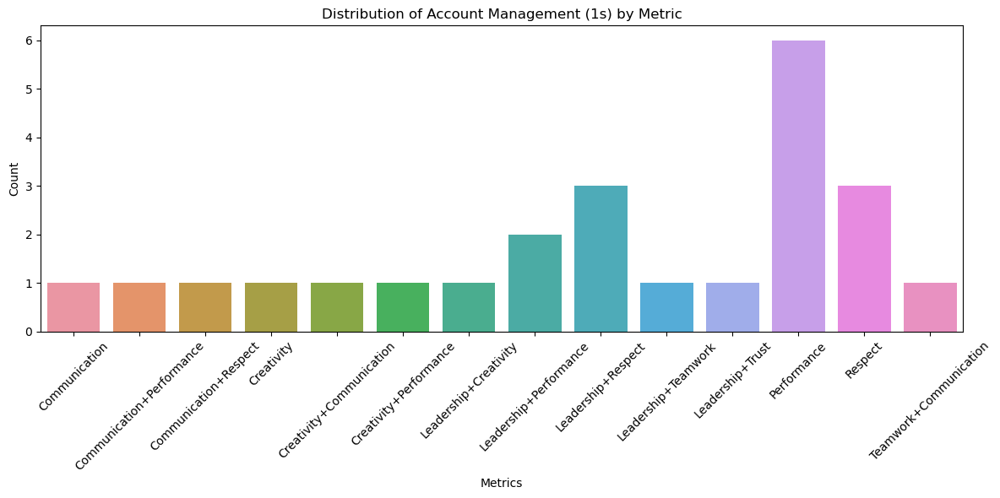

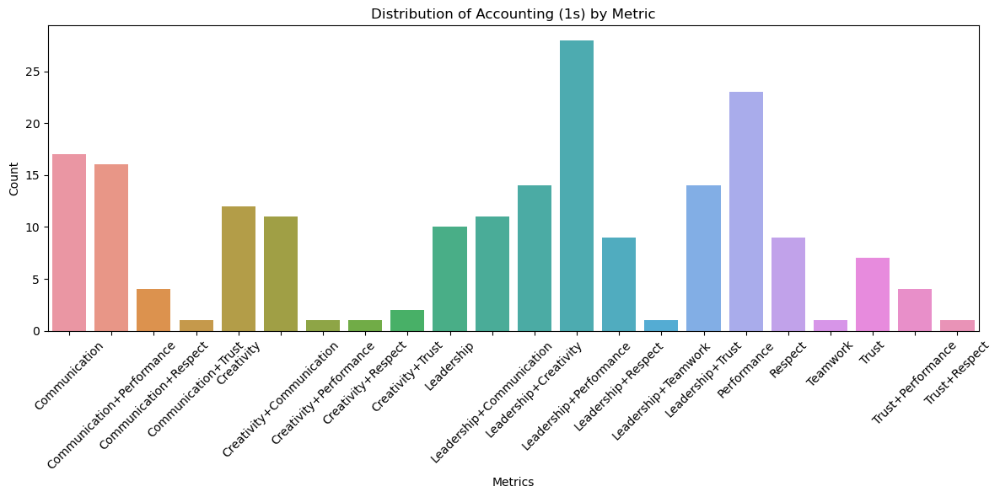

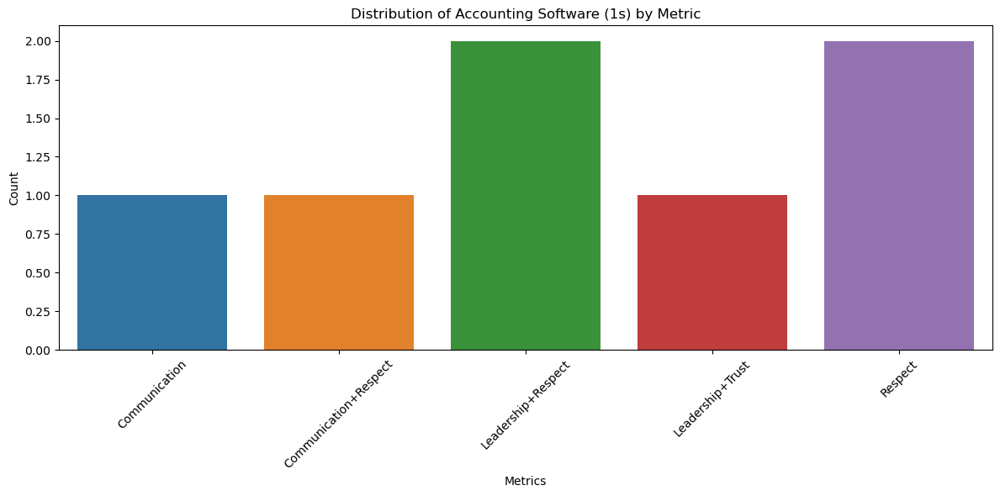

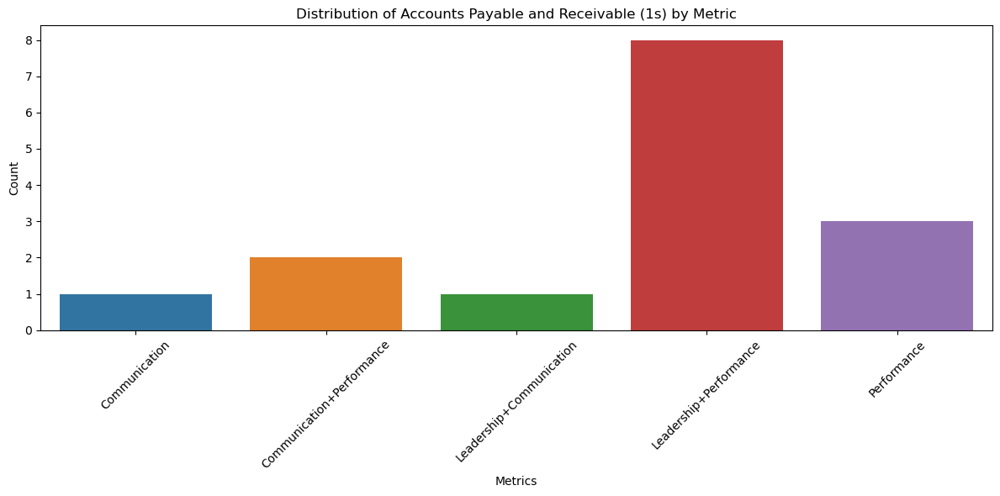

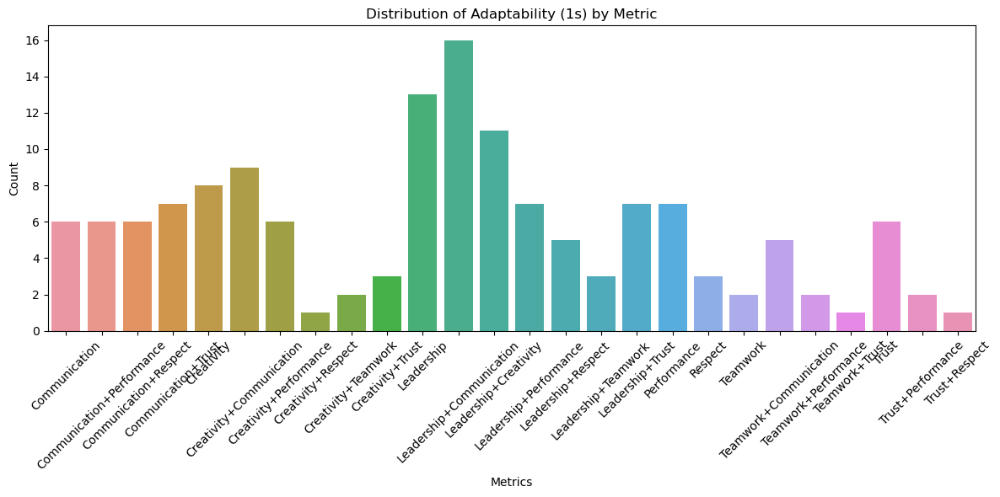

...

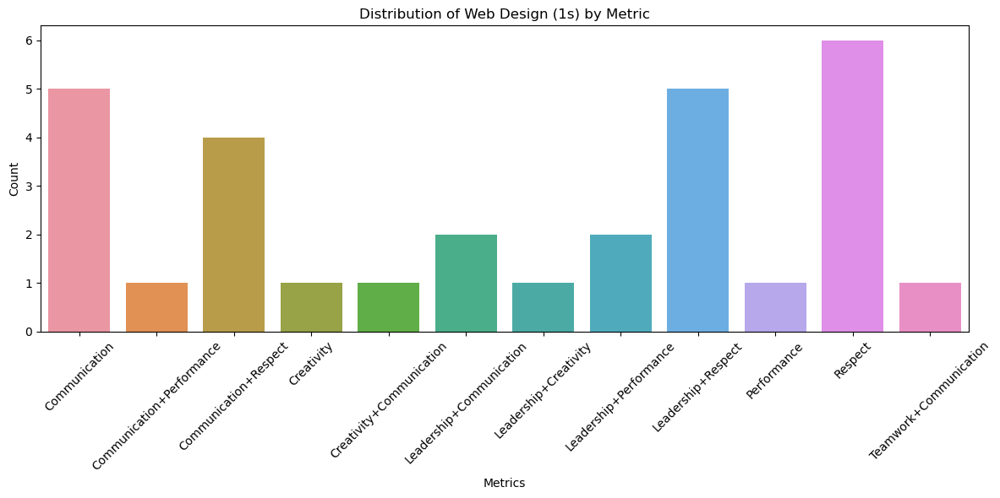

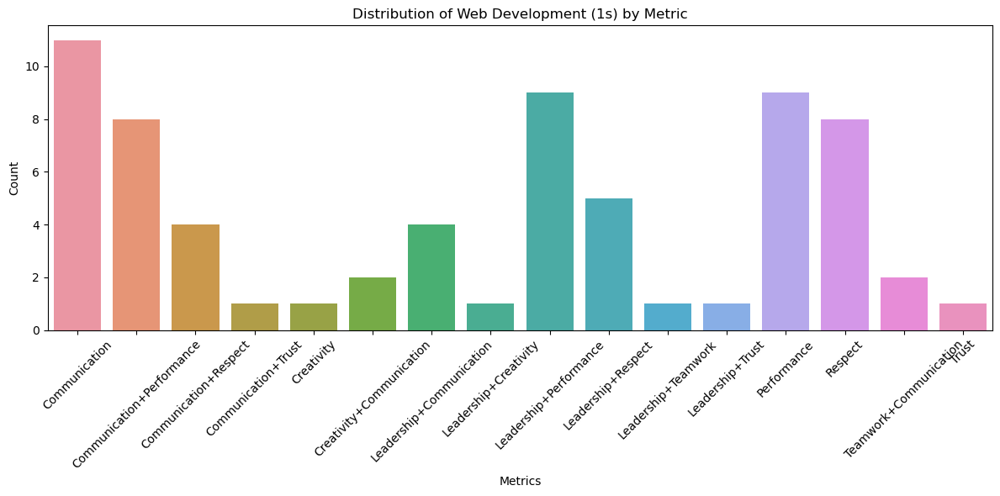

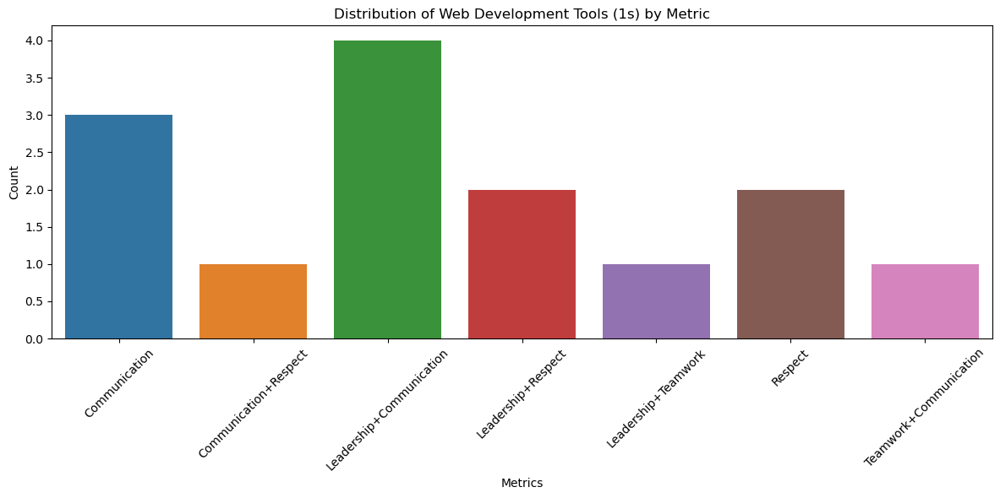

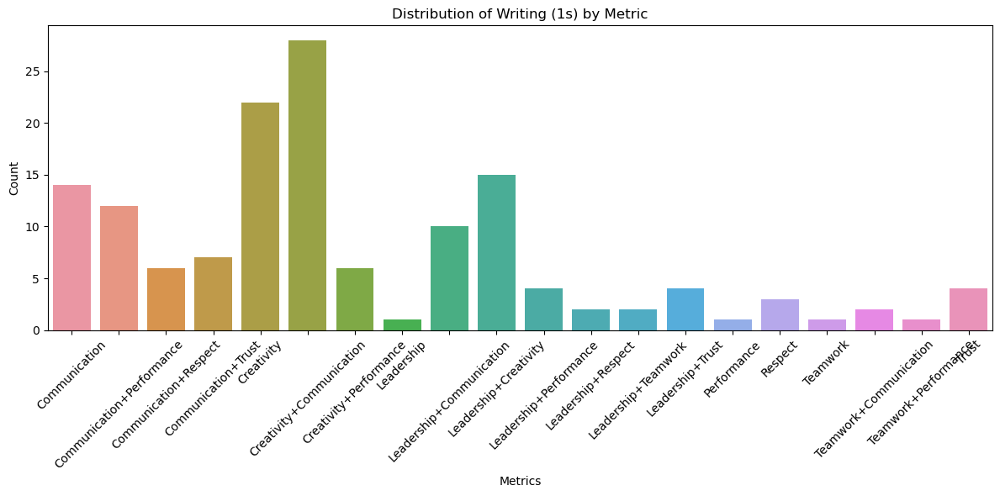

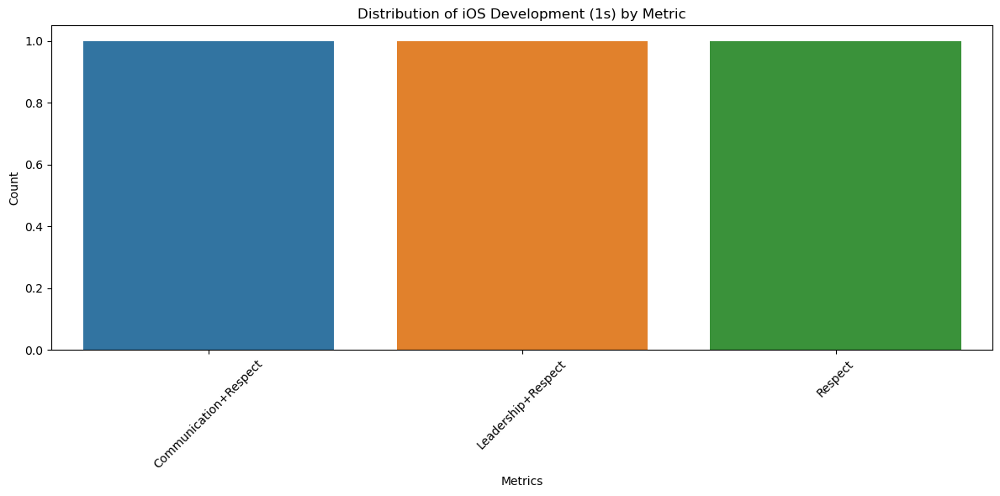

In [156]:
# Plotting
for col in binary_columns:
    plt.figure(figsize=(12, 6))
    metric_data = processed_features[processed_features[col] == 1]
    sns.countplot(x='metric(s)', data=metric_data)
    plt.title(f'Distribution of {col} (1s) by Metric')
    plt.xlabel('Metrics')
    plt.ylabel('Count')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

In [185]:
# Group the data by unique metrics and join acquired competences
grouped_data = features.groupby("metric(s)")["aquired competences"].apply(lambda x: ', '.join(', '.join(comp) for comp in x)).reset_index()

# Rename the columns
grouped_data.columns = ["metric(s)", "joined competences"]

# Print or use the grouped data as needed
print(grouped_data)

                    metric(s)  \
0               Communication   
1   Communication+Performance   
2       Communication+Respect   
3         Communication+Trust   
4                  Creativity   
5    Creativity+Communication   
6      Creativity+Performance   
7          Creativity+Respect   
8         Creativity+Teamwork   
9            Creativity+Trust   
10                 Leadership   
11   Leadership+Communication   
12      Leadership+Creativity   
13     Leadership+Performance   
14         Leadership+Respect   
15        Leadership+Teamwork   
16           Leadership+Trust   
17                Performance   
18                    Respect   
19        Respect+Performance   
20                   Teamwork   
21     Teamwork+Communication   
22       Teamwork+Performance   
23             Teamwork+Trust   
24                      Trust   
25          Trust+Performance   
26              Trust+Respect   

                                   joined competences  
0   Business Commun

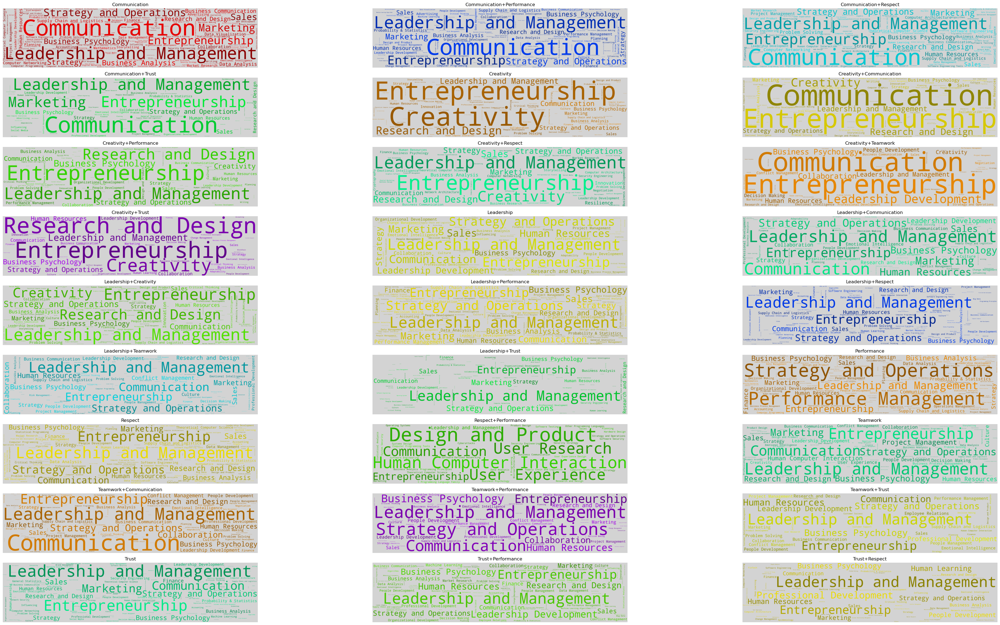

In [214]:
# Function to generate word cloud
color = [0, 160, 130, 95, 280, 40, 330, 110, 25,200,45,110,70,40, 160, 130, 95, 280, 40, 330, 110, 25,200,45,110,70,40]
def random_color_func(word=None, font_size=None, position=None,
                      orientation=None, font_path=None, random_state=None):
    h = int(360.0 * tone / 255.0)
    s = int(100.0 * 255.0 / 255.0)
    l = int(100.0 * float(random_state.randint(70, 120)) / 255.0)
    return "hsl({}, {}%, {}%)".format(h, s, l)

def make_wordcloud(liste, increment,name):
    ax1 = fig.add_subplot(16, 3, increment)
    words = dict()
    trunc_occurrences = liste[0:150]
    for s in trunc_occurrences:
        words[s[0]] = s[1]
    
    wordcloud = WordCloud(width=3000, height=700, background_color='lightgrey', 
                          max_words=1628, relative_scaling=1,
                          color_func=random_color_func,
                          normalize_plurals=False)
    wordcloud.generate_from_frequencies(words)
    ax1.imshow(wordcloud, interpolation="bilinear")
    ax1.axis('off')
    plt.title(name)

# Create a figure to contain subplots
fig = plt.figure(2, figsize=(40, 40))

# Loop through each metric and generate a word cloud
for index, row in grouped_data.iterrows():
    metric = row['metric(s)']
    competences = row['joined competences'].split(', ')
    
    # Process the competences for the word cloud
    occurrences = {}
    for competence in competences:
        occurrences[competence] = occurrences.get(competence, 0) + 1
    
    # Sort the competences by occurrences
    sorted_occurrences = sorted(occurrences.items(), key=lambda x: x[1], reverse=True)
    
    # Define the color of the words based on metric index
    tone = color[index]
    
    # Generate and display the word cloud
    make_wordcloud(sorted_occurrences, index + 1, metric)

plt.tight_layout()
plt.show()


In [179]:
grouped_data.loc[0]

metric(s)                                                 Communication
joined competences    Business Communication, Business Psychology, C...
Name: 0, dtype: object

In [ ]:
pr=processed_features.drop(['Trainer'], axis=1)

In [160]:
pr

,metric(s),Account Management,Accounting,Accounting Software,Accounts Payable and Receivable,Adaptability,Advertising,Advertising Sales,Agile Software Development,Algebra,Algorithms,Amazon Web Services,Android Development,Apache,Application Development,Applied Machine Learning,Applied Mathematics,ArcGIS,Artificial Neural Networks,Audit,B2B Sales,Back-End Web Development,Banking,Basic Descriptive Statistics,Bayesian Network,Bayesian Statistics,Behavioral Economics,Benefits,Big Data,Billing & Invoicing,Bioinformatics,Biostatistics,BlockChain,Brand Management,Budget Management,Business,Business Analysis,Business Communication,Business Design,Business Development,Business Intelligence,Business Process Management,Business Psychology,Business Research,Business Transformation,C Programming Language Family,C++ Programming,Calculus,Cash Management,Change Management,Clinical Data Management,Cloud API,Cloud Applications,Cloud Computing,Cloud Engineering,Cloud Infrastructure,Cloud Load Balancing,Cloud Management,Cloud Platforms,Cloud Standards,Cloud Storage,Cloud-Based Integration,Collaboration,Communication,Compensation,Computational Logic,Computational Thinking,Computer Architecture,Computer Graphic Techniques,Computer Graphics,Computer Networking,Computer Programming,Computer Programming Tools,Computer Science,Computer Security Incident Management,Computer Security Models,Computer Vision,Conflict Management,Continuous Delivery,Continuous Integration,Contract Management,Corporate Accouting,Correlation And Dependence,Cost Accounting,Creativity,Critical Thinking,Cryptography,Culture,Customer Analysis,Customer Relationship Management,Customer Success,Customer Support,Cyberattacks,Data Analysis,Data Analysis Software,Data Architecture,Data Engineering,Data Management,Data Mining,Data Model,Data Science,Data Structures,Data Visualization,Data Visualization Software,Data Warehousing,Database Administration,Database Application,Database Design,Database Theory,Databases,Decision Making,Deep Learning,Design and Product,DevOps,Devops Tools,Differential Equations,Digital Marketing,Dimensionality Reduction,Distributed Computing Architecture,Django (Web Framework),Docker (Software),E-Commerce,Econometrics,Emotional Intelligence,Employee Relations,Entrepreneurial Finance,Entrepreneurship,Epidemiology,Estimation,Experiment,Exploratory Data Analysis,Extract,Facility Management,Feature Engineering,FinTech,Finance,Financial Accounting,Financial Analysis,Financial Management,Forecasting,Front-End Web Development,Full-Stack Web Development,GIS Software,Game Theory,General Accounting,General Statistics,Generally Accepted Accounting Principles (GAAP),Geometry,Geovisualization,Google App Engine,Google Cloud Platform,Graph Theory,Graphic Design,Graphics Software,HR Tech,HTML and CSS,Hardware Design,Health,Human Computer Interaction,Human Factors (Security),Human Learning,Human Resources,Human Resources Operations,IBM Cloud,Influencing,Information Technology,Innovation,Inside Sales,Interactive Data Visualization,Interactive Design,Internet Of Things,Inventory Management,Investment Management,Java Programming,Javascript,Journalism,Knitr,Kubernetes,Leadership Development,Leadership and Management,Linear Algebra,Linux,Load,Machine Learning,Machine Learning Algorithms,Machine Learning Software,Management Accounting,MarTech,Market Analysis,Market Research,Marketing,Marketing Design,Marketing Management,Marketing Psychology,Markov Model,Material Handling,Mathematical Theory & Analysis,Mathematics,Matlab,Media Production,Media Strategy & Planning,Merchandising,Mergers & Acquisitions,Microarchitecture,Microsoft Azure,Microsoft Excel,Mobile Development,Mobile Development Tools,Mobile Security,Natural Language Processing,Negotiation,Network Analysis,Network Architecture,Network Model,Network Security,Networking Hardware,NoSQL,Operating Systems,Operational Analysis,Operations Management,Operations Research,Organizational Development,Other Cloud Platforms and Tools,Other P

In [162]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OneHotEncoder
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# Assuming your pr DataFrame contains encoded competences and metrics
X = pr.drop(['metric(s)'], axis=1)  # Features
y = pr['metric(s)']  # Target variable

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize an encoder for competences (assuming one-hot encoding)
encoder = OneHotEncoder(handle_unknown='ignore')  # Add handle_unknown parameter
X_train_encoded = encoder.fit_transform(X_train)
X_test_encoded = encoder.transform(X_test)

# Initialize a RandomForestClassifier (you can choose other classifiers)
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(X_train_encoded, y_train)

# Make predictions
y_pred = model.predict(X_test_encoded)

# Evaluate the model
print(classification_report(y_test, y_pred))


                           precision    recall  f1-score   support

            Communication       0.33      0.18      0.23        17
Communication+Performance       0.06      0.06      0.06        17
    Communication+Respect       0.08      0.10      0.09        10
      Communication+Trust       0.14      0.12      0.13        16
               Creativity       0.17      0.10      0.13        29
 Creativity+Communication       0.07      0.06      0.06        18
   Creativity+Performance       0.00      0.00      0.00         7
       Creativity+Respect       0.00      0.00      0.00         3
      Creativity+Teamwork       0.00      0.00      0.00         4
         Creativity+Trust       0.00      0.00      0.00         2
               Leadership       0.04      0.06      0.04        18
 Leadership+Communication       0.00      0.00      0.00        24
    Leadership+Creativity       0.00      0.00      0.00        19
   Leadership+Performance       0.00      0.00      0.00     

In [165]:
#bad results

In [169]:
!pip install tensorflow

  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/9e/b8/ed5f794359d05cd0bffb894c6418da87b93016ee17b669d55c45d1bd5d5b/tensorflow-2.13.0-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for tensorflow-intel==2.13.0 from https://files.pythonhosted.org/packages/2f/2f/3c84f675931ce3bcbc7e23acbba1e5d7f05ce769adab48322de57a9f5928/tensorflow_intel-2.13.0-cp311-cp311-win_amd64.whl.metadata
     ---------------------------------------- 0.0/126.5 kB ? eta -:--:--
     --------- ----------------------------- 30.7/126.5 kB 1.3 MB/s eta 0:00:01
     -------------------- ---------------- 71.7/126.5 kB 777.7 kB/s eta 0:00:01
     ---------------------------------- - 122.9/126.5 kB 901.1 kB/s eta 0:00:01
     ------------------------------------ 126.5/126.5 kB 824.9 kB/s eta 0:00:00
  Obtaining dependency information for flatbuffers>=23.1.21 from https://files.pythonhosted.org/packages/6f/12/d5c79ee252793ffe845d58a913197bfa02ae9a0b5c9bc3

   -------- ------------------------------- 55.9/276.6 MB 1.3 MB/s eta 0:02:53
   -------- ------------------------------- 56.0/276.6 MB 1.3 MB/s eta 0:02:53
   -------- ------------------------------- 56.0/276.6 MB 1.3 MB/s eta 0:02:53
   -------- ------------------------------- 56.0/276.6 MB 1.3 MB/s eta 0:02:55
   -------- ------------------------------- 56.1/276.6 MB 1.3 MB/s eta 0:02:54
   -------- ------------------------------- 56.1/276.6 MB 1.3 MB/s eta 0:02:54
   -------- ------------------------------- 56.2/276.6 MB 1.3 MB/s eta 0:02:55
   -------- ------------------------------- 56.2/276.6 MB 1.3 MB/s eta 0:02:55
   -------- ------------------------------- 56.3/276.6 MB 1.3 MB/s eta 0:02:54
   -------- ------------------------------- 56.3/276.6 MB 1.3 MB/s eta 0:02:54
   -------- ------------------------------- 56.4/276.6 MB 1.3 MB/s eta 0:02:54
   -------- ------------------------------- 56.4/276.6 MB 1.3 MB/s eta 0:02:54
   -------- ------------------------------- 56.5/276

In [173]:
# Tokenize and pad sequences for both training and testing data
tokenizer = Tokenizer(num_words=5000, split=' ')
tokenizer.fit_on_texts(X)
X_train = tokenizer.texts_to_sequences(X_train_text)
X_test = tokenizer.texts_to_sequences(X_test_text)
X_train = pad_sequences(X_train)
X_test = pad_sequences(X_test)


AttributeError: 'numpy.ndarray' object has no attribute 'lower'

In [172]:
# Evaluate the model
y_pred = model.predict(X_test)
y_pred_classes = (y_pred > 0.5).astype(int)
target_names = label_encoder.classes_

print(classification_report(y_test, y_pred_classes, labels=range(len(target_names)), target_names=target_names))


ValueError: in user code:

    File "C:\Users\hamma\anaconda3\Lib\site-packages\keras\src\engine\training.py", line 2341, in predict_function  *
        return step_function(self, iterator)
    File "C:\Users\hamma\anaconda3\Lib\site-packages\keras\src\engine\training.py", line 2327, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "C:\Users\hamma\anaconda3\Lib\site-packages\keras\src\engine\training.py", line 2315, in run_step  **
        outputs = model.predict_step(data)
    File "C:\Users\hamma\anaconda3\Lib\site-packages\keras\src\engine\training.py", line 2283, in predict_step
        return self(x, training=False)
    File "C:\Users\hamma\anaconda3\Lib\site-packages\keras\src\utils\traceback_utils.py", line 70, in error_handler
        raise e.with_traceback(filtered_tb) from None
    File "C:\Users\hamma\anaconda3\Lib\site-packages\keras\src\engine\input_spec.py", line 298, in assert_input_compatibility
        raise ValueError(

    ValueError: Input 0 of layer "sequential_1" is incompatible with the layer: expected shape=(None, 667), found shape=(None, 81)
